In [2]:
rm(list=ls())
setwd("/hpc/group/pbenfeylab/CheWei/")

In [3]:
libs <- c("here", "dplyr", "tradeSeq", "SingleCellExperiment", "slingshot",
           "condiments", "scater", "RColorBrewer", "pheatmap", "cowplot",
          "tidyr","condimentsPaper","Seurat")
suppressMessages(
  suppressWarnings(sapply(libs, require, character.only = TRUE))
)

here                dplyr             tradeSeq 
                TRUE                 TRUE                 TRUE 
SingleCellExperiment            slingshot           condiments 
                TRUE                 TRUE                 TRUE 
              scater         RColorBrewer             pheatmap 
                TRUE                 TRUE                 TRUE 
             cowplot                tidyr      condimentsPaper 
                TRUE                 TRUE                FALSE 
              Seurat 
                TRUE

In [4]:
suppressPackageStartupMessages({
  library(slingshot); library(SingleCellExperiment)
  library(RColorBrewer); library(scales)
  library(viridis); library(UpSetR)
  library(pheatmap); library(msigdbr)
  library(fgsea); library(knitr)
  library(ggplot2); library(gridExtra)
  library(tradeSeq);library(Seurat)
  library(tidyverse);library(condiments)
  library(patchwork);library(ComplexHeatmap)
  library(circlize);library(WGCNA)  
  library(tricycle);library(GeneOverlap)
  library(gprofiler2);library(ggrepel)
})

In [5]:
sessionInfo()

R version 4.2.2 (2022-10-31)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: AlmaLinux 9.3 (Shamrock Pampas Cat)

Matrix products: default
BLAS/LAPACK: /hpc/group/pbenfeylab/ch416/miniconda3/envs/seu4/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] ggrepel_0.9.4               gprofiler2_0.2.2           
 [3] GeneOverlap_1.34.0          tricycle_1.6.0             
 [5] WGCNA_1.72-1                fastcluster_1.2.3          
 [7] dynamicTreeCut_1.63-1       circlize_0.4.15            
 [9] C

In [6]:
rc.integrated <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_18S_WT_cell_cycle_seu4_all_genes_20230907.rds")

In [7]:
head(rc.integrated@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,...,endomito.anno.S,endomito.anno.cor.S,endomito.anno.pvalue.S,Signature_2C,Signature_4C,Signature_8C,Signature_16C,endo_mito_G2M_anno,Signature_Endo,Signature_G2M
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,...,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
AAACCTGAGCGCCTCA_1,dc1,7170,2579,5764,2351,1406,651,0.11157601,0.06973501,10049,...,G2M,0.6678974,3.360576e-27,0.02082176,0.3498531,-0.1981609,-0.1434493,Mito,-0.4840441,-0.1089351
AAACCTGCAGGACGTA_1,dc1,15224,4203,13390,3889,1834,954,0.02627430,0.01970573,11521,...,Mito,0.8605169,6.590369e-60,0.26251932,-0.1161063,0.3857987,0.2374772,Endo,-0.4840441,-0.1089351
AAACCTGGTATCACCA_1,dc1,4748,1922,3756,1763,992,484,0.21061500,0.52653749,10035,...,Endo,0.7400842,5.846399e-36,0.25245732,0.2653288,-0.1146687,-0.3223895,Mito,-0.4840441,-0.1089351
AAACGGGCAATAGAGT_1,dc1,143210,9343,112840,8891,30370,3514,0.02304308,0.02304308,10392,...,Endo,0.6223682,7.766415e-23,-0.20722212,0.1255241,0.6417355,0.1286403,Mito,0.7140807,-0.1089351
AAACGGGCACTGTCGG_1,dc1,3075,1646,2574,1500,501,340,0.19512195,0.16260163,9378,...,Endo,0.8595862,1.212781e-59,-0.06071600,-0.1187295,-0.2608747,-0.1995916,Mito,-0.4840441,-0.1089351
AAACGGGGTCACCCAG_1,dc1,3112,1615,2681,1439,431,345,0.12853470,0.03213368,9214,...,Mito,0.8599539,9.535834e-60,-0.09531667,-0.2347054,-0.1495408,0.1486331,Mito,-0.4840441,-0.1089351


In [8]:
table(rc.integrated$orig.ident)


     dc1      dc2 sc_10_at    sc_11    sc_12   sc_157   sc_158   sc_159 
    2323     2052     2435     2532     1866     1210     1231     1173 
  sc_169   sc_170   sc_171    sc_20   sc_215   sc_221   sc_229   sc_235 
    2460     2282     3850     2096     6754     8986     3515     2090 
   sc_71     tnw1 
    4205     1411 

In [9]:
table(rc.integrated$celltype.anno.Li)


     Quiescent Center             Columella      Lateral Root Cap 
                  385                  3063                 27495 
         Atrichoblast           Trichoblast                Cortex 
                 8115                  6549                  2630 
           Endodermis                Phloem                 Xylem 
                 2777                    88                   173 
           Procambium  Xylem Pole Pericycle Phloem Pole Pericycle 
                   88                  1059                    49 

In [10]:
#keep_idx <- names(which((rc.integrated$sample=="sc_43") | (rc.integrated$sample=="sc_44") |(rc.integrated$sample=="sc_45")|(rc.integrated$sample=="sc_46")|(rc.integrated$sample=="sc_47")|(rc.integrated$sample=="sc_48")|(rc.integrated$sample=="sc_49")|(rc.integrated$sample=="sc_50")))
#rc.integrated <- subset(rc.integrated,cells=keep_idx)
#dat <- as.data.frame(matrix(NA,ncol(rc.integrated),ncol(sc_meta)))
#colnames(dat) <- colnames(sc_meta)
#for (i in names(table(rc.integrated$orig.ident))) {
# idx <- which(rc.integrated$orig.ident==i)
# dat[idx,]=sc_meta[which(sc_meta$sample==i),]
#}
#rownames(dat) <- colnames(rc.integrated)
wanted_cols <- c("orig.ident", "celltype.anno.Li", "tricyclePosition","tricycleCCStage")
rc.integrated@meta.data <- rc.integrated@meta.data[,wanted_cols]
colnames(rc.integrated@meta.data) <- c("sample","cell_type", "tricyclePosition","tricycleCCStage")
#rc.integrated@meta.data <- cbind(dat,rc.integrated@meta.data)

In [11]:
table(rc.integrated$sample)


     dc1      dc2 sc_10_at    sc_11    sc_12   sc_157   sc_158   sc_159 
    2323     2052     2435     2532     1866     1210     1231     1173 
  sc_169   sc_170   sc_171    sc_20   sc_215   sc_221   sc_229   sc_235 
    2460     2282     3850     2096     6754     8986     3515     2090 
   sc_71     tnw1 
    4205     1411 

In [12]:
table(rc.integrated$cell_type)


     Quiescent Center             Columella      Lateral Root Cap 
                  385                  3063                 27495 
         Atrichoblast           Trichoblast                Cortex 
                 8115                  6549                  2630 
           Endodermis                Phloem                 Xylem 
                 2777                    88                   173 
           Procambium  Xylem Pole Pericycle Phloem Pole Pericycle 
                   88                  1059                    49 

In [13]:
plot_anno <- function(rc.integrated){
order <- c("Quiescent Center", "Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem","Protophloem", "Xylem", "Procambium","Pericycle","Phloem Pole Pericycle", "Protoxylem", "Xylem Pole Pericycle")
palette <- c("#9400D3", "#5AB953", "#BFEF45", "#008080", "#21B6A8", "#82B6FF", "#0000FF","#E6194B", "#DD77EC", "#9A6324", "#FFE119", "#FF9900", "#FFD4E3", "#9A6324", "#DDAA6F")
rc.integrated$cell_type <- factor(rc.integrated$cell_type, levels = order[sort(match(unique(rc.integrated$cell_type),order))])
color <- palette[sort(match(unique(rc.integrated$cell_type),order))]
DimPlot(rc.integrated, reduction = "umap", group.by = "cell_type", cols=color, pt.size=0.2)}

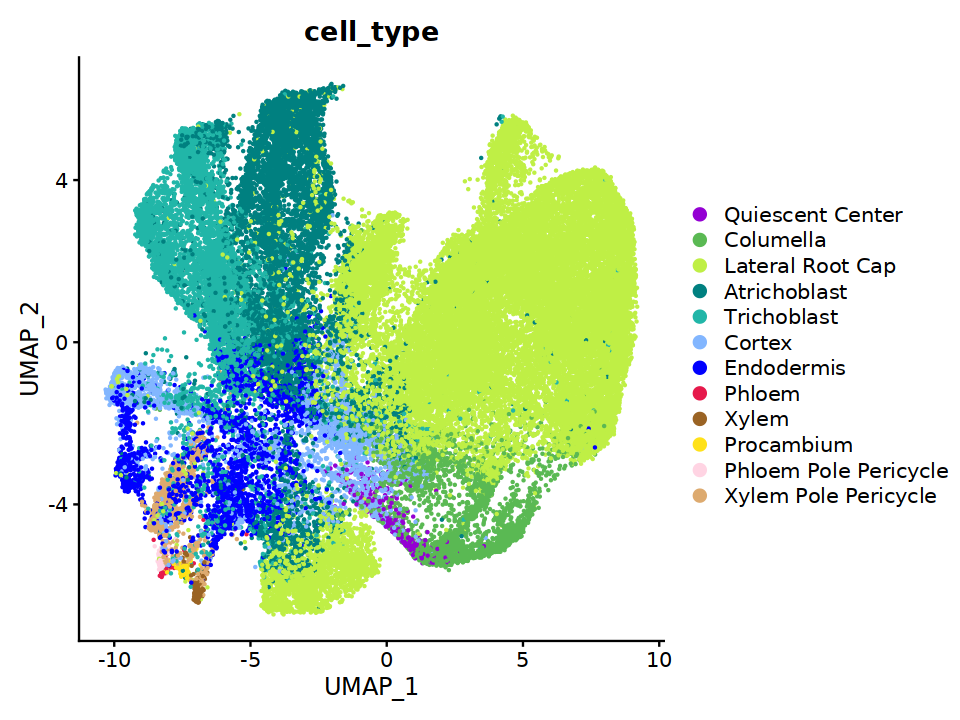

In [14]:
options(repr.plot.width=8, repr.plot.height=6)
plot_anno(rc.integrated)

## Inspect gene expression over tricycle position

In [96]:
pltctsg <- function(gene){
    
keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == gene)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Quiescent Center")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Quiescent Center")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- fit.l$pred.df

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Columella")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Columella")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Lateral Root Cap")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Lateral Root Cap")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Atrichoblast")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Atrichoblast")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Trichoblast")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Trichoblast")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Cortex")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Cortex")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Endodermis")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Endodermis")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)
    
fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Phloem")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Phloem")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)
    
fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Xylem")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Xylem")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)
    
fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Procambium")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Procambium")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Phloem Pole Pericycle")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Phloem Pole Pericycle")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi)[which(rc.integrated$cell_type=="Xylem Pole Pericycle")],
                            rc.integrated@assays$SCT@data[keygene.idx,which(rc.integrated$cell_type=="Xylem Pole Pericycle")],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

fit <- rbind(fit, fit.l$pred.df)

fit$treatment <- factor(c(rep("Quiescent Center", 200),rep("Columella", 200),rep("LRC", 200) ,rep("Atrichoblast", 200),rep("Trichoblast", 200),rep("Cortex", 200),rep("Endodermis", 200),rep("Phloem", 200),rep("Xylem", 200),rep("Procambium", 200),rep("Phloem Pole Pericycle", 200),rep("Xylem Pole Pericycle", 200)),
                  levels=c("Quiescent Center", "Columella", "LRC", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Phloem", "Xylem", "Procambium","Pericycle","Phloem Pole Pericycle", "Xylem Pole Pericycle"))

options(repr.plot.width=8, repr.plot.height=6)
print(ggplot(fit, aes(x=x,y=y,color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "tricycle position θ", y = "smoothed expression", title = gene) + 
            scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                0.5, 1, 1.5, 2), "π"), name = "tricycle position θ")+
    scale_color_manual(values = c("#9400D3", "#5AB953", "#BFEF45", "#008080", "#21B6A8", "#82B6FF", "#0000FF","#E6194B","#9A6324", "#FFE119", "#FFD4E3","#DDAA6F"))+
  theme_bw(base_size = 14)+
  theme(legend.title=element_blank()))
      #geom_vline(xintercept = 1*pi, linetype="dotted", 
      #          color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
      #          color = "red", size=1.5)+ annotate("text", x = 0.5*pi, y =3.4 , label = "G1", size = 6)+ 
    #annotate("text", x = 1.27*pi, y =3.4 , label = "S", size = 6)+ annotate("text", x = 1.8*pi, y =3.4 , label = "G2M", size = 6))
}

In [97]:
pltsg <- function(gene){
    keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == gene)
    fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                            rc.integrated@assays$SCT@data[keygene.idx,],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = gene) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

## Marker reported by Laura Lee

png 
  2

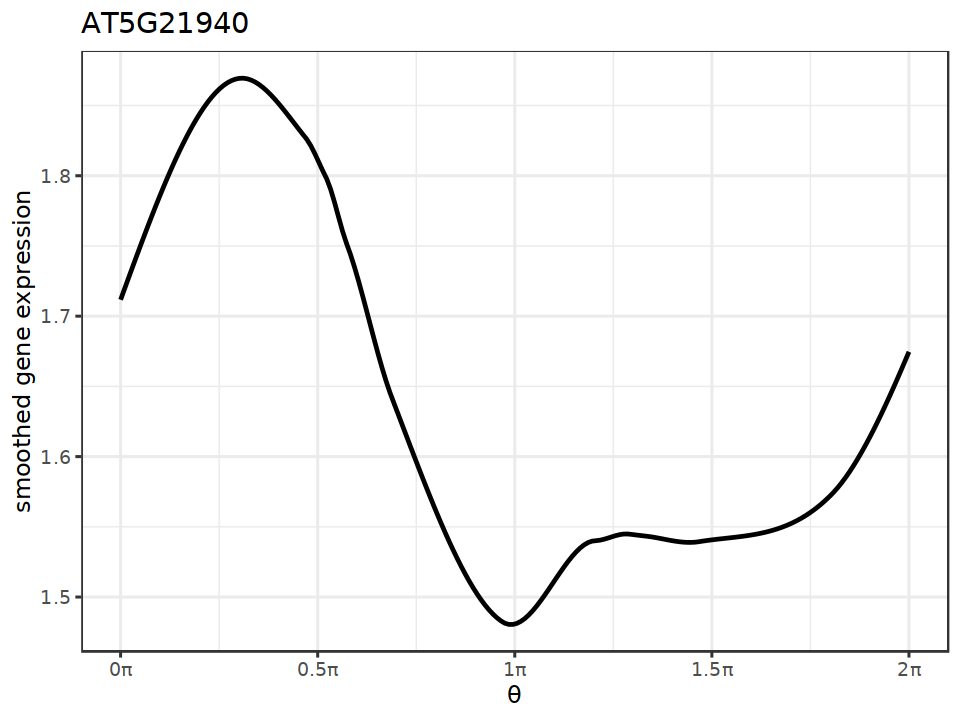

In [30]:
## G1 marker reported by Laura Lee
grDevices::cairo_pdf("Laura_G1_marker.pdf",width=8, height=6)
pltsg('AT5G21940')
dev.off()

pltsg('AT5G21940')

png 
  2

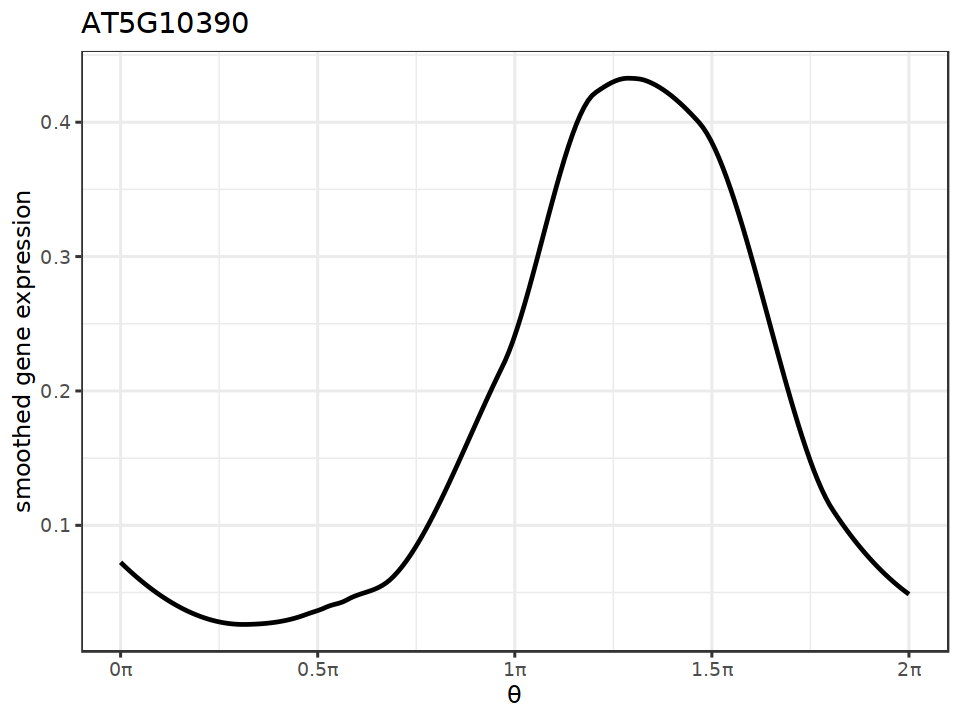

In [31]:
## S marker reported by Laura Lee
grDevices::cairo_pdf("Laura_S_marker.pdf",width=8, height=6)
pltsg('AT5G10390')
dev.off()

pltsg('AT5G10390')

png 
  2

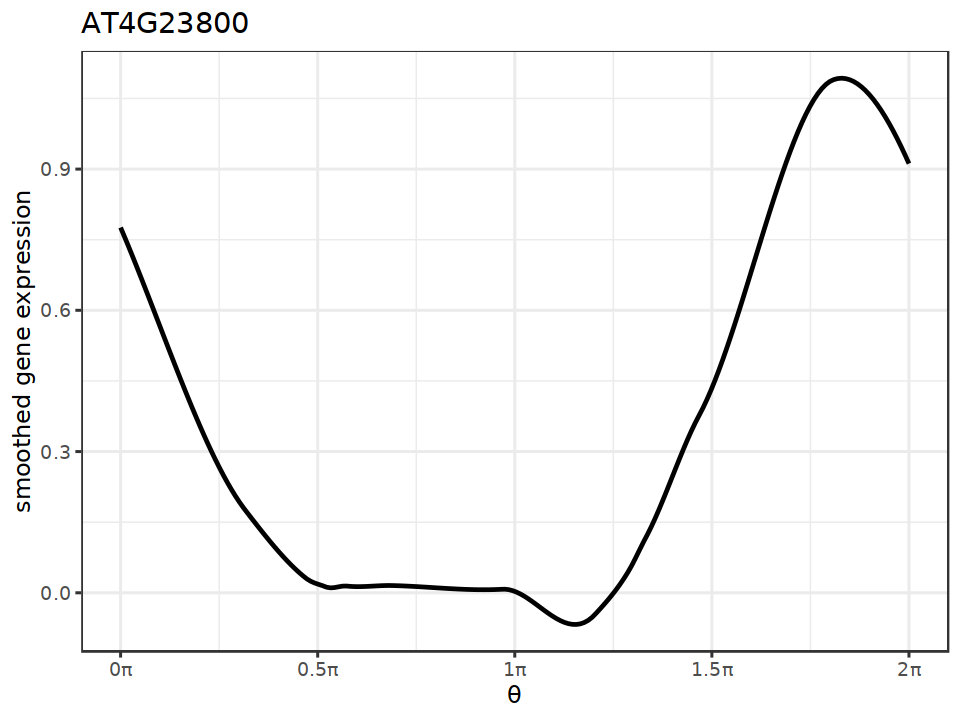

In [32]:
## G2M marker reported by Laura Lee
grDevices::cairo_pdf("Laura_G2M_marker.pdf",width=8, height=6)
pltsg('AT4G23800')
dev.off()

pltsg('AT4G23800')

## Marker reported in this study

png 
  2

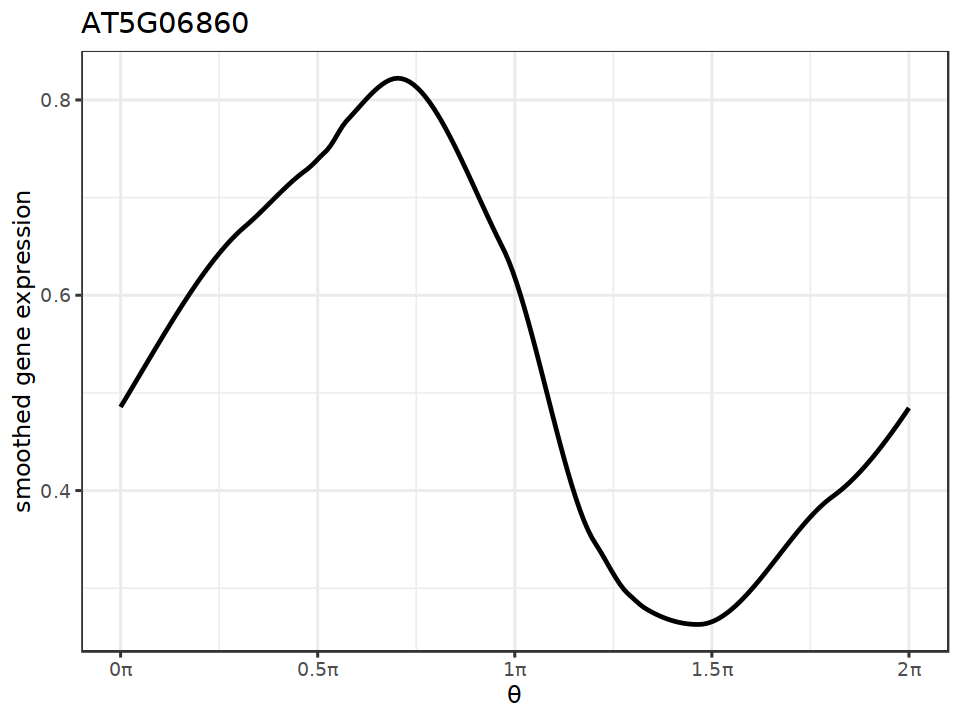

In [33]:
## G1 marker PGIP1-AT5G06860
grDevices::cairo_pdf("ThisStudy_G1_marker.pdf",width=8, height=6)
pltsg('AT5G06860')
dev.off()

pltsg('AT5G06860')

png 
  2

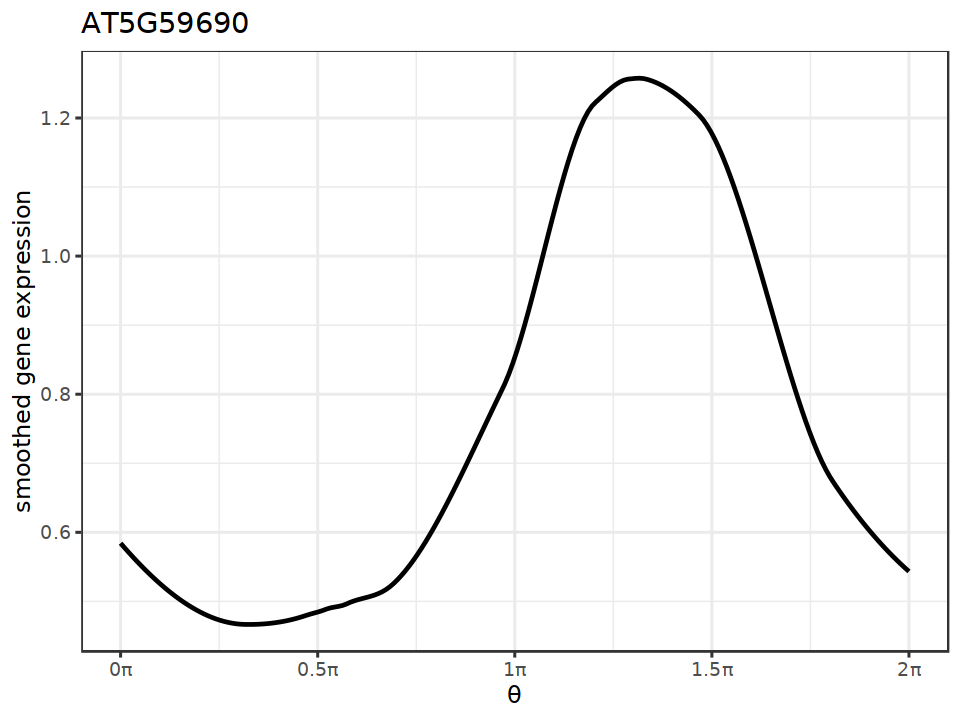

In [34]:
## S marker AT5G59690
grDevices::cairo_pdf("ThisStudy_S_marker.pdf",width=8, height=6)
pltsg('AT5G59690')
dev.off()

pltsg('AT5G59690')

png 
  2

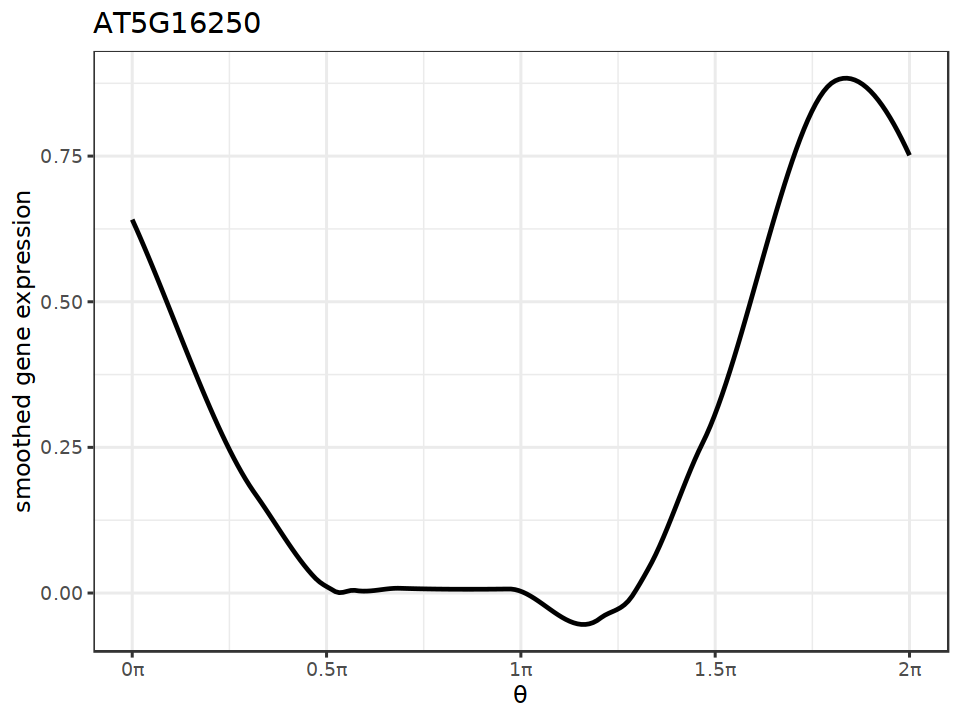

In [35]:
## G2M marker AT5G16250
grDevices::cairo_pdf("ThisStudy_G2M_marker.pdf",width=8, height=6)
pltsg('AT5G16250')
dev.off()

pltsg('AT5G16250')

## Genes of interest

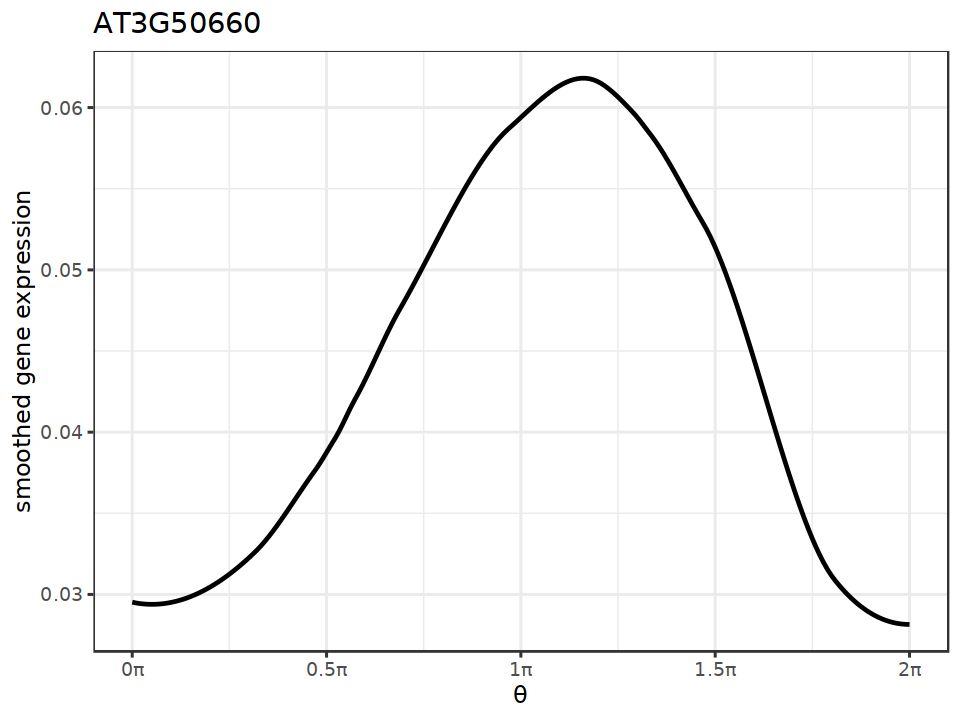

In [19]:
## DWF4 
pltsg('AT3G50660')

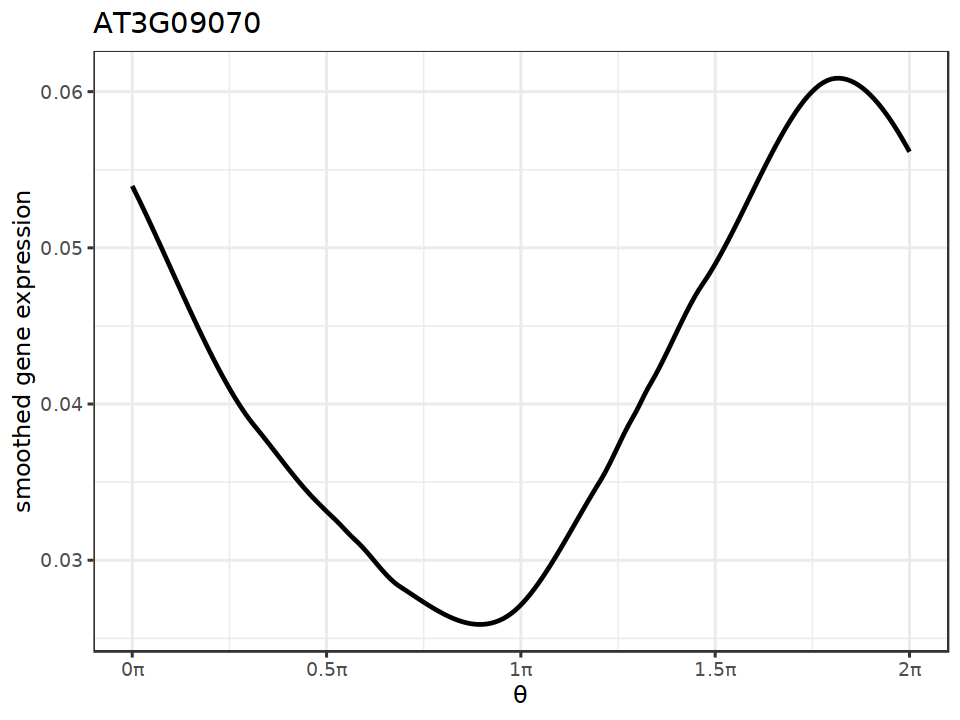

In [20]:
## OPS 
pltsg('AT3G09070')

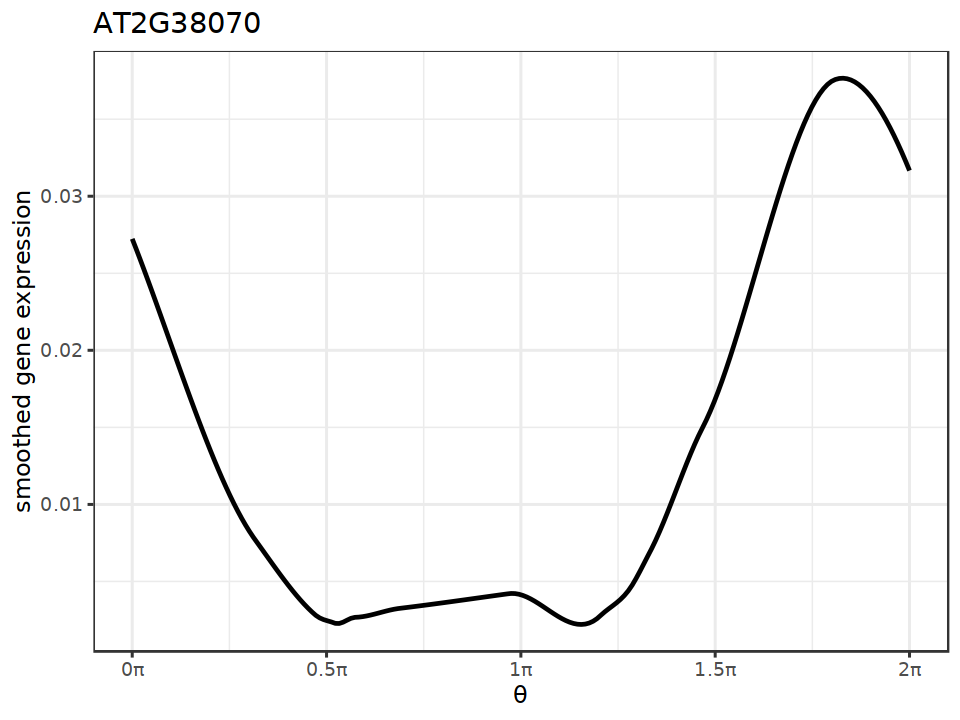

In [21]:
## OPL2 
pltsg('AT2G38070')

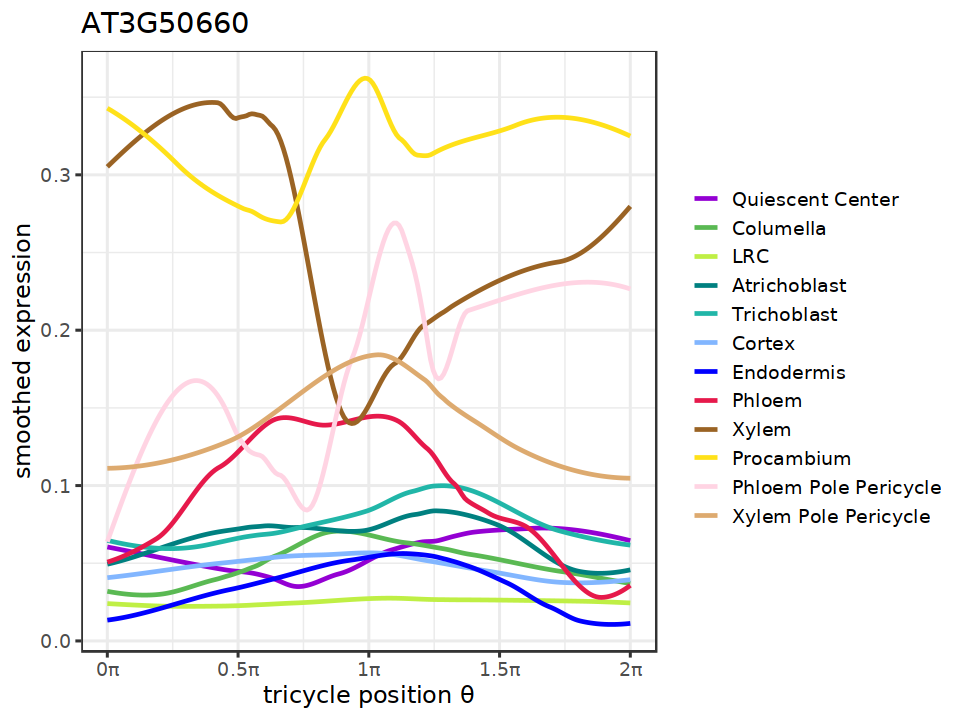

In [25]:
## DWF4 
pltctsg('AT3G50660')

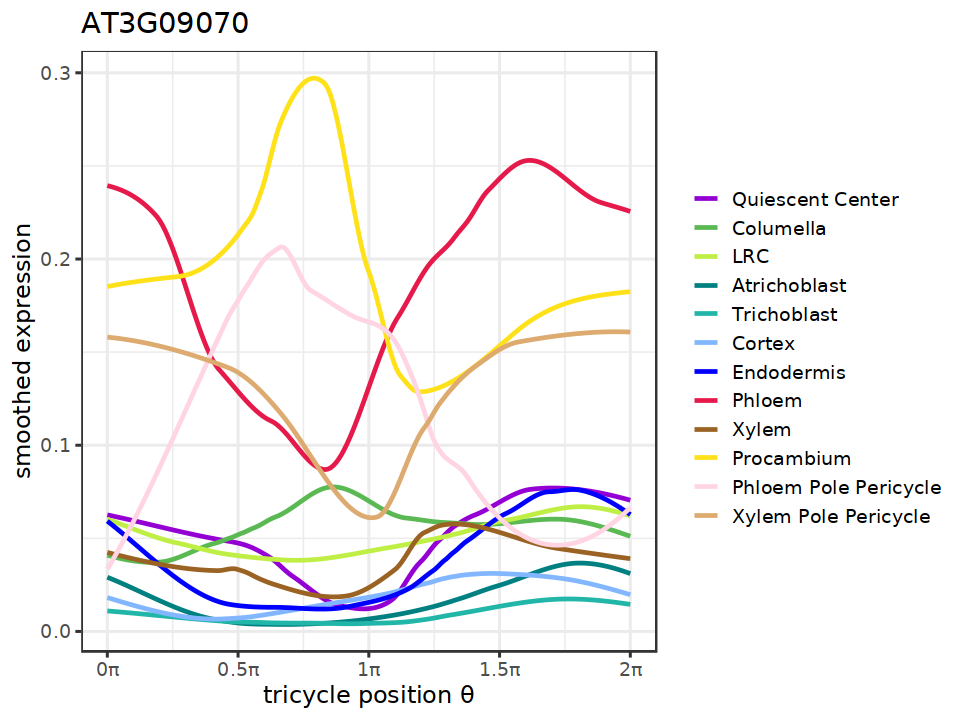

In [26]:
## OPS 
pltctsg('AT3G09070')

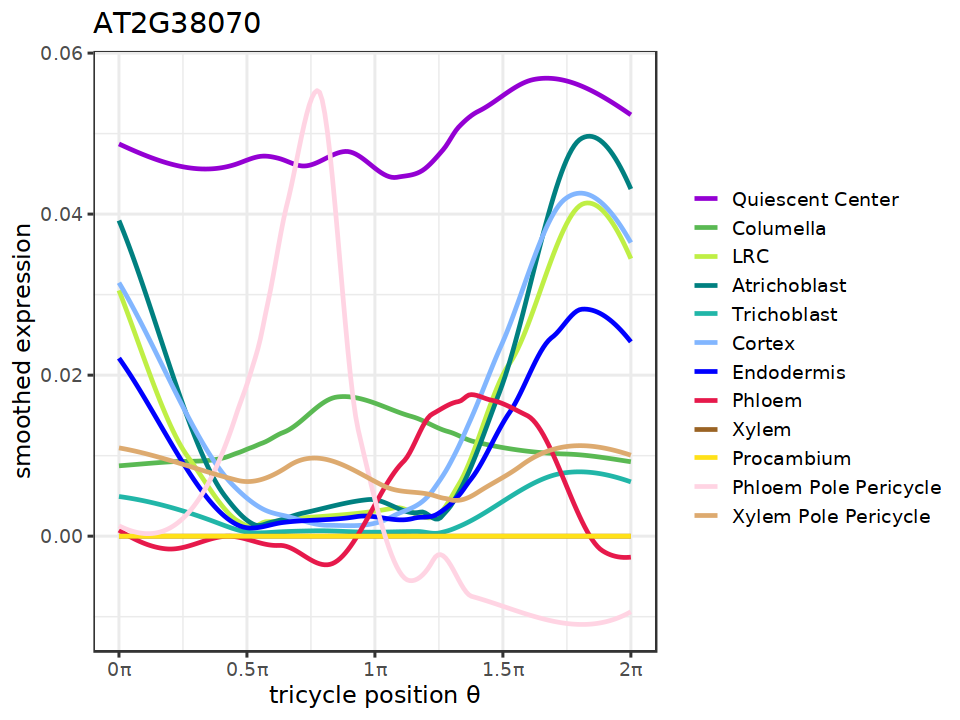

In [27]:
## OPL2 
pltctsg('AT2G38070')

## Load Core CC genes

In [25]:
core <- read.csv('./tradeseq/Core_CC_Genes.csv')

In [15]:
## Remove genes that were not captured by scRNA-seq
core <- core[core$GeneID %in% rownames(rc.integrated@assays$SCT@data),]

In [16]:
## Load Auxin and Cytokinin gene list
AL <- read.csv("./tradeseq/Auxin_gene_list.csv")
AL <- AL[AL$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
CL <- read.csv("./tradeseq/Cytokinin_gene_list.csv")
CL <- CL[CL$GeneID %in% rownames(rc.integrated@assays$SCT@data),]

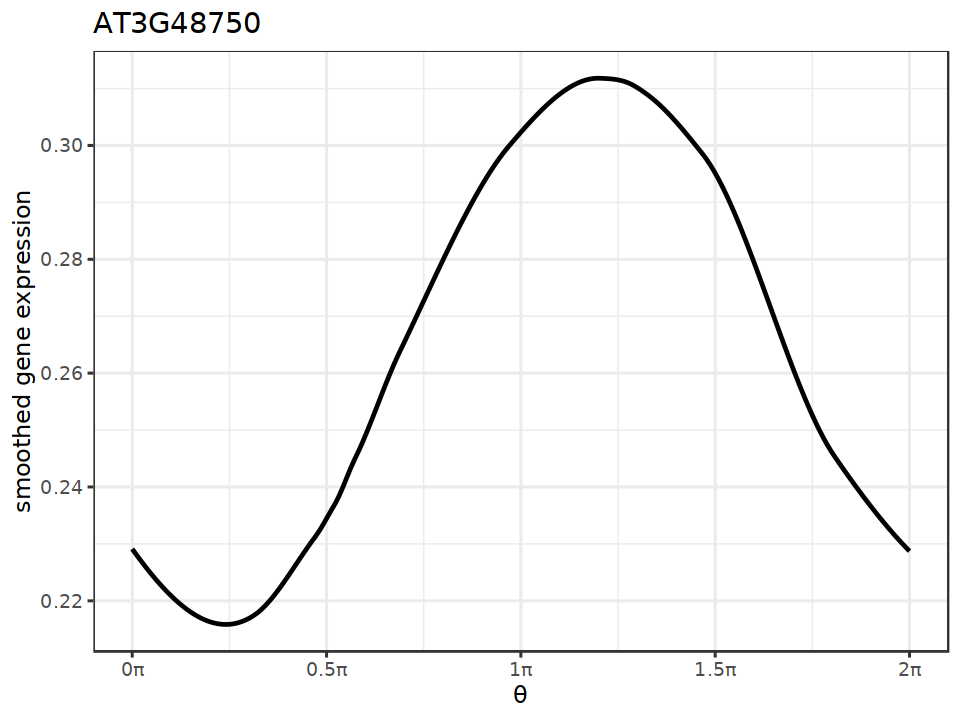

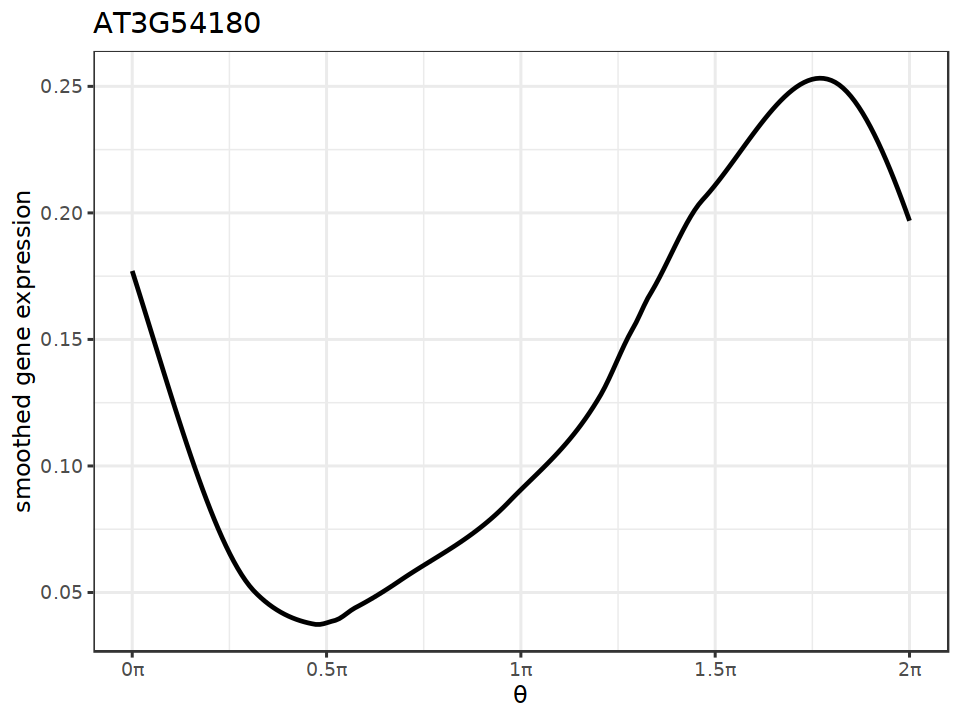

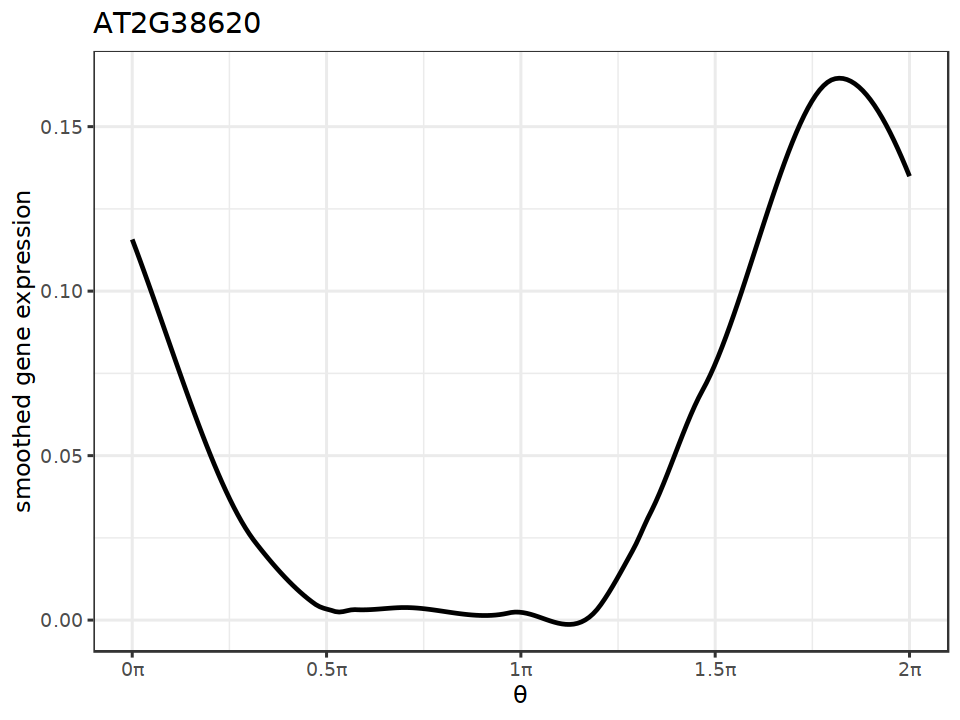

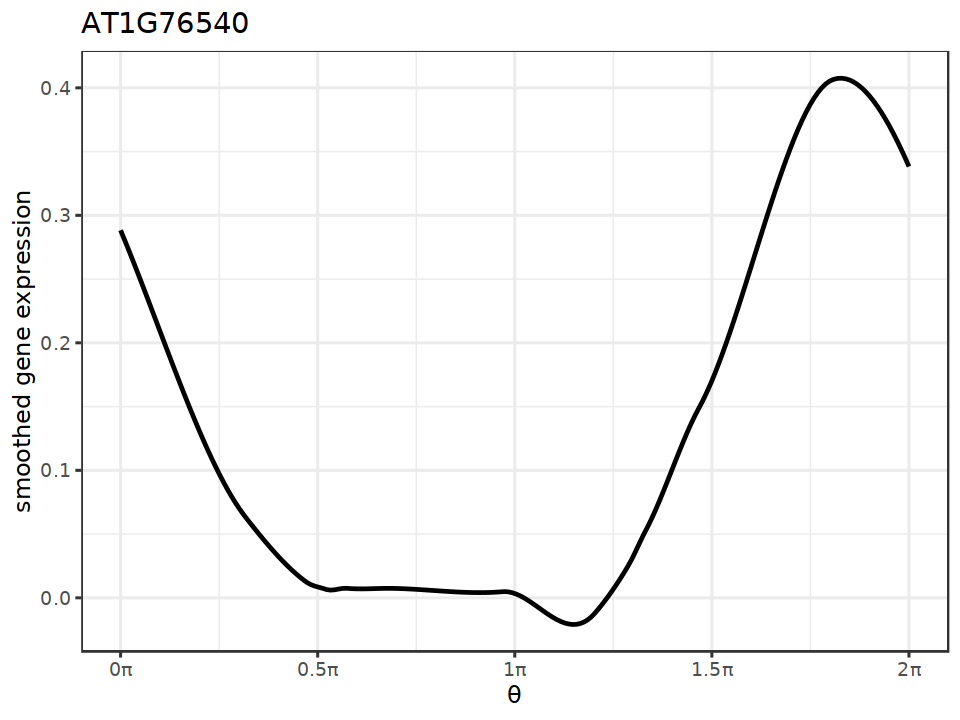

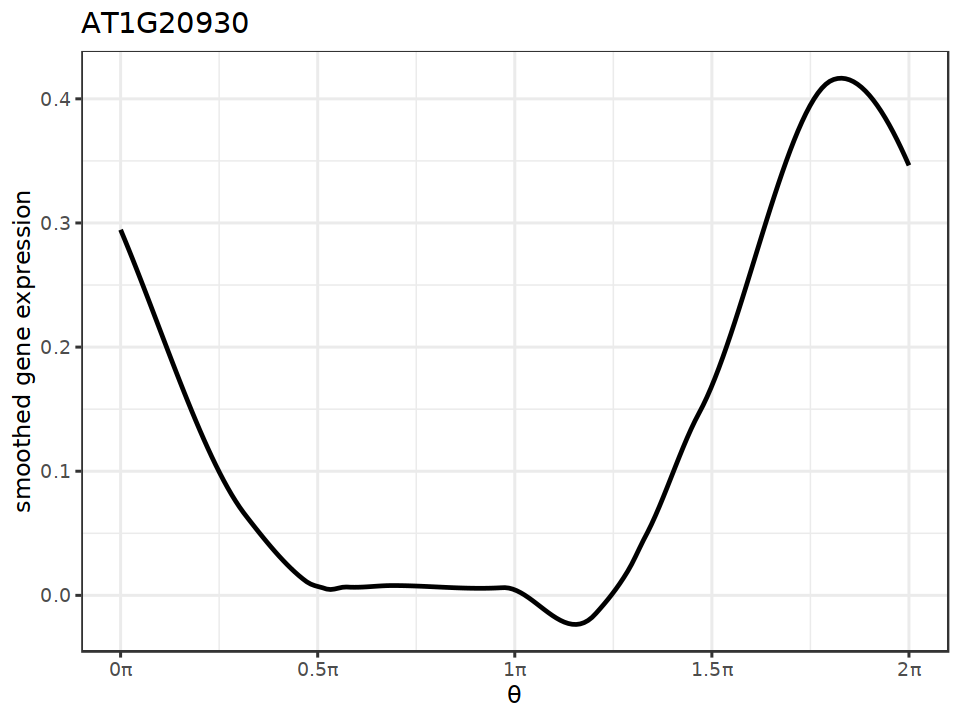

...

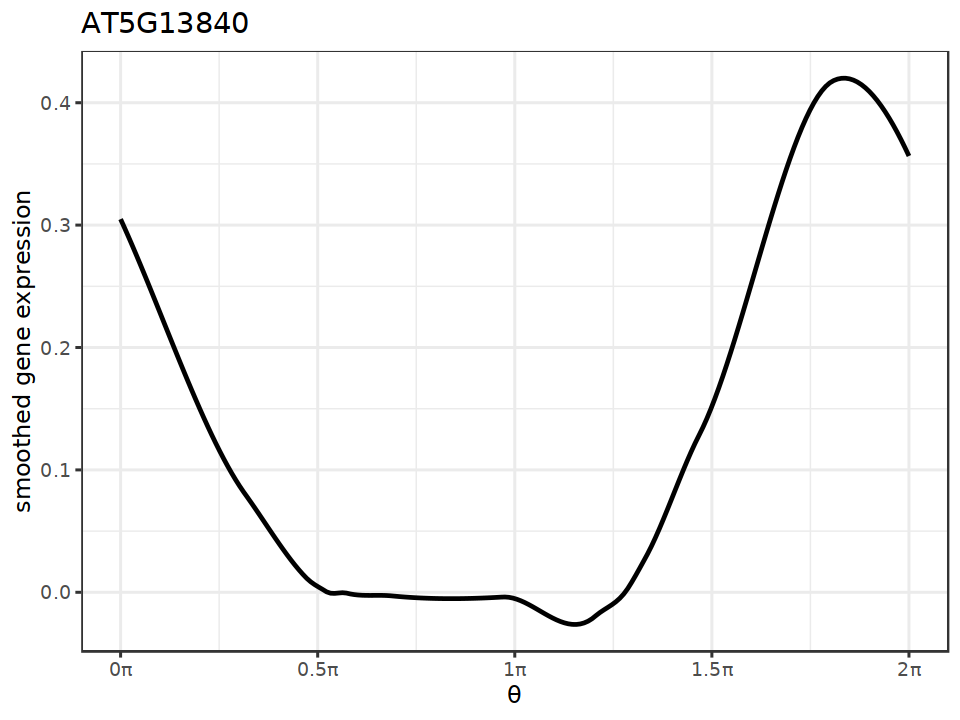

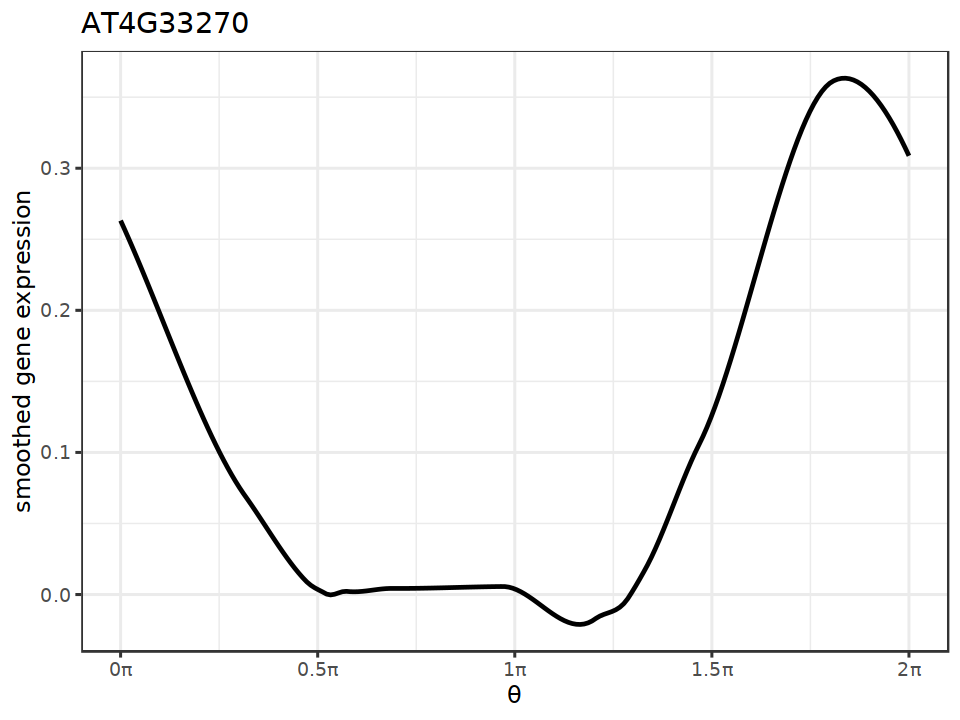

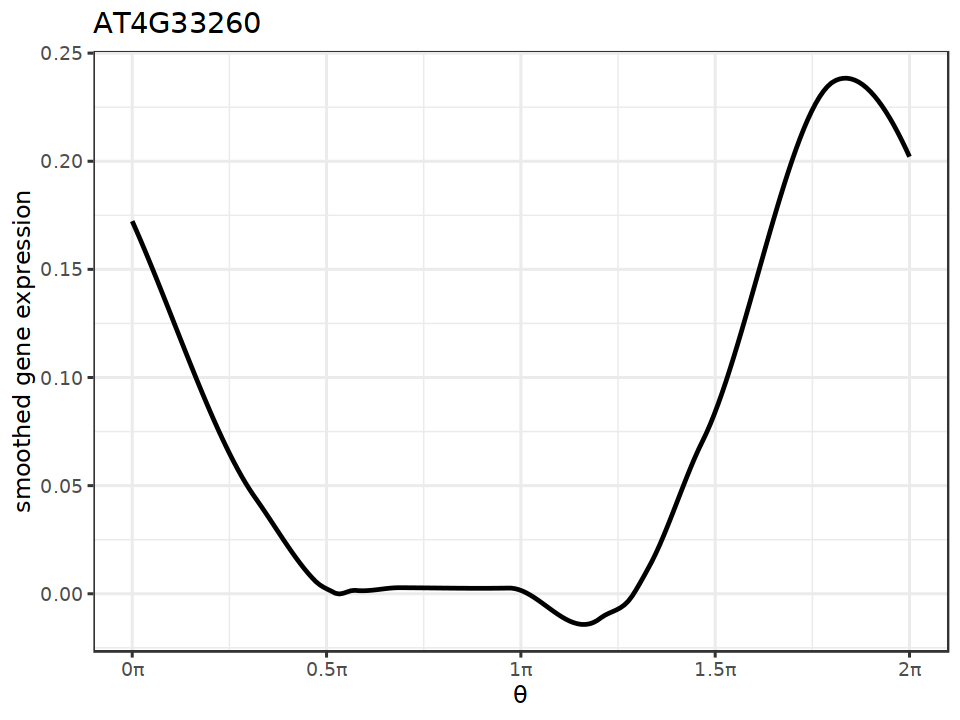

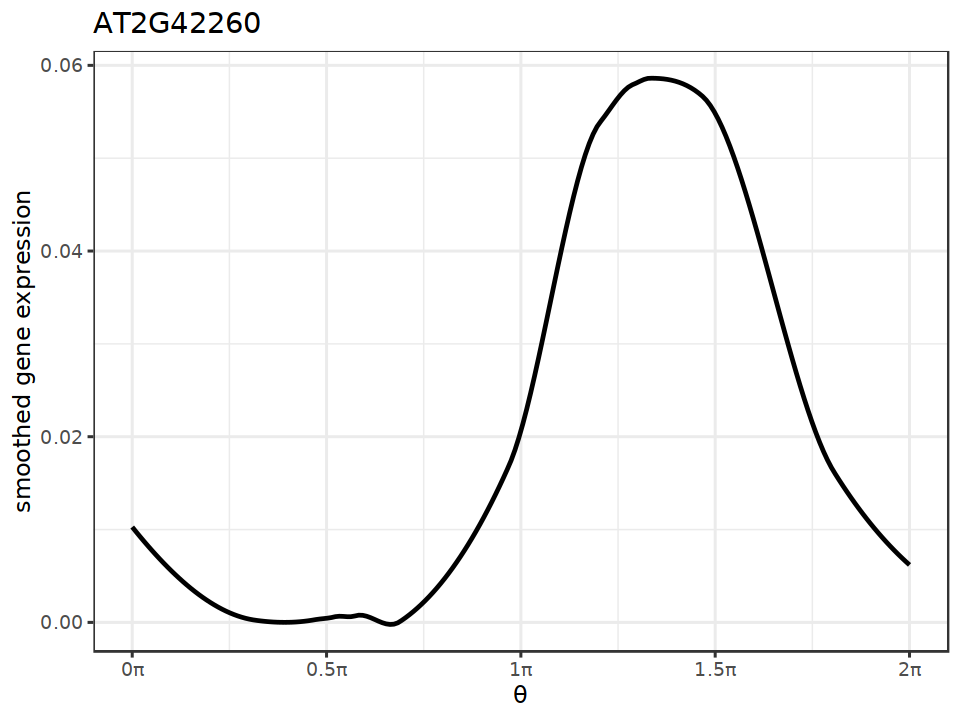

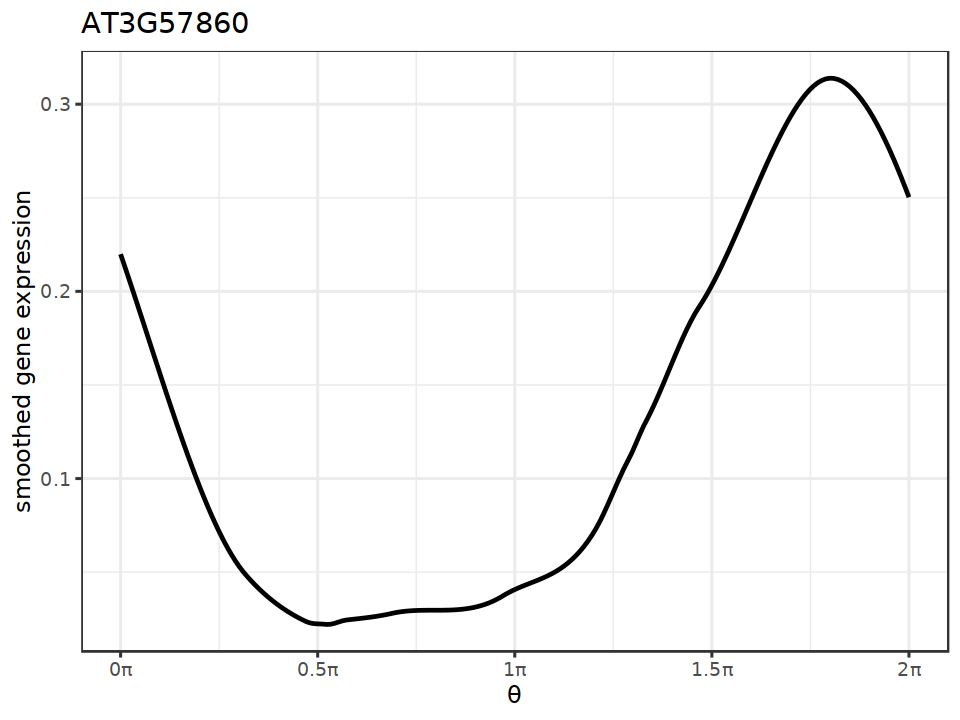

In [25]:
for (i in core$GeneID){
    pltsg(i)
}

In [18]:
summary(rc.integrated$tricyclePosition)

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
0.0001587 0.5355870 0.9693565 0.9651318 1.3160821 1.9997119 

In [99]:
## tricycle group 50
rc.integrated$tricycle_group <- rep("T0",ncol(rc.integrated))
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.0) & (rc.integrated$tricyclePosition <= 0.04)] <- "T1"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.04) & (rc.integrated$tricyclePosition <= 0.08)] <- "T2"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.08) & (rc.integrated$tricyclePosition <= 0.12)] <- "T3"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.12) & (rc.integrated$tricyclePosition <= 0.16)] <- "T4"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.16) & (rc.integrated$tricyclePosition <= 0.2)] <- "T5"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.2) & (rc.integrated$tricyclePosition <= 0.24)] <- "T6"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.24) & (rc.integrated$tricyclePosition <= 0.28)] <- "T7"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.28) & (rc.integrated$tricyclePosition <= 0.32)] <- "T8"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.32) & (rc.integrated$tricyclePosition <= 0.36)] <- "T9"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.36) & (rc.integrated$tricyclePosition <= 0.40)] <- "T10"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.40) & (rc.integrated$tricyclePosition <= 0.44)] <- "T11"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.44) & (rc.integrated$tricyclePosition <= 0.48)] <- "T12"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.48) & (rc.integrated$tricyclePosition <= 0.52)] <- "T13"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.52) & (rc.integrated$tricyclePosition <= 0.56)] <- "T14"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.56) & (rc.integrated$tricyclePosition <= 0.60)] <- "T15"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.60) & (rc.integrated$tricyclePosition <= 0.64)] <- "T16"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.64) & (rc.integrated$tricyclePosition <= 0.68)] <- "T17"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.68) & (rc.integrated$tricyclePosition <= 0.72)] <- "T18"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.72) & (rc.integrated$tricyclePosition <= 0.76)] <- "T19"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.76) & (rc.integrated$tricyclePosition <= 0.80)] <- "T20"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.80) & (rc.integrated$tricyclePosition <= 0.84)] <- "T21"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.84) & (rc.integrated$tricyclePosition <= 0.88)] <- "T22"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.88) & (rc.integrated$tricyclePosition <= 0.92)] <- "T23"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.92) & (rc.integrated$tricyclePosition <= 0.96)] <- "T24"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.96) & (rc.integrated$tricyclePosition <= 1.0)] <- "T25"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.0) & (rc.integrated$tricyclePosition <= 1.04)] <- "T26"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.04) & (rc.integrated$tricyclePosition <= 1.08)] <- "T27"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.08) & (rc.integrated$tricyclePosition <= 1.12)] <- "T28"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.12) & (rc.integrated$tricyclePosition <= 1.16)] <- "T29"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.16) & (rc.integrated$tricyclePosition <= 1.20)] <- "T30"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.20) & (rc.integrated$tricyclePosition <= 1.24)] <- "T31"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.24) & (rc.integrated$tricyclePosition <= 1.28)] <- "T32"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.28) & (rc.integrated$tricyclePosition <= 1.32)] <- "T33"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.32) & (rc.integrated$tricyclePosition <= 1.36)] <- "T34"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.36) & (rc.integrated$tricyclePosition <= 1.40)] <- "T35"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.40) & (rc.integrated$tricyclePosition <= 1.44)] <- "T36"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.44) & (rc.integrated$tricyclePosition <= 1.48)] <- "T37"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.48) & (rc.integrated$tricyclePosition <= 1.52)] <- "T38"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.52) & (rc.integrated$tricyclePosition <= 1.56)] <- "T39"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.56) & (rc.integrated$tricyclePosition <= 1.60)] <- "T40"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.60) & (rc.integrated$tricyclePosition <= 1.64)] <- "T41"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.64) & (rc.integrated$tricyclePosition <= 1.68)] <- "T42"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.68) & (rc.integrated$tricyclePosition <= 1.72)] <- "T43"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.72) & (rc.integrated$tricyclePosition <= 1.76)] <- "T44"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.76) & (rc.integrated$tricyclePosition <= 1.80)] <- "T45"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.80) & (rc.integrated$tricyclePosition <= 1.84)] <- "T46"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.84) & (rc.integrated$tricyclePosition <= 1.88)] <- "T47"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.88) & (rc.integrated$tricyclePosition <= 1.92)] <- "T48"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.92) & (rc.integrated$tricyclePosition <= 1.96)] <- "T49"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.96) & (rc.integrated$tricyclePosition <= 2.0)] <- "T50"

In [100]:
table(rc.integrated$tricycle_group)


  T1  T10  T11  T12  T13  T14  T15  T16  T17  T18  T19   T2  T20  T21  T22  T23 
 146  794 1707 2674 4156 3950 2668 1769 1268 1036  824  148  733  632  578  586 
 T24  T25  T26  T27  T28  T29   T3  T30  T31  T32  T33  T34  T35  T36  T37  T38 
 610  649  630  705  766  943  156 1217 1688 2620 4512 3113 1624  917  622  443 
 T39   T4  T40  T41  T42  T43  T44  T45  T46  T47  T48  T49   T5  T50   T6   T7 
 407  183  417  426  438  555  716 1130 1013  357  175  145  194  153  232  288 
  T8   T9 
 330  428 

In [102]:
rc.integrated

An object of class Seurat 
74352 features across 52471 samples within 3 assays 
Active assay: integrated (17479 features, 17479 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, umap_2D

In [103]:
rc.re <- CreateSeuratObject(rc.integrated@assays$SCT@data)
rc.re$tricycle_group <- rc.integrated$tricycle_group
Idents(rc.re) <- rc.re$tricycle_group
Clust_Markers <- FindAllMarkers(rc.re, only.pos = TRUE)

Calculating cluster T12

Calculating cluster T13

Calculating cluster T19

Calculating cluster T14

Calculating cluster T21

Calculating cluster T44

Calculating cluster T26

Calculating cluster T40

Calculating cluster T47

Calculating cluster T8

Calculating cluster T43

Calculating cluster T18

Calculating cluster T17

Calculating cluster T32

Calculating cluster T16

Calculating cluster T25

Calculating cluster T11

Calculating cluster T29

Calculating cluster T15

Calculating cluster T28

Calculating cluster T45

Calculating cluster T31

Calculating cluster T33

Calculating cluster T41

Calculating cluster T23

Calculating cluster T48

Calculating cluster T38

Calculating cluster T30

Calculating cluster T10

Calculating cluster T46

Calculating cluster T24

Calculating cluster T34

Calculating cluster T36

Calculating cluster T27

Calculating cluster T22

Calculating cluster T39

Calculating cluster T35

Calculating cluster T6

Calculating cluster T20

Calculating cluster T5

Cal

In [104]:
write.csv(Clust_Markers, "./tradeseq/Proliferation_Domain_tricycle_group_50_DE_raw.csv")

In [105]:
Clust_Markers <- Clust_Markers %>% filter(p_val_adj <0.01) %>% arrange(p_val_adj)

In [106]:
write.csv(Clust_Markers, "./tradeseq/Proliferation_Domain_tricycle_group_50_DE.csv")

In [107]:
#Clust_Markers <- read.csv("./tradeseq/Proliferation_Domain_tricycle_group_50_DE.csv")
Clust_Markers <- read.csv("./tradeseq/Proliferation_Domain_tricycle_group_50_DE_raw.csv")

In [108]:
Clust_Markers$pct_diff <- Clust_Markers$pct.1-Clust_Markers$pct.2
Clust_Markers$pct_1_rank <- rank(Clust_Markers$pct.1)
Clust_Markers$pct_diff_rank <- rank(Clust_Markers$pct_diff)
Clust_Markers$avg_log2FC_rank <- rank(Clust_Markers$avg_log2FC)
Clust_Markers$score <- Clust_Markers$pct_diff_rank + Clust_Markers$avg_log2FC_rank 
Clust_Markers <- Clust_Markers %>% arrange(desc(score))

In [109]:
t1 <- Clust_Markers$gene[Clust_Markers$cluster=="T1"]
t2 <- Clust_Markers$gene[Clust_Markers$cluster=="T2"]
t3 <- Clust_Markers$gene[Clust_Markers$cluster=="T3"]
t4 <- Clust_Markers$gene[Clust_Markers$cluster=="T4"]
t5 <- Clust_Markers$gene[Clust_Markers$cluster=="T5"]
t6 <- Clust_Markers$gene[Clust_Markers$cluster=="T6"]
t7 <- Clust_Markers$gene[Clust_Markers$cluster=="T7"]
t8 <- Clust_Markers$gene[Clust_Markers$cluster=="T8"]
t9 <- Clust_Markers$gene[Clust_Markers$cluster=="T9"]
t10 <- Clust_Markers$gene[Clust_Markers$cluster=="T10"]
t11 <- Clust_Markers$gene[Clust_Markers$cluster=="T11"]
t12 <- Clust_Markers$gene[Clust_Markers$cluster=="T12"]
t13 <- Clust_Markers$gene[Clust_Markers$cluster=="T13"]
t14 <- Clust_Markers$gene[Clust_Markers$cluster=="T14"]
t15 <- Clust_Markers$gene[Clust_Markers$cluster=="T15"]
t16 <- Clust_Markers$gene[Clust_Markers$cluster=="T16"]
t17 <- Clust_Markers$gene[Clust_Markers$cluster=="T17"]
t18 <- Clust_Markers$gene[Clust_Markers$cluster=="T18"]
t19 <- Clust_Markers$gene[Clust_Markers$cluster=="T19"]
t20 <- Clust_Markers$gene[Clust_Markers$cluster=="T20"]
t21 <- Clust_Markers$gene[Clust_Markers$cluster=="T21"]
t22 <- Clust_Markers$gene[Clust_Markers$cluster=="T22"]
t23 <- Clust_Markers$gene[Clust_Markers$cluster=="T23"]
t24 <- Clust_Markers$gene[Clust_Markers$cluster=="T24"]
t25 <- Clust_Markers$gene[Clust_Markers$cluster=="T25"]
t26 <- Clust_Markers$gene[Clust_Markers$cluster=="T26"]
t27 <- Clust_Markers$gene[Clust_Markers$cluster=="T27"]
t28 <- Clust_Markers$gene[Clust_Markers$cluster=="T28"]
t29 <- Clust_Markers$gene[Clust_Markers$cluster=="T29"]
t30 <- Clust_Markers$gene[Clust_Markers$cluster=="T30"]
t31 <- Clust_Markers$gene[Clust_Markers$cluster=="T31"]
t32 <- Clust_Markers$gene[Clust_Markers$cluster=="T32"]
t33 <- Clust_Markers$gene[Clust_Markers$cluster=="T33"]
t34 <- Clust_Markers$gene[Clust_Markers$cluster=="T34"]
t35 <- Clust_Markers$gene[Clust_Markers$cluster=="T35"]
t36 <- Clust_Markers$gene[Clust_Markers$cluster=="T36"]
t37 <- Clust_Markers$gene[Clust_Markers$cluster=="T37"]
t38 <- Clust_Markers$gene[Clust_Markers$cluster=="T38"]
t39 <- Clust_Markers$gene[Clust_Markers$cluster=="T39"]
t40 <- Clust_Markers$gene[Clust_Markers$cluster=="T40"]
t41 <- Clust_Markers$gene[Clust_Markers$cluster=="T41"]
t42 <- Clust_Markers$gene[Clust_Markers$cluster=="T42"]
t43 <- Clust_Markers$gene[Clust_Markers$cluster=="T43"]
t44 <- Clust_Markers$gene[Clust_Markers$cluster=="T44"]
t45 <- Clust_Markers$gene[Clust_Markers$cluster=="T45"]
t46 <- Clust_Markers$gene[Clust_Markers$cluster=="T46"]
t47 <- Clust_Markers$gene[Clust_Markers$cluster=="T47"]
t48 <- Clust_Markers$gene[Clust_Markers$cluster=="T48"]
t49 <- Clust_Markers$gene[Clust_Markers$cluster=="T49"]
t50 <- Clust_Markers$gene[Clust_Markers$cluster=="T50"]

In [110]:
genes_to_plt <- c(t1,t2,t3,t4,t5,t6,t7,t8,t9,t10,t11,t12,t13,t14,t15,t16,t17,t18,t19,t20,t21,t22,t23,t24,t25,t26,t27,t28,t29,t30,t31,t32,t33,t34,t35,t36,t37,t38,t39,t40,t41,t42,t43,t44,t45,t46,t47,t48,t49,t50)
genes_to_plt <- unique(genes_to_plt)
length(genes_to_plt)

[1] 2950

In [111]:
## plot heatmap
# pseudobulk of each stage of 

  afm <- as.matrix(rc.integrated@assays$SCT@data)
  pooled <- matrix(nrow=nrow(afm), ncol = 0)

  for (i in c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")) {
    m <- afm[,which(rc.integrated@meta.data$tricycle_group==i)]
    pooled <- cbind(pooled, rowSums(m)/ncol(m))
  }

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 10.2 GiB”


In [112]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [113]:
feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]

[1] "AT1G03740" "SMR8"      "CYCA2;3"   "CYCB3;1"   "CYCB2;3"   "CDKB2;2"  
 [7] "CYCA1;1"   "CYCA3;2"   "CYCB2;4"   "CDKB2;1"   "SKP2B"     "CYCA2;4"  
[13] "CYCB1;2"   "MYB3R4"    "FZR3"      "CYCA3;1"   "KRP3"      "CDKG1"    
[19] "CYCD3;2"   "E2FF"      "CYCB1;3"   "CDKB1;1"   "FBL17"     "GIG1"     
[25] "CYCB2;1"   "CYCB1;4"   "CDKB1;2"   "CDC20;2"   "CDC20;1"   "CYCB2;2"  
[31] "CYCB1;1"

In [114]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
CDKG1,355
SKP2B,867
AT1G03740,1243
SMR8,1248
CYCA3;2,1525
FBL17,1536
CYCA3;1,1691
KRP3,1886
GIG1,2495


`use_raster` is automatically set to TRUE for a matrix with more than
2000 rows. You can control `use_raster` argument by explicitly setting
TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.



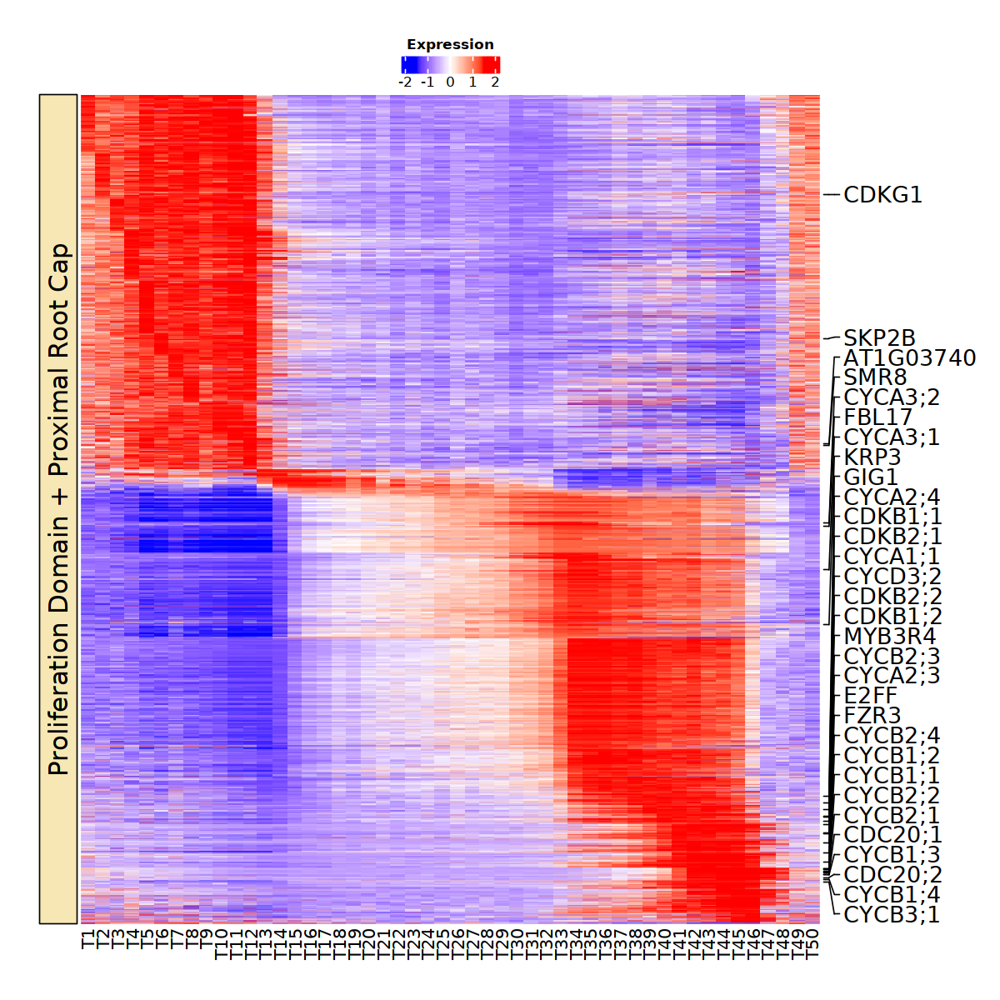

In [115]:
## Unique markers for each group
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [116]:
## core genes
genes_to_plt <- c(t1,t2,t3,t4,t5,t6,t7,t8,t9,t10,t11,t12,t13,t14,t15,t16,t17,t18,t19,t20,t21,t22,t23,t24,t25,t26,t27,t28,t29,t30,t31,t32,t33,t34,t35,t36,t37,t38,t39,t40,t41,t42,t43,t44,t45,t46,t47,t48,t49,t50)
genes_to_plt <- c(genes_to_plt,core$GeneID)
genes_to_plt <- unique(genes_to_plt)

length(genes_to_plt)

[1] 3038

In [117]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [118]:
feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]

[1] "WEE1"      "AT1G03740" "SMR5"      "SMR2"      "AT1G09600" "SMR8"     
  [7] "SDS"       "CYCA2;3"   "CYCB3;1"   "CDKD;3"    "IBS1"      "CYCB2;5"  
 [13] "CYCB2;3"   "CDKB2;2"   "SKP2A"     "CYCT1;3"   "AT1G33770" "CYCB1;5"  
 [19] "CYCA1;1"   "CYCA3;2"   "CYCA3;4"   "E2FC"      "KRP7"      "SMR9"     
 [25] "AT1G53050" "AT1G54610" "AT1G57700" "CDKD;2"    "AT1G67580" "CYCD1;1"  
 [31] "AT1G71530" "CDKD;1"    "AT1G74330" "CYCB2;4"   "CDKB2;1"   "SKP2B"    
 [37] "CYCA1;2"   "CYCA2;4"   "SMR4"      "MYB3R5"    "SMR3"      "DPA"      
 [43] "DPB"       "SIM"       "CYCB1;2"   "CYCU4;2"   "CDKC;1"    "CYCD4;2"  
 [49] "CYCA2;2"   "MYB3R4"    "FZR3"      "E2FD"      "E2FB"      "CYCA2;1"  
 [55] "CYCH;1"    "cdc2cAt"   "SMR6"      "CYCA3;1"   "AT5G44290" "AT5G45190"
 [61] "AT5G48630" "CYCC1;1"   "KRP3"      "AT5G50860" "CYCU4;3"   "CDKG1"    
 [67] "CDKE;1"    "CDKC;2"    "CYCD4;1"   "CYCD3;2"   "E2FF"      "AT3G05050"
 [73] "MYB3R;3"   "SMR1"      "CYCB1;3"   "RBR1"      "KRP6"      "KRP5"     
 [79] "SMR7"      "E2FE"      "CDKA;1"    "CYCD3;3"   "KRP2"      "CDKB1;1"  
 [85] "FBL17"     "GIG1"      "CYCU2;2"   "CYCU3;1"   "CYCJ18"    "CYCB2;1"  
 [91] "CYCD2;1"   "KRP1"      "CYCL1;1"   "CYCB1;4"   "SMR11"     "SMR10"    
 [97] "KRP4"      "E2F3"      "SMR12"     "CDKB1;2"   "PYM"       "CYCU4;1"  
[103] "CYCU2;1"   "MYB3R2"    "CYCD6;1"   "AT4G10010" "FZR1"      "CYCT1;2"  
[109] "CYCT1;4"   "FZR2"      "AT4G22940" "CDKF;1"    "PC;MYB1"   "CDC20;2"  
[115] "CDC20;1"   "CYCD3;1"   "CYCB2;2"   "CYCB1;1"   "CYCD5;1"

In [119]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
CDKG1,355
SKP2B,867
AT1G03740,1243
SMR8,1248
KRP1,1393
CYCA3;2,1525
FBL17,1536
CYCA3;1,1691
KRP3,1886


`use_raster` is automatically set to TRUE for a matrix with more than
2000 rows. You can control `use_raster` argument by explicitly setting
TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.



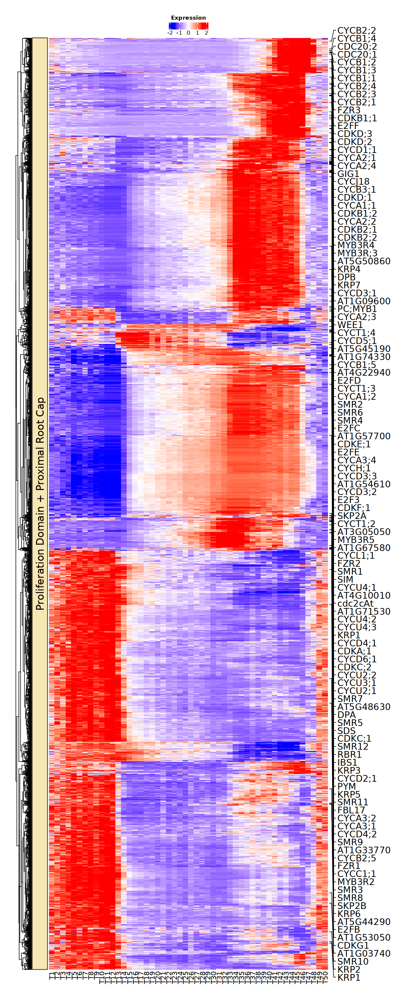

In [120]:
## Core CC genes
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=25)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

## Auxin

In [22]:
Clust_Markers <- read.csv("./tradeseq/Proliferation_Domain_tricycle_group_50_DE_raw.csv")

In [37]:
genes_to_plt <- intersect(Clust_Markers$gene, AL$GeneID)

In [23]:
## tricycle group 50
rc.integrated$tricycle_group <- rep("T0",ncol(rc.integrated))
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.0) & (rc.integrated$tricyclePosition <= 0.04)] <- "T1"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.04) & (rc.integrated$tricyclePosition <= 0.08)] <- "T2"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.08) & (rc.integrated$tricyclePosition <= 0.12)] <- "T3"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.12) & (rc.integrated$tricyclePosition <= 0.16)] <- "T4"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.16) & (rc.integrated$tricyclePosition <= 0.2)] <- "T5"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.2) & (rc.integrated$tricyclePosition <= 0.24)] <- "T6"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.24) & (rc.integrated$tricyclePosition <= 0.28)] <- "T7"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.28) & (rc.integrated$tricyclePosition <= 0.32)] <- "T8"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.32) & (rc.integrated$tricyclePosition <= 0.36)] <- "T9"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.36) & (rc.integrated$tricyclePosition <= 0.40)] <- "T10"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.40) & (rc.integrated$tricyclePosition <= 0.44)] <- "T11"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.44) & (rc.integrated$tricyclePosition <= 0.48)] <- "T12"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.48) & (rc.integrated$tricyclePosition <= 0.52)] <- "T13"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.52) & (rc.integrated$tricyclePosition <= 0.56)] <- "T14"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.56) & (rc.integrated$tricyclePosition <= 0.60)] <- "T15"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.60) & (rc.integrated$tricyclePosition <= 0.64)] <- "T16"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.64) & (rc.integrated$tricyclePosition <= 0.68)] <- "T17"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.68) & (rc.integrated$tricyclePosition <= 0.72)] <- "T18"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.72) & (rc.integrated$tricyclePosition <= 0.76)] <- "T19"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.76) & (rc.integrated$tricyclePosition <= 0.80)] <- "T20"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.80) & (rc.integrated$tricyclePosition <= 0.84)] <- "T21"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.84) & (rc.integrated$tricyclePosition <= 0.88)] <- "T22"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.88) & (rc.integrated$tricyclePosition <= 0.92)] <- "T23"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.92) & (rc.integrated$tricyclePosition <= 0.96)] <- "T24"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.96) & (rc.integrated$tricyclePosition <= 1.0)] <- "T25"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.0) & (rc.integrated$tricyclePosition <= 1.04)] <- "T26"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.04) & (rc.integrated$tricyclePosition <= 1.08)] <- "T27"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.08) & (rc.integrated$tricyclePosition <= 1.12)] <- "T28"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.12) & (rc.integrated$tricyclePosition <= 1.16)] <- "T29"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.16) & (rc.integrated$tricyclePosition <= 1.20)] <- "T30"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.20) & (rc.integrated$tricyclePosition <= 1.24)] <- "T31"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.24) & (rc.integrated$tricyclePosition <= 1.28)] <- "T32"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.28) & (rc.integrated$tricyclePosition <= 1.32)] <- "T33"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.32) & (rc.integrated$tricyclePosition <= 1.36)] <- "T34"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.36) & (rc.integrated$tricyclePosition <= 1.40)] <- "T35"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.40) & (rc.integrated$tricyclePosition <= 1.44)] <- "T36"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.44) & (rc.integrated$tricyclePosition <= 1.48)] <- "T37"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.48) & (rc.integrated$tricyclePosition <= 1.52)] <- "T38"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.52) & (rc.integrated$tricyclePosition <= 1.56)] <- "T39"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.56) & (rc.integrated$tricyclePosition <= 1.60)] <- "T40"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.60) & (rc.integrated$tricyclePosition <= 1.64)] <- "T41"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.64) & (rc.integrated$tricyclePosition <= 1.68)] <- "T42"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.68) & (rc.integrated$tricyclePosition <= 1.72)] <- "T43"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.72) & (rc.integrated$tricyclePosition <= 1.76)] <- "T44"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.76) & (rc.integrated$tricyclePosition <= 1.80)] <- "T45"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.80) & (rc.integrated$tricyclePosition <= 1.84)] <- "T46"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.84) & (rc.integrated$tricyclePosition <= 1.88)] <- "T47"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.88) & (rc.integrated$tricyclePosition <= 1.92)] <- "T48"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.92) & (rc.integrated$tricyclePosition <= 1.96)] <- "T49"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.96) & (rc.integrated$tricyclePosition <= 2.0)] <- "T50"

In [24]:
## plot heatmap
# pseudobulk of each stage of 

  afm <- as.matrix(rc.integrated@assays$SCT@data)
  pooled <- matrix(nrow=nrow(afm), ncol = 0)

  for (i in c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")) {
    m <- afm[,which(rc.integrated@meta.data$tricycle_group==i)]
    pooled <- cbind(pooled, rowSums(m)/ncol(m))
  }

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 10.2 GiB”


In [38]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [39]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(AL$GeneID, genes_to_plt)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
IAA17,1
IAA7,2
ILL6,3
IAA16,4
ILR1,5
YUC8,6
AT5G53590,7
ILL4,8
ASA1,9


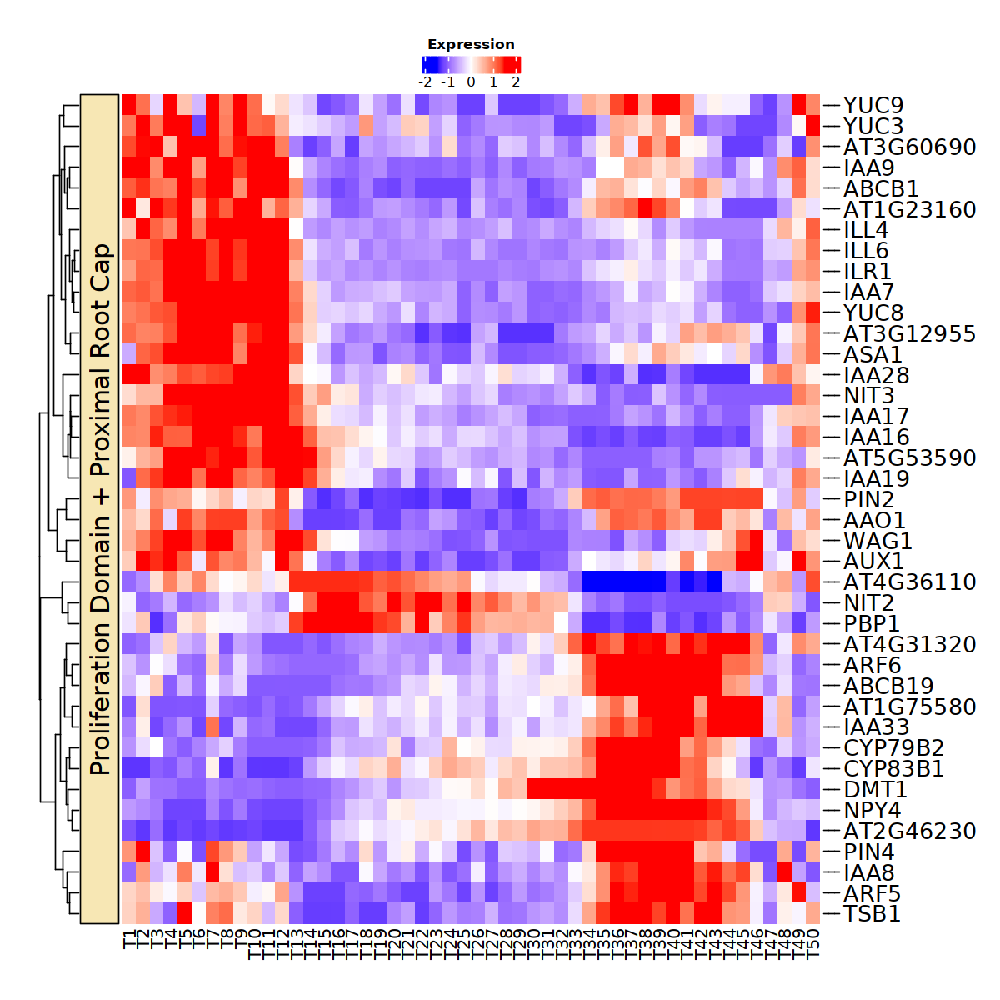

In [26]:
## Auxin genes
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [52]:
AL$cell_cycle_association <- rep("No",nrow(AL))
AL$cell_cycle_association[AL$GeneID %in% genes_to_plt]="Yes"

In [55]:
head(AL) 

,GeneID,GeneName,Functions,Pathways,cell_cycle_association
,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT5G05730,WEI2/ASA1 (ANTHRANILATE SYNTHASE ALPHA SUBUNIT 1),Auxin metabolism,Tryptophan pathway,Yes
2,AT2G29690,ATHANSYNAB__ASA2 (ANTHRANILATE SYNTHASE 2); anthranilate synthase,Auxin metabolism,Tryptophan pathway,No
3,AT1G25220,WEI7/ASB1 (ANTHRANILATE SYNTHASE BETA SUBUNIT 1),Auxin metabolism,Tryptophan pathway,No
4,AT5G17990,TRP1 (tryptophan biosynthesis 1),Auxin metabolism,Tryptophan pathway,No
5,AT5G05590,PAI2 (PHOSPHORIBOSYLANTHRANILATE ISOMERASE 2),Auxin metabolism,Tryptophan pathway,No
6,AT1G29410,PAI3 (phosphoribosylanthranilate isomerase 3); phosphoribosylanthranilate isomerase,Auxin metabolism,Tryptophan pathway,No


In [56]:
write.csv(AL, "./tradeseq/Auxin_genes_cell_cycle.csv")

### Auxin responsive genes

In [36]:
AR <- read.csv("./tradeseq/Auxin_responsive_genes.csv")
AR <- AR[AR$GeneID %in% rownames(rc.integrated@assays$SCT@data),]

In [37]:
AR_up <- AR %>% filter(Regulation == "Up")
AR_up <- AR_up$GeneID
AR_down <- AR %>% filter(Regulation == "Down")
AR_down <- AR_down$GeneID

In [136]:
genes_to_plt <- intersect(Clust_Markers$gene, AR_up)

In [137]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [138]:
# genes to mark on side of heatmap

mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(AR_up, genes_to_plt)])

Joining with `by = join_by(gene)`


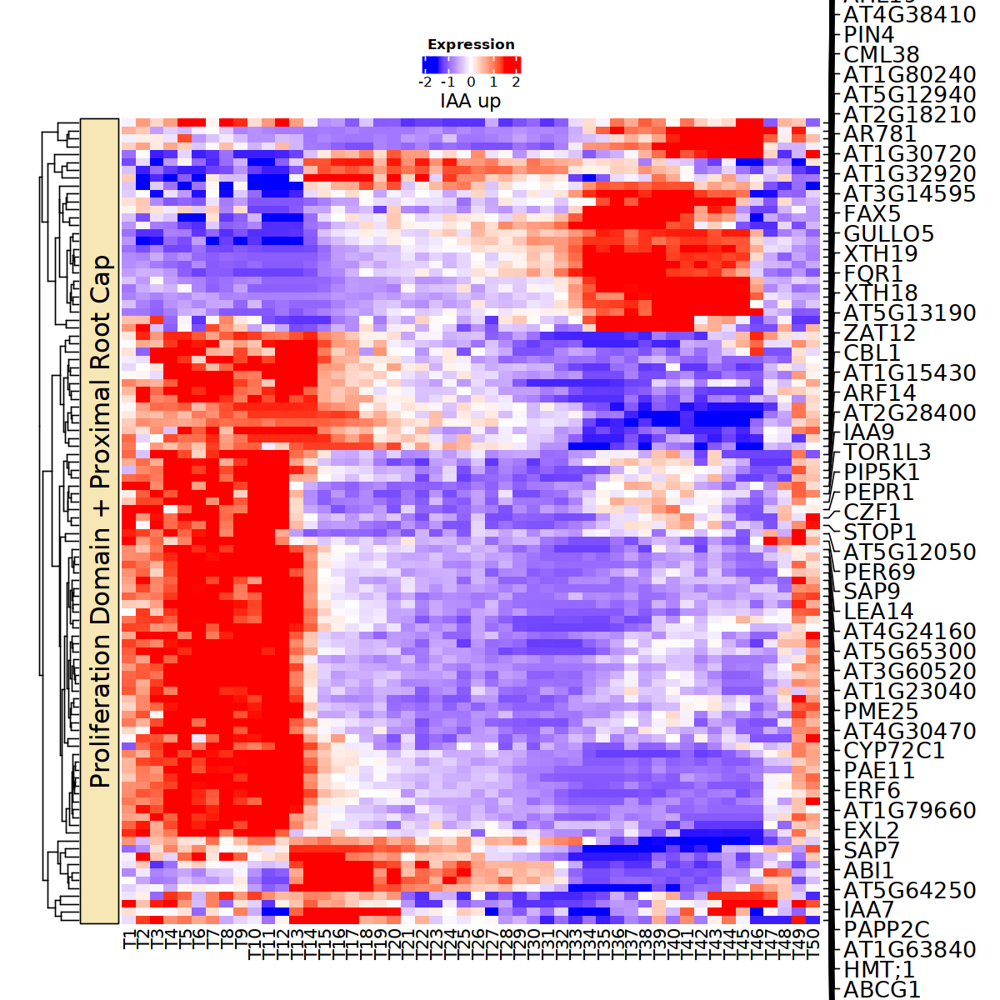

In [139]:
## Auxin_up
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                column_title="IAA up",
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [140]:
AR$cell_cycle_association <- rep("No",nrow(AR))
AR$cell_cycle_association[AR$GeneID %in% genes_to_plt]="Yes"

In [141]:
genes_to_plt <- intersect(Clust_Markers$gene, AR_down)

In [142]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [143]:
# genes to mark on side of heatmap

mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(AR_down, genes_to_plt)])

Joining with `by = join_by(gene)`


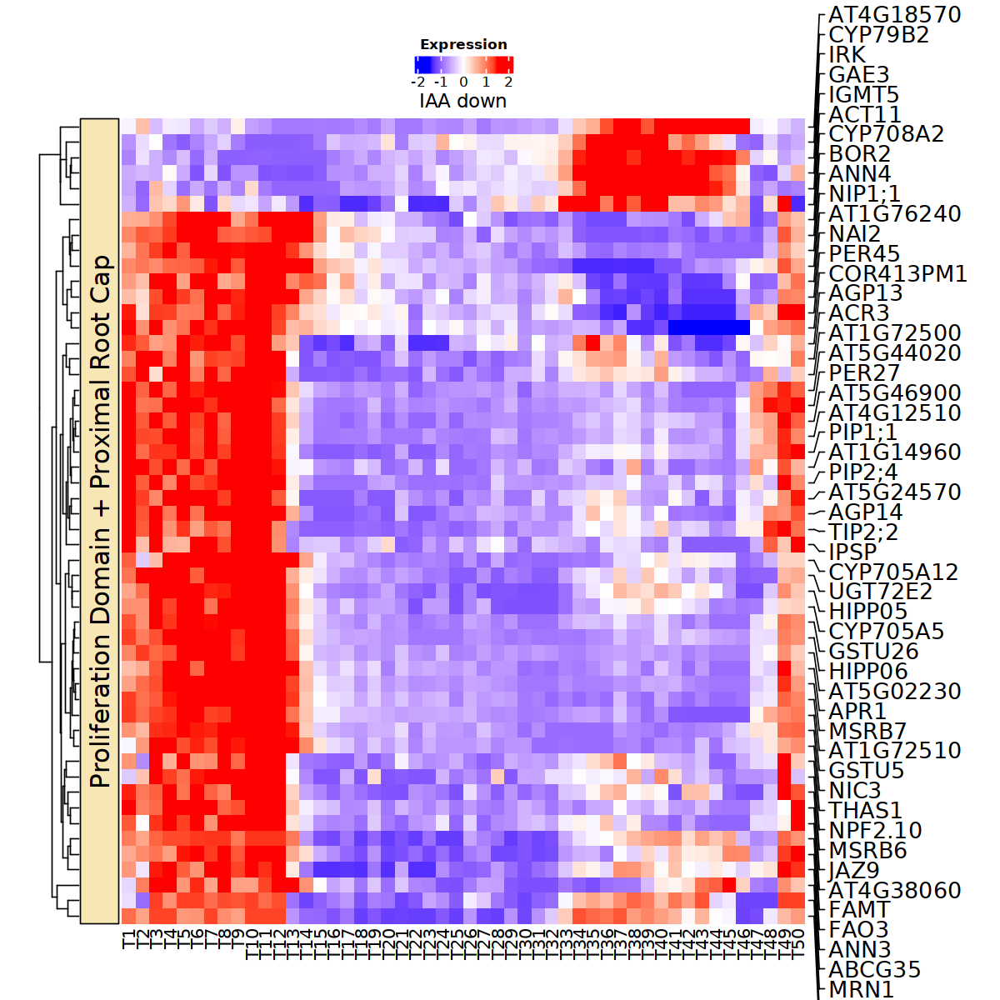

In [144]:
## Auxin_down
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                column_title="IAA down",
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [145]:
AR$cell_cycle_association[AR$GeneID %in% genes_to_plt]="Yes"

In [146]:
write.csv(AR, "./tradeseq/Auxin_responsive_genes_cell_cycle.csv")

## Cytokinin

In [63]:
genes_to_plt <- intersect(Clust_Markers$gene, CL$GeneID)

In [64]:
genes_to_plt

[1] "AT5G06300" "AT3G16857" "AT5G03300" "AT3G09820" "AT1G19770"

In [65]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [66]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(CL$GeneID, genes_to_plt)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
LOG7,1
ARR1,2
ADK2,3
ADK1,4
PUP14,5


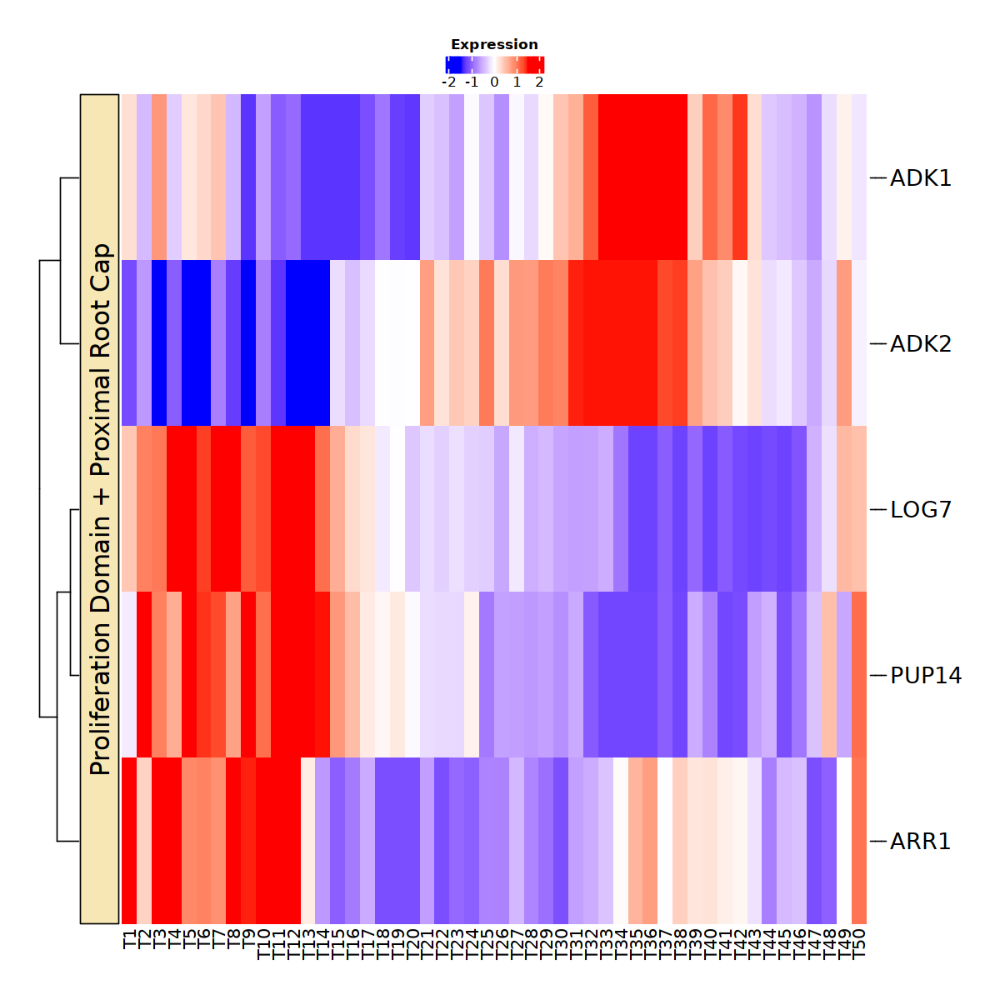

In [67]:
## CK genes
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [68]:
CL$cell_cycle_association <- rep("No",nrow(CL))
CL$cell_cycle_association[CL$GeneID %in% genes_to_plt]="Yes"

In [69]:
write.csv(CL, "./tradeseq/Cytokinin_genes_cell_cycle.csv")

### Cytokinin repsonsive genes

In [20]:
#CR <- read.csv("./tradeseq/Cytokinin_responsive_genes.csv")
CR <- read.csv("./tradeseq/CK_response_genes_bert.csv")
CR <- CR[CR$GeneID %in% rownames(rc.integrated@assays$SCT@data),]

In [21]:
CR_up <- CR %>% filter(Regulation == "Up")
CR_up <- CR_up$GeneID
CR_down <- CR %>% filter(Regulation == "Down")
CR_down <- CR_down$GeneID

In [25]:
genes_to_plt <- intersect(Clust_Markers$gene, CR_up)

In [26]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [27]:
# genes to mark on side of heatmap

mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(CR_up, genes_to_plt)])

Joining with `by = join_by(gene)`


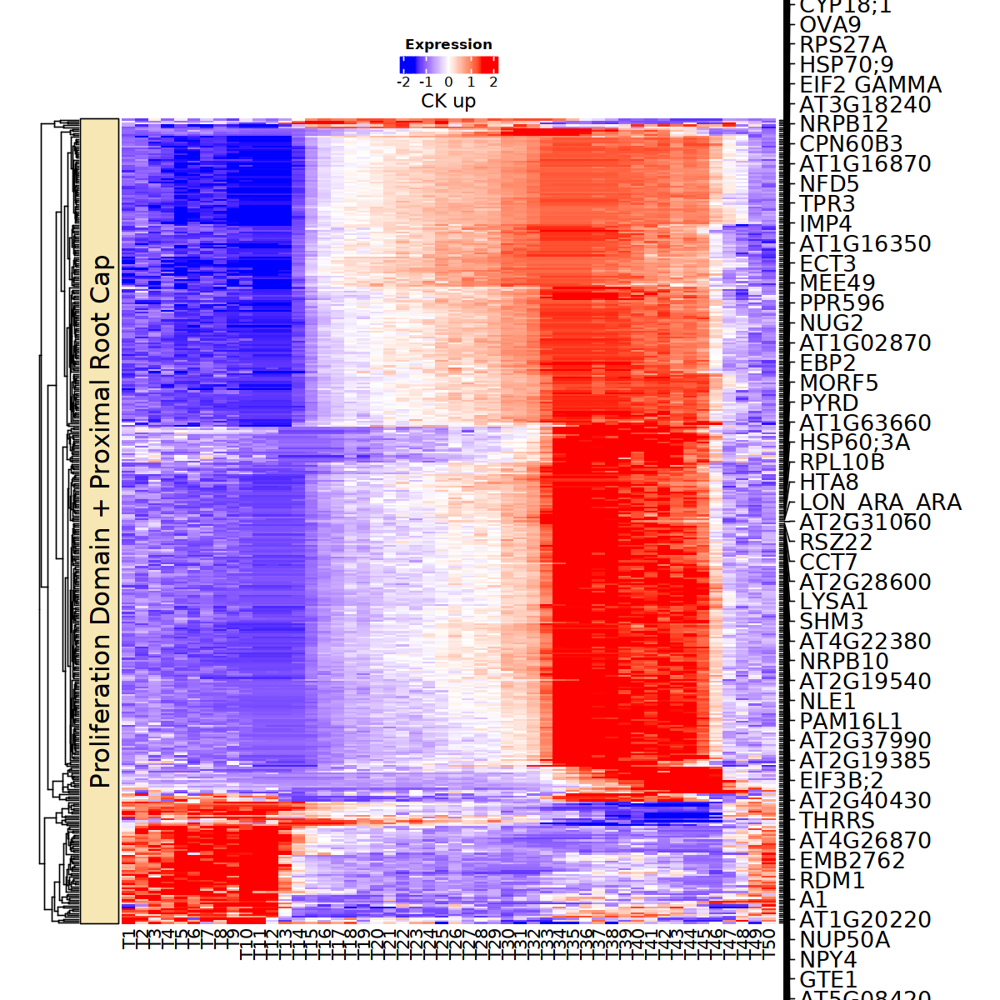

In [28]:
## CK_up
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                column_title="CK up",
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [29]:
CR$cell_cycle_association <- rep("No",nrow(CR))
CR$cell_cycle_association[CR$GeneID %in% genes_to_plt]="Yes"

In [30]:
genes_to_plt <- intersect(Clust_Markers$gene, CR_down)

In [31]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10",
             "T11", "T12", "T13", "T14", "T15", "T16", "T17", "T18", "T19", "T20",
             "T21", "T22", "T23", "T24", "T25", "T26", "T27", "T28", "T29", "T30",
             "T31", "T32", "T33", "T34", "T35", "T36", "T37", "T38", "T39", "T40",
             "T41", "T42", "T43", "T44", "T45", "T46", "T47", "T48", "T49", "T50")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [32]:
# genes to mark on side of heatmap

mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(CR_down, genes_to_plt)])

Joining with `by = join_by(gene)`


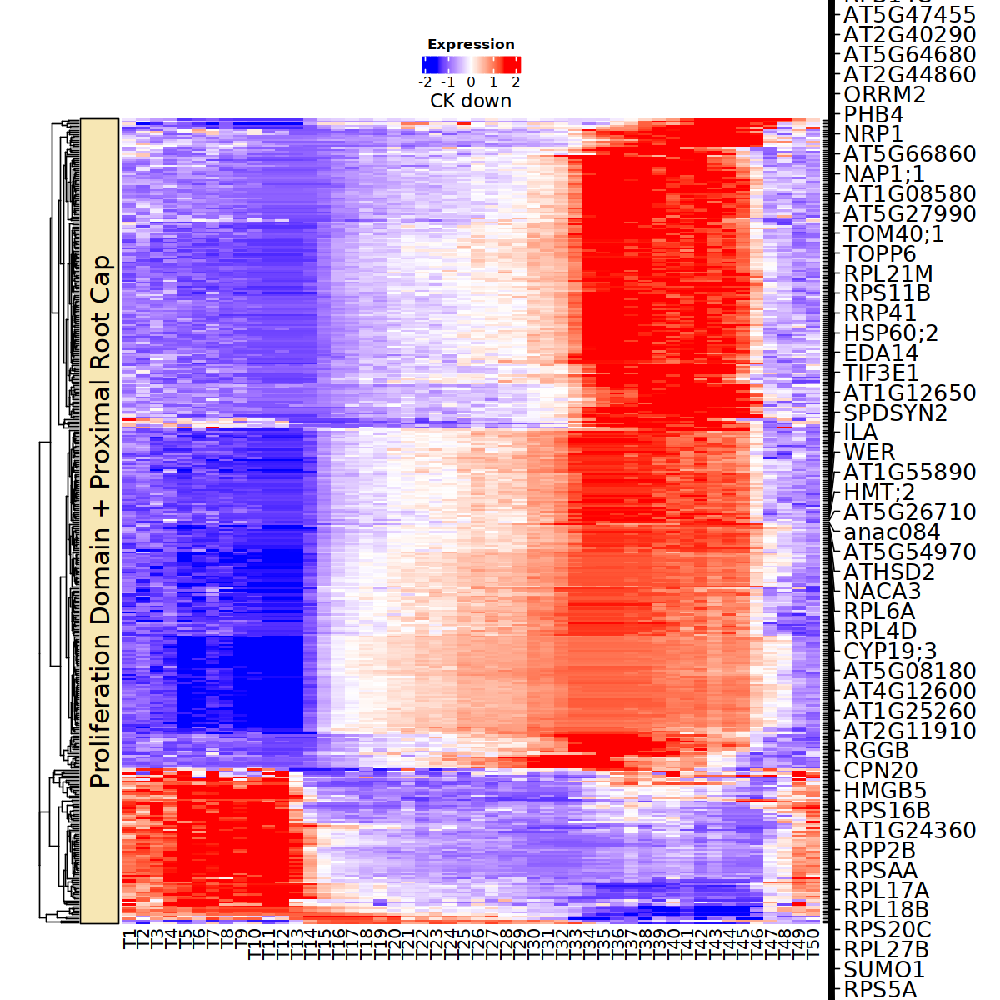

In [33]:
## CK_down
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=T,
                column_title="CK down",
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [34]:
CR$cell_cycle_association[CR$GeneID %in% genes_to_plt]="Yes"

In [35]:
write.csv(CR, "./tradeseq/CK_response_genes_bert_cell_cycle.csv")

## tricycle group 10

In [26]:
rc.integrated$tricycle_group <- rep("T0",ncol(rc.integrated))
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.0) & (rc.integrated$tricyclePosition <= 0.2)] <- "T1"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.2) & (rc.integrated$tricyclePosition <= 0.4)] <- "T2"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.4) & (rc.integrated$tricyclePosition <= 0.6)] <- "T3"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.6) & (rc.integrated$tricyclePosition <= 0.8)] <- "T4"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 0.8) & (rc.integrated$tricyclePosition <= 1.0)] <- "T5"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.0) & (rc.integrated$tricyclePosition <= 1.2)] <- "T6"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.2) & (rc.integrated$tricyclePosition <= 1.4)] <- "T7"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.4) & (rc.integrated$tricyclePosition <= 1.6)] <- "T8"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.6) & (rc.integrated$tricyclePosition <= 1.8)] <- "T9"
rc.integrated$tricycle_group[(rc.integrated$tricyclePosition > 1.8) & (rc.integrated$tricyclePosition <= 2.0)] <- "T10"

In [27]:
table(rc.integrated$tricycle_group)


   T1   T10    T2    T3    T4    T5    T6    T7    T8    T9 
  827  1843  2072 15155  5630  3055  4261 13557  2806  3265 

In [53]:
rc.re <- CreateSeuratObject(rc.integrated@assays$SCT@data)
rc.re$tricycle_group <- rc.integrated$tricycle_group
Idents(rc.re) <- rc.re$tricycle_group
Clust_Markers <- FindAllMarkers(rc.re, only.pos = TRUE)

Calculating cluster T3

Calculating cluster T4

Calculating cluster T5

Calculating cluster T9

Calculating cluster T6

Calculating cluster T8

Calculating cluster T10

Calculating cluster T2

Calculating cluster T7

Calculating cluster T1



In [58]:
table(Clust_Markers$cluster)


 T3  T4  T5  T9  T6  T8 T10  T2  T7  T1 
600  22   4 669  12 678 225 698 744 379 

In [59]:
temp <- Clust_Markers %>% filter(p_val_adj <0.01) %>% arrange(p_val_adj)

In [60]:
table(temp$cluster)


 T3  T4  T5  T9  T6  T8 T10  T2  T7  T1 
599  21   4 669  12 677 224 696 741 363 

In [61]:
Clust_Markers <- Clust_Markers %>% filter(p_val_adj <0.01) %>% arrange(p_val_adj)

In [62]:
write.csv(Clust_Markers, "./tradeseq/Proliferation_Domain_tricycle_group_10_DE.csv")

In [497]:
Clust_Markers <- read.csv("./tradeseq/Proliferation_Domain_tricycle_group_10_DE.csv")

In [498]:
Phase_Markers <- read.csv("./tradeseq/tricycle_markers_CC_Proliferation_domain_only_FindMarkers_18S_WT_cell_cycle_seu4_245_genes_Goldy_Zhang_AMIGO_20230911_cwh_RS.csv")

In [499]:
Modules <- read.csv("./tradeseq/All_genes_All_celltypes_tricycle_module_membership.csv")

In [500]:
head(Clust_Markers)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,AT1G52060,0,1.800354,0.519,0.314,0,T3,AT1G52060
2,AT1G52050,0,1.746516,0.518,0.306,0,T3,AT1G52050
3,AT1G52070,0,1.583873,0.699,0.500,0,T3,AT1G52070
4,AT5G54370,0,1.498317,0.623,0.444,0,T3,AT5G54370
5,AT5G60530,0,1.391631,0.621,0.420,0,T3,AT5G60530
6,AT4G15160,0,1.342413,0.640,0.503,0,T3,AT4G15160


In [501]:
table(Clust_Markers$cluster)


 T1 T10  T2  T3  T4  T5  T6  T7  T8  T9 
363 224 696 599  21   4  12 741 677 669 

In [502]:
head(Phase_Markers)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,Name,Laura_CC_phase,Zhang_2021_CC_phase,BES1_BZR1_target,Ref_245_gene,marker,Che_Wei_Picks,cloning
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<lgl>,<chr>,<chr>,<chr>
1,13,0.00e+00,0.9648551,0.362,0.205,0.00e+00,G1/G0,AT5G06860,PGIP1,NA,NA,FALSE,FALSE,,G1,TN
2,85,0.00e+00,0.6023157,0.553,0.387,0.00e+00,G1/G0,AT5G10695,AT5G10695,NA,NA,FALSE,FALSE,,G1,
3,96,0.00e+00,0.5690786,0.298,0.156,0.00e+00,G1/G0,AT1G17860,KTI2,NA,NA,FALSE,FALSE,,G1,RS
4,342,1.42e-267,0.5664160,0.188,0.086,3.71e-263,G1/G0,AT1G05560,UGT1,NA,NA,FALSE,FALSE,,G1,
5,288,8.19e-297,0.5080337,0.241,0.124,2.13e-292,G1/G0,AT3G12510,AT3G12510,NA,NA,FALSE,FALSE,,G1,
6,399,1.62e-236,0.3748879,0.185,0.089,4.23e-232,G1/G0,AT2G22880,AT2G22880,NA,NA,FALSE,FALSE,,G1,RS


In [503]:
head(Modules)

,X,rowname,kME_G1.M1,kME_G1.M2,kME_G1S.M3,kME_S.M4,kME_SG2M.M5,kME_G2M.M6,kME_G1SG2M.M7,gene_id,colors,module,BES_up,BES_down,MYB3R4
,<int>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,1,AT1G01010,-0.5842969,-0.9459480,-0.4683457,0.50939309,0.9276447,0.4751209,0.6210018,AT1G01010,turquoise,SG2M-M5,No,No,No
2,2,AT1G01020,-0.8454519,-0.9864521,-0.6614017,0.40946451,0.9972257,0.6192816,0.4193987,AT1G01020,turquoise,SG2M-M5,No,No,No
3,3,AT1G01030,-0.9083475,-0.8248669,-0.8892514,0.03187881,0.8994131,0.8290249,0.3173202,AT1G01030,turquoise,SG2M-M5,No,No,No
4,4,AT1G01040,-0.8350844,-0.9753506,-0.6944880,0.36050876,0.9991437,0.6584731,0.4502847,AT1G01040,turquoise,SG2M-M5,No,No,No
5,5,AT1G01050,0.7545767,0.7485590,0.9673472,0.16731384,-0.8550865,-0.9474326,-0.5339975,AT1G01050,blue,G1S-M3,No,No,No
6,6,AT1G01060,-0.7359682,-0.9172160,-0.8025657,0.16062016,0.9740109,0.7963047,0.6282028,AT1G01060,turquoise,SG2M-M5,No,No,No


In [504]:
Clust_Markers <- Clust_Markers[Clust_Markers$gene %in% Phase_Markers$gene,]
Clust_Markers <- Clust_Markers[Clust_Markers$gene %in% Modules$gene_id,]

In [505]:
to_remove <- names(table(Clust_Markers$gene))[which(table(Clust_Markers$gene)!=1)]

In [506]:
Clust_Markers <- Clust_Markers %>% filter(! gene %in% to_remove)

In [507]:
table(Clust_Markers$cluster)


T10  T2  T3  T4  T7  T8  T9 
 32 102 147   7 237  90  99 

In [508]:
Clust_Markers$pct_diff <- Clust_Markers$pct.1-Clust_Markers$pct.2
Clust_Markers$pct_1_rank <- rank(Clust_Markers$pct.1)
Clust_Markers$pct_diff_rank <- rank(Clust_Markers$pct_diff)
Clust_Markers$avg_log2FC_rank <- rank(Clust_Markers$avg_log2FC)
Clust_Markers$score <- Clust_Markers$pct_diff_rank + Clust_Markers$avg_log2FC_rank 
Clust_Markers <- Clust_Markers %>% group_by(cluster) %>% arrange(desc(score)) %>% top_n(237, score)
Clust_Markers$cluster <- factor(Clust_Markers$cluster, levels=c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10"))
Clust_Markers <- Clust_Markers %>% arrange(desc(score)) %>% arrange(cluster) 

In [509]:
## plot heatmap
# pseudobulk of each stage of 

  afm <- as.matrix(rc.integrated@assays$SCT@data)
  pooled <- matrix(nrow=nrow(afm), ncol = 0)

  for (i in c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10")) {
    m <- afm[,which(rc.integrated@meta.data$tricycle_group==i)]
    pooled <- cbind(pooled, rowSums(m)/ncol(m))
  }

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 10.2 GiB”


In [510]:
genes_to_plt <- Clust_Markers$gene

In [511]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10")]
head(sub_m)

,T1,T2,T3,T4,T5,T6,T7,T8,T9,T10
AT3G16240,1.1458288,1.3009391,1.0345738,0.8315629,0.7947481,0.8077572,0.8001073,0.8091706,0.6822776,0.9316971
AT1G76070,0.4145230,0.5044791,0.3664637,0.2457308,0.2389784,0.2515240,0.2330476,0.2527381,0.2092858,0.2602494
AT3G11340,0.4233606,0.5009625,0.3734165,0.2558223,0.2552443,0.2598062,0.2662955,0.2605980,0.2480621,0.2943547
AT3G44860,0.5058851,0.6142119,0.4627136,0.3663031,0.3697610,0.3736248,0.4067678,0.4108123,0.3160601,0.3784849
AT2G18700,0.4264229,0.4832576,0.3904383,0.2300249,0.2281183,0.2366261,0.2439612,0.3029671,0.2983308,0.2619819
AT3G30390,0.4586379,0.5094511,0.4038311,0.2967372,0.2771303,0.2915560,0.2729374,0.2761653,0.2447532,0.2939349


In [512]:
# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

In [513]:
# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [514]:
feature_names$Name <- gsub("-",";",feature_names$Name) 

In [515]:
core$GeneName[core$GeneID %in% intersect(core$GeneID, Clust_Markers$gene)]

[1] "CDKB1;1" "CYCA2;3" "CYCA2;4" "CYCA3;2" "CYCB3;1" "SMR8"    "FBL17"

In [516]:
feature_names$Name[feature_names$gene %in% intersect(core$GeneID, Clust_Markers$gene)]

[1] "SMR8"    "CYCA2;3" "CYCB3;1" "CYCA3;2" "CYCA2;4" "CDKB1;1" "FBL17"

In [517]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(core$GeneID, Clust_Markers$gene)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
SMR8,217
CYCA3;2,277
FBL17,287
CYCA2;4,588
CDKB1;1,594
CYCA2;3,624
CYCB3;1,653


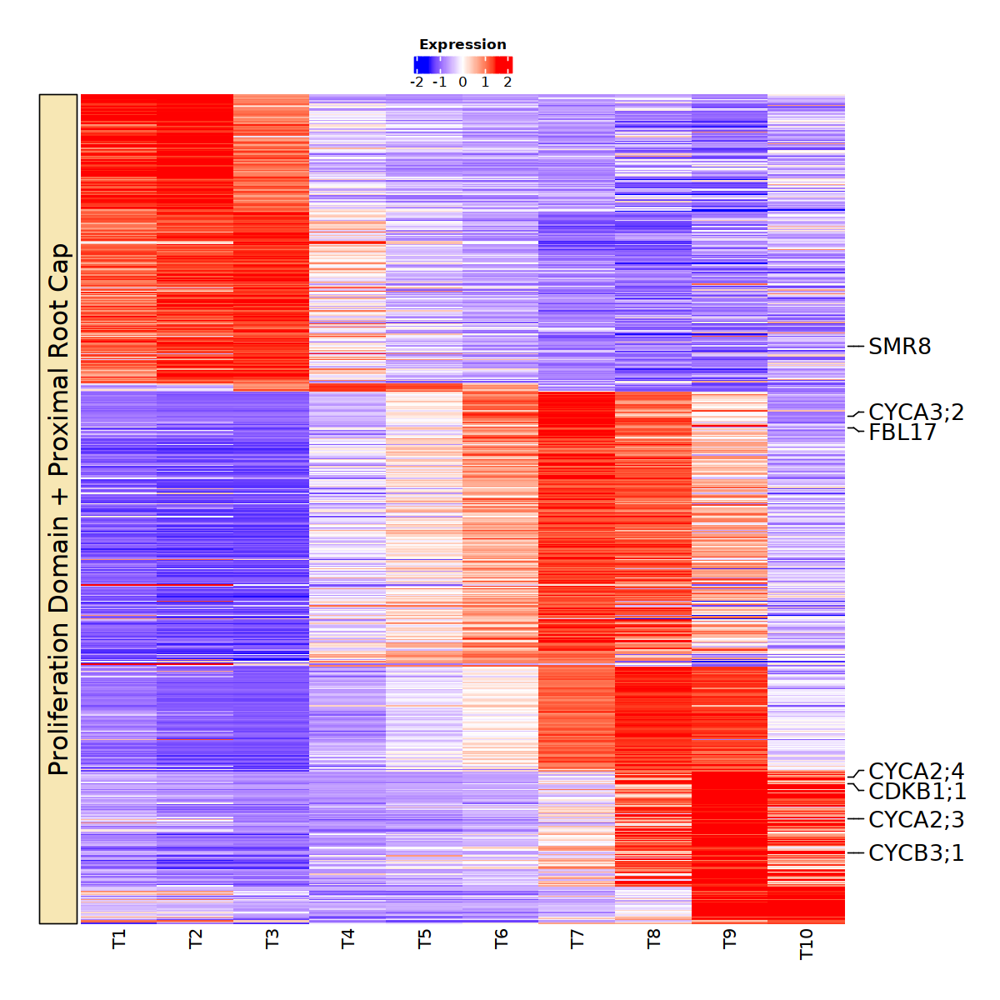

In [518]:
## Unique markers for each group
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [519]:
Clust_Markers <- read.csv("./tradeseq/Proliferation_Domain_tricycle_group_10_DE.csv")
Phase_Markers <- read.csv("./tradeseq/tricycle_markers_CC_Proliferation_domain_only_FindMarkers_18S_WT_cell_cycle_seu4_245_genes_Goldy_Zhang_AMIGO_20230911_cwh_RS.csv")
Modules <- read.csv("./tradeseq/All_genes_All_celltypes_tricycle_module_membership.csv")
Clust_Markers <- Clust_Markers[Clust_Markers$gene %in% Phase_Markers$gene,]
Clust_Markers <- Clust_Markers[Clust_Markers$gene %in% Modules$gene_id,]

In [520]:
Clust_Markers$pct_diff <- Clust_Markers$pct.1-Clust_Markers$pct.2
Clust_Markers$pct_1_rank <- rank(Clust_Markers$pct.1)
Clust_Markers$pct_diff_rank <- rank(Clust_Markers$pct_diff)
Clust_Markers$avg_log2FC_rank <- rank(Clust_Markers$avg_log2FC)
Clust_Markers$score <- Clust_Markers$pct_diff_rank + Clust_Markers$avg_log2FC_rank 
Clust_Markers <- Clust_Markers %>% arrange(desc(score))

In [521]:
t1 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T1"],Phase_Markers$gene[Phase_Markers$cluster=="G1/G0"])
t2 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T2"],Phase_Markers$gene[Phase_Markers$cluster=="G1/G0"])
t3 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T3"],Phase_Markers$gene[Phase_Markers$cluster=="G1/G0"])
t4 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T4"],Phase_Markers$gene[Phase_Markers$cluster=="G1/G0"])
t5 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T5"],Phase_Markers$gene[Phase_Markers$cluster=="G1/G0"])
t6 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T6"],Phase_Markers$gene[Phase_Markers$cluster=="S"])
t7 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T7"],Phase_Markers$gene[Phase_Markers$cluster=="S"])
t8 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T8"],Phase_Markers$gene[Phase_Markers$cluster=="S"])
t9 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T9"],Phase_Markers$gene[Phase_Markers$cluster=="G2M"])
t10 <- intersect(Clust_Markers$gene[Clust_Markers$cluster=="T10"],Phase_Markers$gene[Phase_Markers$cluster=="G2M"])

In [522]:
genes_to_plt <- c(t1,t2,t3,t4,t5,t6,t7,t8,t9,t10)
genes_to_plt <- genes_to_plt[!duplicated(genes_to_plt)]
length(genes_to_plt)

[1] 1912

In [523]:
colnames(pooled) <- c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10")

sub_m <- pooled[genes_to_plt, c("T1", "T2", "T3", "T4", "T5", "T6", "T7", "T8", "T9", "T10")]

# quantile normalize

mat = sub_m
mat2 = t(apply(mat, 1, function(x) {
    q10 = quantile(x, 0.1)
    q90 = quantile(x, 0.9)
    x[x < q10] = q10
    x[x > q90] = q90
    scale(x)
}))
colnames(mat2) = colnames(mat)

# side annotation with color to match umap

sa = rowAnnotation(foo = anno_block(gp = gpar(fill = "#f7e7b4"),
        labels = c("Proliferation Domain + Proximal Root Cap"), 
        labels_gp = gpar(col = "black", fontsize = 18)))
        
feature_names <- read_tsv("./Source_files/features.tsv.gz", col_names = c("gene", "Name", "Type")) %>%
  select(-Type) %>%
  distinct()

feature_names$Name <- gsub("-",";",feature_names$Name)

Rows: 32833 Columns: 3
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: "\t"
chr (3): gene, Name, Type

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [524]:
feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]

[1] "SMR8"    "CYCA2;3" "CYCB3;1" "CYCB2;3" "CDKB2;2" "CYCA1;1" "CYCA3;2"
 [8] "CYCB2;4" "CDKB2;1" "CYCA2;4" "CYCB1;2" "MYB3R4"  "FZR3"    "CDKG1"  
[15] "CYCB1;3" "CDKB1;1" "FBL17"   "GIG1"    "CYCB2;1" "CYCB1;4" "CDKB1;2"
[22] "CDC20;2" "CDC20;1" "CYCB2;2" "CYCB1;1"

In [525]:
# genes to mark on side of heatmap

(mat_for_mark <- data.frame(mat2) %>% 
 rownames_to_column("gene") %>%
 left_join(feature_names) %>% 
 mutate(index=dplyr::row_number()) %>%
select(Name, index) %>%
filter(Name %in% feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]))

Joining with `by = join_by(gene)`


Name,index
<chr>,<int>
CDKG1,102
SMR8,674
CYCA3;2,762
FBL17,854
CDKB2;1,1604
CDKB2;2,1605
CYCB2;3,1611
CYCA1;1,1613
FZR3,1623


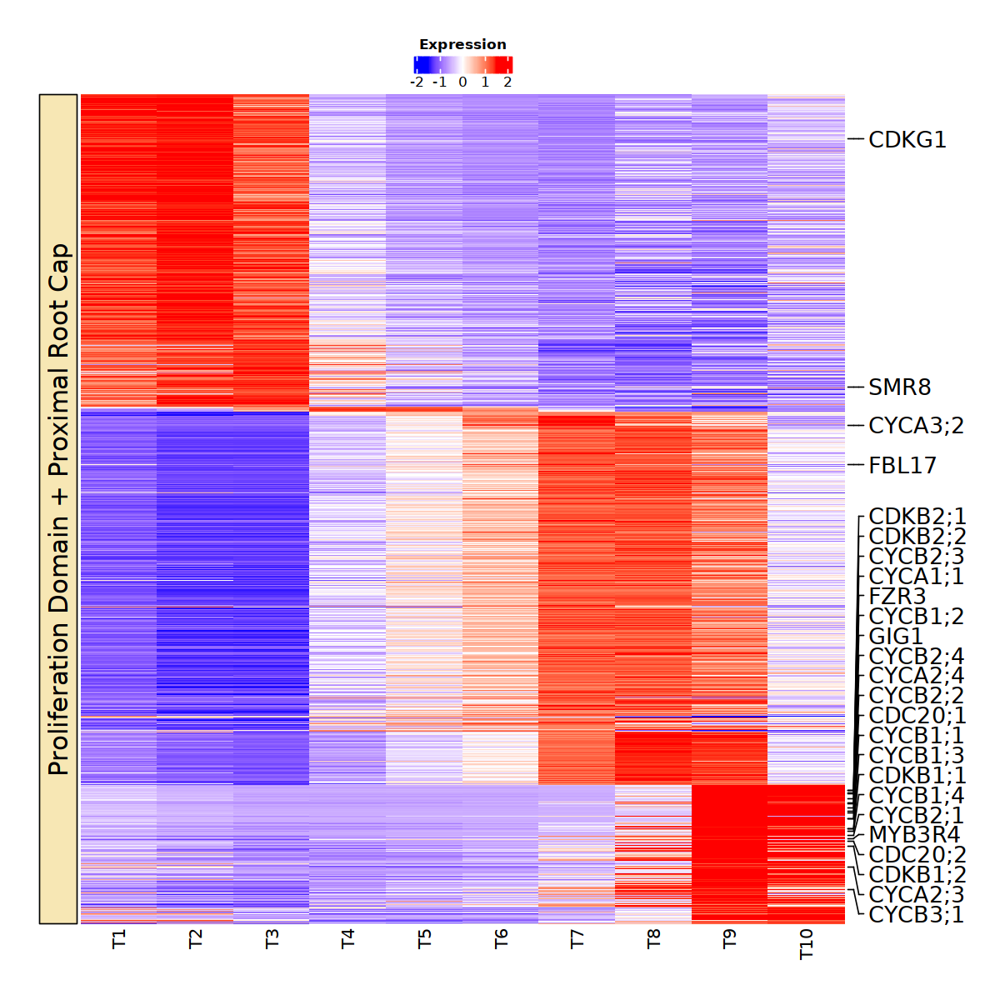

In [526]:
## Unique markers for each group
mark_anno = rowAnnotation(foo = anno_mark(at = mat_for_mark$index, labels = mat_for_mark$Name, labels_gp = gpar(col = "black", fontsize = 16)))

options(repr.plot.width=10, repr.plot.height=10)
hm <- Heatmap(mat2, 
        col = colorRamp2(c(-1.5, 0, 1.5), 
                         c('blue','white','red')), 
                show_column_names = T,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                   left_annotation=sa,
                   right_annotation=mark_anno,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

draw(hm, padding = unit(c(10, 10, 10, 10), "mm"), heatmap_legend_side = "top")

In [78]:
core_dyn_name <- feature_names$Name[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]

In [79]:
core_dyn_gene <- feature_names$gene[feature_names$gene %in% intersect(core$GeneID, genes_to_plt)]

## Load gene lists

In [15]:
DefaultAssay(rc.integrated) <- "SCT"

In [16]:
nrow(rc.integrated)

[1] 26058

In [17]:
GL <- read.csv("./tradeseq/BES1_BZR1_2X_ChIP_targets.csv")
GL <- intersect(GL$GeneID,rownames(rc.integrated))
GL2 <- read.csv("./tradeseq/BES1_BZR1_target_BL2hr_vs_BRZ.csv")
GL2up <- GL2 %>% filter(BL2hr_vs_BRZ=="BES1_Target_BL_up")
GL2up <- intersect(GL2up$GeneID, rownames(rc.integrated))
GL2down <- GL2 %>% filter(BL2hr_vs_BRZ=="BES1_Target_BL_down")
GL2down <- intersect(GL2down$GeneID, rownames(rc.integrated))
GL2mixed <- GL2 %>% filter(BL2hr_vs_BRZ=="BES1_Target_BL_mixed")
GL2mixed <- intersect(GL2mixed$GeneID, rownames(rc.integrated))
GL3 <- read.csv("./tradeseq/MYB3R4_Targets.csv")
GL3 <- intersect(GL3$GeneID, rownames(rc.integrated))

In [18]:
DE <- read.csv("./tradeseq/v4_BL2hr_v_BRZ_cell_time_EdgeR_q0.05_FC1.5_r_v_4_20220112.csv", row.names = 1)
DE <- DE %>% filter(cluster_id == "Proliferation Domain_Atrichoblast")
head(DE)

,gene,cluster_id,sc_2.cpm,sc_43.cpm,sc_50.cpm,sc_5.cpm,sc_46.cpm,sc_49.cpm,sc_2.frq,sc_43.frq,...,F,p_val,p_adj.loc,p_adj.glb,contrast,Name,TF_Name,Description,up_dn_label,clust_up_dn
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT3G50660,Proliferation Domain_Atrichoblast,66.5,53.90,58.10,3.04,1.22,1.31,0.7780,0.6530,...,603,1.14e-26,2.56e-22,7.02e-21,BL-BRZ,CYP90B1,NA,NA,Down,Proliferation Domain_Atrichoblast_Down
2,AT4G36780,Proliferation Domain_Atrichoblast,227.0,167.00,196.00,17.90,12.50,12.70,0.9490,0.8930,...,551,6.89e-26,7.70e-22,4.22e-20,BL-BRZ,BEH2,BEH2,BES1/BZR1 homolog 2,Down,Proliferation Domain_Atrichoblast_Down
3,AT4G01630,Proliferation Domain_Atrichoblast,12.0,6.87,11.50,209.00,142.00,142.00,0.2530,0.1480,...,508,3.38e-25,2.52e-21,2.07e-19,BL-BRZ,EXPA17,NA,NA,Up,Proliferation Domain_Atrichoblast_Up
4,AT2G43890,Proliferation Domain_Atrichoblast,2.4,1.77,2.28,110.00,31.40,41.30,0.0606,0.0473,...,454,2.98e-24,1.67e-20,1.83e-18,BL-BRZ,AT2G43890,NA,NA,Up,Proliferation Domain_Atrichoblast_Up
5,AT4G16780,Proliferation Domain_Atrichoblast,54.0,57.00,56.20,3.99,4.29,5.76,0.6870,0.7080,...,406,2.55e-23,1.14e-19,1.56e-17,BL-BRZ,HAT4,HB-2,homeobox protein 2,Down,Proliferation Domain_Atrichoblast_Down
6,AT1G07985,Proliferation Domain_Atrichoblast,162.0,176.00,228.00,23.00,21.80,16.40,0.8990,0.7460,...,363,2.25e-22,8.40e-19,1.38e-16,BL-BRZ,AT1G07985,NA,NA,Down,Proliferation Domain_Atrichoblast_Down


## Prepare data for WCGNA

In [19]:
rc.integrated <- subset(rc.integrated, cells=colnames(rc.integrated)[which(rc.integrated$cell_type=="Atrichoblast")])

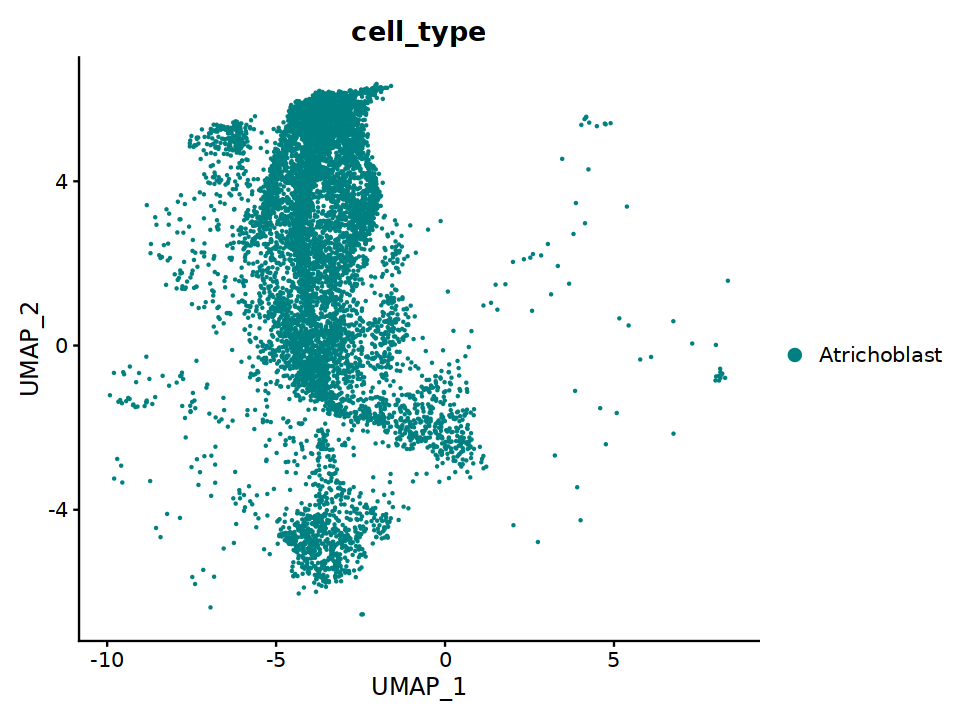

In [20]:
options(repr.plot.width=8, repr.plot.height=6)
plot_anno(rc.integrated)

In [21]:
rc.integrated

An object of class Seurat 
74352 features across 8115 samples within 3 assays 
Active assay: SCT (26058 features, 0 variable features)
 2 other assays present: RNA, integrated
 3 dimensional reductions calculated: pca, umap, umap_2D

In [22]:
table(rc.integrated$sample)


     dc1      dc2 sc_10_at    sc_11    sc_12   sc_157   sc_158   sc_159 
     468      427      314      402      231      108      112      195 
  sc_169   sc_170   sc_171    sc_20   sc_215   sc_221   sc_229   sc_235 
     128      188      253      374     1403     2067      312      158 
   sc_71     tnw1 
     736      239 

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


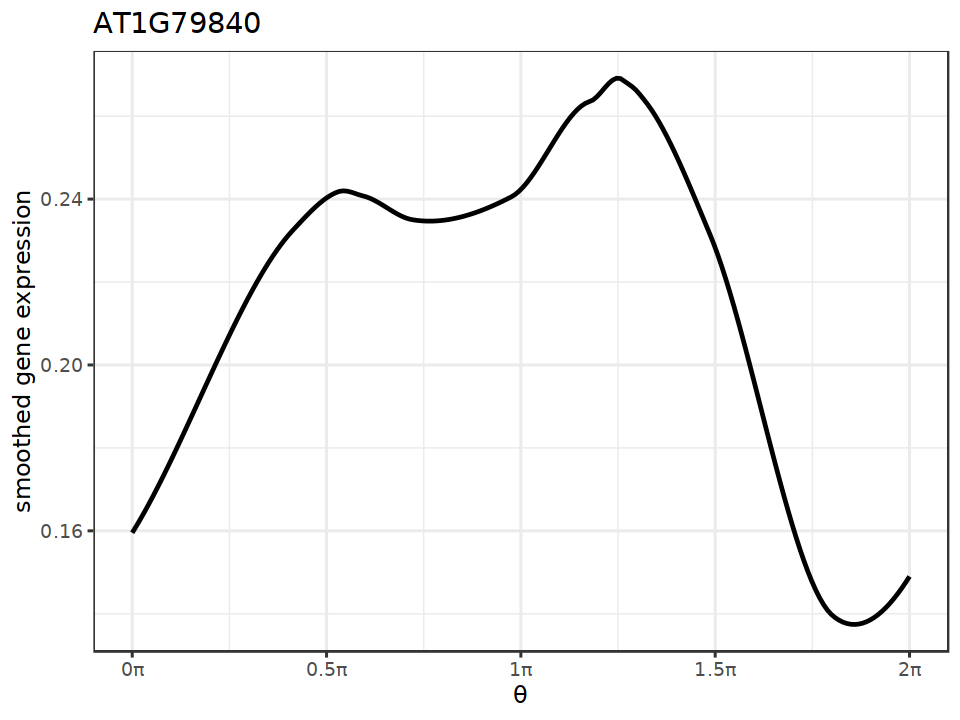

In [21]:
## Atrichoblast only
## GL2 
pltsg('AT1G79840')

png 
  2

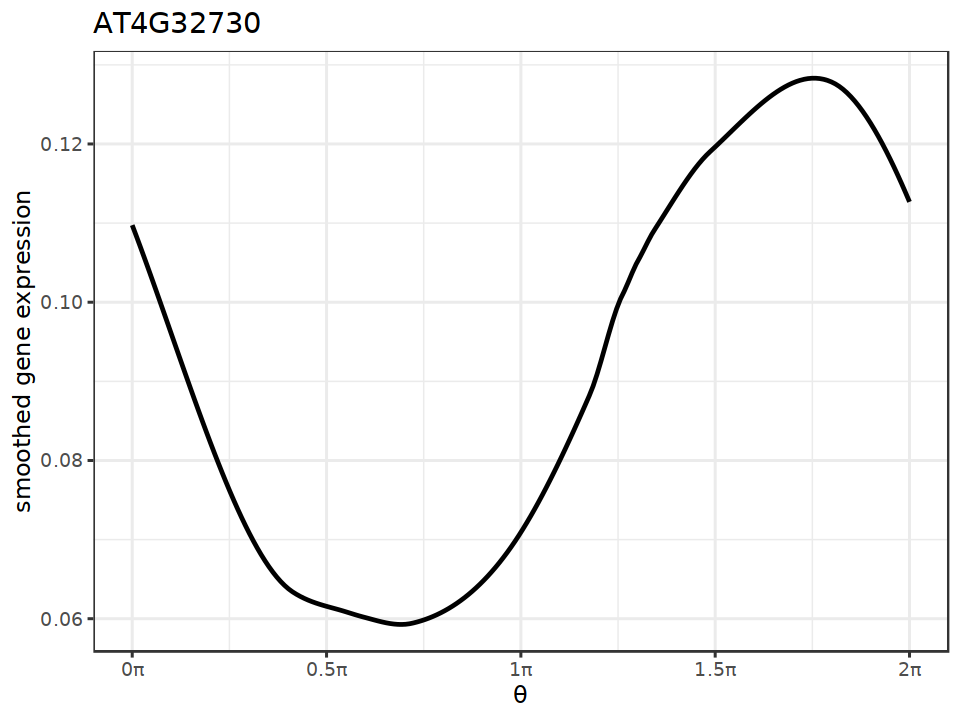

In [99]:
grDevices::cairo_pdf("Atrichoblast_MYB3R1.pdf",width=8, height=6)
pltsg('AT4G32730')
dev.off()

pltsg('AT4G32730')

png 
  2

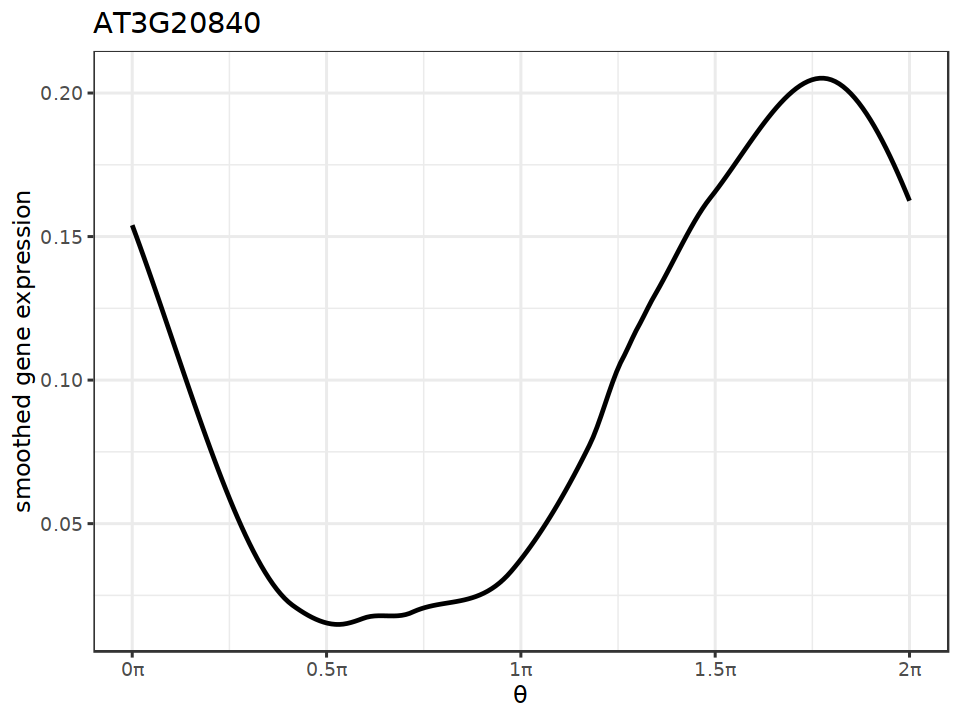

In [100]:
grDevices::cairo_pdf("Atrichoblast_PLT1.pdf",width=8, height=6)
pltsg('AT3G20840')
dev.off()

pltsg('AT3G20840')

png 
  2

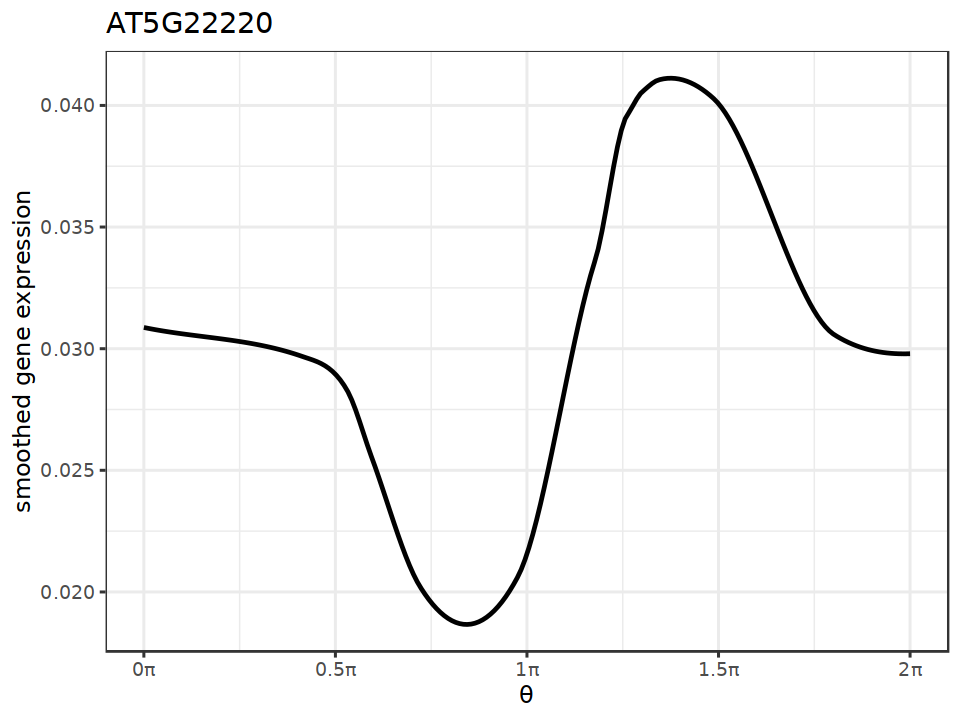

In [101]:
grDevices::cairo_pdf("Atrichoblast_E2Fb.pdf",width=8, height=6)
pltsg('AT5G22220')
dev.off()

pltsg('AT5G22220')

png 
  2

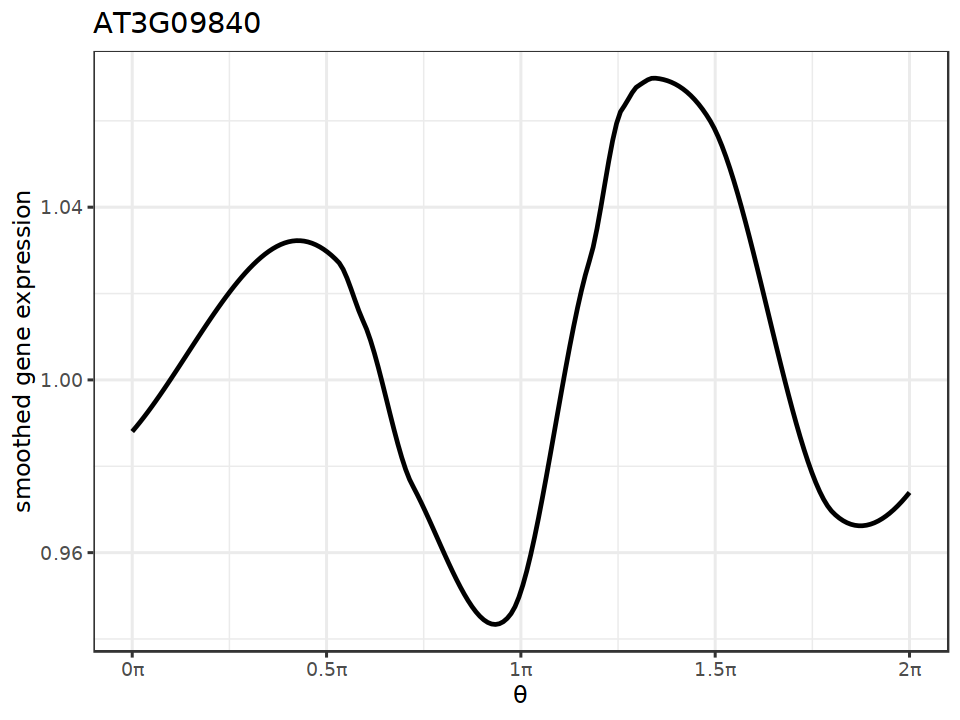

In [102]:
grDevices::cairo_pdf("Atrichoblast_CDC48A.pdf",width=8, height=6)
pltsg('AT3G09840')
dev.off()

pltsg('AT3G09840')

png 
  2

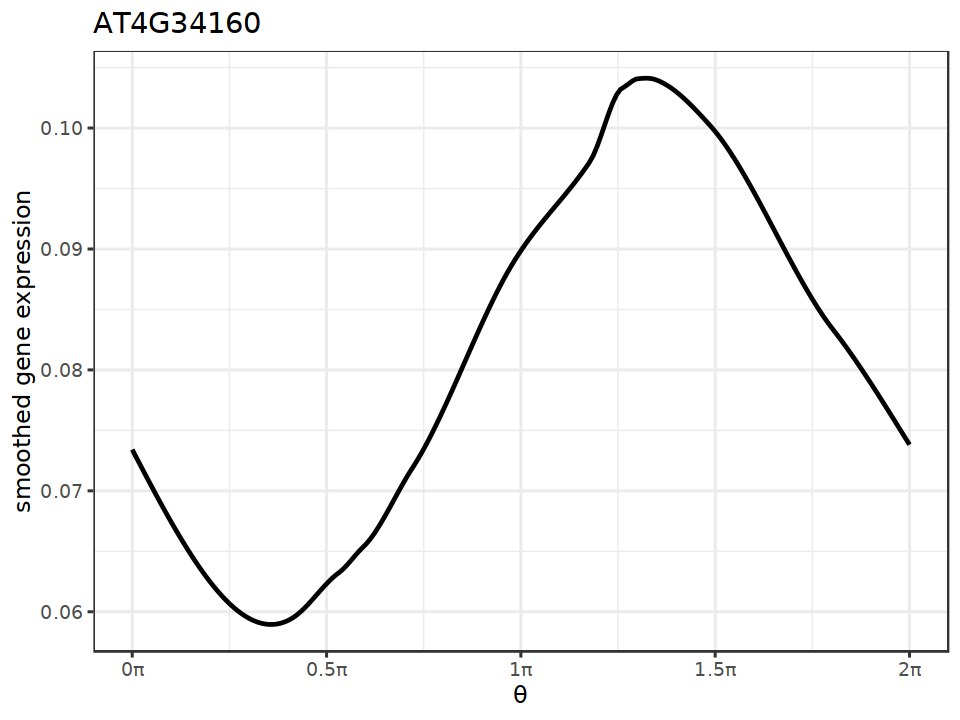

In [103]:
grDevices::cairo_pdf("Atrichoblast_CYCD3_1.pdf",width=8, height=6)
pltsg('AT4G34160')
dev.off()

pltsg('AT4G34160')

png 
  2

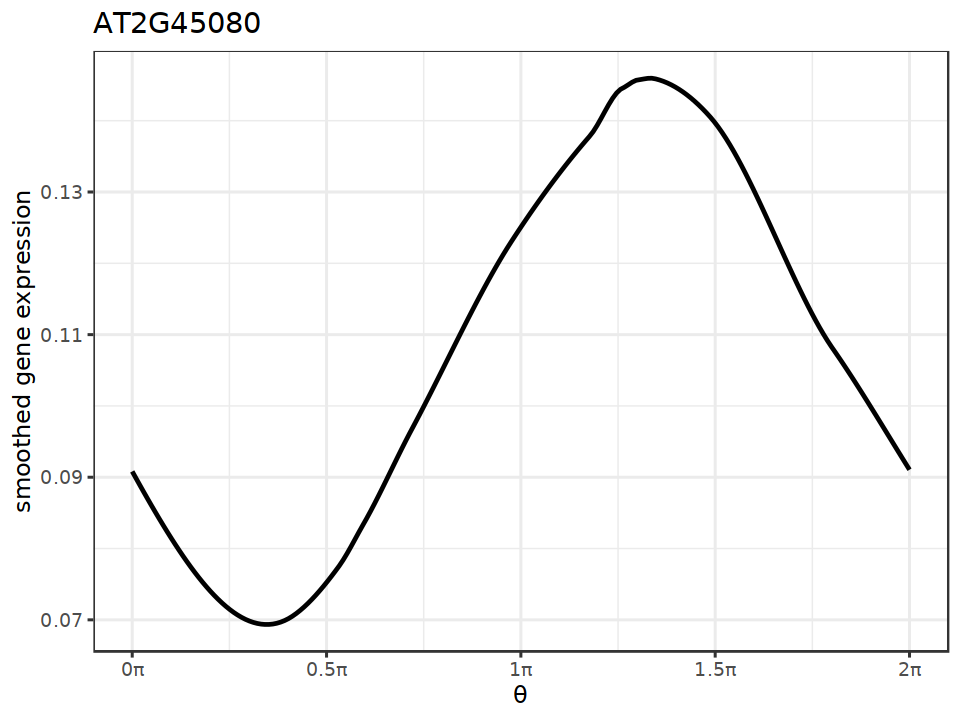

In [104]:
grDevices::cairo_pdf("Atrichoblast_CYCP3_1.pdf",width=8, height=6)
pltsg('AT2G45080')
dev.off()

pltsg('AT2G45080')

png 
  2

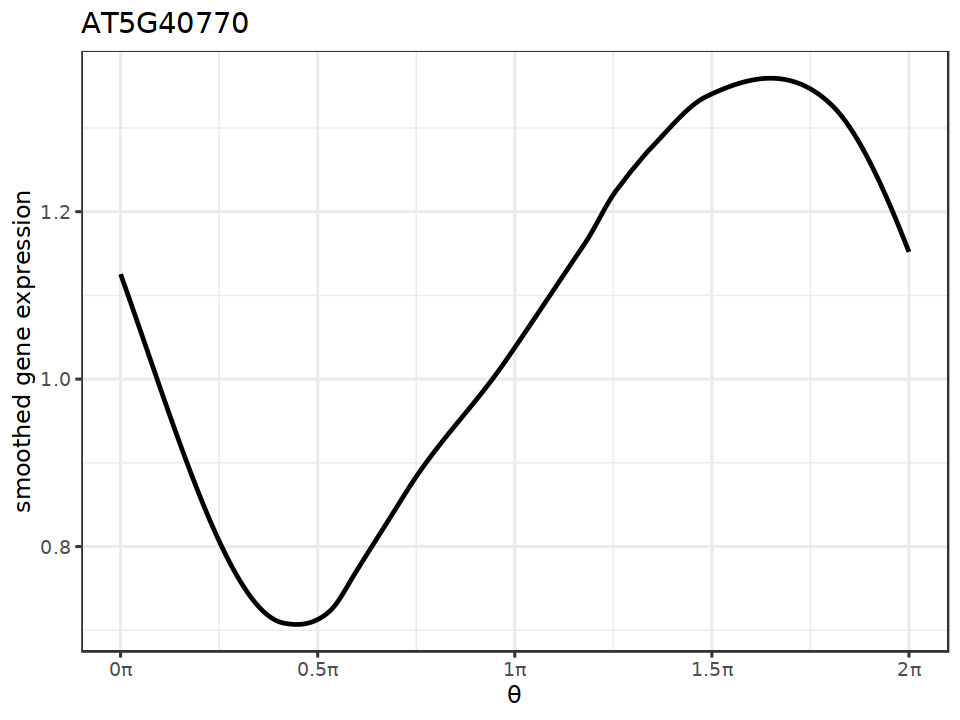

In [105]:
#PHB3 AT5G40770
grDevices::cairo_pdf("Atrichoblast_PHB3.pdf",width=8, height=6)
pltsg('AT5G40770')
dev.off()

pltsg('AT5G40770')

png 
  2

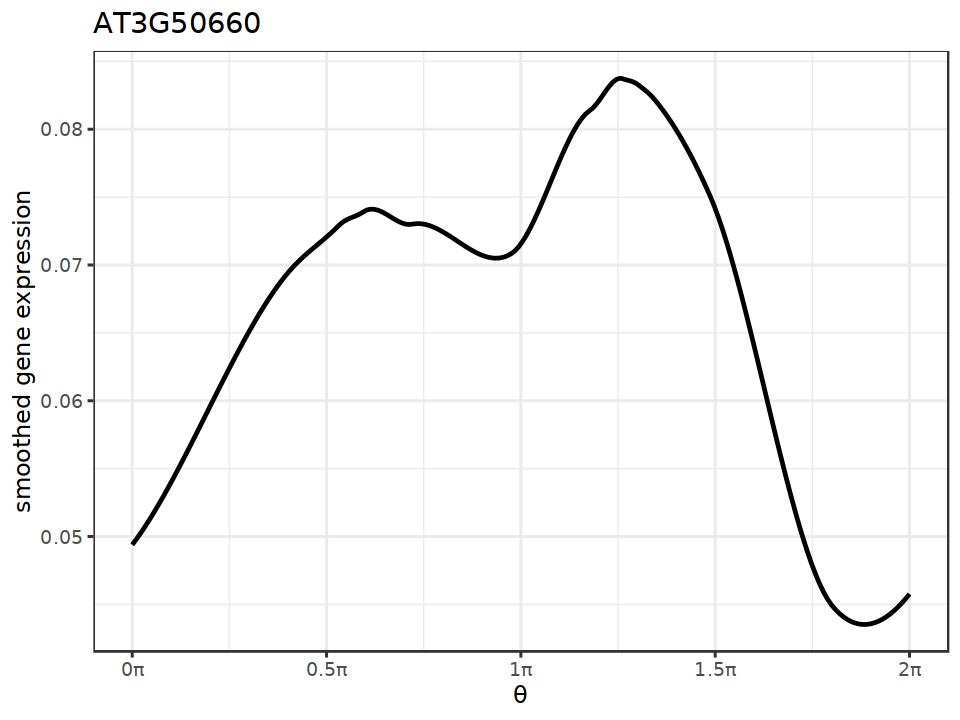

In [40]:
## Atrichoblast only
## DWF4 

grDevices::cairo_pdf("Atrichoblast_DWF4.pdf",width=8, height=6)
pltsg('AT3G50660')
dev.off()

pltsg('AT3G50660')

png 
  2

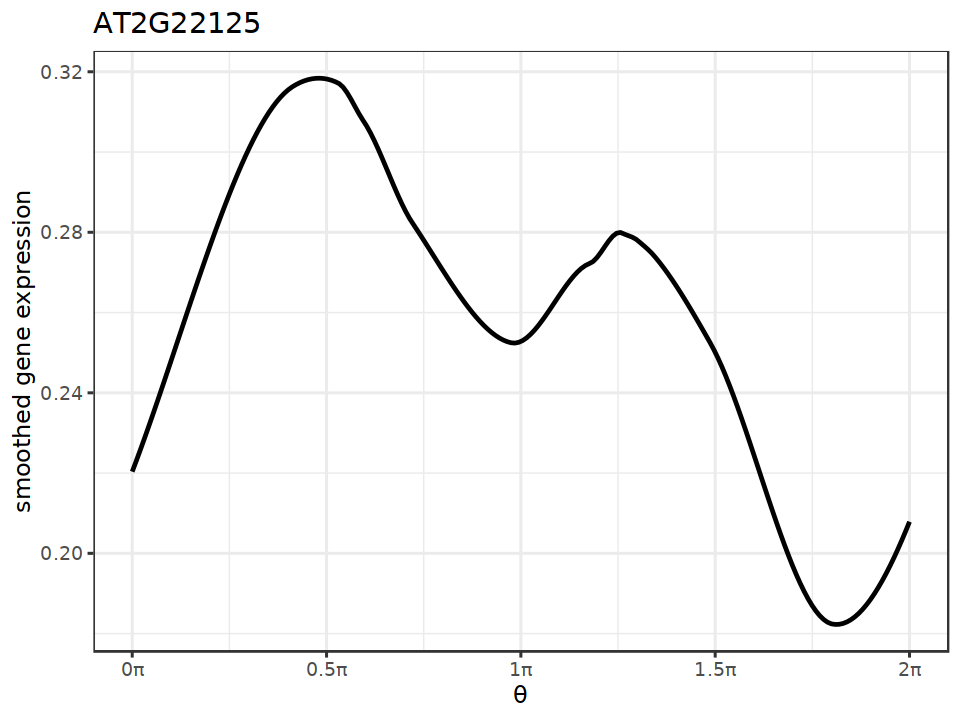

In [41]:
## CSI1
grDevices::cairo_pdf("Atrichoblast_CSI1.pdf",width=8, height=6)
pltsg('AT2G22125')
dev.off()

pltsg('AT2G22125')

png 
  2

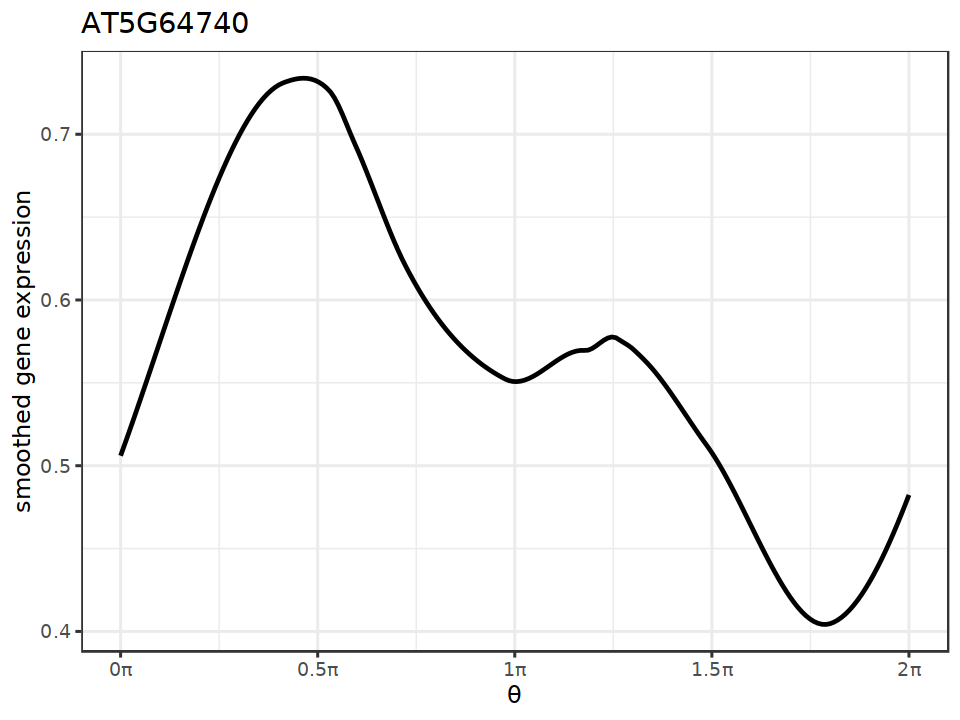

In [42]:
## CESA6 
grDevices::cairo_pdf("Atrichoblast_CESA6.pdf",width=8, height=6)
pltsg('AT5G64740')
dev.off()

pltsg('AT5G64740')

png 
  2

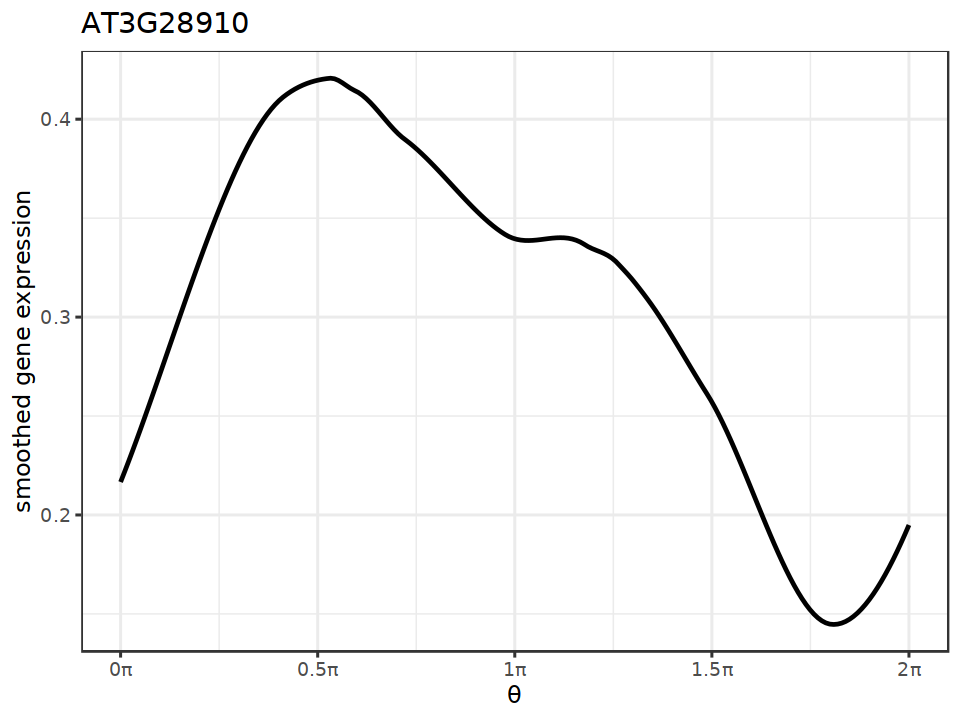

In [43]:
## MYB30 
grDevices::cairo_pdf("Atrichoblast_MYB30.pdf",width=8, height=6)
pltsg('AT3G28910')
dev.off()

pltsg('AT3G28910')

png 
  2

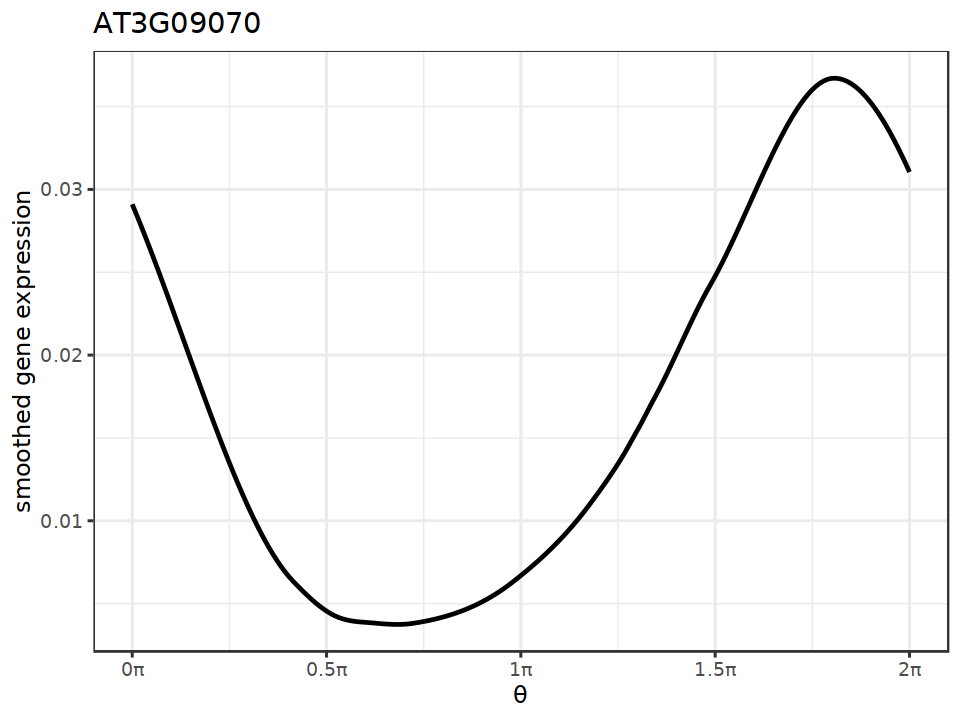

In [44]:
## OPS 
grDevices::cairo_pdf("Atrichoblast_OPS.pdf",width=8, height=6)
pltsg('AT3G09070')
dev.off()

pltsg('AT3G09070')

png 
  2

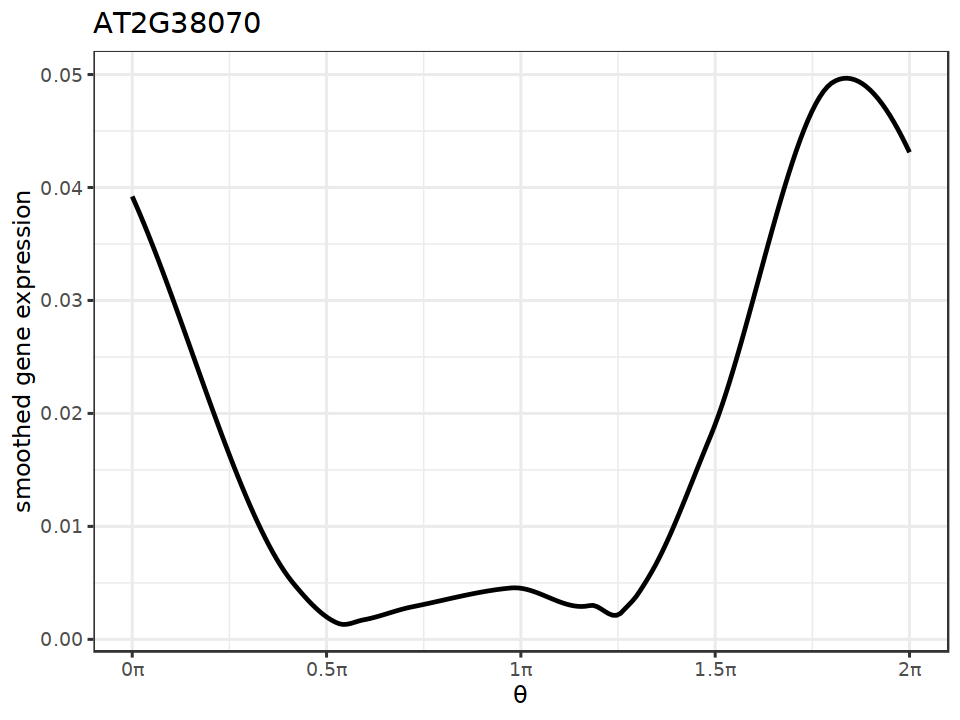

In [45]:
## OPL2 
grDevices::cairo_pdf("Atrichoblast_OPL2.pdf",width=8, height=6)
pltsg('AT2G38070')
dev.off()

pltsg('AT2G38070')

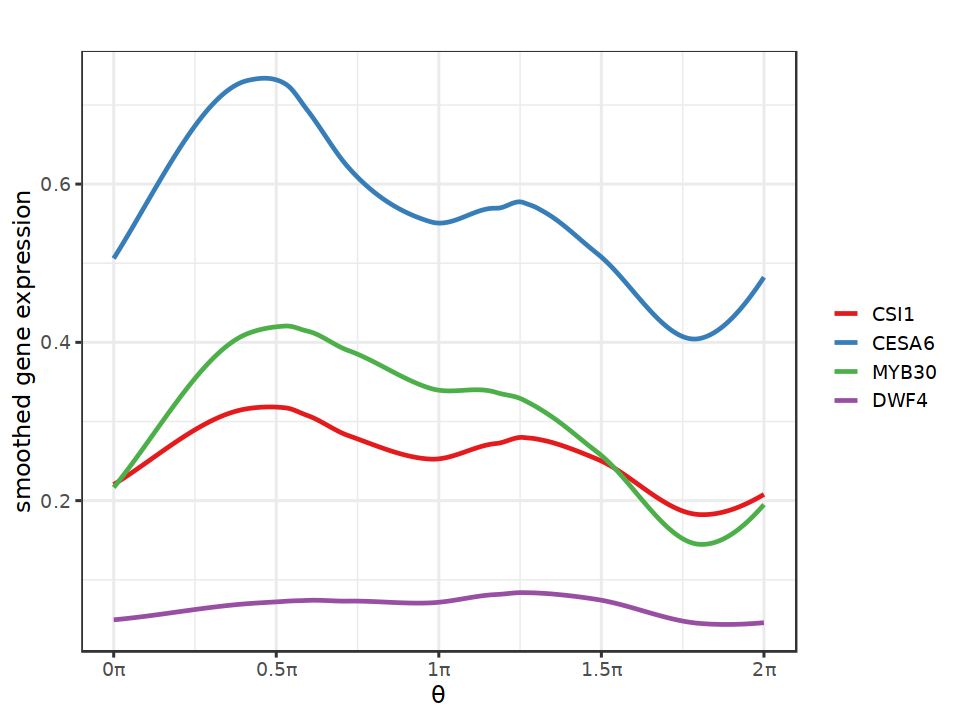

In [547]:
keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == "AT2G22125")
fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                        rc.integrated@assays$SCT@data[keygene.idx,],
                        plot = FALSE, span=0.3,
                   x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- fit.l$pred.df
keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == "AT5G64740")
fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                        rc.integrated@assays$SCT@data[keygene.idx,],
                        plot = FALSE, span=0.3,
                   x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- rbind(fit, fit.l$pred.df)
keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == "AT3G28910")
fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                        rc.integrated@assays$SCT@data[keygene.idx,],
                        plot = FALSE, span=0.3,
                   x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- rbind(fit, fit.l$pred.df)
keygene.idx <- which(rownames(rc.integrated@assays$SCT@data) == "AT3G50660")
fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                        rc.integrated@assays$SCT@data[keygene.idx,],
                        plot = FALSE, span=0.3,
                   x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- rbind(fit, fit.l$pred.df)
fit$treatment <- factor(c(rep("CSI1", 200),rep("CESA6", 200),rep("MYB30", 200),rep("DWF4", 200)), levels=c("CSI1","CESA6", "MYB30", "DWF4"))

options(repr.plot.width=8, repr.plot.height=6)
print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = "") + 
            scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                0.5, 1, 1.5, 2), "π"), name = "θ")+
  #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
  #              50, 100, 150, 200), labels = paste0(c(0, 
  #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      
  scale_color_brewer(palette="Set1")+
  theme_bw(base_size = 14)+
  theme(legend.title=element_blank()))

In [ ]:
y.list <- c()
for (gene in rownames(rc.integrated)){
keygene.idx <- which(rownames(rc.integrated) == gene)
fit.l <- fit_periodic_loess(rc.integrated$tricyclePosition*pi,
                            rc.integrated@assays$SCT@data[keygene.idx,],
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
fit <- fit.l$pred.df

y.list <- cbind(y.list,fit$y)
}

In [ ]:
colnames(y.list) <- rownames(rc.integrated)

In [ ]:
write.csv(y.list, "./tradeseq/All_genes_Atrichoblast_tricycle.csv")

In [548]:
y.list <- read.csv("./tradeseq/All_genes_Atrichoblast_tricycle.csv", row.names=1)
y.list <- as.matrix(y.list)

In [549]:
head(y.list)

,AT1G01010,AT1G01020,AT1G01030,AT1G01040,AT1G01050,AT1G01060,AT1G01070,AT1G01080,AT1G01090,AT1G01100,...,AT3G06085,AT3G16525,AT3G28899,AT3G01165,AT3G26813,AT4G20250,AT5G12910,AT5G04175,AT5G48700,AT5G08765
1,0.03437418,0.1612505,0.01163936,0.02817155,1.138159,0.05939835,0.0010859504,0.01923415,0.6983683,2.797759,...,0,0,0,0,0,0,0,0,0,0
2,0.03445125,0.1593607,0.01141413,0.02762631,1.142304,0.05855187,0.0010508947,0.01876431,0.6959656,2.787630,...,0,0,0,0,0,0,0,0,0,0
3,0.03452833,0.1574618,0.01118563,0.02707317,1.146529,0.05769503,0.0010163139,0.01828790,0.6935609,2.777358,...,0,0,0,0,0,0,0,0,0,0
4,0.03460526,0.1555565,0.01095425,0.02651315,1.150827,0.05682911,0.0009822365,0.01780573,0.6911572,2.766962,...,0,0,0,0,0,0,0,0,0,0
5,0.03468185,0.1536477,0.01072038,0.02594726,1.155191,0.05595539,0.0009486914,0.01731861,0.6887573,2.756460,...,0,0,0,0,0,0,0,0,0,0
6,0.03475794,0.1517380,0.01048440,0.02537651,1.159612,0.05507514,0.0009157072,0.01682733,0.6863643,2.745869,...,0,0,0,0,0,0,0,0,0,0


In [550]:
nrow(y.list)

[1] 200

In [551]:
length(GL3)

[1] 165

In [552]:
length(intersect(colnames(y.list),GL3))

[1] 165

In [553]:
## Remove zeros in y.list()
y.list <- y.list[,-as.numeric(which(colSums(y.list)==0))]

## WGCNA

In [39]:
allowWGCNAThreads()

Allowing multi-threading with up to 94 threads.


In [40]:
# Choose a set of soft-thresholding powers
powers = c(c(1:100))

In [41]:
# Call the network topology analysis function
sft = pickSoftThreshold(
  y.list,             # <= Input data
  #blockSize = 30,
  powerVector = powers,
  verbose = 5
  )

pickSoftThreshold: will use block size 1835.
 pickSoftThreshold: calculating connectivity for given powers...
   ..working on genes 1 through 1835 of 24371
   ..working on genes 1836 through 3670 of 24371
   ..working on genes 3671 through 5505 of 24371
   ..working on genes 5506 through 7340 of 24371
   ..working on genes 7341 through 9175 of 24371
   ..working on genes 9176 through 11010 of 24371
   ..working on genes 11011 through 12845 of 24371
   ..working on genes 12846 through 14680 of 24371
   ..working on genes 14681 through 16515 of 24371
   ..working on genes 16516 through 18350 of 24371
   ..working on genes 18351 through 20185 of 24371
   ..working on genes 20186 through 22020 of 24371
   ..working on genes 22021 through 23855 of 24371
   ..working on genes 23856 through 24371 of 24371
    Power SFT.R.sq   slope truncated.R.sq mean.k. median.k. max.k.
1       1   0.9320  4.3800        0.94500   14900     16100  18000
2       2   0.8960  2.1500        0.91400   11300     12

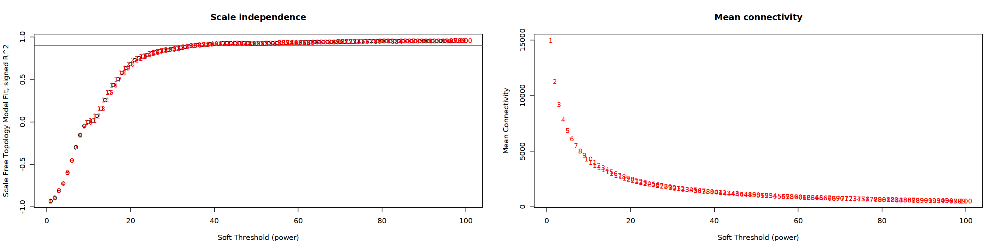

In [42]:
options(repr.plot.width=24, repr.plot.height=6)
par(mfrow = c(1,2));
cex1 = 0.9;

plot(sft$fitIndices[, 1],
     -sign(sft$fitIndices[, 3]) * sft$fitIndices[, 2],
     xlab = "Soft Threshold (power)",
     ylab = "Scale Free Topology Model Fit, signed R^2",
     main = paste("Scale independence")
)
text(sft$fitIndices[, 1],
     -sign(sft$fitIndices[, 3]) * sft$fitIndices[, 2],
     labels = powers, cex = cex1, col = "red"
)
abline(h = 0.90, col = "red")
plot(sft$fitIndices[, 1],
     sft$fitIndices[, 5],
     xlab = "Soft Threshold (power)",
     ylab = "Mean Connectivity",
     type = "n",
     main = paste("Mean connectivity")
)
text(sft$fitIndices[, 1],
     sft$fitIndices[, 5],
     labels = powers,
     cex = cex1, col = "red")

In [43]:
picked_power = 30
temp_cor <- cor       
cor <- WGCNA::cor         # Force it to use WGCNA cor function (fix a namespace conflict issue)
netwk <- blockwiseModules(y.list,                # <= input here

                          # == Adjacency Function ==
                          power = picked_power,                # <= power here
                          networkType = "signed",

                          # == Tree and Block Options ==
                          deepSplit = 2,
                          pamRespectsDendro = F,
                          # detectCutHeight = 0.75,
                          minModuleSize = 200,
                          maxBlockSize = 4000,

                          # == Module Adjustments ==
                          reassignThreshold = 0,
                          mergeCutHeight = 0.25,

                          # == TOM == Archive the run results in TOM file (saves time)
                          saveTOMs = T,
                          saveTOMFileBase = "ER",

                          # == Output Options
                          numericLabels = T,
                          verbose = 3)

 Calculating module eigengenes block-wise from all genes
   Flagging genes and samples with too many missing values...
    ..step 1
 ....pre-clustering genes to determine blocks..
   Projective K-means:
   ..k-means clustering..
   ..merging smaller clusters...
Block sizes:
gBlocks
   1    2    3    4    5    6    7    8 
3572 3502 3425 3390 3381 3052 2849 1200 
 ..Working on block 1 .
    TOM calculation: adjacency..
    ..will use 94 parallel threads.
     Fraction of slow calculations: 0.000000
    ..connectivity..
    ..matrix multiplication (system BLAS)..
    ..normalization..
    ..done.
   ..saving TOM for block 1 into file ER-block.1.RData
 ....clustering..
 ....detecting modules..
 ....calculating module eigengenes..
 ....checking kME in modules..
     ..removing 2 genes from module 7 because their KME is too low.
 ..Working on block 2 .
    TOM calculation: adjacency..
    ..will use 94 parallel threads.
     Fraction of slow calculations: 0.000000
    ..connectivity..
    .

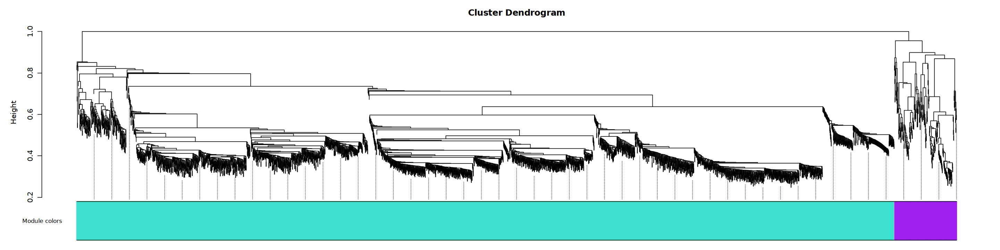

In [44]:
options(repr.plot.width=24, repr.plot.height=6)
# Convert labels to colors for plotting
mergedColors = labels2colors(netwk$colors)
# Plot the dendrogram and the module colors underneath
plotDendroAndColors(
  netwk$dendrograms[[1]],
  mergedColors[netwk$blockGenes[[1]]],
  "Module colors",
  dendroLabels = FALSE,
  hang = 0.03,
  addGuide = TRUE,
  guideHang = 0.05 )

In [45]:
head(netwk$colors[netwk$blockGenes[[1]]])

AT1G01070 AT1G01090 AT1G01220 AT1G01260 AT1G01305 AT1G01310 
        1         1         1         1         1         1

In [46]:
table(netwk$colors)


    0     1     2     3     4     5     6     7     8     9    10 
   88 12938  3748  2644  1385   935   886   714   411   371   251 

In [47]:
module_df <- data.frame(
  gene_id = names(netwk$colors),
  colors = labels2colors(netwk$colors)
)

In [48]:
module_df[1:5,]

,gene_id,colors
,<chr>,<chr>
1,AT1G01010,red
2,AT1G01020,turquoise
3,AT1G01030,turquoise
4,AT1G01040,turquoise
5,AT1G01050,blue


In [49]:
table(module_df$colors)


    black      blue     brown     green      grey   magenta      pink    purple 
      714      3748      2644       935        88       371       411       251 
      red turquoise    yellow 
      886     12938      1385 

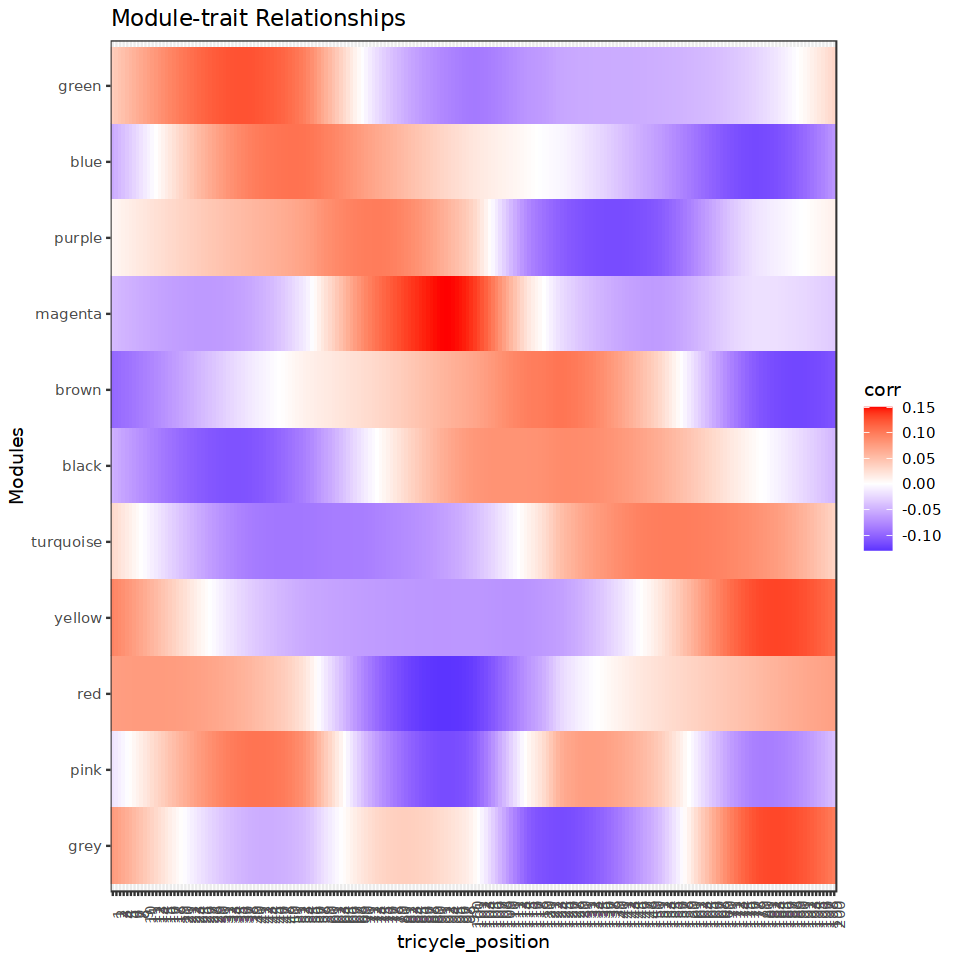

In [50]:
options(repr.plot.width=8, repr.plot.height=8)
# Get Module Eigengenes per cluster
MEs0 <- moduleEigengenes(y.list, mergedColors)$eigengenes

# Reorder modules so similar modules are next to each other
MEs0 <- orderMEs(MEs0)
module_order = names(MEs0) %>% gsub("ME","", .)

# Add treatment names
MEs0$treatment = row.names(MEs0)

# tidy & plot data
mME = MEs0 %>%
  pivot_longer(-treatment) %>%
  mutate(
    name = gsub("ME", "", name),
    name = factor(name, levels = module_order)
  )

#mME <- mME[-which(mME$name == "grey"),] 
mME$treatment <- factor(mME$treatment, levels = seq(1,200))
mME$tricycle_position <- mME$treatment
#mME$name <- factor(mME$name, levels = rev(c("green", "grey", "black", "blue", "brown", "turquoise", "yellow", "red", "pink", "magenta")))
mME$name <- factor(mME$name, levels = rev(c("green", "blue", "purple", "magenta", "brown", "black", "turquoise", "yellow", "red", "pink", "grey")))
mME$module <- as.character(mME$name)
#mME$module[which(mME$module=="green")]="G1-M1"
#mME$module[which(mME$module=="grey")]="G1-M2"
#mME$module[which(mME$module=="blue")]="G1-M3"
#mME$module[which(mME$module=="black")]="G1-M4"
#mME$module[which(mME$module=="brown")]="G1S-M5"
#mME$module[which(mME$module=="turquoise")]="G1S-M6"
#mME$module[which(mME$module=="yellow")]="S-M7"
#mME$module[which(mME$module=="magenta")]="G2M-M8"
#mME$module[which(mME$module=="red")]="G2MG1-M9"
#mME$module[which(mME$module=="pink")]="G1S-M10"
#mME$module[which(mME$module=="grey")]="Unassigned"
#mME$module <- factor(mME$module, levels = rev(c("G1-M1", "G1-M2", "G1-M3", "G1-M4", "G1S-M5", "G1S-M6", "S-M7", "G2M-M8", "G2MG1-M9", "G1S-M10", "Unassigned")))

mME %>% ggplot(., aes(x=tricycle_position, y=name, fill=value)) +
  geom_tile() +
  theme_bw() +
  scale_fill_gradient2(
    low = "blue",
    high = "red",
    mid = "white",
    midpoint = 0,
  #  limit = c(-1,1)
  ) +
  theme(axis.text.x = element_text(angle=90)) +
  labs(title = "Module-trait Relationships", y = "Modules", fill="corr")

## Module GO

In [52]:
## Prepare gene module list
module_sel <- select(module_df, gene_id, colors)
module_list <- split(module_sel, f=module_sel$colors)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="gene_id"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$gene_id)))

In [53]:
length(module_list)

[1] 11

In [54]:
cluster_GO <- gost(module_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]]

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(5, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name

Joining with `by = join_by(term_id)`


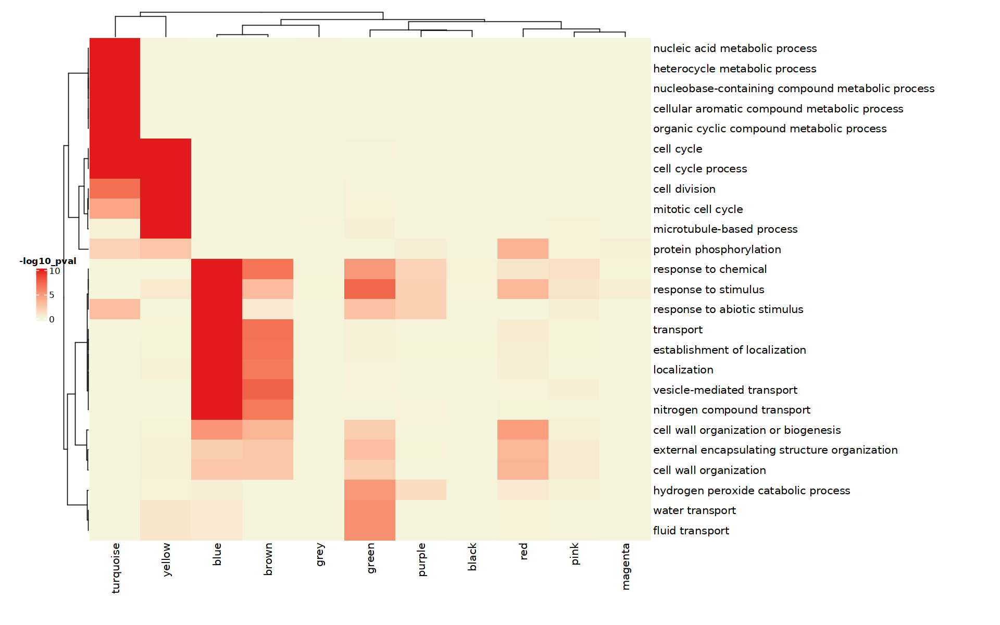

In [55]:
options(repr.plot.width = 16, repr.plot.height = 10)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous"), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE, 
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 12)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 80), "mm"), heatmap_legend_side = "left")

## Remove grey, black, magenta, pink that have no significant GO terms

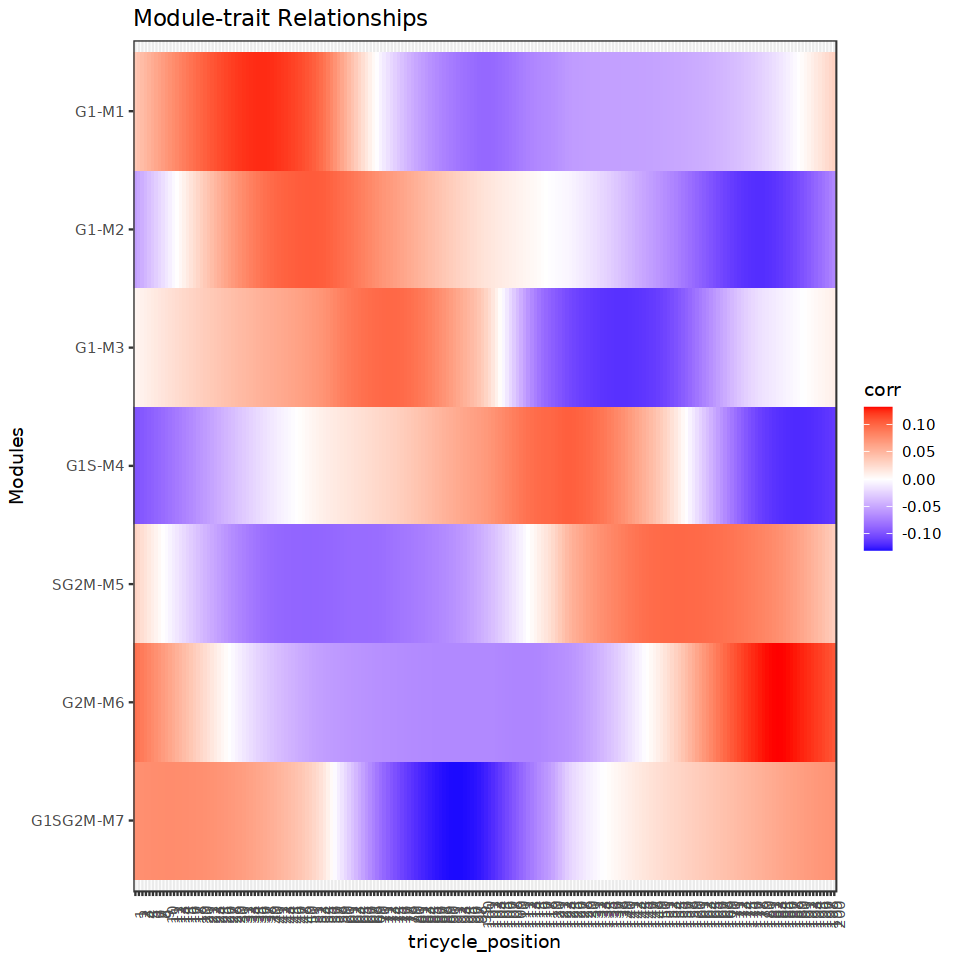

In [57]:
options(repr.plot.width=8, repr.plot.height=8)
# Get Module Eigengenes per cluster
MEs0 <- moduleEigengenes(y.list, mergedColors)$eigengenes

# Reorder modules so similar modules are next to each other
MEs0 <- orderMEs(MEs0)
module_order = names(MEs0) %>% gsub("ME","", .)

# Add treatment names
MEs0$treatment = row.names(MEs0)

# tidy & plot data
mME = MEs0 %>%
  pivot_longer(-treatment) %>%
  mutate(
    name = gsub("ME", "", name),
    name = factor(name, levels = module_order)
  )

mME <- mME[-which(mME$name == "grey"),] 
mME <- mME[-which(mME$name == "pink"),] 
mME <- mME[-which(mME$name == "black"),] 
mME <- mME[-which(mME$name == "magenta"),] 
mME$treatment <- factor(mME$treatment, levels = seq(1,200))
mME$tricycle_position <- mME$treatment
#mME$name <- factor(mME$name, levels = rev(c("green", "grey", "black", "blue", "brown", "turquoise", "yellow", "red", "pink", "magenta")))
mME$name <- factor(mME$name, levels = rev(c("green", "blue", "purple", "brown", "turquoise", "yellow", "red")))
mME$module <- as.character(mME$name)
mME$module[which(mME$module=="green")]="G1-M1"
mME$module[which(mME$module=="blue")]="G1-M2"
mME$module[which(mME$module=="purple")]="G1-M3"
mME$module[which(mME$module=="brown")]="G1S-M4"
mME$module[which(mME$module=="turquoise")]="SG2M-M5"
mME$module[which(mME$module=="yellow")]="G2M-M6"
mME$module[which(mME$module=="red")]="G1SG2M-M7"
#mME$module[which(mME$module=="grey")]="Unassigned"
mME$module <- factor(mME$module, levels = rev(c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7")))

mME %>% ggplot(., aes(x=tricycle_position, y=module, fill=value)) +
  geom_tile() +
  theme_bw() +
  scale_fill_gradient2(
    low = "blue",
    high = "red",
    mid = "white",
    midpoint = 0,
  #  limit = c(-1,1)
  ) +
  theme(axis.text.x = element_text(angle=90)) +
  labs(title = "Module-trait Relationships", y = "Modules", fill="corr")

In [58]:
head(MEs0)

,MEmagenta,MEblack,MEbrown,MEturquoise,MEred,MEyellow,MEblue,MEpurple,MEgreen,MEpink,MEgrey,treatment
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1,-0.04454885,-0.05077417,-0.09847776,0.03025052,0.07493473,0.09412698,-0.05452611,0.006843296,0.03895037,-0.018102005,0.07788725,1
2,-0.04576690,-0.05360170,-0.09702978,0.02663406,0.07537663,0.09117627,-0.05020672,0.008314627,0.04251574,-0.014217854,0.07426836,2
3,-0.04698306,-0.05641352,-0.09548975,0.02298297,0.07577576,0.08813001,-0.04581221,0.009782074,0.04607937,-0.010264241,0.07055305,3
4,-0.04819342,-0.05920531,-0.09386194,0.01930289,0.07613153,0.08499452,-0.04135042,0.011245116,0.04963553,-0.006249933,0.06675043,4
5,-0.04939405,-0.06197274,-0.09215061,0.01559943,0.07644333,0.08177612,-0.03682921,0.012703230,0.05317849,-0.002183695,0.06286959,5
6,-0.05058103,-0.06471148,-0.09036004,0.01187821,0.07671056,0.07848115,-0.03225641,0.014155894,0.05670252,0.001925706,0.05891962,6


In [59]:
module_df$colors <- factor(module_df$colors, levels=c("green", "blue", "purple", "brown", "turquoise", "yellow", "red"))
table(module_df$colors)


    green      blue    purple     brown turquoise    yellow       red 
      935      3748       251      2644     12938      1385       886 

In [60]:
module_df$module <- as.character(module_df$colors)
module_df$module[which(module_df$module=="green")]="G1-M1"
module_df$module[which(module_df$module=="blue")]="G1-M2"
module_df$module[which(module_df$module=="purple")]="G1-M3"
module_df$module[which(module_df$module=="brown")]="G1S-M4"
module_df$module[which(module_df$module=="turquoise")]="SG2M-M5"
module_df$module[which(module_df$module=="yellow")]="G2M-M6"
module_df$module[which(module_df$module=="red")]="G1SG2M-M7"

module_df$module <- factor(module_df$module, levels = c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"))

table(module_df$module)



    G1-M1     G1-M2     G1-M3    G1S-M4   SG2M-M5    G2M-M6 G1SG2M-M7 
      935      3748       251      2644     12938      1385       886 

In [61]:
module_df$BES_up <- rep("No",nrow(module_df))
module_df$BES_up[match(GL2up, module_df$gene_id)[!is.na(match(GL2up, module_df$gene_id))]]="Yes"
module_df$BES_down <- rep("No",nrow(module_df))
module_df$BES_down[match(GL2down, module_df$gene_id)[!is.na(match(GL2down, module_df$gene_id))]]="Yes"
module_df$MYB3R4 <- rep("No",nrow(module_df))
module_df$MYB3R4[match(GL3, module_df$gene_id)[!is.na(match(GL3, module_df$gene_id))]]="Yes"

In [62]:
## BES_up
round((table(module_df$module,module_df$BES_up)/as.numeric(table(module_df$module)))[,2]/sum((table(module_df$module,module_df$BES_up)/as.numeric(table(module_df$module)))[,2]),2)

G1-M1     G1-M2     G1-M3    G1S-M4   SG2M-M5    G2M-M6 G1SG2M-M7 
     0.22      0.27      0.05      0.14      0.05      0.10      0.17

In [63]:
table(module_df$module,module_df$BES_up)

           
               No   Yes
  G1-M1       876    59
  G1-M2      3454   294
  G1-M3       247     4
  G1S-M4     2537   107
  SG2M-M5   12738   200
  G2M-M6     1343    42
  G1SG2M-M7   843    43

In [64]:
## BES_down
round((table(module_df$module,module_df$BES_down)/as.numeric(table(module_df$module)))[,2]/sum((table(module_df$module,module_df$BES_down)/as.numeric(table(module_df$module)))[,2]),2)

G1-M1     G1-M2     G1-M3    G1S-M4   SG2M-M5    G2M-M6 G1SG2M-M7 
     0.18      0.20      0.14      0.14      0.11      0.12      0.12

In [65]:
table(module_df$module,module_df$BES_down)

           
               No   Yes
  G1-M1       891    44
  G1-M2      3554   194
  G1-M3       242     9
  G1S-M4     2549    95
  SG2M-M5   12567   371
  G2M-M6     1340    45
  G1SG2M-M7   859    27

In [66]:
## MYB3R4
round((table(module_df$module,module_df$MYB3R4)/as.numeric(table(module_df$module)))[,2]/sum((table(module_df$module,module_df$MYB3R4)/as.numeric(table(module_df$module)))[,2]),2)

G1-M1     G1-M2     G1-M3    G1S-M4   SG2M-M5    G2M-M6 G1SG2M-M7 
     0.06      0.04      0.05      0.05      0.04      0.69      0.08

In [67]:
table(module_df$module,module_df$MYB3R4)

           
               No   Yes
  G1-M1       930     5
  G1-M2      3734    14
  G1-M3       250     1
  G1S-M4     2633    11
  SG2M-M5   12898    40
  G2M-M6     1303    82
  G1SG2M-M7   880     6

In [68]:
write.csv(module_df, "./tradeseq/All_genes_Atrichoblast_tricycle_module.csv")

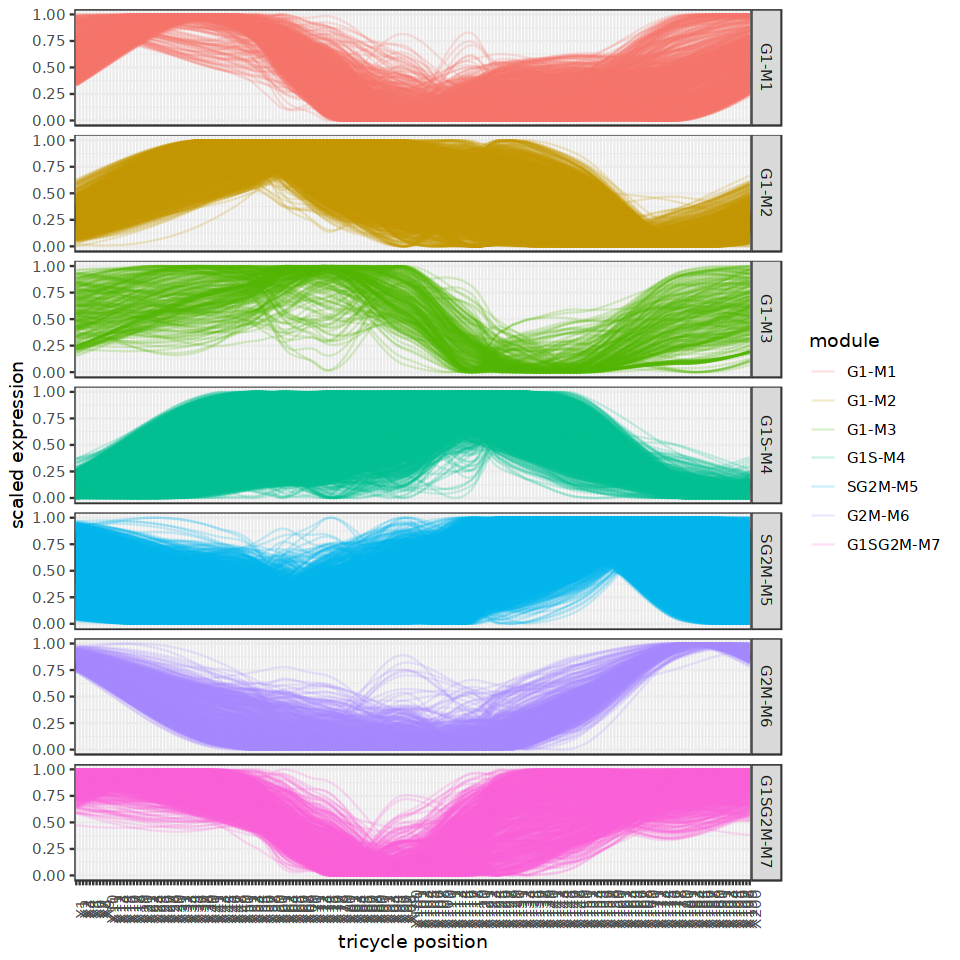

In [ ]:
# pick out a few modules of interest here
modules_of_interest = c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7")

# Pull out list of genes in that module
submod = module_df %>%
  subset(module %in% modules_of_interest)

row.names(module_df) = module_df$gene_id

# Get normalized expression for those genes
expr_normalized <- t(apply(y.list,2, function(x){(x-min(x))/(max(x)-min(x))}))

subexpr = expr_normalized[submod$gene_id,]

submod_df = data.frame(subexpr) %>%
  mutate(
    gene_id = row.names(.)
  ) %>%
  pivot_longer(-gene_id) %>%
  mutate(
    module = module_df[gene_id,]$module
  )

submod_df$name <- factor(submod_df$name, levels = paste0("X",seq(1,200)))
submod_df$module <- factor(submod_df$module, levels =c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"))

submod_df %>% ggplot(., aes(x=name, y=value, group=gene_id)) +
  geom_line(aes(color = module),
            alpha = 0.2) +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90)
  ) +
  facet_grid(rows = vars(module)) +
  labs(x = "tricycle position",
       y = "scaled expression")

In [70]:
## DWF4 (AT3G50660)
mds <- module_df %>% filter((BES_up == "Yes") & (module=="G1-M2") | (gene_id == "AT3G50660") )

In [71]:
length(mds$gene_id)

[1] 295

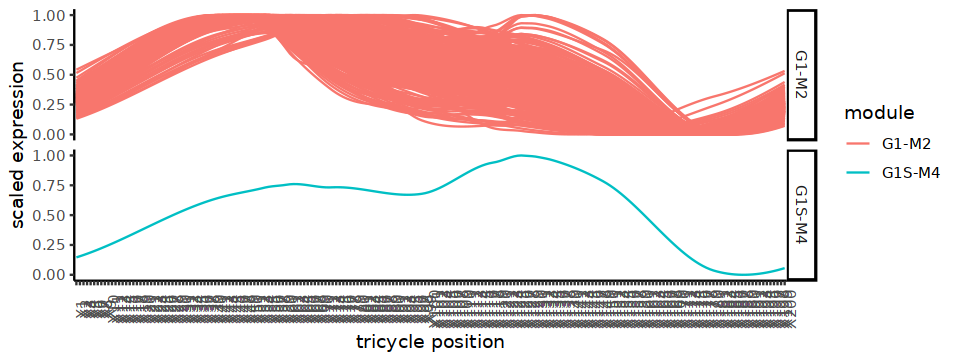

In [72]:
# Get normalized expression for those genes
expr_normalized <- t(apply(y.list,2, function(x){(x-min(x))/(max(x)-min(x))}))

subexpr = expr_normalized[mds$gene_id,]

submod_df = data.frame(subexpr) %>%
  mutate(
    gene_id = row.names(.)
  ) %>%
  pivot_longer(-gene_id) %>%
  mutate(
    module = mds[gene_id,]$module
  )

submod_df$name <- factor(submod_df$name, levels = paste0("X",seq(1,200)))
submod_df$module <- factor(submod_df$module, levels =c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"))

options(repr.plot.width=8, repr.plot.height=3)
submod_df %>% ggplot(., aes(x=name, y=value, group=gene_id)) +
  geom_line(aes(color = module),
            alpha = 1) +
  theme_classic() +
  theme(
    axis.text.x = element_text(angle = 90)
  ) +
  facet_grid(rows = vars(module)) +
  labs(x = "tricycle position",
       y = "scaled expression")

## Module Membership

In [73]:
ME <- moduleEigengenes(y.list, mergedColors)$eigengenes

In [74]:
head(ME)

,MEblack,MEblue,MEbrown,MEgreen,MEgrey,MEmagenta,MEpink,MEpurple,MEred,MEturquoise,MEyellow
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,-0.05077417,-0.05452611,-0.09847776,0.03895037,0.07788725,-0.04454885,-0.018102005,0.006843296,0.07493473,0.03025052,0.09412698
2,-0.05360170,-0.05020672,-0.09702978,0.04251574,0.07426836,-0.04576690,-0.014217854,0.008314627,0.07537663,0.02663406,0.09117627
3,-0.05641352,-0.04581221,-0.09548975,0.04607937,0.07055305,-0.04698306,-0.010264241,0.009782074,0.07577576,0.02298297,0.08813001
4,-0.05920531,-0.04135042,-0.09386194,0.04963553,0.06675043,-0.04819342,-0.006249933,0.011245116,0.07613153,0.01930289,0.08499452
5,-0.06197274,-0.03682921,-0.09215061,0.05317849,0.06286959,-0.04939405,-0.002183695,0.012703230,0.07644333,0.01559943,0.08177612
6,-0.06471148,-0.03225641,-0.09036004,0.05670252,0.05891962,-0.05058103,0.001925706,0.014155894,0.07671056,0.01187821,0.07848115


In [75]:
ME <- ME[,c("MEgreen","MEblue","MEpurple","MEbrown","MEturquoise","MEyellow","MEred")]

In [76]:
colnames(ME)[which(colnames(ME)=="MEgreen")]="G1-M1"
colnames(ME)[which(colnames(ME)=="MEblue")]="G1-M2"
colnames(ME)[which(colnames(ME)=="MEpurple")]="G1-M3"
colnames(ME)[which(colnames(ME)=="MEbrown")]="G1S-M4"
colnames(ME)[which(colnames(ME)=="MEturquoise")]="SG2M-M5"
colnames(ME)[which(colnames(ME)=="MEyellow")]="G2M-M6"
colnames(ME)[which(colnames(ME)=="MEred")]="G1SG2M-M7"


In [77]:
head(ME)

,G1-M1,G1-M2,G1-M3,G1S-M4,SG2M-M5,G2M-M6,G1SG2M-M7
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0.03895037,-0.05452611,0.006843296,-0.09847776,0.03025052,0.09412698,0.07493473
2,0.04251574,-0.05020672,0.008314627,-0.09702978,0.02663406,0.09117627,0.07537663
3,0.04607937,-0.04581221,0.009782074,-0.09548975,0.02298297,0.08813001,0.07577576
4,0.04963553,-0.04135042,0.011245116,-0.09386194,0.01930289,0.08499452,0.07613153
5,0.05317849,-0.03682921,0.012703230,-0.09215061,0.01559943,0.08177612,0.07644333
6,0.05670252,-0.03225641,0.014155894,-0.09036004,0.01187821,0.07848115,0.07671056


In [78]:
datKME = signedKME(y.list[,module_df$gene_id[which(module_df$module != "Unassigned")]], ME, outputColumnName = "kME")

In [79]:
colnames(datKME) <- paste0("kME_",c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"))

In [80]:
head(datKME)

,kME_G1-M1,kME_G1-M2,kME_G1-M3,kME_G1S-M4,kME_SG2M-M5,kME_G2M-M6,kME_G1SG2M-M7
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AT1G01010,0.3542806,-0.2497083,-0.6220967,-0.15155786,0.4829892,0.3177756,0.7662908
AT1G01020,-0.6859566,-0.8698134,-0.9066985,0.06365567,0.9656614,0.4131475,0.1097511
AT1G01030,-0.5296524,-0.9816480,-0.7924996,-0.26085371,0.9786339,0.6839535,0.3127450
AT1G01040,-0.5399912,-0.9946677,-0.6863214,-0.33691247,0.9420173,0.7304031,0.2791594
AT1G01050,0.3391174,0.9800524,0.7104888,0.45382685,-0.9486327,-0.8202130,-0.4970807
AT1G01060,-0.3551540,-0.9286784,-0.8340280,-0.29918733,0.9876031,0.7054946,0.4938400


In [81]:
write.csv(left_join(rownames_to_column(datKME), rownames_to_column(module_df), by=c("rowname")), "./tradeseq/All_genes_Atrichoblast_tricycle_module_membership.csv")

## Export Networks (Obsolete)

In [140]:
genes_of_interest = module_df %>%
  subset(module %in% modules_of_interest[-11])

expr_of_interest = t(y.list)[genes_of_interest$gene_id,]
expr_of_interest[1:5,1:5]
#>                       B-3      B-4      B-5      L-3      L-4
#> AC186512.3_FG001 6.901539 7.389644 6.975945 6.859593 7.370816
#> AC186512.3_FG007 7.919688 7.754506 7.670946 7.417760 7.988427
#> AC190623.3_FG001 6.575155 7.170788 7.438024 8.223261 8.008850
#> AC196475.3_FG004 6.054319 6.439899 6.424540 5.815344 6.565299
#> AC196475.3_FG005 6.194406 5.872273 6.207174 6.499828 6.314952

# Only recalculate TOM for modules of interest (faster, altho there's some online discussion if this will be slightly off)
TOM = TOMsimilarityFromExpr(t(expr_of_interest),
                            power = picked_power)
#> TOM calculation: adjacency..
#> ..will use 4 parallel threads.
#>  Fraction of slow calculations: 0.000000
#> ..connectivity..
#> ..matrix multiplication (system BLAS)..
#> ..normalization..
#> ..done.

# Add gene names to row and columns
row.names(TOM) = row.names(expr_of_interest)
colnames(TOM) = row.names(expr_of_interest)

AT1G01010,0.03437418,0.03445125,0.03452833,0.03460526,0.03468185
AT1G01020,0.16125047,0.15936069,0.15746179,0.15555653,0.15364767
AT1G01030,0.01163936,0.01141413,0.01118563,0.01095425,0.01072038
AT1G01040,0.02817155,0.02762631,0.02707317,0.02651315,0.02594726
AT1G01050,1.13815937,1.14230433,1.14652946,1.15082737,1.15519066


TOM calculation: adjacency..
..will use 94 parallel threads.
 Fraction of slow calculations: 0.000000
..connectivity..
..matrix multiplication (system BLAS)..
..normalization..
..done.


In [141]:
edge_list = data.frame(TOM) %>%
  mutate(
    gene1 = row.names(.)
  ) %>%
  pivot_longer(-gene1) %>%
  dplyr::rename(gene2 = name, correlation = value) %>%
  unique() %>%
  subset(!(gene1==gene2)) %>%
  mutate(
    module1 = module_df[gene1,]$module,
    module2 = module_df[gene2,]$module
  )

head(edge_list)
#> # A tibble: 6 x 5
#>   gene1            gene2            correlation module1   module2  
#>   <chr>            <chr>                  <dbl> <chr>     <chr>    
#> 1 AC186512.3_FG001 AC186512.3_FG007      0.0238 turquoise turquoise
#> 2 AC186512.3_FG001 AC190623.3_FG001      0.0719 turquoise turquoise
#> 3 AC186512.3_FG001 AC196475.3_FG004      0.143  turquoise turquoise
#> 4 AC186512.3_FG001 AC196475.3_FG005      0.0117 turquoise turquoise
#> 5 AC186512.3_FG001 AC196489.3_FG002      0.0181 turquoise turquoise
#> 6 AC186512.3_FG001 AC198481.3_FG004      0.0240 turquoise turquoise

# Export Network file to be read into Cytoscape, VisANT, etc
write_delim(edge_list,
            file = "./tradeseq/Module_network_edgelist.tsv",
            delim = "\t")

gene1,gene2,correlation,module1,module2
<chr>,<chr>,<dbl>,<fct>,<fct>
AT1G01010,AT1G01020,1.263899e-05,G2MG1-M9,S-M7
AT1G01010,AT1G01030,1.360577e-05,G2MG1-M9,S-M7
AT1G01010,AT1G01040,1.104410e-06,G2MG1-M9,S-M7
AT1G01010,AT1G01050,6.631369e-05,G2MG1-M9,G1-M2
AT1G01010,AT1G01060,7.753520e-04,G2MG1-M9,S-M7
AT1G01010,AT1G01070,3.555517e-08,G2MG1-M9,S-M7


In [142]:
## 30G too large
nrow(edge_list)

[1] 589639806

In [143]:
summary(edge_list$correlation)

     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
0.0000000 0.0000138 0.0056340 0.0982158 0.1385098 0.6644113 

In [157]:
edge_list_cor04 <- edge_list %>% filter(correlation>=0.4)

In [158]:
## 2.6G acceptable
nrow(edge_list_cor04)

[1] 52641560

In [159]:
write_delim(edge_list_cor04,
            file = "./tradeseq/Module_network_edgelist_cor04.tsv",
            delim = "\t")

In [160]:
head(edge_list_cor04)

gene1,gene2,correlation,module1,module2
<chr>,<chr>,<dbl>,<fct>,<fct>
AT1G01020,AT1G01090,0.4742238,S-M7,S-M7
AT1G01020,AT1G01130,0.4721234,S-M7,S-M7
AT1G01020,AT1G01260,0.4529889,S-M7,S-M7
AT1G01020,AT1G01290,0.5408273,S-M7,S-M7
AT1G01020,AT1G01370,0.4995471,S-M7,S-M7
AT1G01020,AT1G01480,0.4947831,S-M7,S-M7


In [161]:
table(edge_list_cor04$module1)


     G1-M1      G1-M2      G1-M3      G1-M4     G1S-M5     G1S-M6       S-M7 
     60171    8334861     179501       4033    1002022      49934   40704082 
    G2M-M8   G2MG1-M9    G1S-M10 Unassigned 
   2295271      11613         72          0 

In [162]:
table(edge_list_cor04$module2)


     G1-M1      G1-M2      G1-M3      G1-M4     G1S-M5     G1S-M6       S-M7 
     60171    8334861     179501       4033    1002022      49934   40704082 
    G2M-M8   G2MG1-M9    G1S-M10 Unassigned 
   2295271      11613         72          0 

## GeneOverlap
## Modules vs. signal interested

In [32]:
module_df <- read.csv("./tradeseq/All_genes_Atrichoblast_tricycle_module.csv", row.names=1)

In [33]:
#AR <- read.csv("./tradeseq/Auxin_responsive_genes.csv")
#AR <- AR[AR$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
#AR_up <- read.csv("./tradeseq/IAA_UP.csv")
AR_up <- read.csv("./tradeseq/IAA_UP_Mates_Fendrych.csv")
AR_up <- intersect(unique(gsub("..$","",AR_up$GeneID)), rownames(rc.integrated@assays$SCT@data))
#AR_up <- AR_up[AR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
#AR_down <- read.csv("./tradeseq/IAA_DN.csv")
AR_down <- read.csv("./tradeseq/IAA_DN_Mates_fendrych.csv")
AR_down <- intersect(unique(gsub("..$","",AR_down$GeneID)), rownames(rc.integrated@assays$SCT@data))
#AR_down <- AR_down[AR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
ABAR_up <- read.csv("./tradeseq/ABA_UP.csv")
ABAR_up <- ABAR_up[ABAR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
ABAR_down <- read.csv("./tradeseq/ABA_DN.csv")
ABAR_down <- ABAR_down[ABAR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
ACCR_up <- read.csv("./tradeseq/ACC_UP.csv")
ACCR_up <- ACCR_up[ACCR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
ACCR_down <- read.csv("./tradeseq/ACC_DN.csv")
ACCR_down <- ACCR_down[ACCR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
CR <- read.csv("./tradeseq/CK_response_genes_bert.csv")
CR <- CR[CR$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
CR_up <- CR %>% filter(Regulation == "Up")
CR_up <- CR_up$GeneID
CR_down <- CR %>% filter(Regulation == "Down")
CR_down <- CR_down$GeneID
GAR_up <- read.csv("./tradeseq/GA_UP.csv")
GAR_up <- GAR_up[GAR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
GAR_down <- read.csv("./tradeseq/GA_DN.csv")
GAR_down <- GAR_down[GAR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
SAR_up <- read.csv("./tradeseq/SA_UP.csv")
SAR_up <- SAR_up[SAR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
SAR_down <- read.csv("./tradeseq/SA_DN.csv")
SAR_down <- SAR_down[SAR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
#JAR <- read.csv("./tradeseq/Hickman_2017_JA.csv")
#JAR <- JAR[JAR$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
JAR_up <- read.csv("./tradeseq/JA_UP.csv")
JAR_up <- JAR_up[JAR_up$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
JAR_down <- read.csv("./tradeseq/JA_DN.csv")
JAR_down <- JAR_down[JAR_down$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
SALT <- read.csv("./tradeseq/salt.csv")
SALT <- SALT[SALT$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
DRUT <- read.csv("./tradeseq/Drought.csv")
DRUT <- DRUT[DRUT$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
HEAT <- read.csv("./tradeseq/heat.csv")
HEAT <- HEAT[HEAT$GeneID %in% rownames(rc.integrated@assays$SCT@data),]
COLD <- read.csv("./tradeseq/Thomashow_cold.csv")
COLD <- COLD[COLD$GeneID %in% rownames(rc.integrated@assays$SCT@data),]


In [34]:
module_df$AR_up <- rep("No",nrow(module_df))
module_df$AR_up[match(AR_up, module_df$gene_id)[!is.na(match(AR_up, module_df$gene_id))]]="Yes"
module_df$AR_down <- rep("No",nrow(module_df))
module_df$AR_down[match(AR_down, module_df$gene_id)[!is.na(match(AR_down, module_df$gene_id))]]="Yes"
module_df$CR_up <- rep("No",nrow(module_df))
module_df$CR_up[match(CR_up, module_df$gene_id)[!is.na(match(CR_up, module_df$gene_id))]]="Yes"
module_df$CR_down <- rep("No",nrow(module_df))
module_df$CR_down[match(CR_down, module_df$gene_id)[!is.na(match(CR_down, module_df$gene_id))]]="Yes"
module_df$ABAR_up <- rep("No",nrow(module_df))
module_df$ABAR_up[match(CR_up, module_df$gene_id)[!is.na(match(ABAR_up, module_df$gene_id))]]="Yes"
module_df$ABAR_down <- rep("No",nrow(module_df))
module_df$ABAR_down[match(ABAR_down, module_df$gene_id)[!is.na(match(ABAR_down, module_df$gene_id))]]="Yes"
module_df$ACCR_up <- rep("No",nrow(module_df))
module_df$ACCR_up[match(ACCR_up, module_df$gene_id)[!is.na(match(ACCR_up, module_df$gene_id))]]="Yes"
module_df$ACCR_down <- rep("No",nrow(module_df))
module_df$ACCR_down[match(ACCR_down, module_df$gene_id)[!is.na(match(ACCR_down, module_df$gene_id))]]="Yes"
module_df$GAR_up <- rep("No",nrow(module_df))
module_df$GAR_up[match(GAR_up, module_df$gene_id)[!is.na(match(GAR_up, module_df$gene_id))]]="Yes"
module_df$GAR_down <- rep("No",nrow(module_df))
module_df$GAR_down[match(GAR_down, module_df$gene_id)[!is.na(match(GAR_down, module_df$gene_id))]]="Yes"
module_df$SAR_up <- rep("No",nrow(module_df))
module_df$SAR_up[match(SAR_up, module_df$gene_id)[!is.na(match(SAR_up, module_df$gene_id))]]="Yes"
module_df$SAR_down <- rep("No",nrow(module_df))
module_df$SAR_down[match(SAR_down, module_df$gene_id)[!is.na(match(SAR_down, module_df$gene_id))]]="Yes"
#module_df$JAR <- rep("No",nrow(module_df))
#module_df$JAR[match(JAR, module_df$gene_id)[!is.na(match(JAR, module_df$gene_id))]]="Yes"
module_df$JAR_up <- rep("No",nrow(module_df))
module_df$JAR_up[match(JAR_up, module_df$gene_id)[!is.na(match(JAR_up, module_df$gene_id))]]="Yes"
module_df$JAR_down <- rep("No",nrow(module_df))
module_df$JAR_down[match(JAR_down, module_df$gene_id)[!is.na(match(JAR_down, module_df$gene_id))]]="Yes"
module_df$SALT <- rep("No",nrow(module_df))
module_df$SALT[match(SALT, module_df$gene_id)[!is.na(match(SALT, module_df$gene_id))]]="Yes"
module_df$DRUT <- rep("No",nrow(module_df))
module_df$DRUT[match(DRUT, module_df$gene_id)[!is.na(match(DRUT, module_df$gene_id))]]="Yes"
module_df$HEAT <- rep("No",nrow(module_df))
module_df$HEAT[match(HEAT, module_df$gene_id)[!is.na(match(HEAT, module_df$gene_id))]]="Yes"
module_df$COLD <- rep("No",nrow(module_df))
module_df$COLD[match(COLD, module_df$gene_id)[!is.na(match(COLD, module_df$gene_id))]]="Yes"


In [35]:
head(module_df)

,gene_id,colors,module,BES_up,BES_down,MYB3R4,AR_up,AR_down,CR_up,CR_down,...,GAR_up,GAR_down,SAR_up,SAR_down,JAR_up,JAR_down,SALT,DRUT,HEAT,COLD
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,...,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,AT1G01010,red,G1SG2M-M7,No,No,No,No,No,No,No,...,No,No,Yes,No,No,No,No,No,Yes,No
2,AT1G01020,turquoise,SG2M-M5,No,No,No,No,No,No,No,...,No,No,No,No,No,No,No,No,No,No
3,AT1G01030,turquoise,SG2M-M5,No,No,No,No,No,No,No,...,No,No,No,No,No,No,No,No,Yes,No
4,AT1G01040,turquoise,SG2M-M5,No,No,No,No,No,No,No,...,No,No,No,No,No,No,No,No,No,No
5,AT1G01050,blue,G1-M2,No,No,No,No,No,No,No,...,No,No,No,No,No,Yes,No,No,No,No
6,AT1G01060,turquoise,SG2M-M5,No,No,No,Yes,No,No,No,...,No,No,No,No,No,No,Yes,Yes,Yes,Yes


In [36]:
## Prepare gene module list
module_sel <- select(module_df, gene_id, module)
module_list <- split(module_sel, f=module_sel$module)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="gene_id"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$gene_id)))

In [37]:
module_list <- module_list[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7")]

In [38]:
## Prepare gene lists to intersect with module
BES_up <- module_df$gene_id[which(module_df$BES_up=="Yes")]
BES_down <- module_df$gene_id[which(module_df$BES_down=="Yes")]
MYB3R4 <- module_df$gene_id[which(module_df$MYB3R4=="Yes")]
g_list <- list("BES_up"=BES_up, "BES_down"=BES_down, "MYB3R4"=MYB3R4)

In [39]:
## GeneOverlap 

# number of integrated features

genome_size <- 26058L

#compare all lists
gom.self <- newGOM(module_list, g_list, genome.size=genome_size)

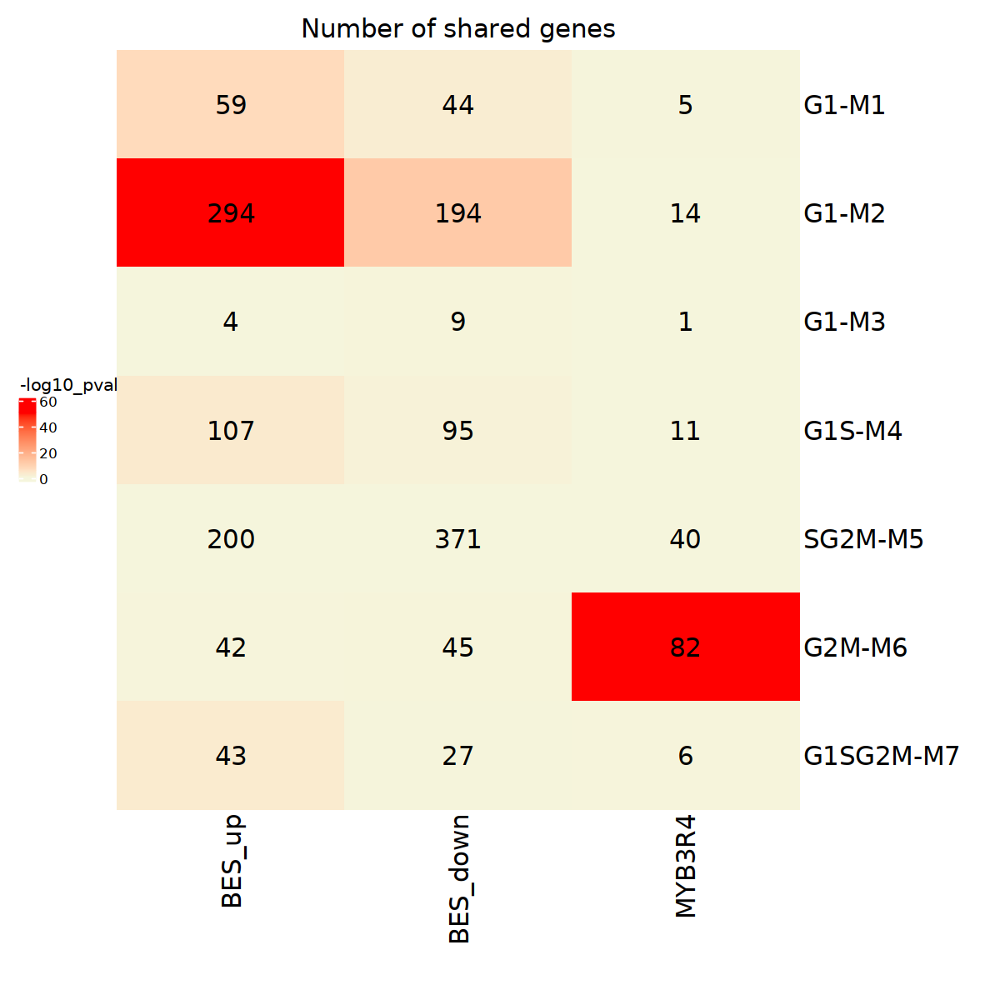

In [40]:
options(repr.plot.width = 10, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)
p.val_log <- p.val_log[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"),]

olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 50), 
                                 c("beige", "red")), 
                column_title = "Number of shared genes", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE,
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")
     

In [891]:
## Prepare gene module list
module_sel <- select(module_df, gene_id, module)
module_list <- split(module_sel, f=module_sel$module)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="gene_id"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$gene_id)))

In [42]:
module_list <- module_list[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7")]

In [43]:
## Prepare gene lists to intersect with module
BES_up <- module_df$gene_id[which(module_df$BES_up=="Yes")]
BES_down <- module_df$gene_id[which(module_df$BES_down=="Yes")]
IAA_up <- module_df$gene_id[which(module_df$AR_up=="Yes")]
IAA_down <- module_df$gene_id[which(module_df$AR_down=="Yes")]
ABA_up <- module_df$gene_id[which(module_df$ABAR_up=="Yes")]
ABA_down <- module_df$gene_id[which(module_df$ABAR_down=="Yes")]
ACC_up <- module_df$gene_id[which(module_df$ACCR_up=="Yes")]
ACC_down <- module_df$gene_id[which(module_df$ACCR_down=="Yes")]
GA_up <- module_df$gene_id[which(module_df$GAR_up=="Yes")]
GA_down <- module_df$gene_id[which(module_df$GAR_down=="Yes")]
SA_up <- module_df$gene_id[which(module_df$SAR_up=="Yes")]
SA_down <- module_df$gene_id[which(module_df$SAR_down=="Yes")]
CK_up <- module_df$gene_id[which(module_df$CR_up=="Yes")]
CK_down <- module_df$gene_id[which(module_df$CR_down=="Yes")]
JA_up <- module_df$gene_id[which(module_df$JAR_up=="Yes")]
JA_down <- module_df$gene_id[which(module_df$JAR_down=="Yes")]
MYB3R4 <- module_df$gene_id[which(module_df$MYB3R4=="Yes")]
SALT <- module_df$gene_id[which(module_df$SALT=="Yes")]
DRUT <- module_df$gene_id[which(module_df$DRUT=="Yes")]
HEAT <- module_df$gene_id[which(module_df$HEAT=="Yes")]
COLD <- module_df$gene_id[which(module_df$COLD=="Yes")]
g_list <- list("BES_up"=BES_up, "BES_down"=BES_down, "JA_up"=JA_up, "JA_down"=JA_down, "IAA_up"=IAA_up, "IAA_down"=IAA_down, "SA_up"=SA_up, "SA_down"=SA_down,
                "ACC_up"=ACC_up, "ACC_down"=ACC_down, "GA_up"=GA_up, "GA_down"=GA_down,"CK_up"=CK_up, "CK_down"=CK_down, "ABA_up"=ABA_up, "ABA_down"=ABA_down,
               "MYB3R4"=MYB3R4, "Salt" = SALT, "Draught" = DRUT, "Heat" = HEAT, "Cold"=COLD)

In [44]:
## GeneOverlap 

# number of integrated features

genome_size <- 26058L

#compare all lists
gom.self <- newGOM(module_list, g_list, genome.size=genome_size)

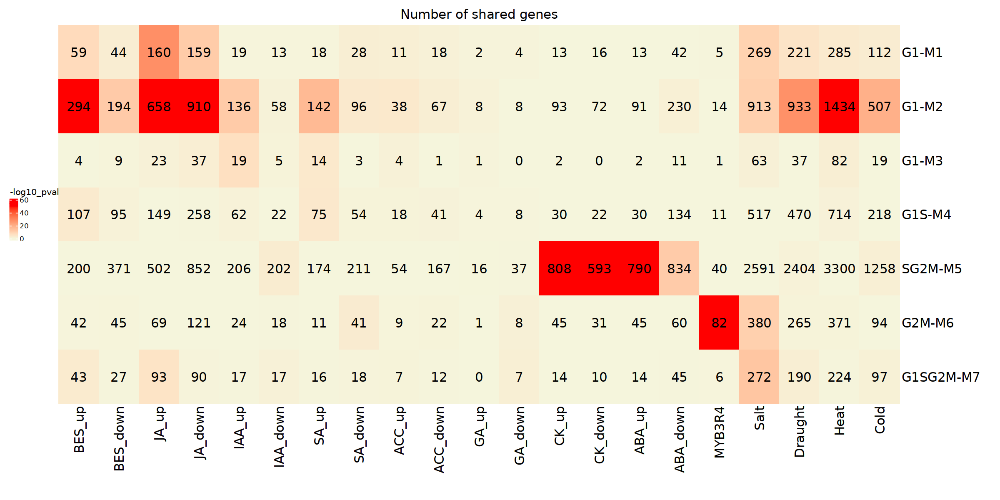

In [45]:
options(repr.plot.width = 20, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)
p.val_log <- p.val_log[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"),]

olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 50), 
                                 c("beige", "red")), 
                column_title = "Number of shared genes", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE,
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")
     

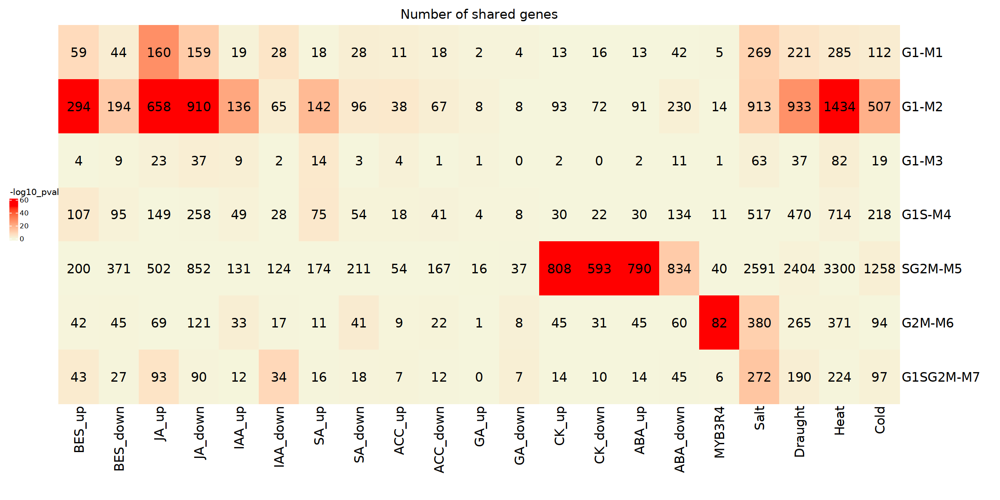

In [67]:
options(repr.plot.width = 20, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)
p.val_log <- p.val_log[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"),]

olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 50), 
                                 c("beige", "red")), 
                column_title = "Number of shared genes", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE,
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")
     

## Check signals (z-score) in the proliferation domain Atrichoblast

In [41]:
bsn <- read.csv("./tradeseq/BR_bsn_genes.csv")

In [42]:
head(bsn)

,Name,AGI
,<chr>,<chr>
1,DWF4,AT3G50660
2,CPD,AT5G05690
3,DET2,AT2G38050
4,ROT3,AT4G36380
5,CYP90D1,AT3G13730
6,BR6OX1,AT5G38970


In [43]:
s1 <- intersect(module_list$`G1-M2`, g_list$BES_up)
length(s1)
#s2 <- intersect(module_list$`G1-M2`, g_list$BES_down)
s2 <- intersect(module_df$gene_id, bsn$AGI)
length(s2)

[1] 294

[1] 3

In [44]:
s1

[1] "AT1G02360" "AT1G03870" "AT1G04680" "AT1G05420" "AT1G05530" "AT1G07410"
  [7] "AT1G08500" "AT1G08510" "AT1G08930" "AT1G09950" "AT1G10480" "AT1G11700"
 [13] "AT1G12240" "AT1G12850" "AT1G13110" "AT1G13260" "AT1G14290" "AT1G14685"
 [19] "AT1G19835" "AT1G19840" "AT1G20010" "AT1G20823" "AT1G20840" "AT1G21830"
 [25] "AT1G21900" "AT1G22180" "AT1G22330" "AT1G22640" "AT1G22910" "AT1G23060"
 [31] "AT1G24170" "AT1G25400" "AT1G25450" "AT1G25550" "AT1G27200" "AT1G28130"
 [37] "AT1G28280" "AT1G29280" "AT1G29290" "AT1G29640" "AT1G32090" "AT1G32700"
 [43] "AT1G33230" "AT1G33240" "AT1G33590" "AT1G49500" "AT1G50430" "AT1G52750"
 [49] "AT1G54120" "AT1G56630" "AT1G57990" "AT1G61100" "AT1G61740" "AT1G62300"
 [55] "AT1G63000" "AT1G65295" "AT1G65840" "AT1G66150" "AT1G68490" "AT1G68840"
 [61] "AT1G69030" "AT1G69780" "AT1G69930" "AT1G70950" "AT1G72510" "AT1G72690"
 [67] "AT1G74940" "AT1G75540" "AT1G76090" "AT1G76180" "AT1G76600" "AT1G77640"
 [73] "AT1G78230" "AT1G78300" "AT1G78850" "AT5G01800" "AT5G02260" "AT5G02580"
 [79] "AT5G04470" "AT5G04480" "AT5G05100" "AT5G05440" "AT5G05600" "AT5G06700"
 [85] "AT5G06930" "AT5G07440" "AT5G08790" "AT5G11640" "AT5G11970" "AT5G12940"
 [91] "AT5G13180" "AT5G13240" "AT5G14110" "AT5G15150" "AT5G15350" "AT5G16110"
 [97] "AT5G16360" "AT5G18670" "AT5G19190" "AT5G19340" "AT5G20050" "AT5G20150"
[103] "AT5G20250" "AT5G21280" "AT5G22950" "AT5G23280" "AT5G23860" "AT5G24910"
[109] "AT5G25100" "AT5G40890" "AT5G41080" "AT5G45280" "AT5G48560" "AT5G51060"
[115] "AT5G52280" "AT5G52882" "AT5G53460" "AT5G54145" "AT5G54380" "AT5G54750"
[121] "AT5G54850" "AT5G56040" "AT5G58560" "AT5G61440" "AT5G63650" "AT5G63800"
[127] "AT5G64740" "AT5G64850" "AT5G65390" "AT5G65660" "AT5G66690" "AT5G67390"
[133] "AT3G02570" "AT3G02580" "AT3G04730" "AT3G04910" "AT3G05165" "AT3G05890"
[139] "AT3G05910" "AT3G06060" "AT3G06070" "AT3G06890" "AT3G07000" "AT3G07010"
[145] "AT3G07460" "AT3G10720" "AT3G11130" "AT3G11590" "AT3G11700" "AT3G12610"
[151] "AT3G12710" "AT3G13310" "AT3G13320" "AT3G13790" "AT3G15540" "AT3G15810"
[157] "AT3G16370" "AT3G16690" "AT3G16850" "AT3G17120" "AT3G17860" "AT3G18780"
[163] "AT3G19030" "AT3G19680" "AT3G19930" "AT3G20340" "AT3G21700" "AT3G23690"
[169] "AT3G23820" "AT3G25730" "AT3G28180" "AT3G28910" "AT3G30775" "AT3G43430"
[175] "AT3G43800" "AT3G46280" "AT3G49820" "AT3G49940" "AT3G50350" "AT3G52360"
[181] "AT3G52450" "AT3G52470" "AT3G52500" "AT3G53480" "AT3G53600" "AT3G54770"
[187] "AT3G54810" "AT3G55740" "AT3G55960" "AT3G56800" "AT3G56880" "AT3G58120"
[193] "AT3G58850" "AT3G60540" "AT2G01300" "AT2G01670" "AT2G02180" "AT2G04500"
[199] "AT2G14890" "AT2G15390" "AT2G17290" "AT2G17300" "AT2G18160" "AT2G18960"
[205] "AT2G19800" "AT2G20562" "AT2G20670" "AT2G20780" "AT2G22125" "AT2G23690"
[211] "AT2G24765" "AT2G25430" "AT2G26710" "AT2G27050" "AT2G27770" "AT2G28200"
[217] "AT2G30520" "AT2G30990" "AT2G32140" "AT2G32580" "AT2G34770" "AT2G35880"
[223] "AT2G36310" "AT2G36320" "AT2G36380" "AT2G37678" "AT2G37940" "AT2G38120"
[229] "AT2G38310" "AT2G38400" "AT2G39130" "AT2G39180" "AT2G39200" "AT2G40470"
[235] "AT2G40970" "AT2G41110" "AT2G42380" "AT2G42570" "AT2G42870" "AT2G42880"
[241] "AT2G43290" "AT2G43340" "AT2G44740" "AT2G44940" "AT2G45070" "AT2G45200"
[247] "AT2G45670" "AT2G47000" "AT2G47485" "AT2G47550" "AT4G01410" "AT4G03190"
[253] "AT4G04745" "AT4G10380" "AT4G11280" "AT4G12730" "AT4G14560" "AT4G14750"
[259] "AT4G14980" "AT4G15800" "AT4G16380" "AT4G16745" "AT4G17870" "AT4G17900"
[265] "AT4G18380" "AT4G19120" "AT4G20300" "AT4G20870" "AT4G21850" "AT4G22010"
[271] "AT4G22590" "AT4G22820" "AT4G25260" "AT4G25350" "AT4G25360" "AT4G27654"
[277] "AT4G30410" "AT4G30440" "AT4G30500" "AT4G31920" "AT4G32150" "AT4G32480"
[283] "AT4G34800" "AT4G34810" "AT4G35320" "AT4G35335" "AT4G35500" "AT4G35600"
[289] "AT4G36040" "AT4G36500" "AT4G37470" "AT4G38470" "AT4G39390" "AT1G78460"

In [45]:
s2

[1] "AT5G05690" "AT3G13730" "AT3G50660"

In [964]:
rc.sub <- subset(rc.integrated, cells= colnames(rc.integrated)[which(rc.integrated$tricycleCCStage == "G1/G0")])

In [965]:
zscore <- function(x){(x-mean(x))/sd(x)}
s1z <- as.numeric(apply(apply(as.matrix(rc.sub@assays$SCT@data)[s1,], 1, zscore), 1, function(x){mean(x,na.rm = TRUE)}))
s2z <- as.numeric(apply(apply(as.matrix(rc.sub@assays$SCT@data)[s2,], 1, zscore), 1, function(x){mean(x,na.rm = TRUE)}))

In [966]:
summary(s1z)
summary(s2z)

    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-0.75262 -0.24233 -0.03733  0.00000  0.21976  1.06890 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-0.1528 -0.1528 -0.1528  0.0000 -0.1528 11.8146 

In [967]:
dat <- data.frame(cell_id=colnames(rc.sub), tricyclePosition=rc.sub$tricyclePosition,Signature1=s1z, Signature2=s2z)
dat <- dat %>% mutate(diff = abs(Signature1-Signature2))

In [968]:
range01 <- function(x){(x-min(x))/(max(x)-min(x))}

In [969]:
dat$Signature1_scaled <- range01(dat$Signature1)
dat$Signature2_scaled <- range01(dat$Signature2)
dat$ratio <- dat$Signature1_scaled/dat$Signature2_scaled

In [970]:
head(dat)

,cell_id,tricyclePosition,Signature1,Signature2,diff,Signature1_scaled,Signature2_scaled,ratio
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACCTGAGCGCCTCA_1,AAACCTGAGCGCCTCA_1,0.4515482,-0.42783066,-0.1528441,0.27498657,0.1783079,0,Inf
AACCGCGCATAACCTG_1,AACCGCGCATAACCTG_1,0.5226149,-0.07519829,-0.1528441,0.07764579,0.3718996,0,Inf
AACTCAGCACCAACCG_1,AACTCAGCACCAACCG_1,0.5550358,0.41416630,-0.1528441,0.56701038,0.6405559,0,Inf
AACTCCCAGAGTGAGA_1,AACTCCCAGAGTGAGA_1,0.5670711,0.30187488,-0.1528441,0.45471896,0.5789090,0,Inf
AACTGGTCACGTTGGC_1,AACTGGTCACGTTGGC_1,0.6099921,0.01974415,-0.1528441,0.17258824,0.4240221,0,Inf
AAGCCGCAGATATACG_1,AAGCCGCAGATATACG_1,0.5084395,-0.08788067,-0.1528441,0.06496341,0.3649371,0,Inf


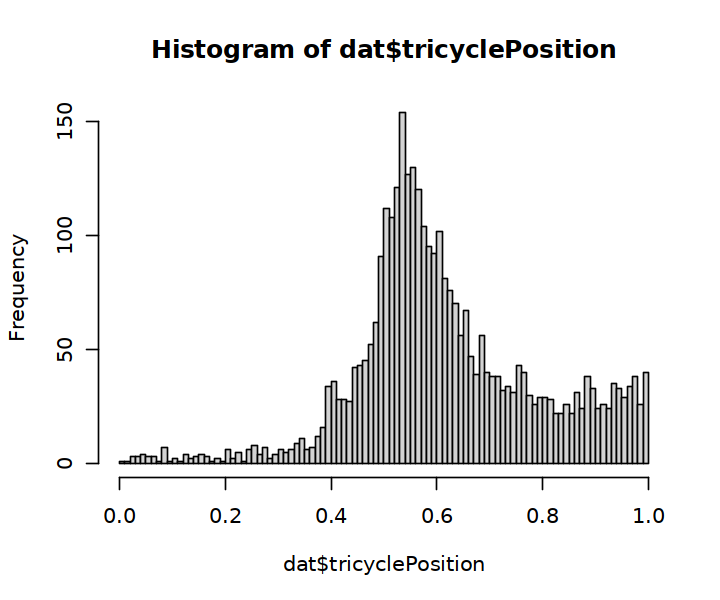

In [971]:
options(repr.plot.width=6, repr.plot.height=5)
hist(dat$tricyclePosition, breaks = 100)

In [972]:
summary(dat$Signature1)

    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-0.75262 -0.24233 -0.03733  0.00000  0.21976  1.06890 

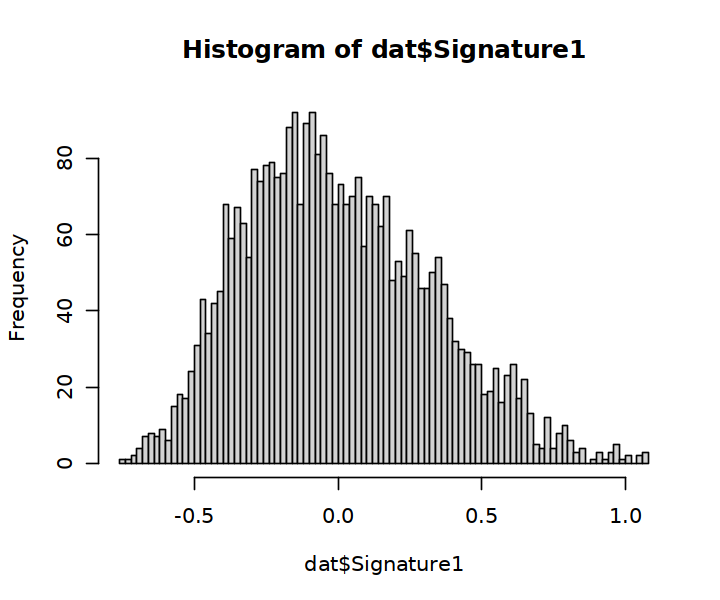

In [973]:
options(repr.plot.width=6, repr.plot.height=5)
hist(dat$Signature1, breaks =100)

In [974]:
as.numeric(quantile(dat$Signature1, 0.9))

[1] 0.4399113

In [975]:
as.numeric(quantile(dat$Signature2, 0.9))

[1] 0.8386878

In [976]:
summary(dat$Signature2)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-0.1528 -0.1528 -0.1528  0.0000 -0.1528 11.8146 

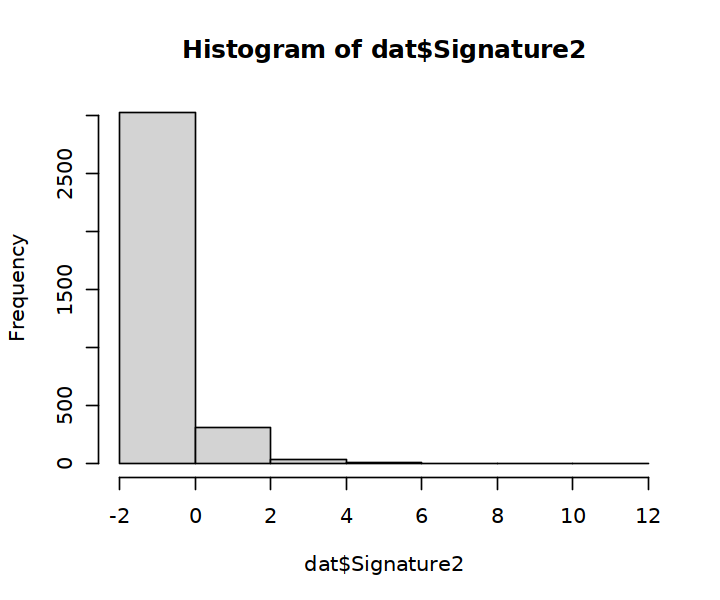

In [977]:
options(repr.plot.width=6, repr.plot.height=5)
hist(dat$Signature2, breaks =5)

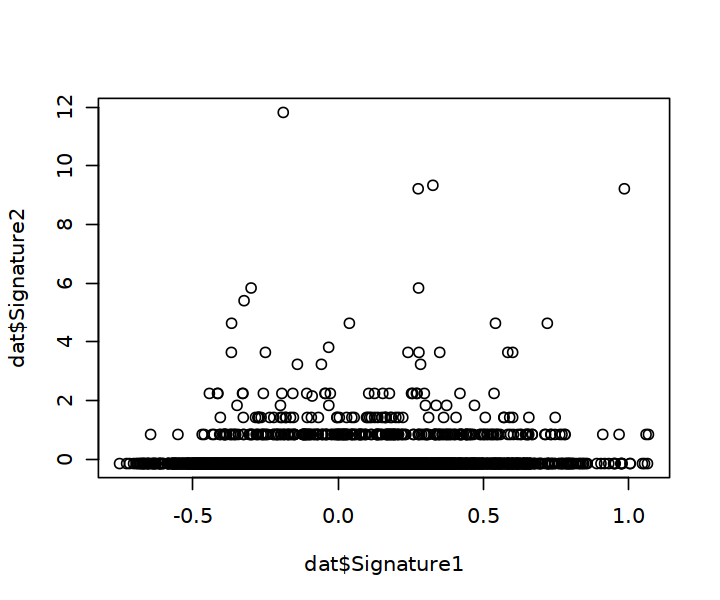

In [978]:
plot(dat$Signature1, dat$Signature2)

In [979]:
sum(dat$Signature2>0)/nrow(dat)

[1] 0.1049364

In [980]:
table(rc.sub$tricycleCCStage)


G1/G0 
 3383 

In [981]:
rc.sub

An object of class Seurat 
74352 features across 3383 samples within 3 assays 
Active assay: SCT (26058 features, 0 variable features)
 2 other assays present: RNA, integrated
 3 dimensional reductions calculated: pca, umap, umap_2D

In [ ]:
rank(dat$Signature1) < nrow(dat)/10

In [986]:
nrow(dat)/10

[1] 338.3

In [988]:
dat$Signature1

[1] -0.4278306559 -0.0751982918  0.4141662991  0.3018748752  0.0197441517
   [6] -0.0878806734  0.4135285348  0.4950561985  0.1063430470  0.5157688828
  [11] -0.4652527107  0.7618234061  0.2416365066  0.0128106950 -0.4141240871
  [16] -0.0953862440 -0.1779138357 -0.4792649139  0.2494104172  0.0351947413
  [21] -0.2194446885 -0.1542022918 -0.0731854703 -0.2615941273 -0.3364381472
  [26] -0.0839178323 -0.1943604359 -0.2633385365 -0.0718372503 -0.2157950431
  [31]  0.0441316920  0.5051578753  0.0164065077 -0.2395936327 -0.1328397138
  [36]  0.6630054781 -0.2007152628  0.1196763937  0.0750568678 -0.0503876633
  [41]  0.7211769343 -0.0425724094 -0.1033844368 -0.2596426963  0.2263545184
  [46]  0.3310699337  0.4715734374  0.1661462458 -0.3470650254  0.2403560871
  [51]  0.3957635760 -0.1007466034  0.3100949344 -0.2701209406 -0.0935968921
  [56] -0.4296879853  0.5835732721  0.1837320651  0.2218773478 -0.2334453043
  [61] -0.2095094052 -0.4874698001 -0.1928200955 -0.3452764358 -0.2964992543
  [66] -0.1580395421 -0.0567589349  0.0527050352 -0.0734662825 -0.2150803010
  [71]  0.1677081810 -0.3210014784  0.0016579340  0.5115169848  0.0502887046
  [76] -0.1144432755 -0.0969416359 -0.3827983592  0.3307410938 -0.2666506247
  [81]  0.3522154796 -0.0221902898  0.1580281062  0.4841609600  0.4149522487
  [86] -0.0994683053 -0.2016389721  0.1286145671 -0.1960026302 -0.1888353733
  [91]  0.2186972267  0.1441230872 -0.0212562323 -0.1268130567  0.0618721600
  [96] -0.0533069214 -0.3268279743 -0.0185850176  0.0700129402  0.5007833455
 [101]  0.4482236511 -0.3941217626 -0.0455335698  0.4873771991  0.3256115592
 [106] -0.0543952432 -0.3328149696 -0.0589705879  0.1186827602  0.8430854167
 [111]  0.5898865256 -0.1160631091 -0.2247674969  0.1987892809  0.0130406790
 [116] -0.2358072382  0.1902257781 -0.3667898356  0.0812438300 -0.1901114026
 [121]  0.1745659969  0.1746056206  0.2059981404 -0.4128819634  0.1580012420
 [126]  0.2306486823  0.3748770217 -0.1247798675  0.4261527347 -0.0179752411
 [131] -0.1165333786  0.0262673598 -0.2109622417 -0.1072435311  0.4398924928
 [136] -0.0079458132  0.1553544486 -0.3405983744 -0.2146835379  0.4540999120
 [141]  0.2170801329  0.1871910902 -0.2237737153  0.0662513138 -0.1944972376
 [146] -0.5669648428 -0.2929935316  0.3671342517 -0.1899434669 -0.4164867480
 [151]  0.4282999109  0.0764808338 -0.3150012506  0.3646101495  0.3663385952
 [156]  0.0327995145  0.1095097441  0.5709414442  0.4626315775  0.0735361257
 [161] -0.2851293052  0.7949531274 -0.1978474738 -0.1069701377  0.0321895649
 [166]  0.4002065316 -0.1076811299 -0.3194304841 -0.0554420832 -0.1585428999
 [171]  0.2726689918 -0.2042037252 -0.2668831603 -0.2938333687  0.7352516914
 [176]  0.1161210155 -0.3095455173  0.4667616739 -0.1941345266 -0.2047214285
 [181] -0.1364552596  0.4713724343 -0.0447971764 -0.2247472827  0.3228124818
 [186] -0.0594773615 -0.1023059963 -0.4895361905 -0.2119688472  0.4159624976
 [191]  0.0333273430 -0.3264623808 -0.4977445755  0.8098664328  0.0822390346
 [196] -0.1660288673 -0.2865299183  0.5116120559 -0.2410405270 -0.0659624097
 [201]  0.0018414278  0.2125252875 -0.1635295634 -0.1192498933 -0.0034400845
 [206]  0.3526126699  0.2779560534 -0.0391089079  0.0237861490  0.0342066466
 [211]  0.0061890183 -0.0655615975 -0.0828601675  0.2564415357 -0.2296490579
 [216] -0.3714356477  0.9545451919 -0.1078501464  0.4062700748 -0.1568273093
 [221] -0.1852500527 -0.1811283948 -0.1239111771  0.3811145608  0.3969207662
 [226] -0.1511942914 -0.2685780652 -0.0121999987 -0.0904096450 -0.1281874409
 [231] -0.4305027380 -0.3040375928 -0.0193506646  0.0200408851 -0.0570831122
 [236]  0.2529152692  0.1471368001  0.0213207870  0.3292916671 -0.3377224997
 [241] -0.0850390646  0.5242016032 -0.0634324831  0.1332021952  0.0243352675
 [246] -0.0982922133  0.2511480038 -0.2786444114  0.1095143936  0.3980754481
 [251]  0.1662186907 -0.3848626553  0.0133157611  0.5698037030  0.2350647990
 [256]  0.6148932700  0.3304043995  0.3638161764  0.3929841325 -0.2824013807

In [989]:
order(dat$Signature1)

[1] 2774 3218 2998 2501 2940 2775 2513 2419 2474 2752 2762 1649 2677 3000
  [15] 3021 2797 3064 2341 3119 2569 2389 2917 2732 2932 3182 2631 2889 2361
  [29] 2481 2729 2922 2850 2635 2387 2525 2468 2287 1750 3173 2534 2599 2936
  [43] 2710  448 2331 3127 1641 2757 2313 3114 1552 3176  146 1917 2686  957
  [57] 2808 1003 2013 3201 2883 2562 2530 3139 2630 2577 2827 3121 2937 3168
  [71] 1041 2724 2994 2628 3030 3061 3125 2739  887 2796 3078 1609  440 2960
  [85] 2692  360 2402 3156 2736 2296 2413 2968 2348 2990 2618 1071 2897 1744
  [99] 2804 1899 2611 2489 2763  429 1798 3052 2693 2136  300 3150  414 2104
 [113] 2964  351 2551 2072  430 2563  980 2183 2446 3184 2447  193 2383 3066
 [127] 2793 2678 3198 2307  872 2641 3132  966  188 2643 1582 2700 2289 2075
 [141]   62 2519 3041 3106 3136 2301 3048 2993 2467  376 2730  398   18 2587
 [155] 2776 2423 2671  357 2470 3158 2293 2424 2455 2938 2862 3117 2542 2894
 [169] 2876 2594 3005 2834 2779 2399 1590 3045 2691 2946 2902  450 2908   11
 [183] 2508 2722 2872  873 2607 2867 2505 3190 2988 3220 2712  958 2916 2322
 [197] 2878 3142 3112 2373 2391 2992 2571 1062 3161 2210 2574 2344 2381 3181
 [211] 2996 2433 2492 2933  433 2847 1567 1070 2726 3089 2995 2511 3111 2463
 [225] 2441 2770 2945 2480 3095 2818 1026  444  911 3205 3204 2896 2795 2733
 [239] 2215 3200 2620  799  231 2784 2900   56 2583 2858 2317 3086    1 3157
 [253]  844 3083 3040 3107 3194 2906 3166 2748 3215 2320 2392 2409  400 2919
 [267] 2841 2064 3180 2819  324 2275 2568 3044  150 3060 2299 2370 2608 2838
 [281] 2664 2610  795  540 1809 1941   15 2496 2566  124 2848 2910 3145 1784
 [295] 1752 1755 1607 2675 2759 2658 2815 2300 1060 2366 2875 2345 3159 1043
 [309] 2978 2585 2702 3010 2886 2863 2832 1967 2668 3071 1688 3067 2536 2660
 [323] 3186 2892 2723 2879 2782 2410  279 3087 2579 2672 2701 3042  102 3126
 [337] 2638  452 2325 2315 2250 2457 2281 2475 2000 3216 2874 2709 2957 2561
 [351] 1667  428 1851 2430 2929  393 2452  758 2545 3105 1594  967  843  252
 [365] 3009 2717 2532 2596 2303 2582 1680 2681 2705 1586   78  864 2529 1849
 [379] 1963 2265 1583  439 2813 3191 2478 2868  993 2514 2833 2386 2811 2507
 [393] 2556 2928 2358 2898 3104  816 2318 1986  216 3179 3171  824  559 2706
 [407]  413 2575 2363 2682 1723 2949 2486 3221 2973 2277  984 2557 2396 2716
 [421]  118  480 2591  367  796 3016 2965 2498 2985  280 3214 3210 2418 1987
 [435] 2306 2623  431 1919 2715  462  768  359 2473 3028  341 2539 2342 3037
 [449] 3001 2790 2873  402 2670 2829 2382 2843  878 3144 1014 2584  421 2102
 [463] 1814 3070  515 2935 2393 2378 1822 2720 3090 3196  915 2053 2803 2578
 [477]  501 2286 1006 1892  841   49 2088 3289 1945 2958 2485 2962 3058 2616
 [491]   64 3175 3046 2302 3149 3187 2734 2321 2022 2792 2450 2662  788  848
 [505] 3018  804  138 2731 2825  889  240  823  304 1683   25 2515 2984 2986
 [519] 2305 2604 1640 2503 1694 3374 2954 2233 3006 3082 2212 2721 2625  107
 [533] 2335 1620 3110  388 2634 2510 1645 3050 1612 2740 3101  703   97 2836
 [547] 2354  192 2924 3185 2942  830 2246 2857 2544 2202 2977 2523 2809 2913
 [561] 2208 2747 2826  839 2627 2966  317 1891 2646   72  867  168 3026 2432
 [575] 2768 2304 1686 2846  983  153 2015  890 2375 2460 1579 2476 3152 2707
 [589] 3151 1676 2909 2975  951  863 2543 2696 2979  177 2353  565 2365 1999
 [603] 3143 1964 1940 2374 3029  721  988 2497 1048 1910 2273  232 2263 2934
 [617] 2451  571 2094 3172 2266 2800  478  434  902 3376 2240 2026  265 3080
 [631] 3203   65  930 2006 2309 2944 2127 2415 2089  387  503 2085  174 2518
 [645] 3056 2851  931  147 2241 2237 3120 2272 1904  947 3054 3169 1838 2997
 [659] 2923  562 2974 2343 1900 1056 2472 2661 3160 3020 1715 2461 2390 1805
 [673] 3019  961 2533 2406 2379 2861  197 3199 1727  395 3108 2555 2235  161
 [687] 2095 2789 2135 2401 1004 1479 1741  260 2744 1613  438  412 1728 2649
 [701]  950 3343 2853 2553 1825  546  270 2844 2023  248 1693  853 2219 1923
 [715] 2802 3055 3024 2080 2735 2685 2001 1628 1758 2372 2453 3097 2502 2214

In [999]:
length((order(dat$Signature1[which(dat$inianno == "S1")]) < nrow(dat)/10))

[1] 1920

In [1000]:
dat$inianno <- rep("Unassigned", length(rc.integrated))
dat$anno <- rep("Unassigned", length(rc.integrated))
#dat$anno[which((dat$Signature1 >0) & (dat$Signature1 > dat$Signature2))] = "S1"
#dat$anno[which((dat$Signature2 >0) & (dat$Signature2 > dat$Signature1))] = "S2"
dat$inianno[which((dat$Signature1 > dat$Signature2))] = "S1"
dat$inianno[which((dat$Signature2 > dat$Signature1))] = "S2"
dat$anno[(dat$inianno == "S1")][(order(dat$Signature1[which(dat$inianno == "S1")]) < nrow(dat)/10)] = "S1"
dat$anno[(dat$inianno == "S2")][(order(dat$Signature2[which(dat$inianno == "S2")]) < nrow(dat)/10)] = "S2"
#dat$anno[which((dat$Signature1 > dat$Signature2) & (dat$Signature1 > as.numeric(quantile(dat$Signature1, 0.9))))] = "S1"
#dat$anno[which((dat$Signature2 > dat$Signature1) & (dat$Signature2 > as.numeric(quantile(dat$Signature2, 0.9))))] = "S2"
#dat$anno[which((dat$Signature1 > as.numeric(quantile(dat$Signature1, 0.9))))] = "S1"
#dat$anno[which((dat$Signature2 > as.numeric(quantile(dat$Signature2, 0.9))))] = "S2"
#dat$anno[which((dat$Signature1 > as.numeric(quantile(dat$Signature1, 0.9))) & (dat$Signature2 > as.numeric(quantile(dat$Signature2, 0.9))))] = "Unassigned"

In [1001]:
table(dat$anno)


        S1         S2 Unassigned 
       338        338       2707 

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


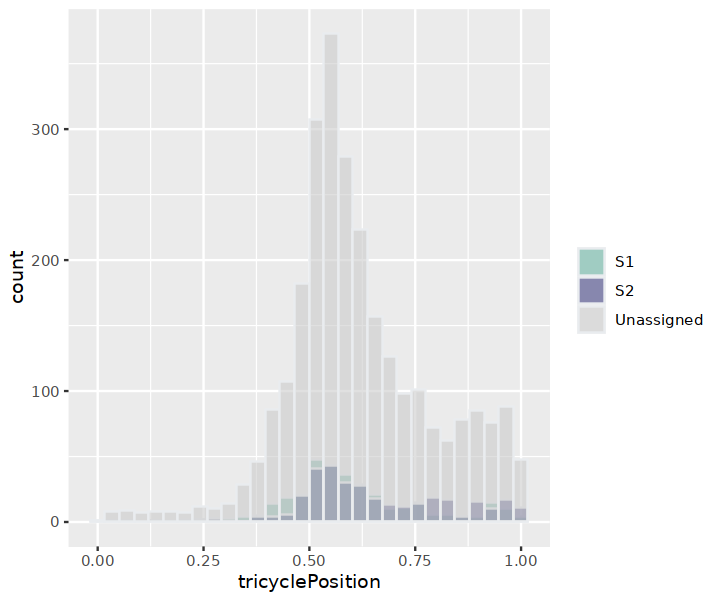

In [1002]:
dat %>%
  ggplot( aes(x=tricyclePosition, fill=anno)) +
    geom_histogram( color="#e9ecef", alpha=0.6, position = 'identity') +
    scale_fill_manual(values=c("#69b3a2", "#404080","#cccccc")) +
    #theme_ipsum() +
    labs(fill="")

In [1003]:
table(dat$anno)


        S1         S2 Unassigned 
       338        338       2707 

In [1004]:
rc.re <- CreateSeuratObject(rc.sub@assays$SCT@data)
rc.re$upper_lower_anno <- dat$anno
rc.re <- subset(rc.re, cells=colnames(rc.re)[rc.re$upper_lower_anno !="Unassigned"])
Idents(rc.re) <- rc.re$upper_lower_anno

In [1005]:
Clust_Markers <- FindAllMarkers(rc.re, only.pos = TRUE)

Calculating cluster S2

Calculating cluster S1



In [1006]:
Clust_Markers <- Clust_Markers %>% filter(p_val <0.01) %>% arrange(p_val_adj)

In [1007]:
head(Clust_Markers)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
AT5G43060,3.494565e-42,1.0028597,0.973,0.757,9.106139e-38,S1,AT5G43060
AT3G02230,4.103745e-42,0.9602121,0.997,0.959,1.069354e-37,S1,AT3G02230
AT1G78040,3.697934e-41,0.7472752,1.000,0.997,9.636077e-37,S1,AT1G78040
AT1G03870,4.123349e-39,1.1931687,0.932,0.710,1.074462e-34,S1,AT1G03870
AT5G39570,6.668983e-39,0.8528527,0.991,0.959,1.737804e-34,S1,AT5G39570
AT3G28740,1.726224e-38,1.4410166,0.905,0.660,4.498195e-34,S1,AT3G28740


In [1008]:
write.csv(Clust_Markers, "./tradeseq/Atrichoblast_G1_upper_and_lower_cells_DE_20240503.csv")

## Upper and Lower cells GO 

In [1034]:
## Prepare gene module list
module_sel <- select(Clust_Markers, gene, cluster)
module_list <- split(module_sel, f=module_sel$cluster)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="gene"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$gene)))

In [1035]:
cluster_GO <- gost(module_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]]

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(5, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name

Joining with `by = join_by(term_id)`


In [1038]:
write.csv(cluster_GO_sig[,-14], "./tradeseq/Atichoblast_G1_Upper_Lower_cells_GO_20240503.csv")

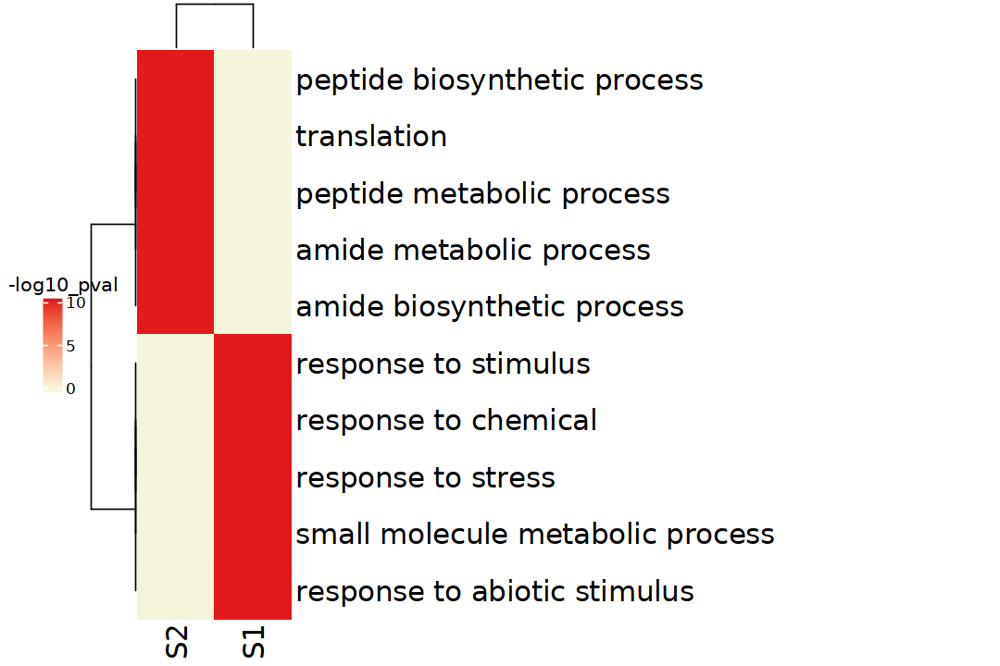

In [1036]:
options(repr.plot.width = 9, repr.plot.height = 6)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous",title_gp = grid::gpar(fontsize = 12)), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE, 
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 18)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(1, 10, 1, 100), "mm"), heatmap_legend_side = "left")

## Coexpression Analysis

In [436]:
tsct <- t(as.matrix(rc.g1@assays$SCT@data))

In [443]:
coexp_sct <- function(gene){
rna <- tsct[,gene]
res <- c()
for (i in 1:ncol(tsct)){
   res <- c(res,cor(rna,tsct[,i], method="spearman"))
}
return(res)
}

In [444]:
DWF4_sct <- suppressWarnings(coexp_sct("AT3G50660"))

In [445]:
## List top 10 co-expressed genes in SCT assay
colnames(tsct)[match(rev(sort(DWF4_sct))[2:11], DWF4_sct)]
DWF4_sct[match(rev(sort(DWF4_sct))[2:11], DWF4_sct)]

[1] "AT4G12880" "AT2G33790" "AT1G13590" "AT4G30650" "AT3G28910" "AT5G66080"
 [7] "AT1G70490" "AT1G05530" "AT3G14940" "AT3G07470"

[1] 0.1357668 0.1337563 0.1281156 0.1258358 0.1254528 0.1245018 0.1233761
 [8] 0.1223189 0.1221170 0.1213382

In [446]:
cp <- data.frame(GeneID=colnames(tsct)[match(rev(sort(DWF4_sct))[2:nrow(rc.g1)], DWF4_sct)], CorCoeff=DWF4_sct[match(rev(sort(DWF4_sct))[2:nrow(rc.g1)], DWF4_sct)]) 

In [447]:
head(cp)

,GeneID,CorCoeff
,<chr>,<dbl>
1,AT4G12880,0.1357668
2,AT2G33790,0.1337563
3,AT1G13590,0.1281156
4,AT4G30650,0.1258358
5,AT3G28910,0.1254528
6,AT5G66080,0.1245018


In [448]:
write.csv(cp, "./tradeseq/Atrichoblast_G1_DWF4_expressed_cells_CoExpressedGenes.csv")

### Gene expression

In [1012]:
rc.sub <- subset(rc.sub,cells=dat$cell_id)

In [1013]:
head(dat)

,cell_id,tricyclePosition,Signature1,Signature2,diff,Signature1_scaled,Signature2_scaled,ratio,anno,inianno
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
AAACCTGAGCGCCTCA_1,AAACCTGAGCGCCTCA_1,0.4515482,-0.42783066,-0.1528441,0.27498657,0.1783079,0,Inf,S2,S2
AACCGCGCATAACCTG_1,AACCGCGCATAACCTG_1,0.5226149,-0.07519829,-0.1528441,0.07764579,0.3718996,0,Inf,Unassigned,S1
AACTCAGCACCAACCG_1,AACTCAGCACCAACCG_1,0.5550358,0.41416630,-0.1528441,0.56701038,0.6405559,0,Inf,Unassigned,S1
AACTCCCAGAGTGAGA_1,AACTCCCAGAGTGAGA_1,0.5670711,0.30187488,-0.1528441,0.45471896,0.5789090,0,Inf,Unassigned,S1
AACTGGTCACGTTGGC_1,AACTGGTCACGTTGGC_1,0.6099921,0.01974415,-0.1528441,0.17258824,0.4240221,0,Inf,Unassigned,S1
AAGCCGCAGATATACG_1,AAGCCGCAGATATACG_1,0.5084395,-0.08788067,-0.1528441,0.06496341,0.3649371,0,Inf,Unassigned,S1


In [1014]:
rc.sub$anno <- dat$anno

In [1015]:
rc.sub

An object of class Seurat 
74352 features across 3383 samples within 3 assays 
Active assay: SCT (26058 features, 0 variable features)
 2 other assays present: RNA, integrated
 3 dimensional reductions calculated: pca, umap, umap_2D

[1] 2.073171

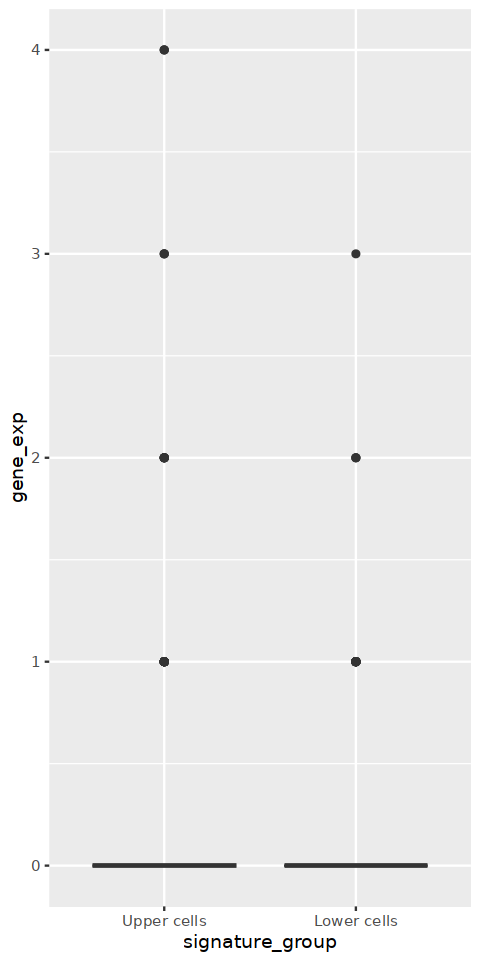

In [1016]:
# BAS1 catabolic gene
geneid <- 'AT2G26710'
## Percentage expressed
length(which(rc.integrated$RNA@data[geneid,]>0))/410
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

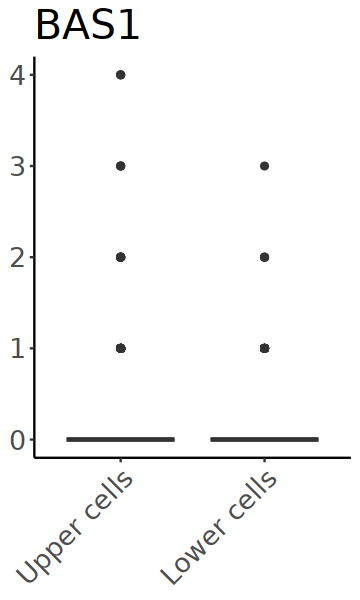

In [1017]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.2)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("BAS1")

In [1018]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_BAS1_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.2)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("BAS1"))
dev.off()

png 
  2

[1] 10.46585

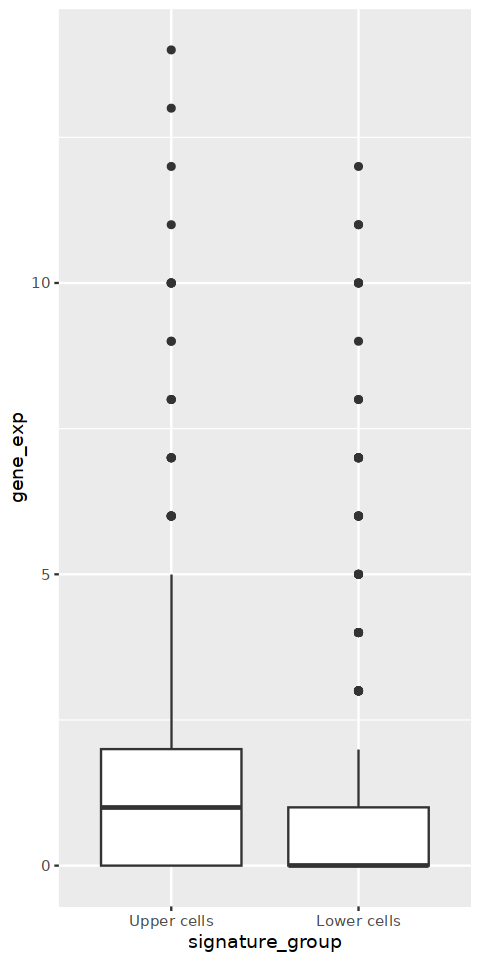

In [1019]:
# CSI1
geneid <- 'AT2G22125'
## Percentage expressed
length(which(rc.integrated$RNA@data[geneid,]>0))/410
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

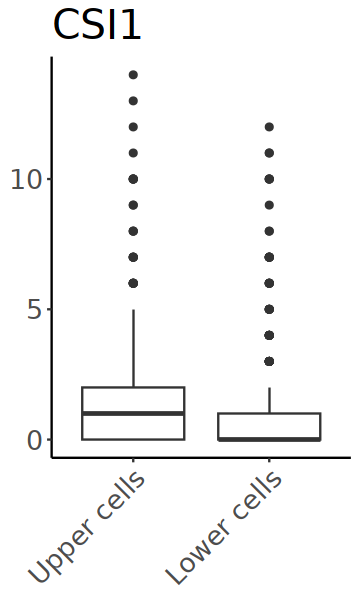

In [1020]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.1)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CSI1")

In [1021]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_CSI1_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#              stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CSI1"))
dev.off()

png 
  2

[1] 14.36098

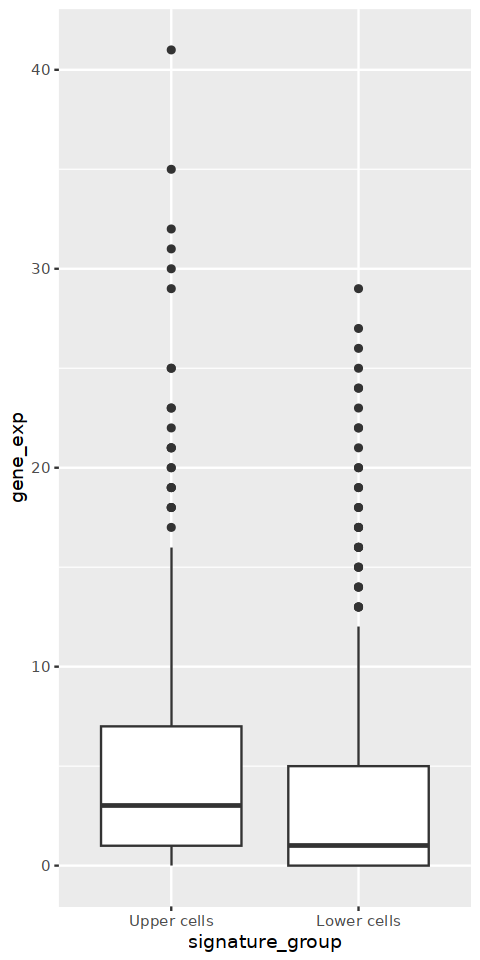

In [1022]:
# CESA6
geneid <- 'AT5G64740'
## Percentage expressed
length(which(rc.integrated$RNA@data[geneid,]>0))/410
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

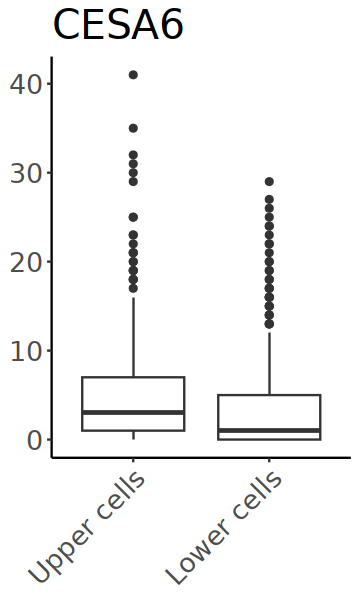

In [1023]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.2)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CESA6")

In [1024]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_CESA6_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CESA6"))
dev.off()

png 
  2

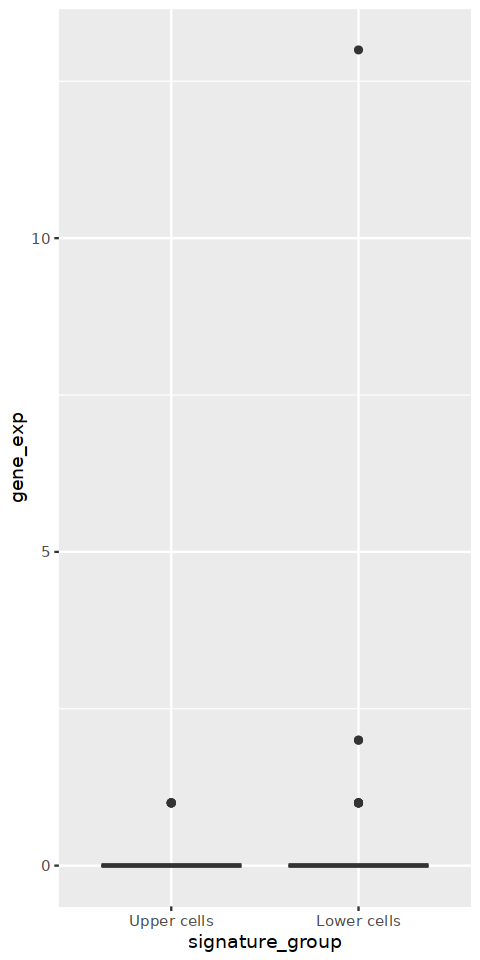

In [1025]:
#CPD(AT5G05690)
geneid <- 'AT5G05690'
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

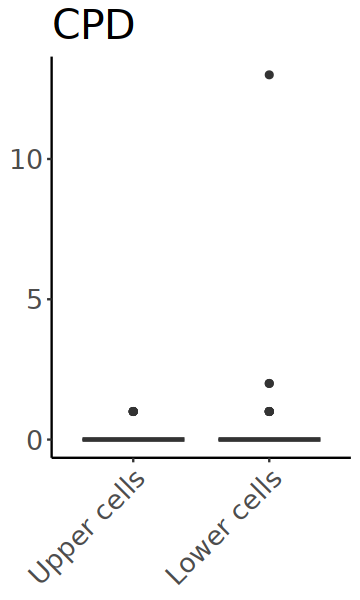

In [1026]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.1)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CPD")

In [1027]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_CPD_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("CPD"))
dev.off()

png 
  2

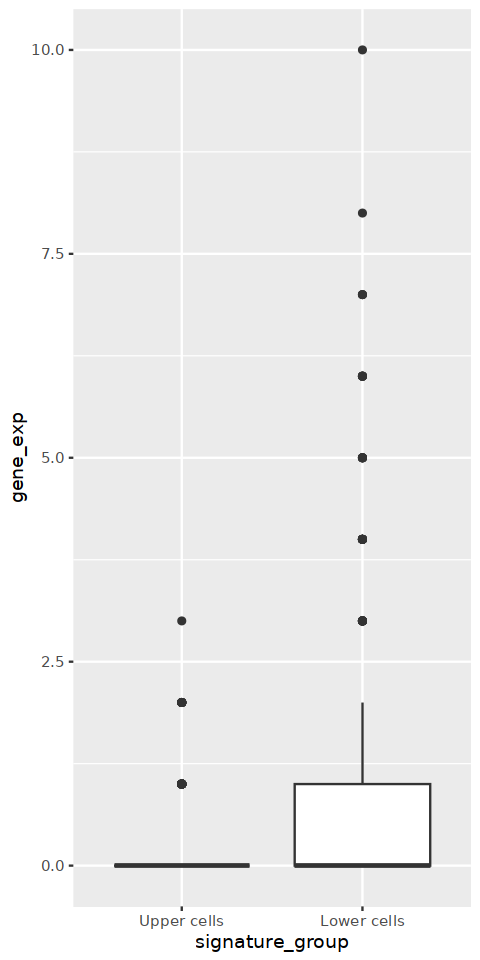

In [1028]:
#DWF(AT3G50660)
geneid <- 'AT3G50660'
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

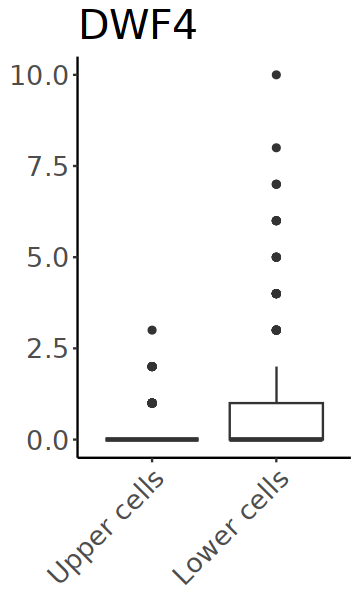

In [1029]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("DWF4")

In [1030]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_DWF4_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("DWF4"))
dev.off()

png 
  2

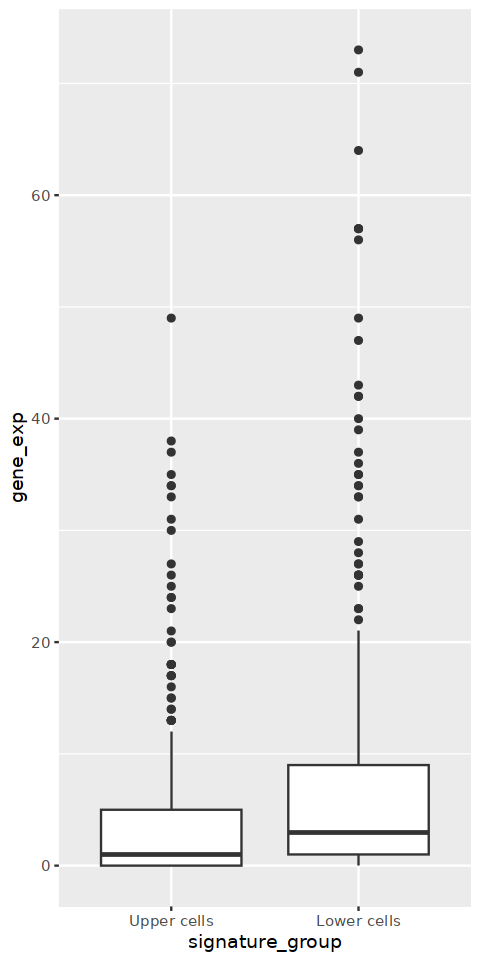

In [1031]:
#PHB3 AT5G40770
geneid <- 'AT5G40770'
toplt <- data.frame(gene_exp = c(rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$RNA@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))

toplt$signature_group <- factor(toplt$signature_group, levels= c("Upper cells", "Lower cells"))

# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

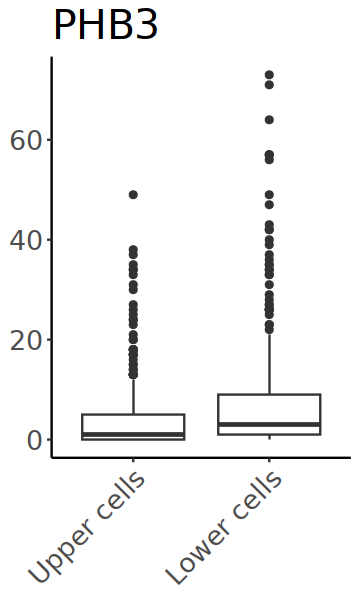

In [1032]:
options(repr.plot.width=3, repr.plot.height=5)
# Change dotsize and stack ratio
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("PHB3")

In [1033]:
grDevices::cairo_pdf("./pdfs/Atrichoblast_G1_Upper_Lower_cells_PHB3_Exp.pdf",width=3, height=4)
print(ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
geom_boxplot()+theme_classic()+  
#geom_dotplot(binaxis='y', stackdir='center',
#               stackratio=1, dotsize=0.8)+
    theme(text = element_text(size=20),
        axis.text.x = element_text(angle=45, hjust=1), axis.title.x = element_blank(),
          axis.title.y = element_blank()) + ggtitle("PHB3"))
dev.off()

png 
  2

[1] 0.2616143

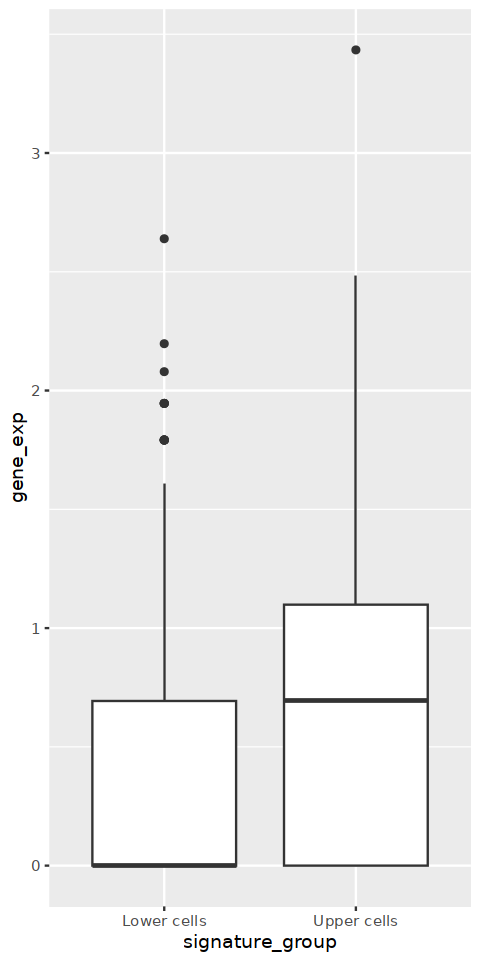

In [609]:
# SOB7 catabolic gene
geneid <- 'AT1G17060'
## Percentage expressed
length(which(rc.integrated$SCT@data[geneid,]>0))/length(rc.integrated$SCT@data[geneid,])
toplt <- data.frame(gene_exp = c(rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))
# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

[1] 0.6020949

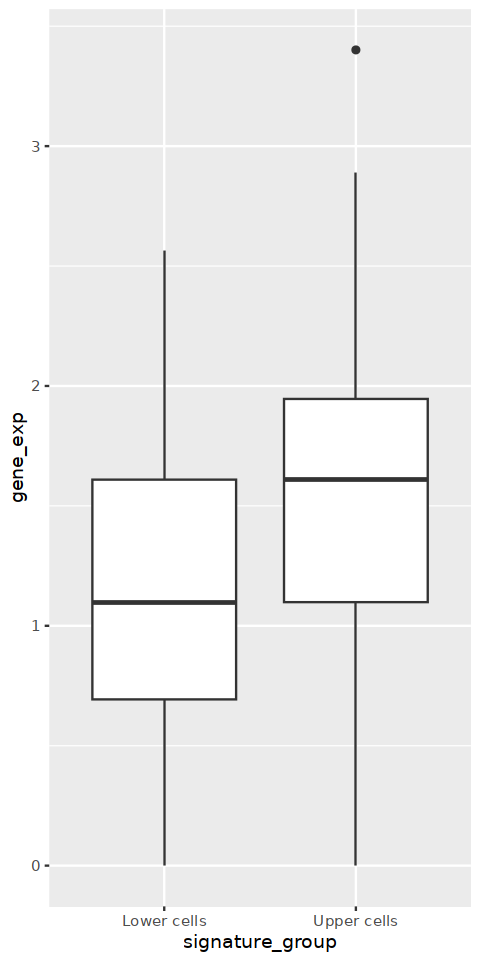

In [610]:
# BEN1 catabolic gene
geneid <- 'AT2G45400'
## Percentage expressed
length(which(rc.integrated$SCT@data[geneid,]>0))/length(rc.integrated$SCT@data[geneid,])
toplt <- data.frame(gene_exp = c(rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))
# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

[1] 0.02181146

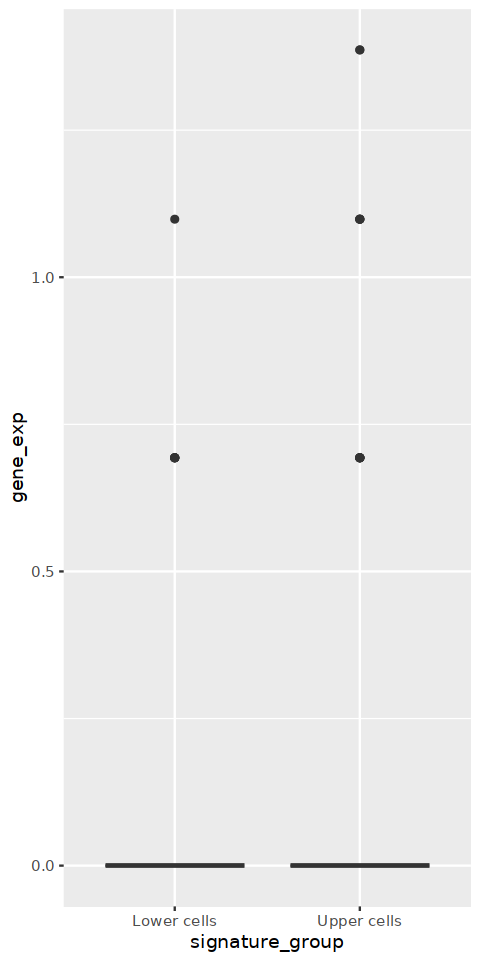

In [612]:
# CPD 
geneid <- 'AT5G05690'
## Percentage expressed
length(which(rc.integrated$SCT@data[geneid,]>0))/length(rc.integrated$SCT@data[geneid,])
toplt <- data.frame(gene_exp = c(rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S1")],rc.sub@assays$SCT@data[geneid,which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("Upper cells", length(which(rc.sub$anno=="S1"))), rep("Lower cells", length(which(rc.sub$anno=="S2")))))
# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

In [613]:
toplt <- data.frame(gene_exp = c(rc.sub@assays$SCT@data["AT3G50660",which(rc.sub$anno=="S1")],rc.sub@assays$SCT@data["AT3G50660",which(rc.sub$anno=="S2")]),
                   signature_group = c(rep("S1", length(which(rc.sub$anno=="S1"))), rep("S2", length(which(rc.sub$anno=="S2")))))


In [614]:
summary(toplt$gene_exp)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
0.00000 0.00000 0.00000 0.08786 0.00000 1.38629 

In [615]:
summary(toplt$gene_exp[which(toplt$gene_exp>0)])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
 0.6931  0.6931  0.6931  0.7611  0.6931  1.3863 

In [616]:
table(toplt$gene_exp[which(toplt$gene_exp>0)])


0.693147180559945  1.09861228866811  1.38629436111989 
              146                22                 4 

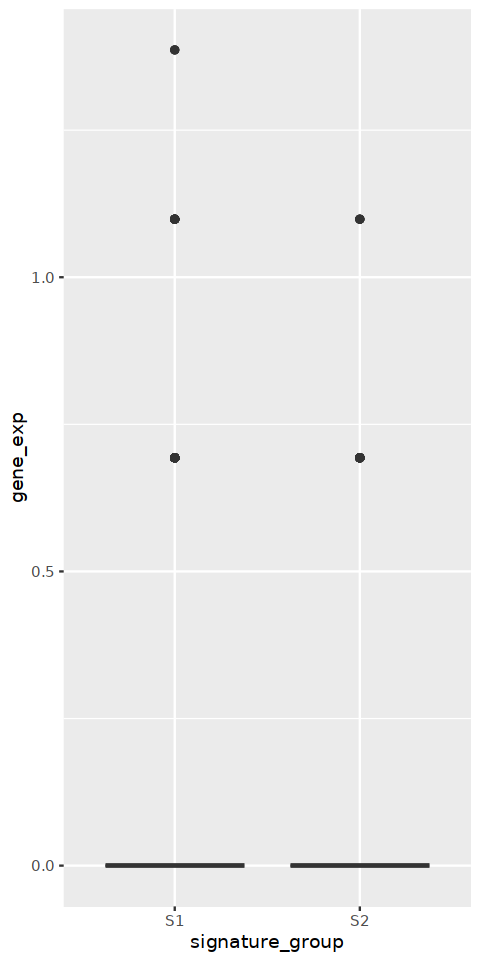

In [617]:
# Overlaid histograms
options(repr.plot.width=4, repr.plot.height=8)
ggplot(toplt, aes(x=signature_group, y=gene_exp)) + 
  geom_boxplot()

### Cell Cycle Phase Markers

In [624]:
## Prepare gene module list
module_sel <- select(module_df, gene_id, module)
module_list <- split(module_sel, f=module_sel$module)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="gene_id"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$gene_id)))

In [625]:
module_list <- module_list[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7")]

In [626]:
CCm <- read.csv("./tricycle/tricycle_markers_CC_Proliferation_domain_only_FindMarkers_18S_WT_cell_cycle_seu4_245_genes_Goldy_Zhang_AMIGO_20230911_cwh.csv", row.names=1)

In [627]:
head(CCm)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,Name,Laura_CC_phase,Zhang_2021_CC_phase,BES1_BZR1_target,Ref_245_gene,marker,Che_Wei_Picks
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<lgl>,<lgl>,<chr>,<chr>
13,0.00e+00,0.9648551,0.362,0.205,0.00e+00,G1/G0,AT5G06860,PGIP1,NA,NA,FALSE,FALSE,,G1
85,0.00e+00,0.6023157,0.553,0.387,0.00e+00,G1/G0,AT5G10695,AT5G10695,NA,NA,FALSE,FALSE,,G1
96,0.00e+00,0.5690786,0.298,0.156,0.00e+00,G1/G0,AT1G17860,KTI2,NA,NA,FALSE,FALSE,,G1
342,1.42e-267,0.5664160,0.188,0.086,3.71e-263,G1/G0,AT1G05560,UGT1,NA,NA,FALSE,FALSE,,G1
288,8.19e-297,0.5080337,0.241,0.124,2.13e-292,G1/G0,AT3G12510,AT3G12510,NA,NA,FALSE,FALSE,,G1
399,1.62e-236,0.3748879,0.185,0.089,4.23e-232,G1/G0,AT2G22880,AT2G22880,NA,NA,FALSE,FALSE,,G1


In [628]:
nrow(CCm)

[1] 2985

In [629]:
## Prepare cc marker list
CCm$cluster <- factor(CCm$cluster, levels = c("G1/G0", "S", "G2M"))
marker_sel <- select(CCm, gene, cluster)
marker_list <- split(marker_sel, f=marker_sel$cluster)
#this makes list from long df of gene lists - TARGET is what we want to keep
marker_list  <- lapply(marker_list, function(x) x[names(x)=="gene"])
# convert each sublist into character and eliminate duplicates
marker_list  <- lapply(marker_list, function(x) as.character(unique(x$gene)))

In [630]:
## GeneOverlap 

# number of integrated features

genome_size <- 26058L

#compare all lists
gom.self <- newGOM(module_list, marker_list, genome.size=genome_size)

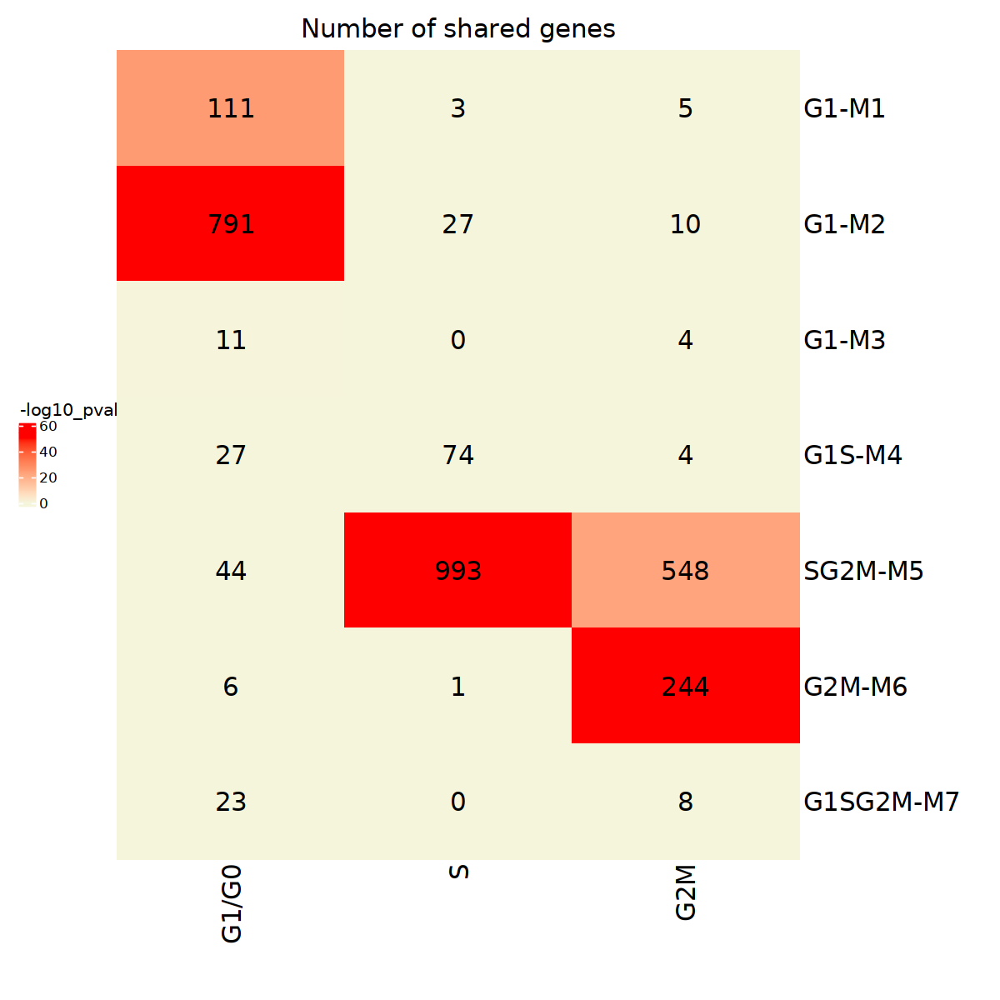

In [631]:
options(repr.plot.width = 10, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)
#p.val_log <- p.val_log[c("G1-M1", "G1-M2", "G1-M3", "G1S-M4", "SG2M-M5", "G2M-M6", "G1SG2M-M7"),]

olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 50), 
                                 c("beige", "red")), 
                column_title = "Number of shared genes", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE, 
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")
     

In [632]:
## GeneOverlap 

# number of integrated features

genome_size <- 26058L

#compare all lists
gom.self <- newGOM(g_list, marker_list, genome.size=genome_size)

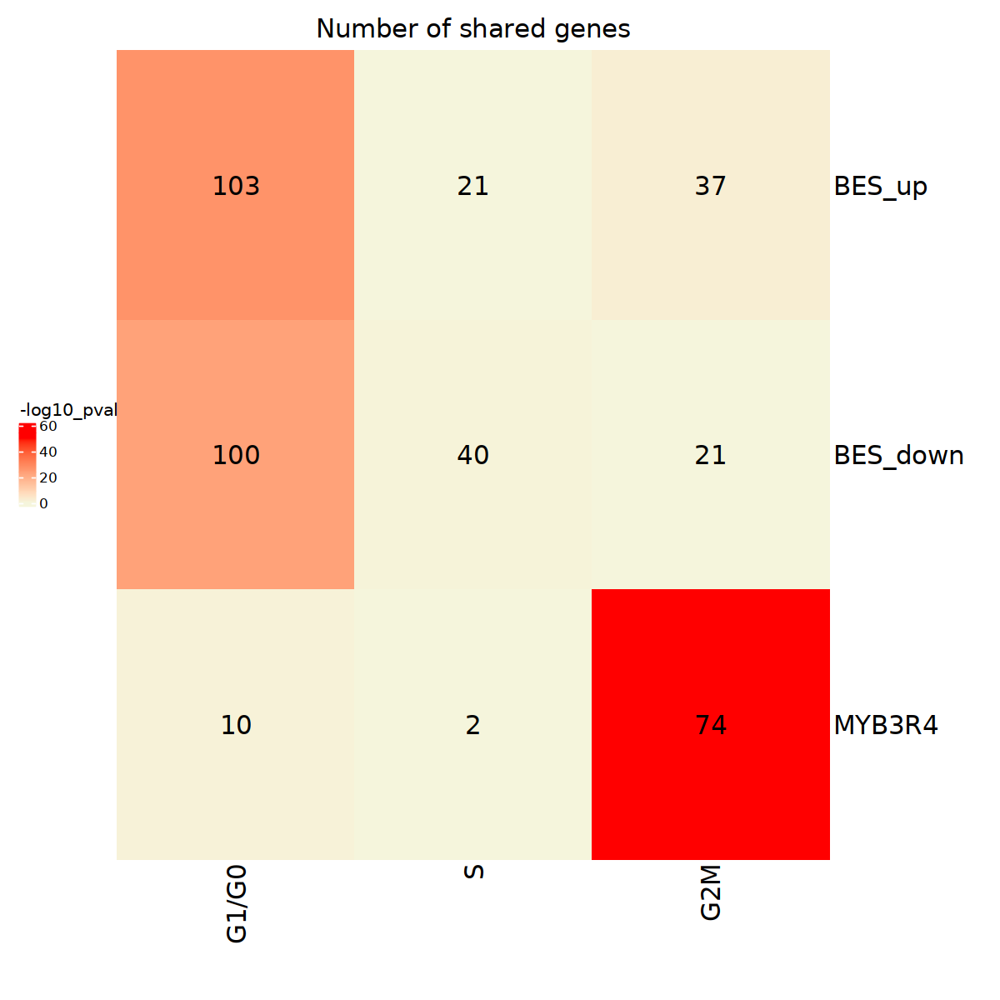

In [633]:
options(repr.plot.width = 10, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)


olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 50), 
                                 c("beige", "red")), 
                column_title = "Number of shared genes", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE,
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")
     

## CC Marker list GO

In [634]:
cluster_GO <- gost(marker_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]]

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(10, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name


Joining with `by = join_by(term_id)`


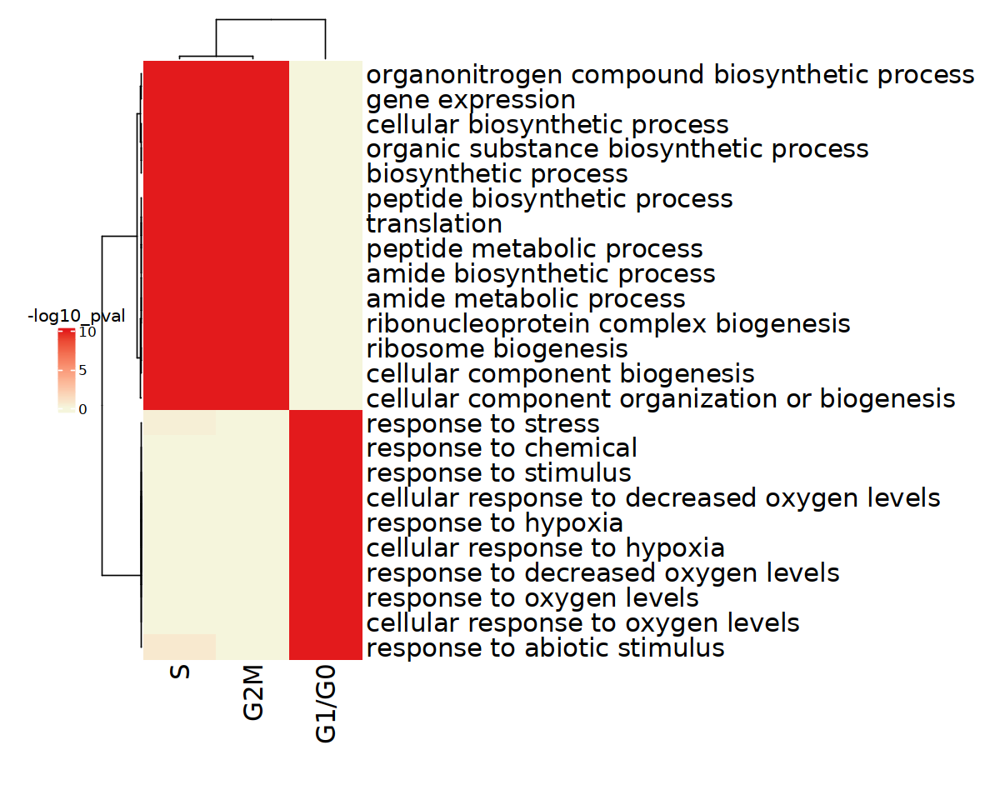

In [637]:
options(repr.plot.width = 10, repr.plot.height = 8)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous", title_gp = grid::gpar(fontsize = 12)), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE,
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 18)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 100), "mm"), heatmap_legend_side = "left")

## BES MYB3R4 gene list GO

In [638]:
cluster_GO <- gost(g_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]]

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(10, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name


Joining with `by = join_by(term_id)`


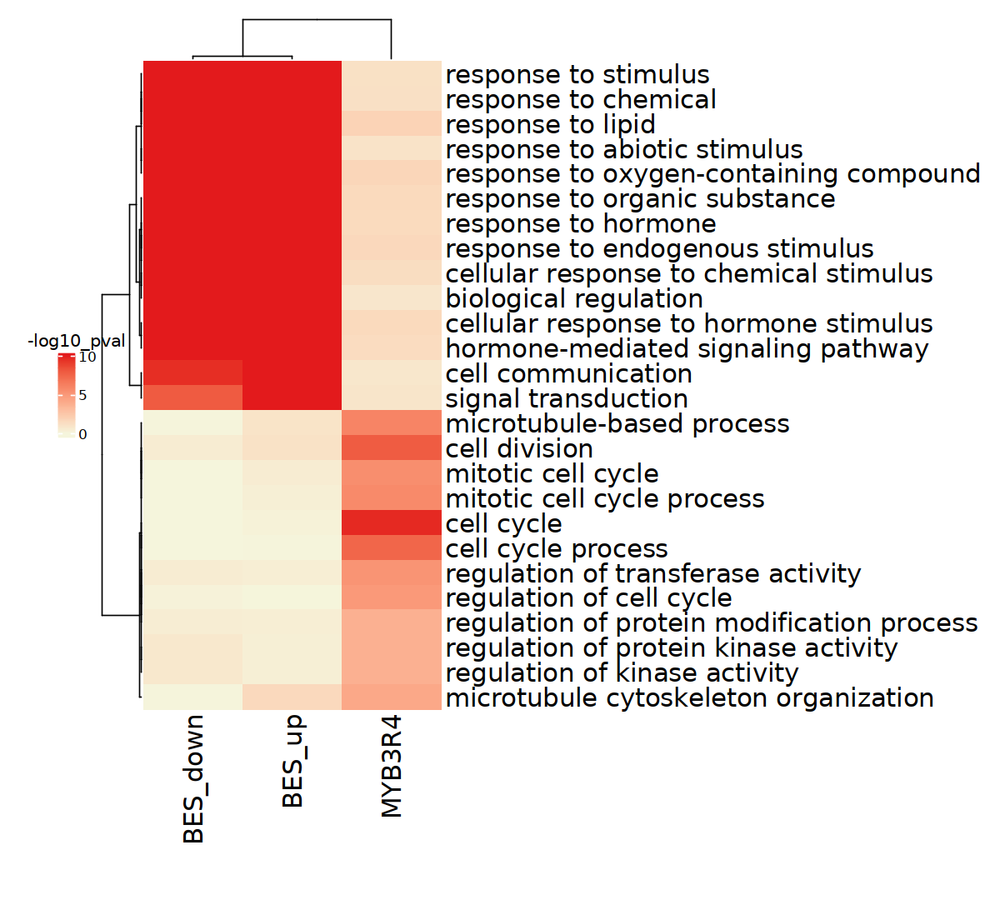

In [640]:
options(repr.plot.width = 10, repr.plot.height = 9)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous",  title_gp = grid::gpar(fontsize = 12)), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE, 
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 18)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 80), "mm"), heatmap_legend_side = "left")

## Module gene list GO

In [641]:
cluster_GO <- gost(module_list[-11], organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]]

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(5, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name


Joining with `by = join_by(term_id)`


In [642]:
head(spread_GO_m)

,G1-M1,G1-M2,G1-M3,G1S-M4,G1SG2M-M7,G2M-M6,SG2M-M5
mitotic cell cycle,0.23010758,0.00000000,0.000000000,0.00000000,0.0000000,22.45507039,4.213885
nucleobase-containing compound metabolic process,0.00000000,0.00000000,0.008609301,0.00000000,0.0000000,0.00000000,145.851685
protein phosphorylation,0.03131254,0.04966592,0.344072326,0.08386497,3.5866404,2.61927257,1.889957
cellular aromatic compound metabolic process,0.00000000,0.00000000,0.008188573,0.00000000,0.0000000,0.01909333,138.997506
transport,0.26505011,37.32700059,0.136611852,6.90869029,0.5101195,0.13418162,0.000000
water transport,5.47170675,0.57879745,0.000000000,0.00000000,0.2243011,0.87594373,0.000000


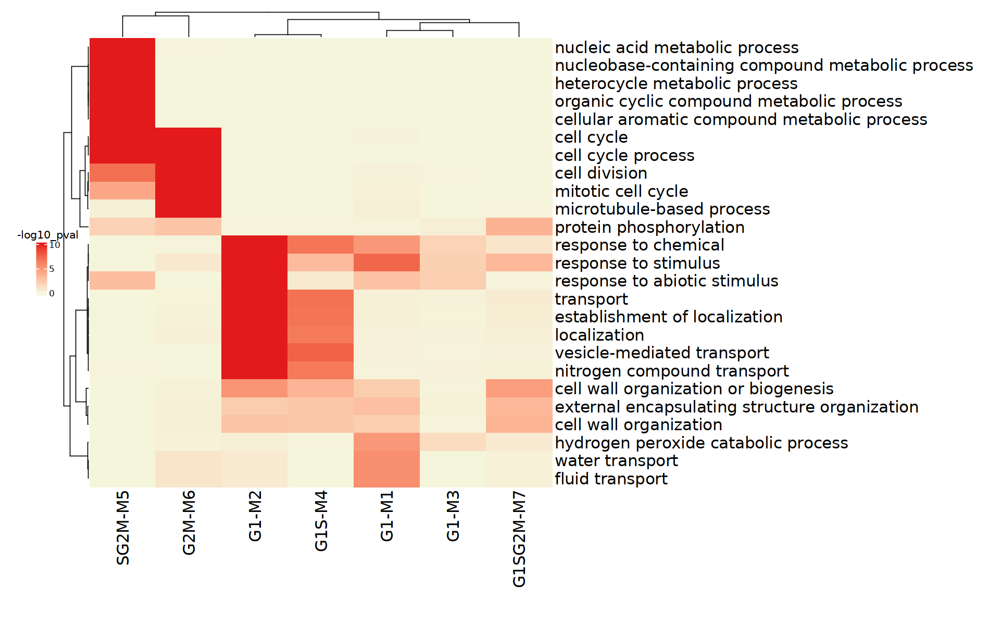

In [645]:
options(repr.plot.width = 16, repr.plot.height = 10)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous",title_gp = grid::gpar(fontsize = 12)), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE,
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 18)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 120), "mm"), heatmap_legend_side = "left")

In [646]:
length(marker_list$`G1/G0`)
length(marker_list$`S`)
length(marker_list$`G2M`)

[1] 1029

[1] 1130

[1] 826

In [647]:
length(intersect(unlist(marker_list),unlist(g_list)))

[1] 370

## Tradeseq heatmaps

In [648]:
writeLines(s1,"./tradeseq/BES1up_G1_M2_genelist.txt")
writeLines(s2,"./tradeseq/BES1down_G1_M2_genelist.txt")

In [15]:
s1 <- readLines("./tradeseq/BES1up_G1_M2_genelist.txt")
s2 <- readLines("./tradeseq/BES1down_G1_M2_genelist.txt")

### opsopl2

In [61]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("WT-G1",25),rep("WT-S",14),rep("WT-G2M",11),rep("opsopl2-G1",25),rep("opsopl2-S",14),rep("opsopl2-G2M",11))
LEVEL <- c("WT-G1","WT-S","WT-G2M","opsopl2-G1","opsopl2-S","opsopl2-G2M")

In [62]:
opsopl2 <- read.csv("./tradeseq/BES1_BZR_tricycle_opsopl2_Atrichoblast.csv", row.names=1)

In [63]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                      annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(opsopl2[s1[match(rownames(opsopl2),s1)[!is.na(match(rownames(opsopl2),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


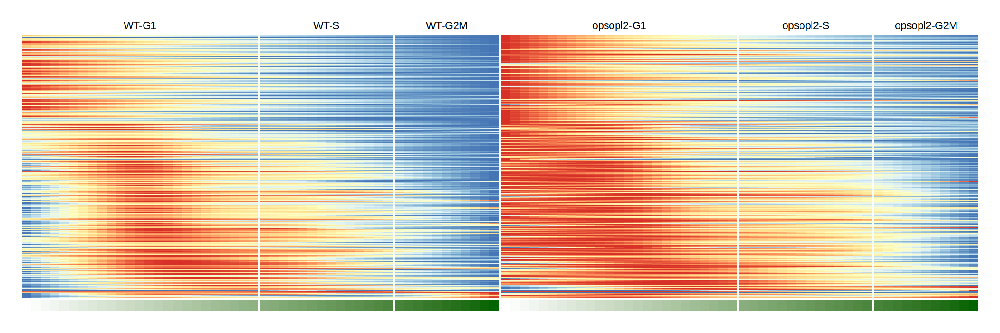

In [64]:
options(repr.plot.width=18, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

### pWERTSKO

In [65]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("WT-G1",25),rep("WT-S",14),rep("WT-G2M",11),rep("pWER-TSKO-G1",25),rep("pWER-TSKO-S",14),rep("pWER-TSKO-G2M",11))
LEVEL <- c("WT-G1","WT-S","WT-G2M","pWER-TSKO-G1","pWER-TSKO-S","pWER-TSKO-G2M")

In [66]:
pWER <- read.csv("./tradeseq/BES1_BZR_tricycle_pWERTSKO_Atrichoblast.csv", row.names=1)

In [67]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                      annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(pWER[s1[match(rownames(pWER),s1)[!is.na(match(rownames(pWER),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


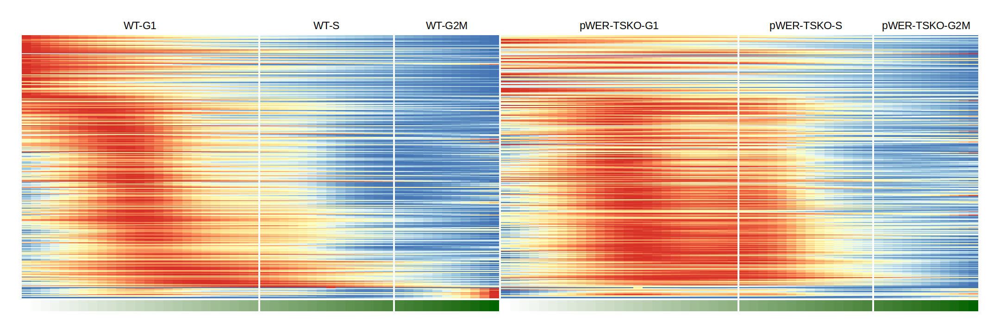

In [68]:
options(repr.plot.width=18, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

## hat7

In [69]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("WT-G1",25),rep("WT-S",14),rep("WT-G2M",11),rep("hat7-G1",25),rep("hat7-S",14),rep("hat7-G2M",11))
LEVEL <- c("WT-G1","WT-S","WT-G2M","hat7-G1","hat7-S","hat7-G2M")

In [70]:
hat7 <- read.csv("./tradeseq/BES1_BZR_tricycle_hat7_Atrichoblast.csv", row.names=1)

In [71]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                      annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(hat7[s1[match(rownames(hat7),s1)[!is.na(match(rownames(hat7),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


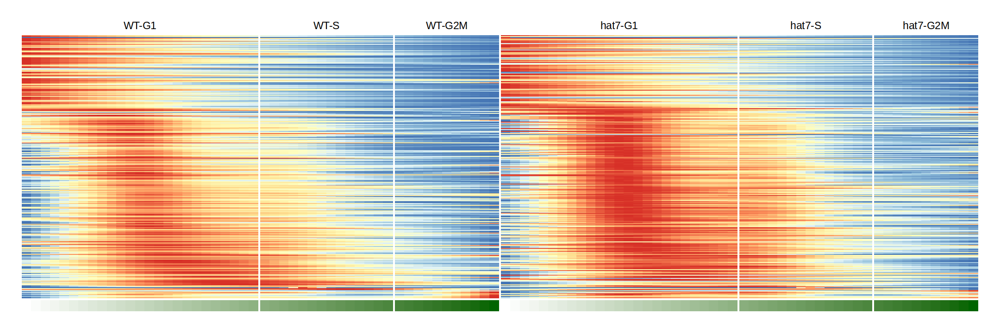

In [72]:
options(repr.plot.width=18, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

## bri1-T (WT samples sc_130 and sc_134 have issues, not enough proliferation domain cells)

In [73]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("WT-G1",25),rep("WT-S",14),rep("WT-G2M",11),rep("bri1-T-G1",25),rep("bri1-T-S",14),rep("bri1-T-G2M",11))
LEVEL <- c("WT-G1","WT-S","WT-G2M","bri1-T-G1","bri1-T-S","bri1-T-G2M")

In [74]:
bri1T <- read.csv("./tradeseq/BES1_BZR_tricycle_bri1-T_Atrichoblast.csv", row.names=1)

In [75]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                      annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(bri1T[s1[match(rownames(bri1T),s1)[!is.na(match(rownames(bri1T),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


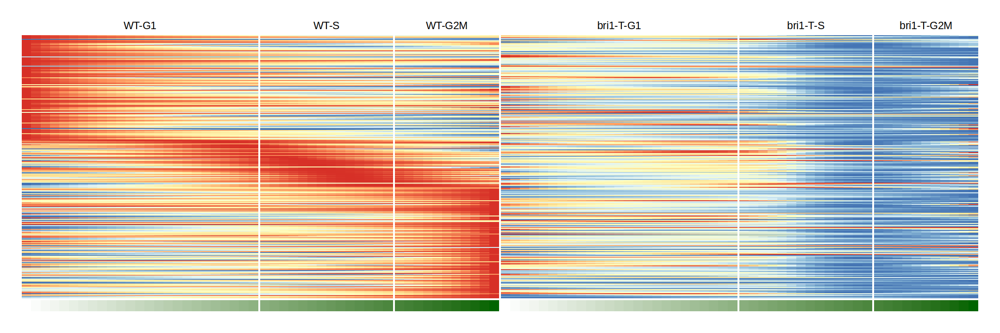

In [76]:
options(repr.plot.width=18, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

## BRZ

In [77]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("WT-G1",25),rep("WT-S",14),rep("WT-G2M",11),rep("BRZ-G1",25),rep("BRZ-S",14),rep("BRZ-G2M",11))
LEVEL <- c("WT-G1","WT-S","WT-G2M","BRZ-G1","BRZ-S","BRZ-G2M")

In [78]:
BRZ <- read.csv("./tradeseq/BES1_BZR_tricycle_BRZ_Atrichoblast.csv", row.names=1)

In [79]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                      annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(BRZ[s1[match(rownames(BRZ),s1)[!is.na(match(rownames(BRZ),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


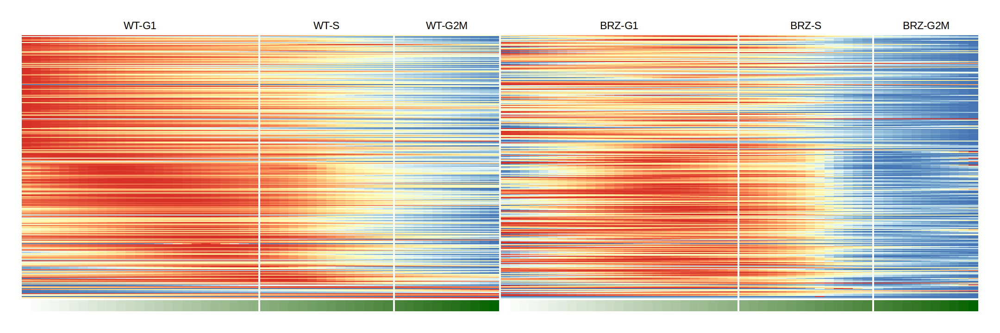

In [80]:
options(repr.plot.width=18, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

## BR time course

In [46]:
## Tricycle Cell Cycle Phase
FACT <- c(rep("BRZ_0-G1",25),rep("BRZ_0-S",14),rep("BRZ_0-G2M",11),rep("BL_0.5-G1",25),rep("BL_0.5-S",14),rep("BL_0.5-G2M",11)
         ,rep("BL_1-G1",25),rep("BL_1-S",14),rep("BL_1-G2M",11),rep("BL_2-G1",25),rep("BL_2-S",14),rep("BL_2-G2M",11)
         ,rep("BL_4-G1",25),rep("BL_4-S",14),rep("BL_4-G2M",11),rep("BL_8-G1",25),rep("BL_8-S",14),rep("BL_8-G2M",11))
LEVEL <- c("BRZ_0-G1","BRZ_0-S","BRZ_0-G2M","BL_0.5-G1","BL_0.5-S","BL_0.5-G2M","BL_1-G1","BL_1-S","BL_1-G2M","BL_2-G1","BL_2-S","BL_2-G2M"
          ,"BL_4-G1","BL_4-S","BL_4-G2M","BL_8-G1","BL_8-S","BL_8-G2M")

In [47]:
BR <- read.csv("./tradeseq/BES1_BZR_tricycle_BR_time_course_Atrichoblast.csv", row.names=1)

In [50]:
col_fun = colorRamp2(c(0.02,1), c("white","darkgreen"))

    ha = HeatmapAnnotation(Pseudotime=c(seq(0.02,1,by=1/50),seq(0.02,1,by=1/50),seq(0.02,1,by=1/50),seq(0.02,1,by=1/50),seq(0.02,1,by=1/50),seq(0.02,1,by=1/50)), col = list(Pseudotime = col_fun), show_annotation_name = F,show_legend = F,
                          annotation_legend_param = list(title_position="topcenter", title = "cell cyle progression", direction="horizontal", legend_width = unit(4, "cm")))

tseqH <- Heatmap(BR[s1[match(rownames(BR),s1)[!is.na(match(rownames(BR),s1))]],],column_split = factor(FACT, levels=LEVEL), 
        col = colorRampPalette(rev(brewer.pal(n = 7, name =
  "RdYlBu")))(100),
                show_column_names = F,
                cluster_columns = F,
                cluster_rows=F,
                show_row_names = F, 
                #right_annotation=mark_anno,
                show_heatmap_legend=F,
                use_raster=F,
              bottom_annotation=ha,
               heatmap_legend_param = list(title_position="topcenter", title = "Expression", direction="horizontal"))

Warning message:
“The input is a data frame-like object, convert it to a matrix.”


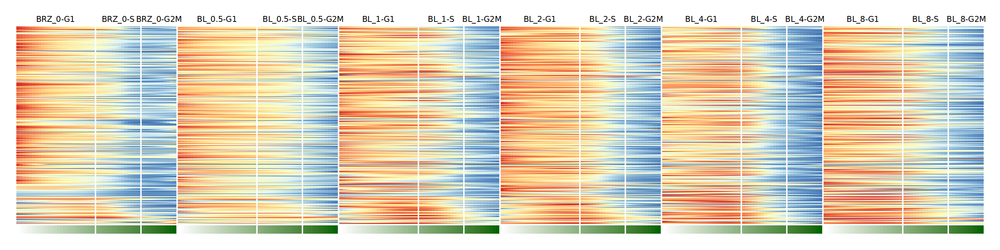

In [51]:
options(repr.plot.width=24, repr.plot.height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))

In [53]:
grDevices::cairo_pdf("./pdfs/TradeSeq_BR_timecourse_CC.pdf",width=24, height=6)
draw(tseqH, heatmap_legend_side = "right", legend_labels_gp = gpar(fontsize = 12, fontface = "plain"), padding = unit(c(1, 1, 1, 1), "cm"))
dev.off()

png 
  2

## Plot signature

In [39]:
rc.integrated <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_18S_WT_cell_cycle_seu4_all_genes_20230907.rds")

In [5]:
zscore <- function(x){(x-mean(x))/sd(x)}

In [41]:
##
Mito <- subset(rc.integrated, subset= ((endo_mito_anno %in% c("Mito"))))
Endo <- subset(rc.integrated, subset= ((endo_mito_anno %in% c("Endo"))))

In [53]:
pltsg <- function(cell_cycle_position1, signature1, name1, cell_cycle_position2, signature2, name2, title){
    fit.l <- fit_periodic_loess(cell_cycle_position1,
                            signature1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess(cell_cycle_position2,
                            signature2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit$treatment <- factor(c(rep(name1, 200) ,rep(name2, 200)), levels=c(name1, name2))
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed expression level", title = title) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

In [47]:
pltendo <- function(gene, title){
    s1z_Mito_Endo <- c(Mito@assays$SCT@data[which(rownames(Mito@assays$SCT@data) == gene),],Endo@assays$SCT@data[which(rownames(Endo@assays$SCT@data) == gene),])
    s1z_Mito <- s1z_Mito_Endo[1:ncol(Mito)]
    s1z_Endo <- s1z_Mito_Endo[(ncol(Mito)+1):length(s1z_Mito_Endo)]
    
    options(repr.plot.width=8, repr.plot.height=8)
    pltsg(Mito$tricyclePosition*pi, s1z_Mito, "Mitotic cycle", Endo$tricyclePosition*pi, s1z_Endo, "Endo cycle", title)
}

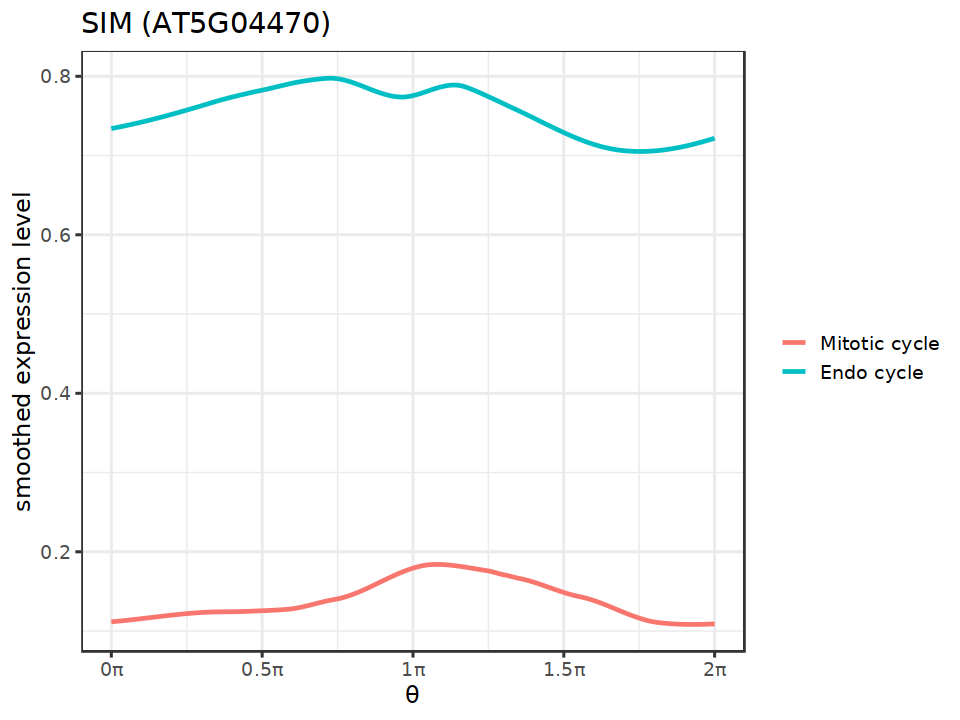

In [48]:
pltendo("AT5G04470", "SIM (AT5G04470)")

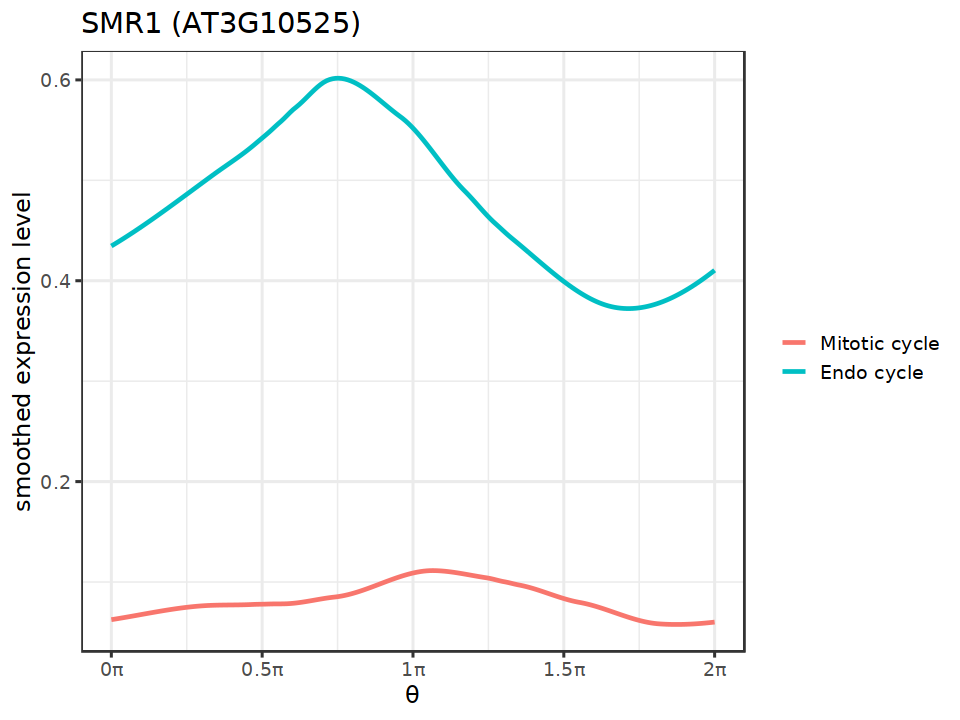

In [49]:
pltendo("AT3G10525", "SMR1 (AT3G10525)")

## Subset for atrichoblast

In [38]:
wanted_cols <- c("orig.ident", "celltype.anno.Li", "tricyclePosition","tricycleCCStage")
rc.integrated@meta.data <- rc.integrated@meta.data[,wanted_cols]
colnames(rc.integrated@meta.data) <- c("sample","cell_type", "tricyclePosition","tricycleCCStage")
rc.integrated <- subset(rc.integrated, cells=colnames(rc.integrated)[which(rc.integrated$cell_type=="Atrichoblast")])

In [147]:
zscore <- function(x){(x-mean(x))/sd(x)}
s1z <- as.numeric(apply(apply(as.matrix(rc.integrated@assays$SCT@data)[s1,], 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
s2z <- as.numeric(apply(apply(as.matrix(rc.integrated@assays$SCT@data)[s2,], 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”


In [148]:
length(s1z)

[1] 8115

In [49]:
plts <- function(cell_cycle_position1, signature1, name1, cell_cycle_position2, signature2, name2, title){
    fit.l <- fit_periodic_loess(cell_cycle_position1,
                            signature1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess(cell_cycle_position2,
                            signature2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit$treatment <- factor(c(rep(name1, 200) ,rep(name2, 200)), levels=c(name1, name2))
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene signature (z-score)", title = title) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
} 

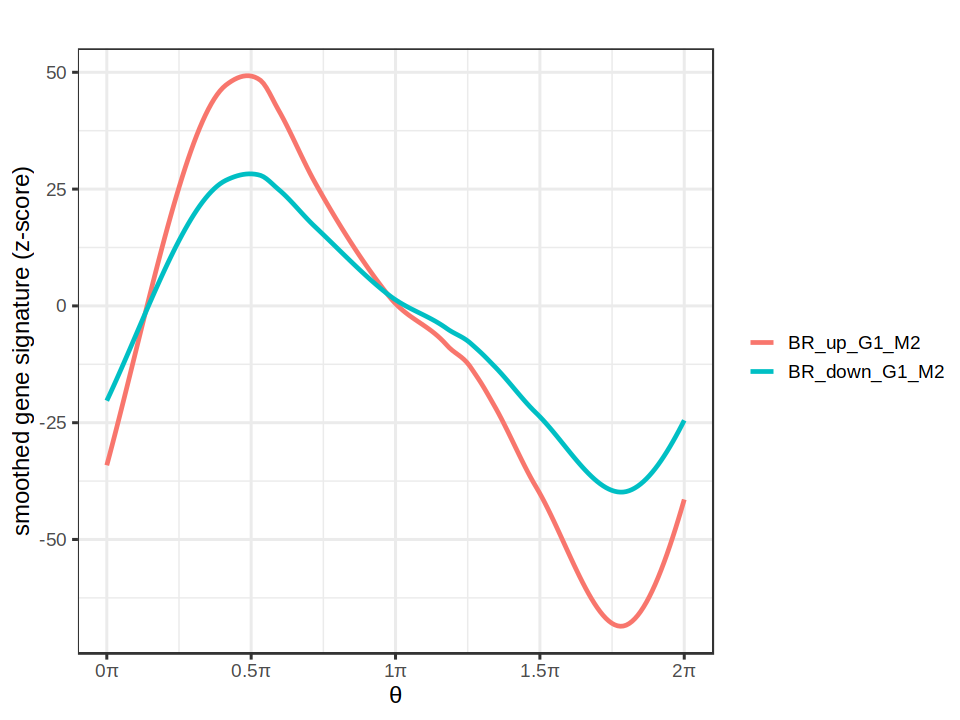

In [150]:
options(repr.plot.width=8, repr.plot.height=8)
plts(rc.integrated$tricyclePosition*pi, s1z, "BR_up_G1_M2", rc.integrated$tricyclePosition*pi, s2z, "BR_down_G1_M2", "")

## opsopl2

In [23]:
zscore <- function(x){(x-mean(x))/sd(x)}

In [24]:
opsopl2 <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_10S_opsopl_Li_seu4_20231016.rds")

In [25]:
opsopl2

An object of class Seurat 
74033 features across 107673 samples within 3 assays 
Active assay: integrated (17729 features, 17729 variable features)
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [26]:
table(opsopl2$orig.ident)


   dc1    dc2  sc_12 sc_186 sc_189 sc_191 sc_215 sc_217 sc_221 sc_223 
  3378   3283  10293  11748  11600  12232  12790  16234  16536   9579 

In [27]:
wanted_cols <- c("orig.ident","time.celltype.anno.Li.crude", "time.anno.Li.crude", "celltype.anno.Li.crude","time.celltype.anno.Li","tricyclePosition","tricycleCCStage")
opsopl2@meta.data <- opsopl2@meta.data[,wanted_cols]
colnames(opsopl2@meta.data) <- c("sample","time_zone_cell_type", "time_zone", "cell_type", "time_zone_cell_subtype", "tricyclePosition","tricycleCCStage")

In [28]:
## Only sc_215, sc_217, sc_221, sc_223 are involved
WT <- subset(opsopl2, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_215", "sc_221"))))
mutant <- subset(opsopl2, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_217", "sc_223"))))

In [29]:
WT

An object of class Seurat 
74033 features across 3470 samples within 3 assays 
Active assay: integrated (17729 features, 17729 variable features)
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [30]:
mutant

An object of class Seurat 
74033 features across 1789 samples within 3 assays 
Active assay: integrated (17729 features, 17729 variable features)
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [46]:
s1z_WT_opsopl2 <- as.numeric(apply(apply(cbind(as.matrix(WT@assays$SCT@data)[s1,],as.matrix(mutant@assays$SCT@data)[s1,]), 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))

In [47]:
s1z_WT <- s1z_WT_opsopl2[1:ncol(WT)]
s1z_opsopl2 <- s1z_WT_opsopl2[(ncol(WT)+1):length(s1z_WT_opsopl2)]

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


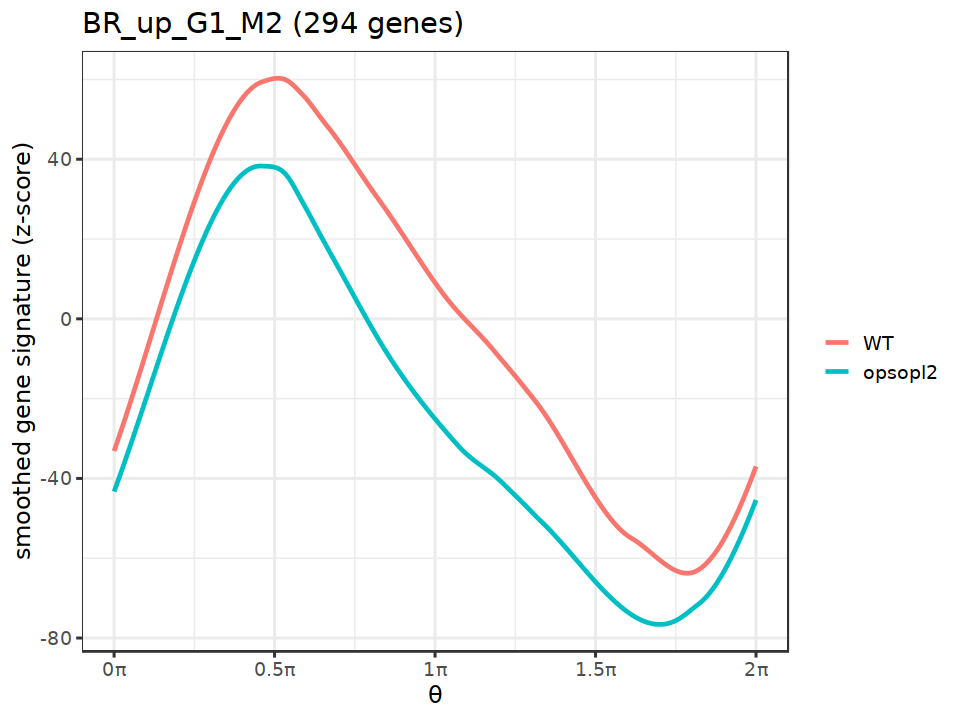

In [50]:
options(repr.plot.width=8, repr.plot.height=6)
plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_opsopl2, "opsopl2", "BR_up_G1_M2 (294 genes)")

In [19]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_BR_up_G1_M2_294_genes.pdf",width=8, height=6) 
plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_opsopl2, "opsopl2", "BR_up_G1_M2 (294 genes)")
dev.off()

png 
  2

#### gene exp

In [20]:
gene.list <- c("AT3G09840","AT3G10525","AT5G04470","AT5G10400","AT5G59690","AT1G54690","AT4G26630","AT3G27060","AT3G20840","AT2G44740","AT2G45080")

In [51]:
pltops <- function(gene, title){
    s1z_WT_opsopl2 <- c(WT@assays$SCT@data[which(rownames(WT@assays$SCT@data) == gene),],mutant@assays$SCT@data[which(rownames(mutant@assays$SCT@data) == gene),])
    s1z_WT <- s1z_WT_opsopl2[1:ncol(WT)]
    s1z_opsopl2 <- s1z_WT_opsopl2[(ncol(WT)+1):length(s1z_WT_opsopl2)]
    
    options(repr.plot.width=8, repr.plot.height=8)
    pltsg(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_opsopl2, "opsopl2", title)
}

In [51]:
#CYCD3;1 AT4G34160
#CYCP3;1 AT2G45080
#CYCP3;2 AT3G60550
#CYCD3;3 AT3G50070
#CDC48A AT3G09840
#PLT1 AT3G20840
#MYB3R1 AT4G32730
#E2Fb AT5G22220
#SIM AT5G04470
#SMR1 AT3G10525
#CDKB1;1 AT3G54180
#CCS52A1 AT4G22910

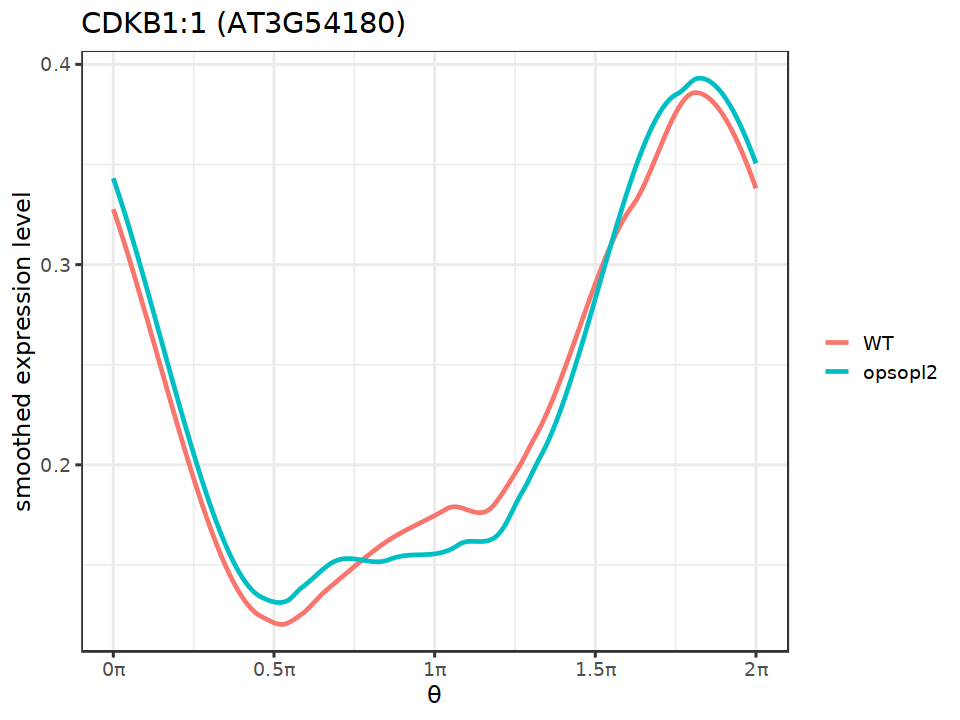

In [69]:
pltops("AT3G54180", "CDKB1:1 (AT3G54180)")

In [70]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CDKB1_1.pdf",width=8, height=8) 
pltops("AT3G54180", "CDKB1:1 (AT3G54180)")
dev.off()

png 
  2

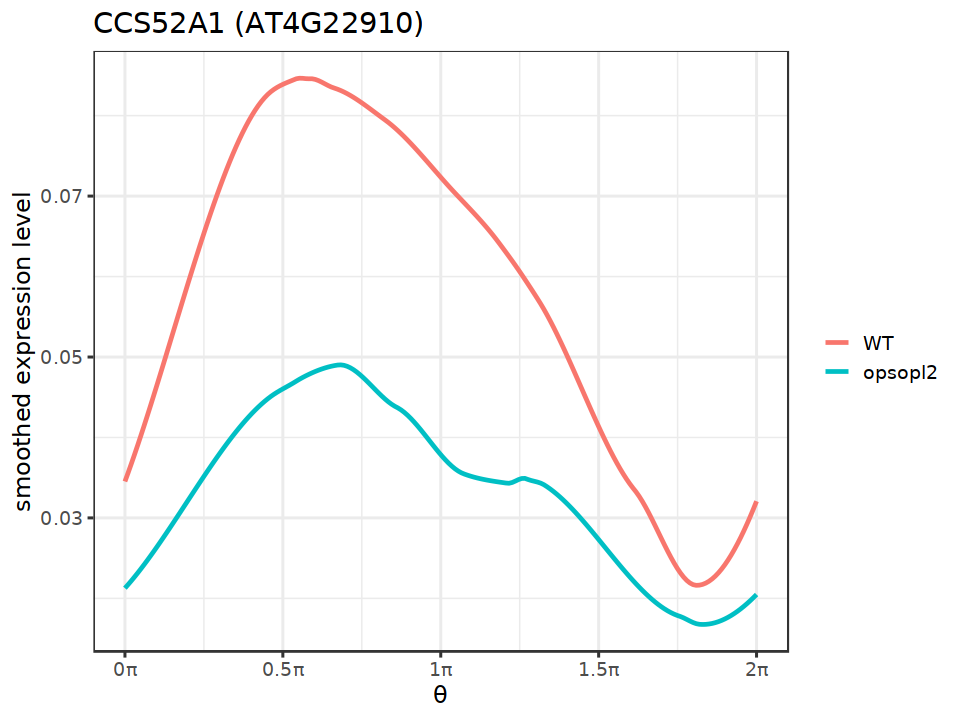

In [54]:
pltops("AT4G22910", "CCS52A1 (AT4G22910)")

In [55]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CCS52A1.pdf",width=8, height=8) 
pltops("AT4G22910", "CCS52A1 (AT4G22910)")
dev.off()

png 
  2

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


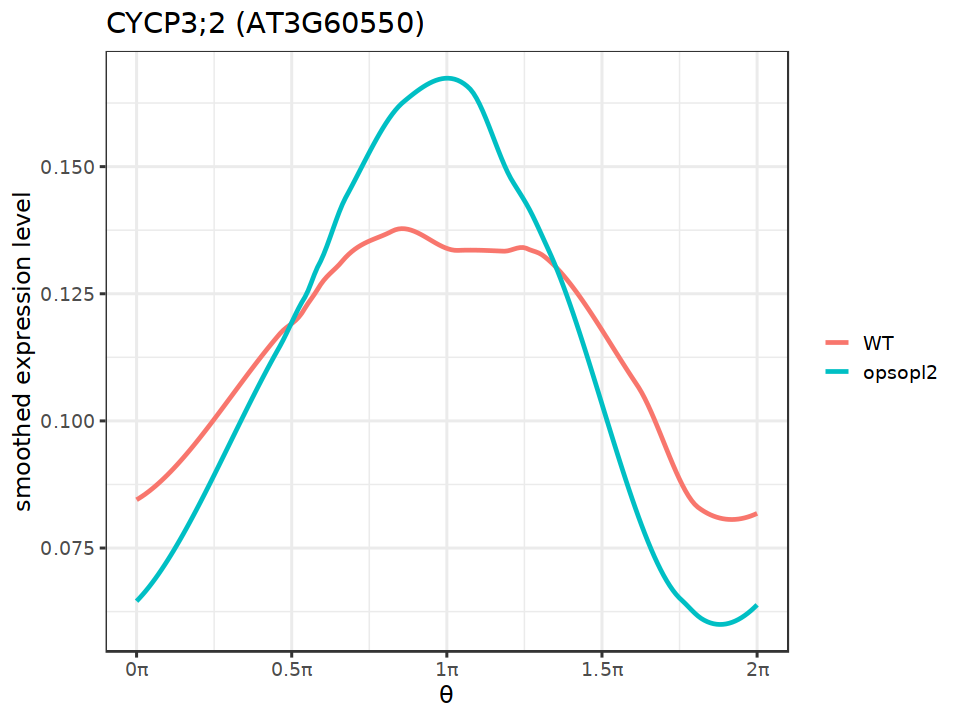

In [19]:
pltops("AT3G60550", "CYCP3;2 (AT3G60550)")

In [20]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CYCP3_2.pdf",width=8, height=8) 
pltops("AT3G60550", "CYCP3;2 (AT3G60550)")
dev.off()

png 
  2

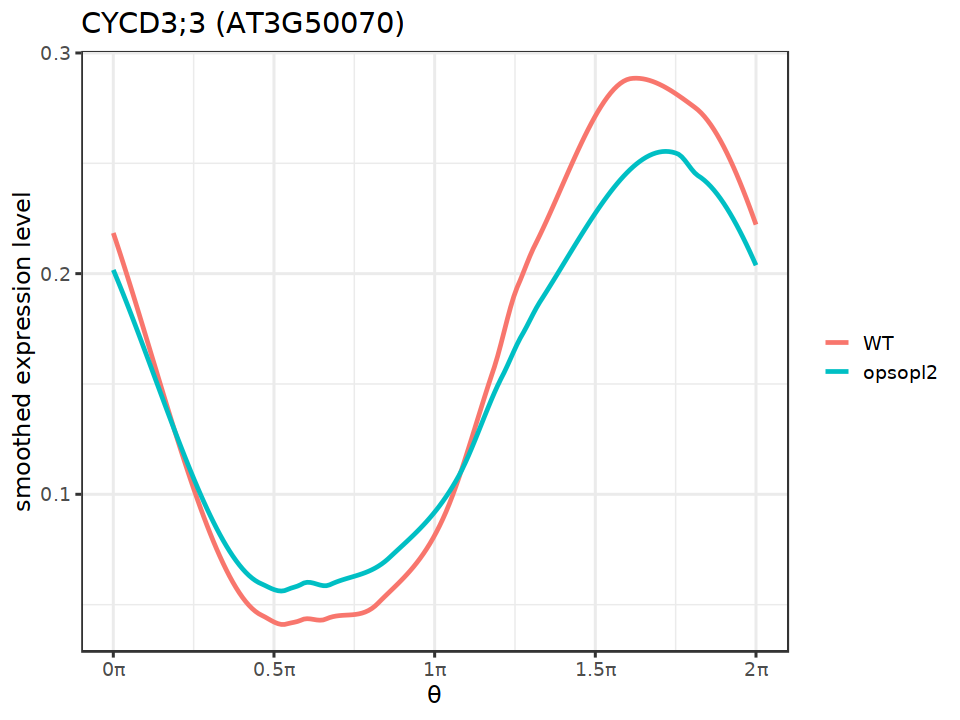

In [21]:
pltops("AT3G50070", "CYCD3;3 (AT3G50070)")

In [22]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CYCD3_3.pdf",width=8, height=8) 
pltops("AT3G50070", "CYCD3;3 (AT3G50070)")
dev.off()

png 
  2

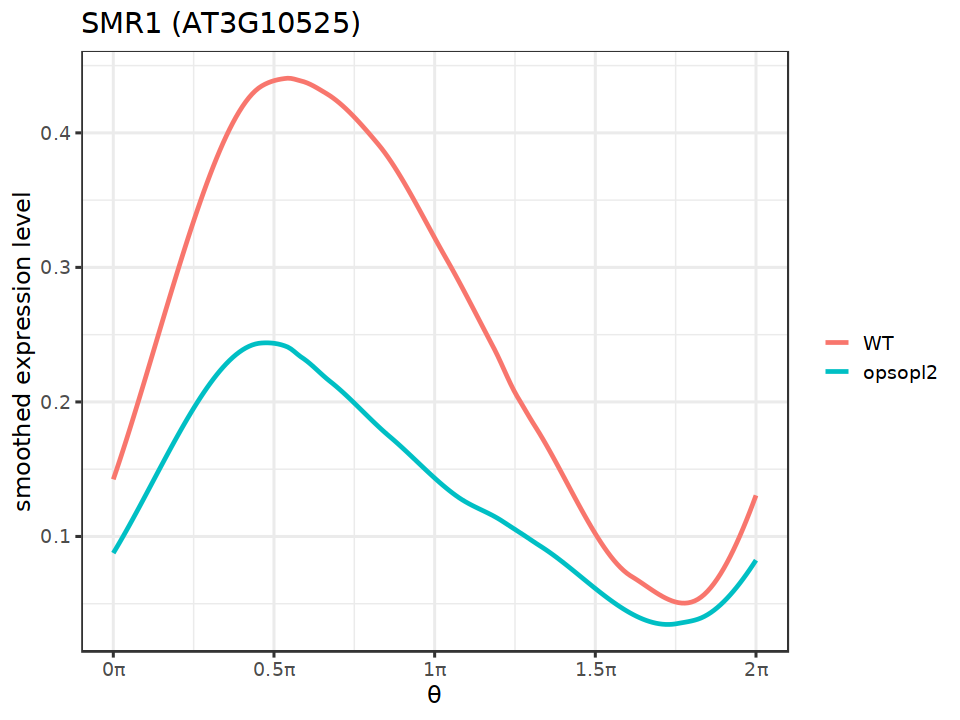

In [52]:
pltops("AT3G10525", "SMR1 (AT3G10525)")

In [53]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_SMR1.pdf",width=8, height=8) 
pltops("AT3G10525", "SMR1 (AT3G10525)")
dev.off()

png 
  2

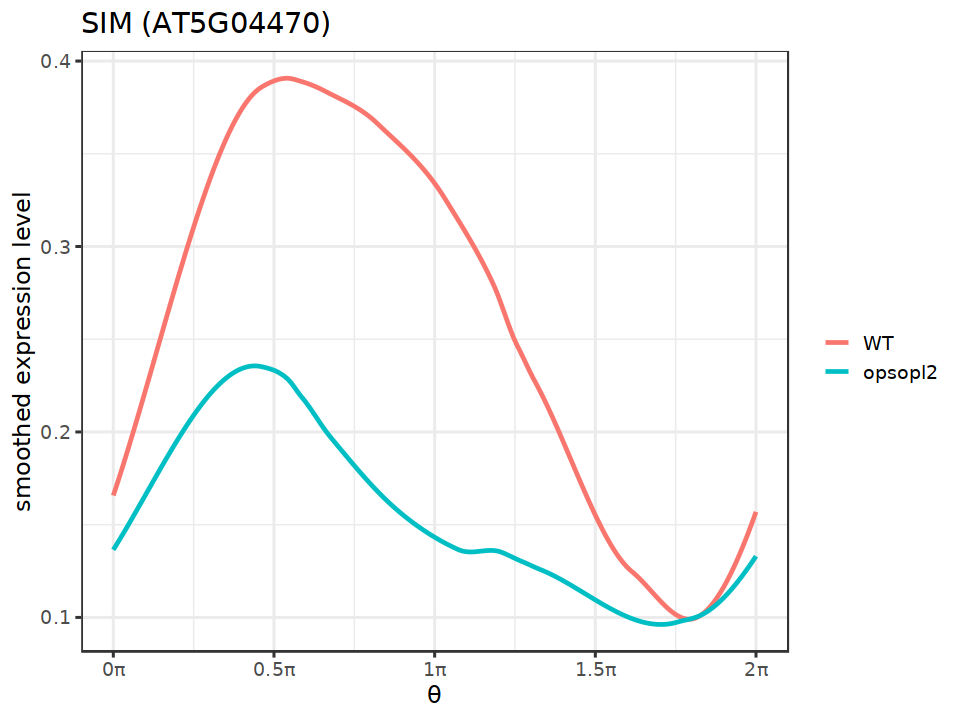

In [54]:
pltops("AT5G04470", "SIM (AT5G04470)")

In [55]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_SIM.pdf",width=8, height=8) 
pltops("AT5G04470", "SIM (AT5G04470)")
dev.off()

png 
  2

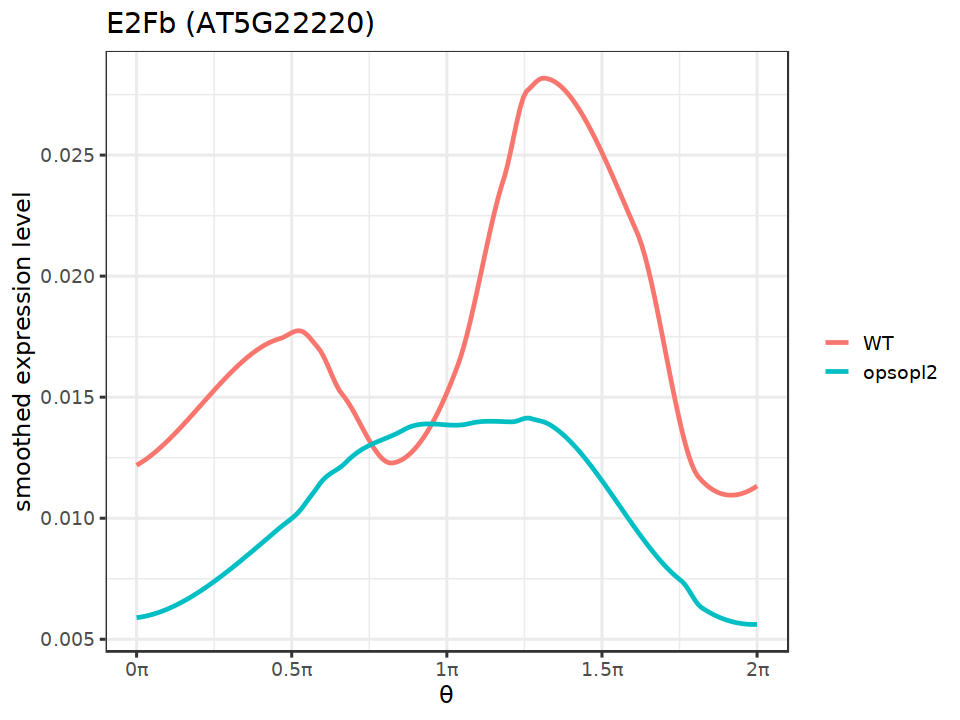

In [56]:
pltops("AT5G22220", "E2Fb (AT5G22220)")

In [57]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_E2Fb.pdf",width=8, height=8) 
pltops("AT5G22220", "E2Fb (AT5G22220)")
dev.off()

png 
  2

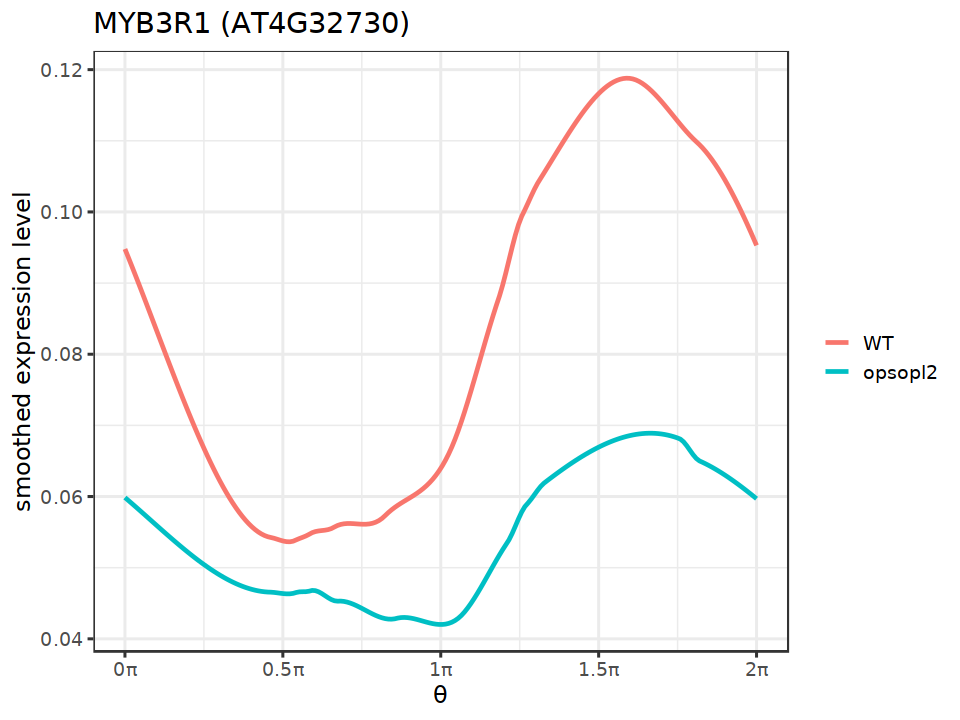

In [58]:
pltops("AT4G32730", "MYB3R1 (AT4G32730)")

In [59]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_MYB3R1.pdf",width=8, height=8) 
pltops("AT4G32730", "MYB3R1 (AT4G32730)")
dev.off()

png 
  2

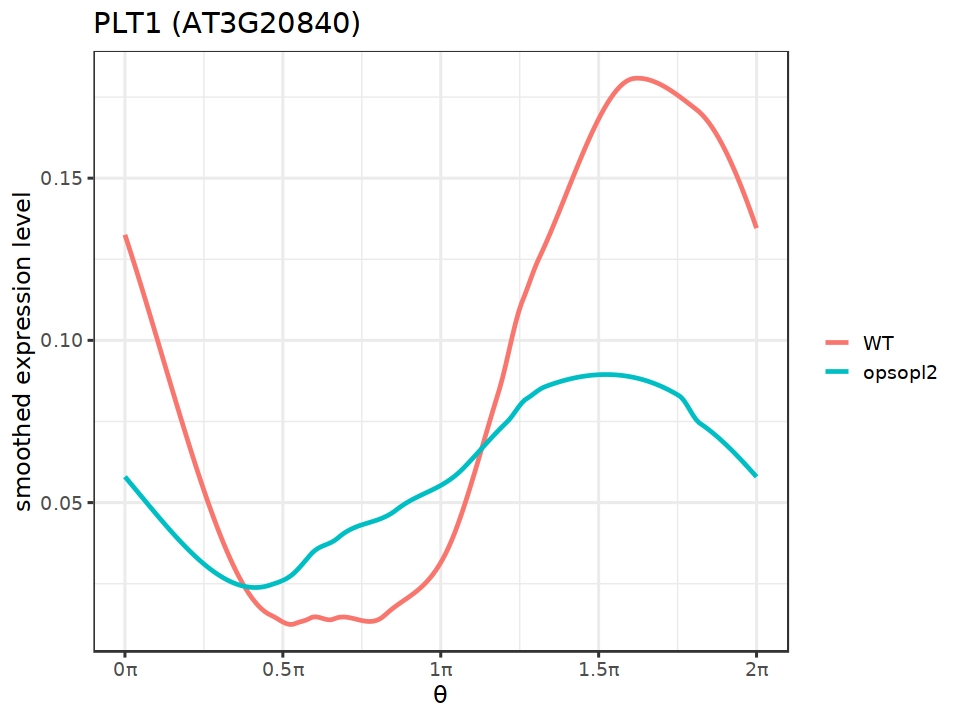

In [60]:
pltops("AT3G20840", "PLT1 (AT3G20840)")

In [61]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_PLT1.pdf",width=8, height=8) 
pltops("AT3G20840", "PLT1 (AT3G20840)")
dev.off()

png 
  2

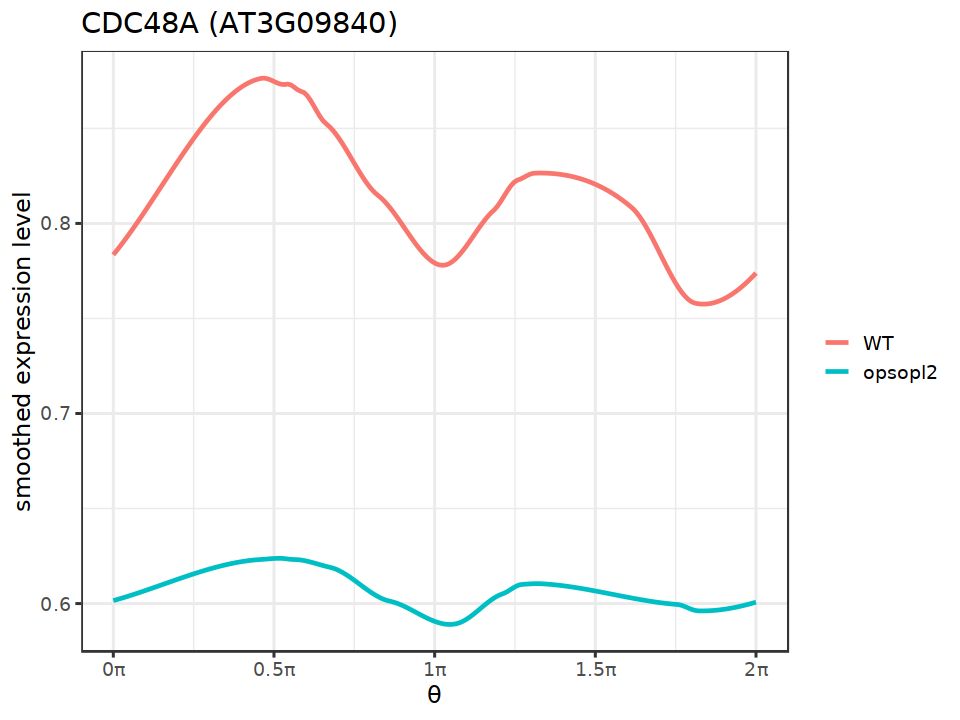

In [62]:
pltops("AT3G09840", "CDC48A (AT3G09840)")

In [63]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CDC48A.pdf",width=8, height=8) 
pltops("AT3G09840", "CDC48A (AT3G09840)")
dev.off()

png 
  2

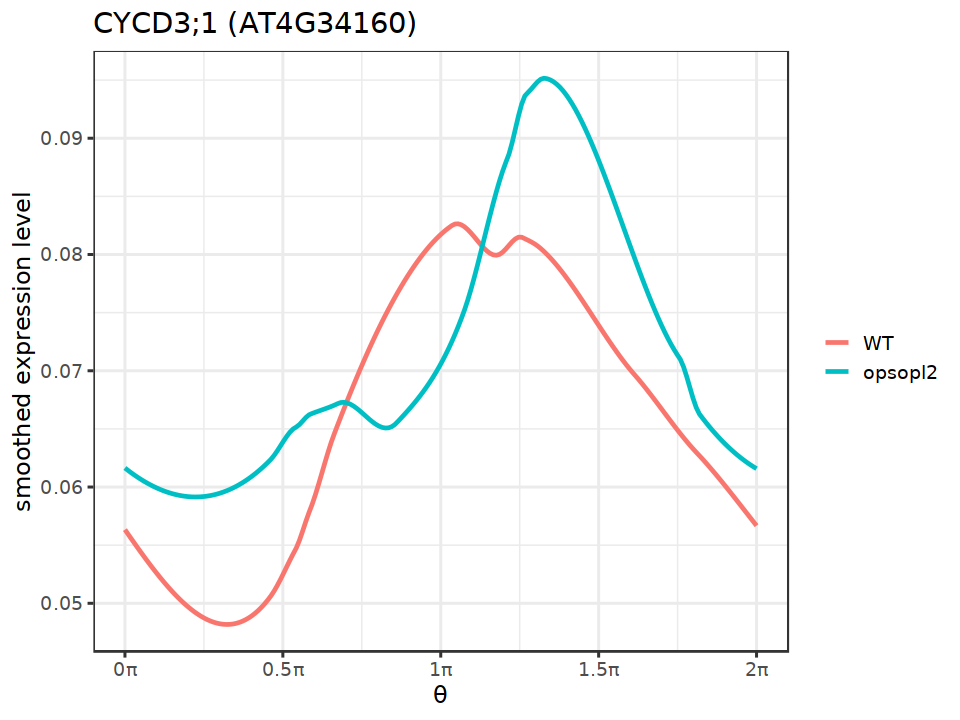

In [23]:
pltops("AT4G34160", "CYCD3;1 (AT4G34160)")

In [24]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CYCD3_1.pdf",width=8, height=8) 
pltops("AT4G34160", "CYCD3;1 (AT4G34160)")
dev.off()

png 
  2

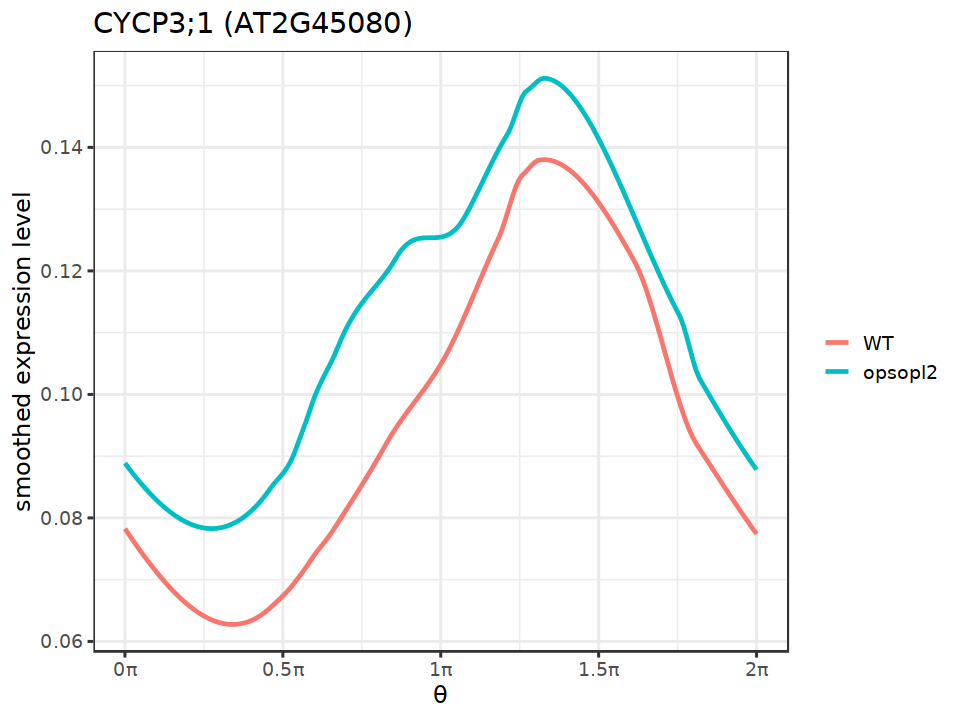

In [25]:
pltops("AT2G45080", "CYCP3;1 (AT2G45080)")

In [26]:
grDevices::cairo_pdf("./pdfs/WT_opsopl2_CYCP3_1.pdf",width=8, height=8) 
pltops("AT2G45080", "CYCP3;1 (AT2G45080)")
dev.off()

png 
  2

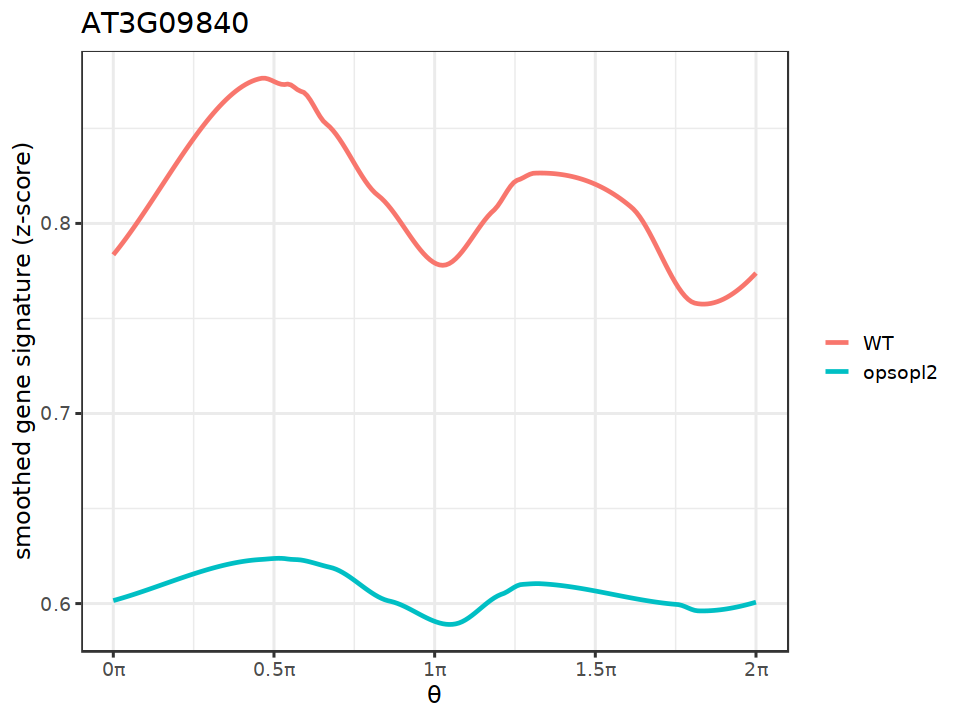

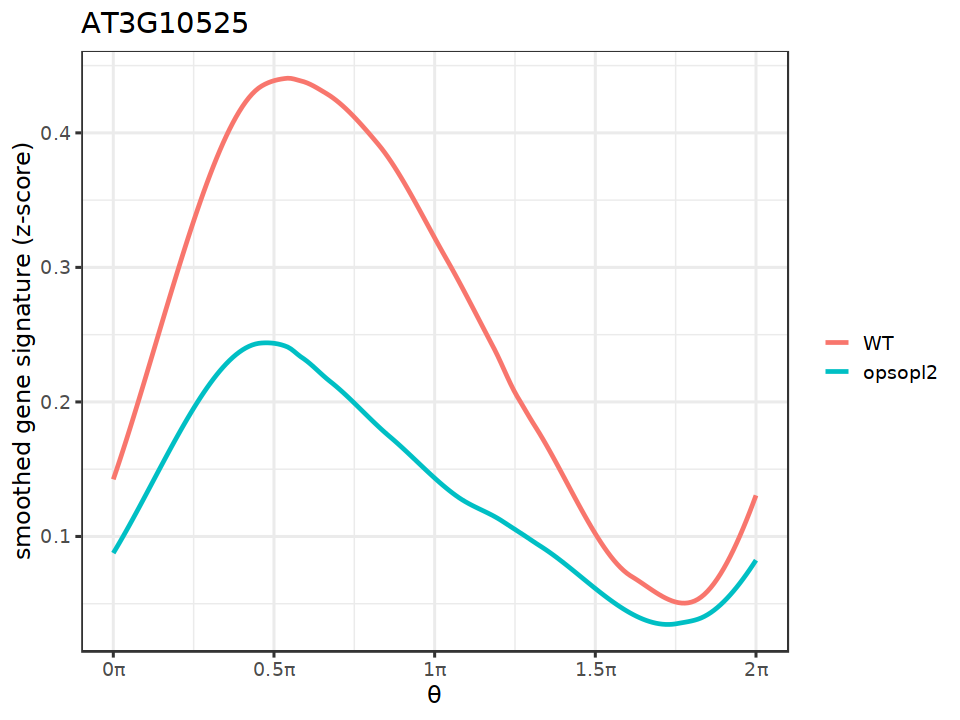

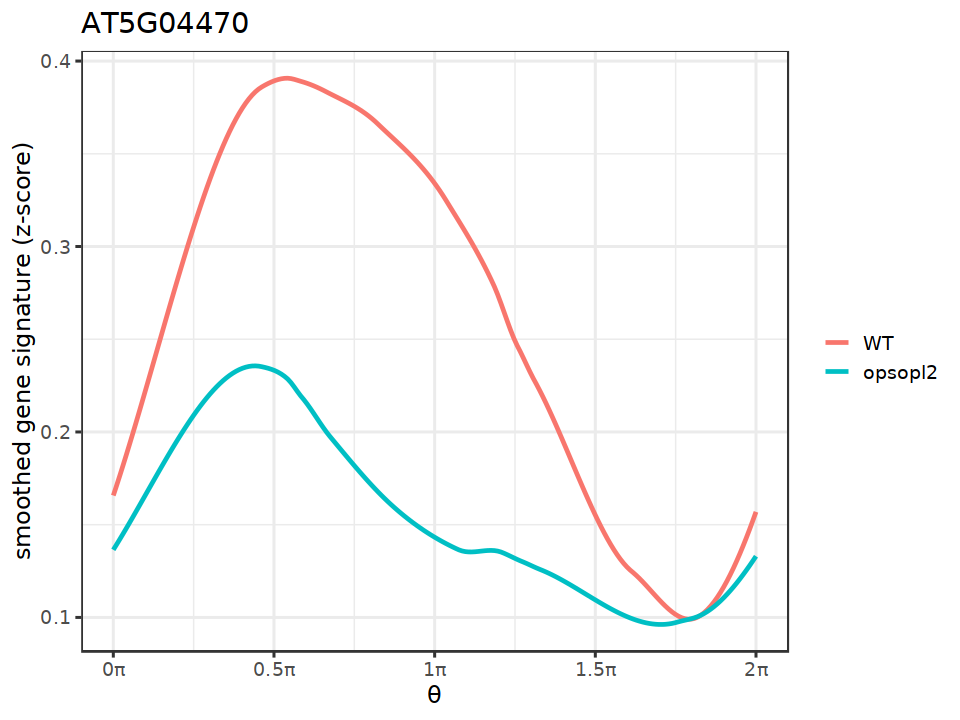

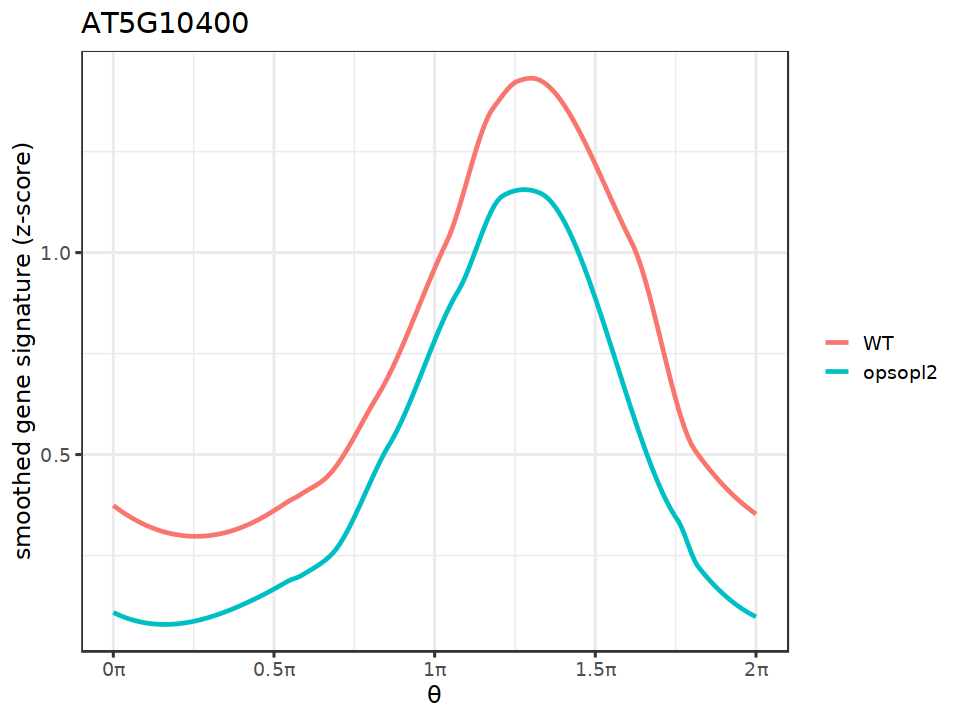

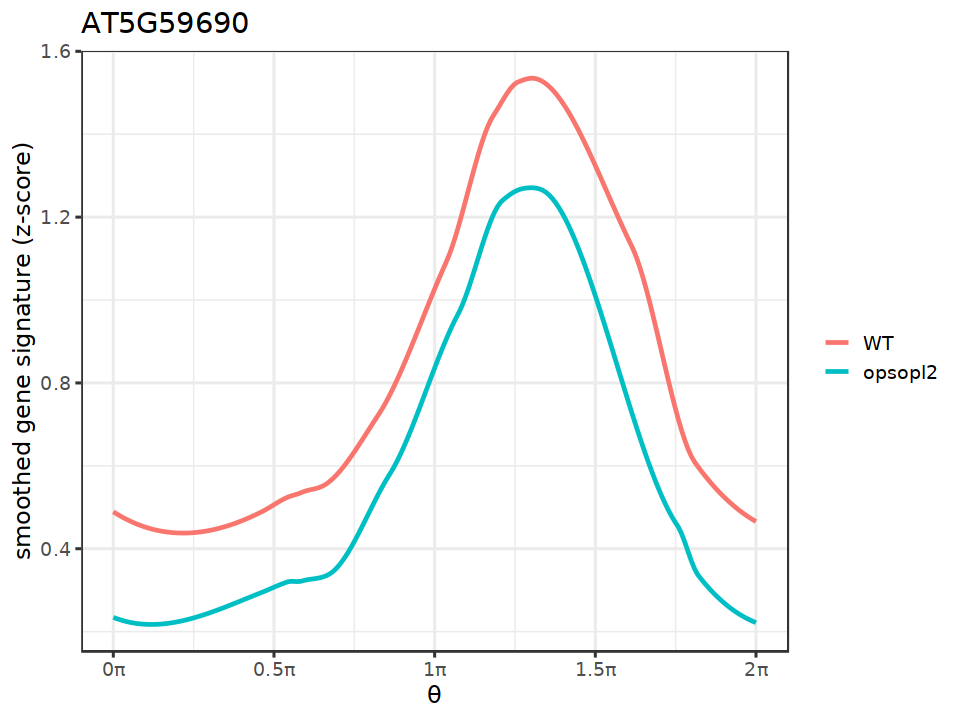

...

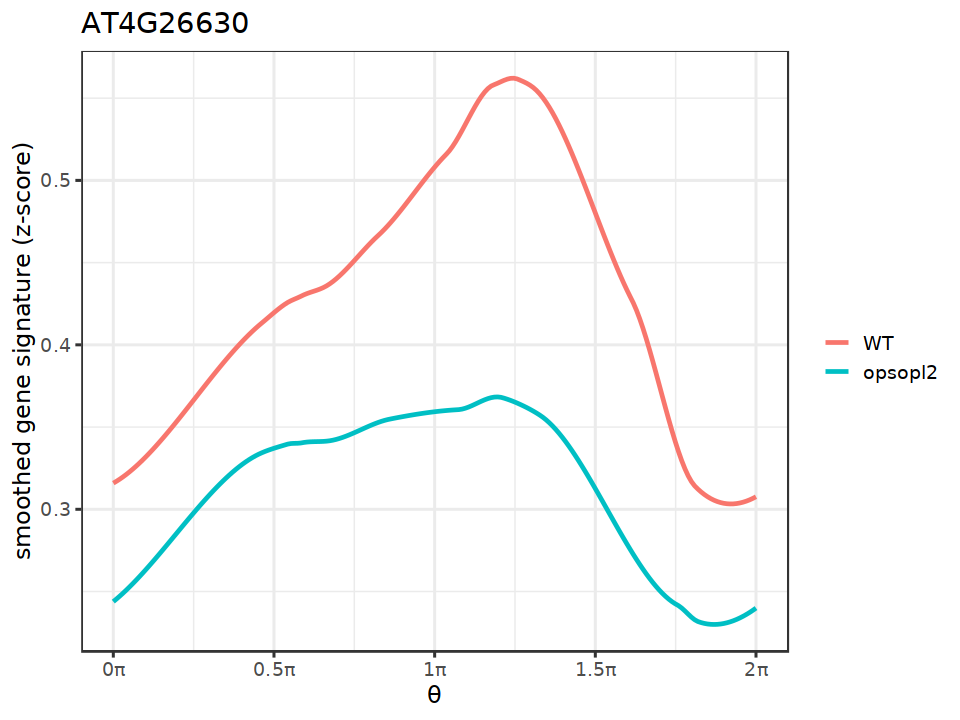

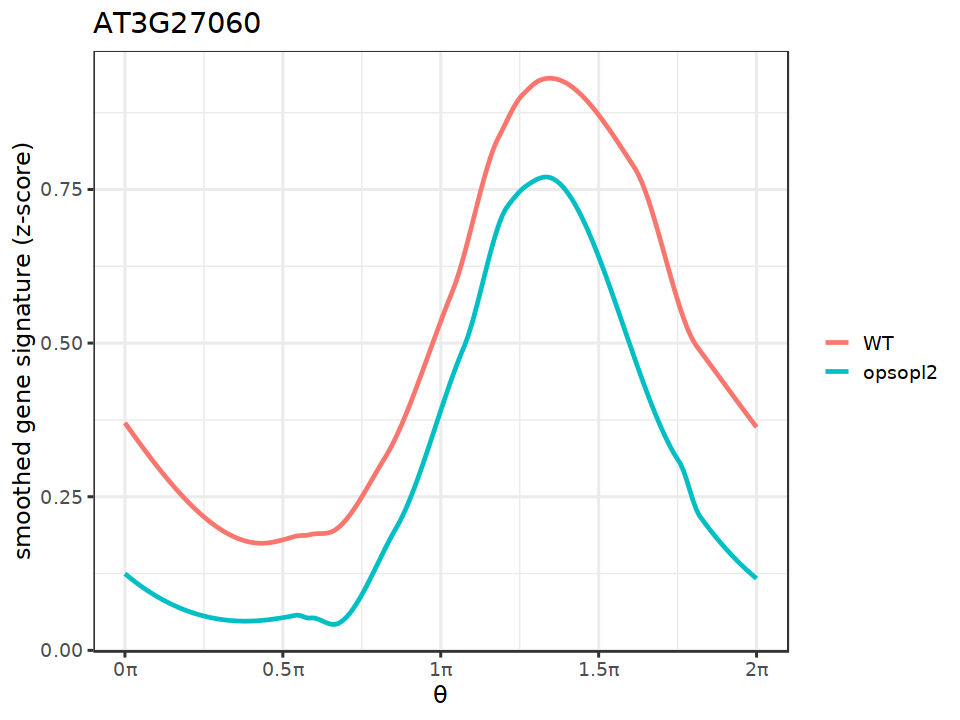

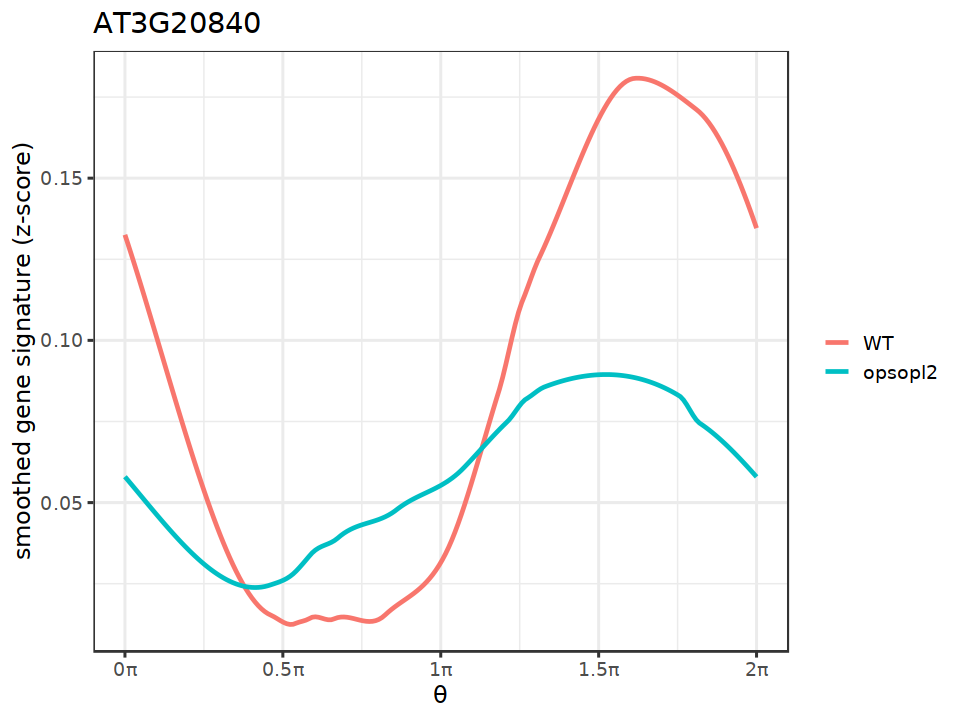

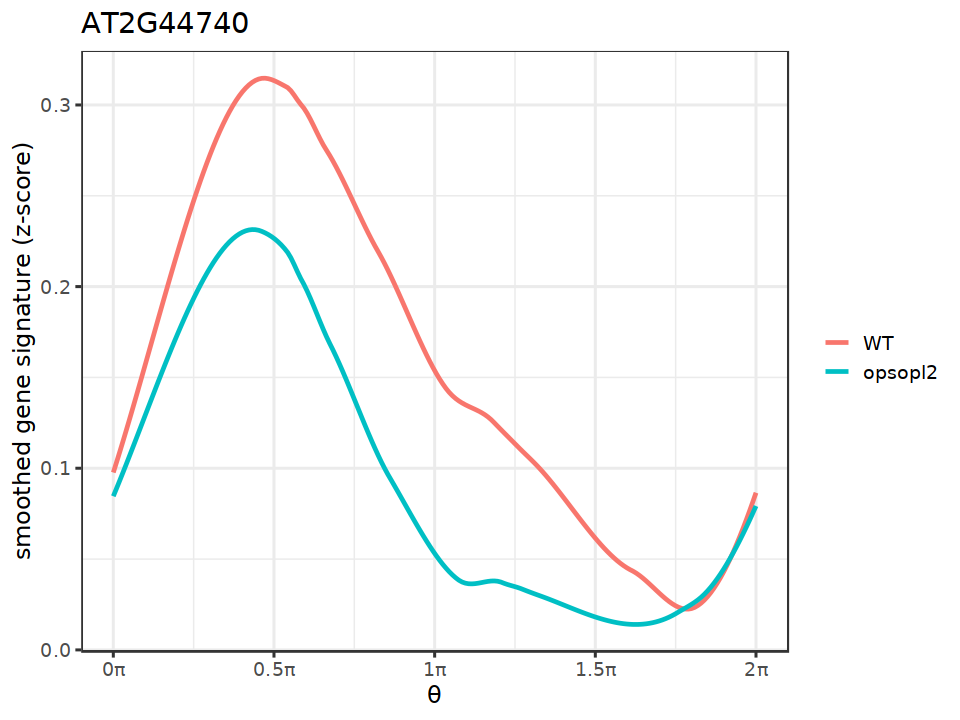

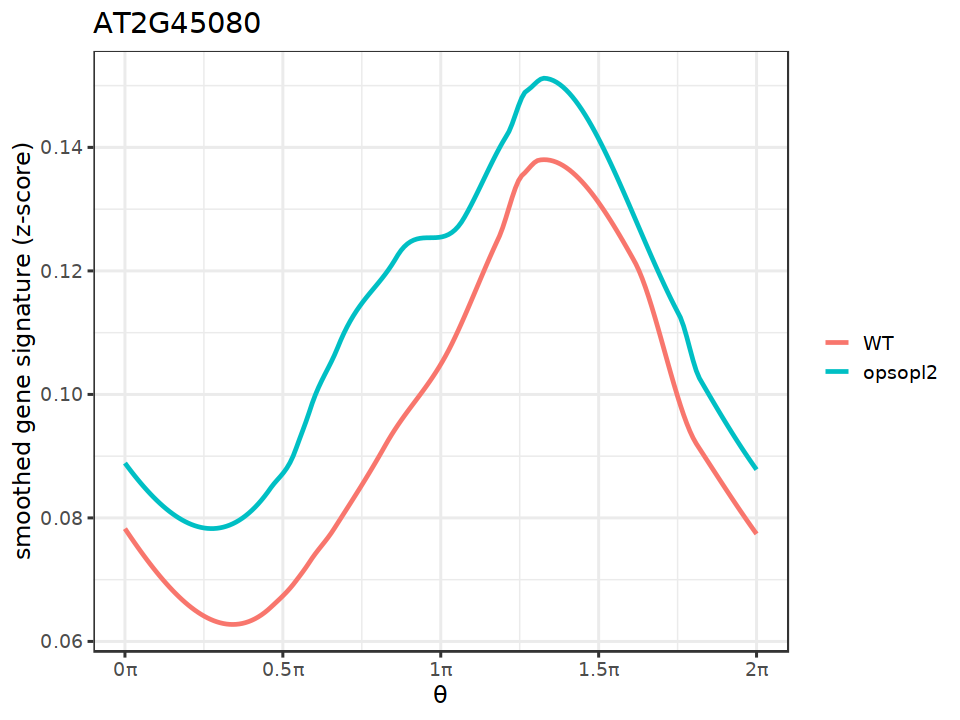

In [22]:
for (gene in gene.list){
 pltops(gene)
} 

## Core CC genes ( WT vs opsopl2 )

In [23]:
pltops <- function(gene, name){
    s1z_WT_opsopl2 <- c(WT@assays$SCT@data[which(rownames(WT@assays$SCT@data) == gene),],mutant@assays$SCT@data[which(rownames(mutant@assays$SCT@data) == gene),])
    s1z_WT <- s1z_WT_opsopl2[1:ncol(WT)]
    s1z_opsopl2 <- s1z_WT_opsopl2[(ncol(WT)+1):length(s1z_WT_opsopl2)]
    
    options(repr.plot.width=8, repr.plot.height=8)
    plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_opsopl2, "opsopl2", name)
}

In [26]:
core <- read.csv('./tradeseq/Core_CC_Genes.csv')

In [27]:
## Remove genes that were not captured by scRNA-seq
core_opsopl2 <- core[core$GeneID %in% rownames(opsopl2@assays$SCT@data),]

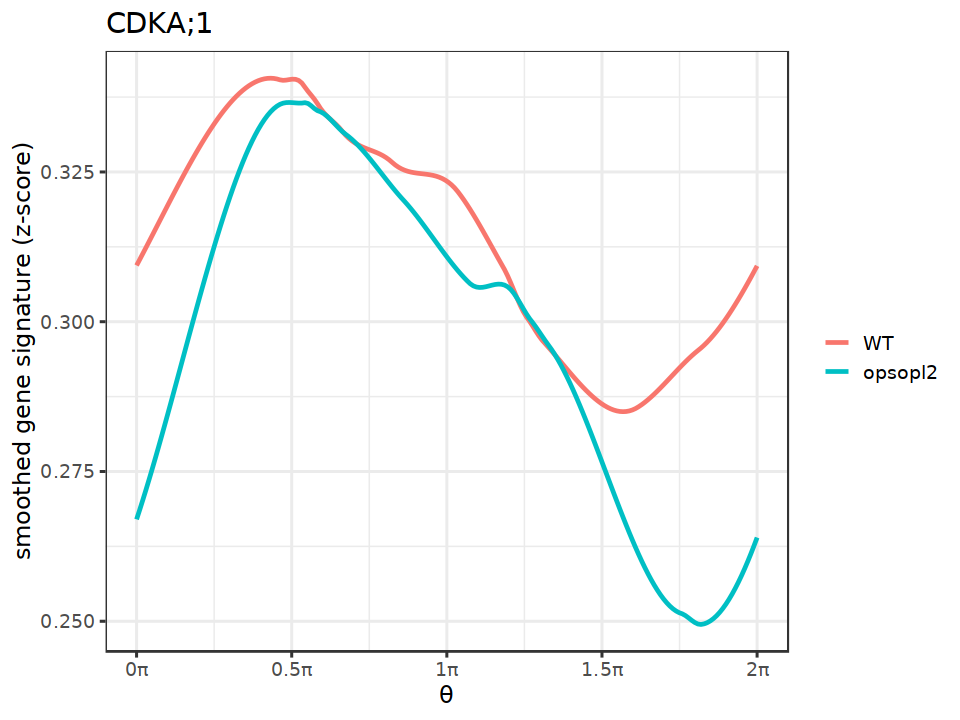

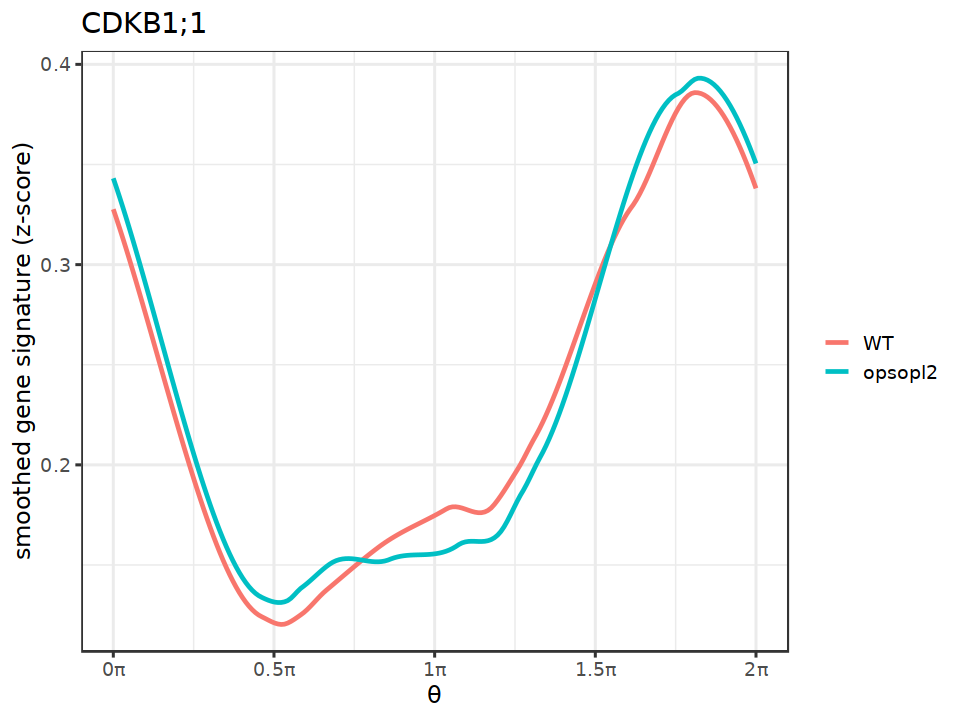

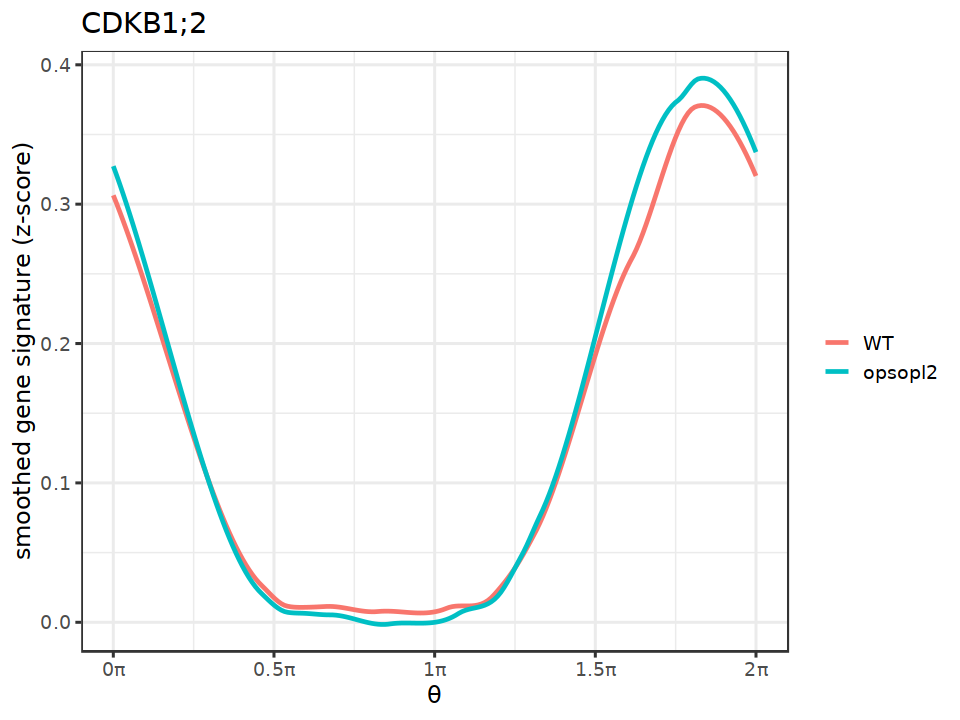

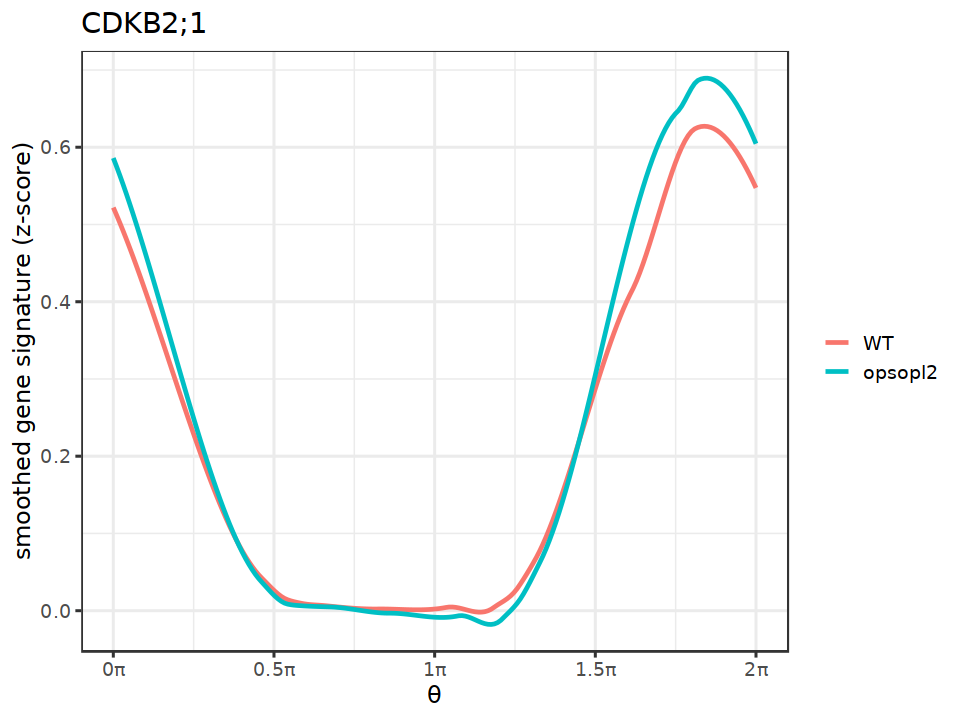

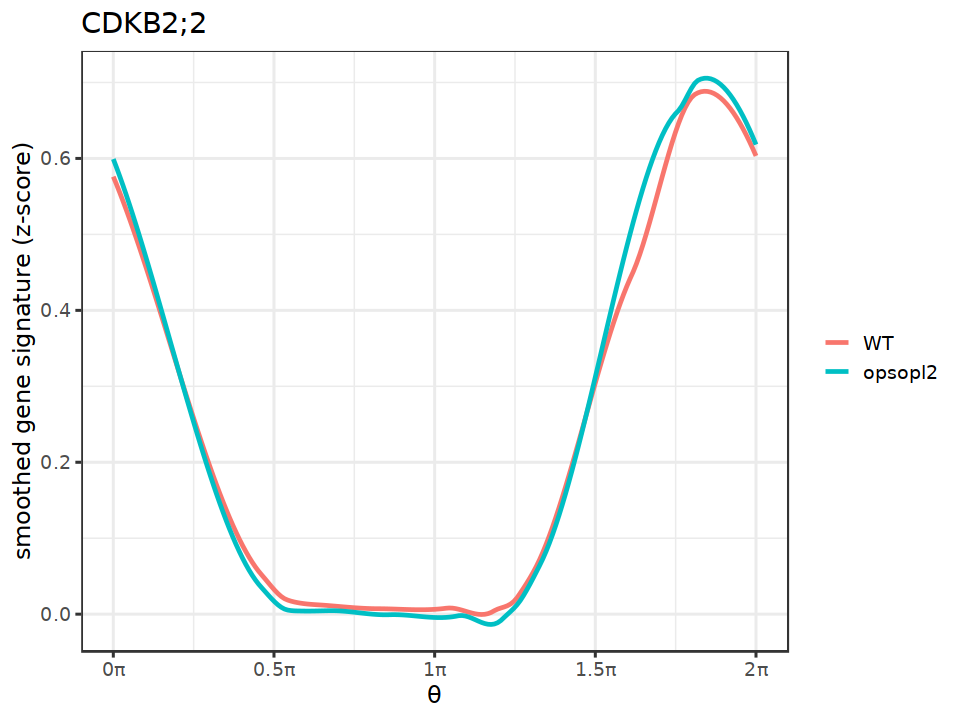

...

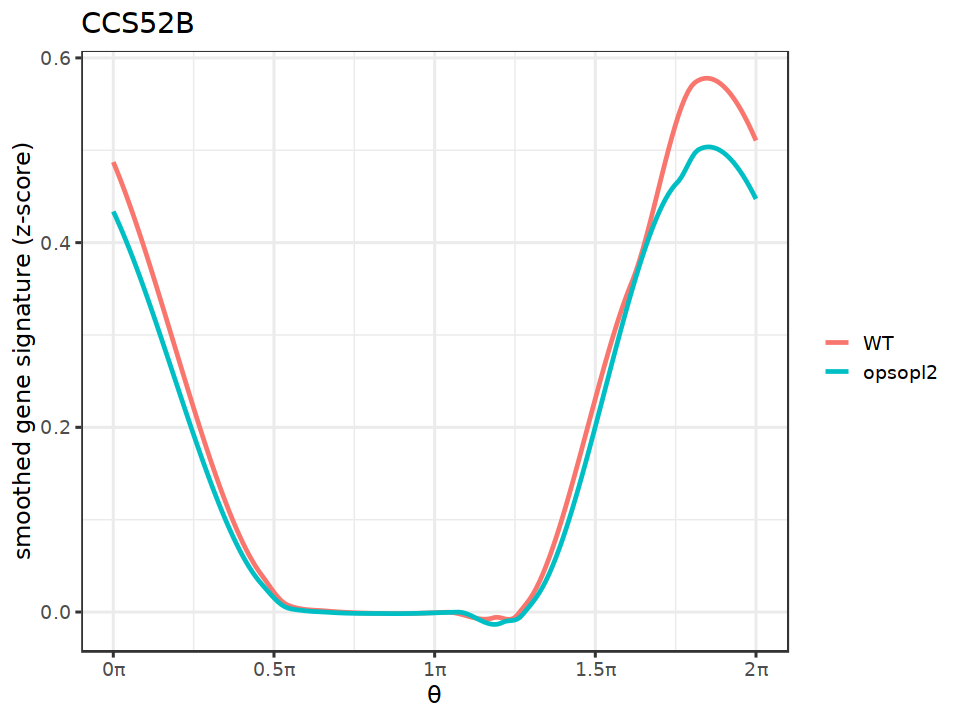

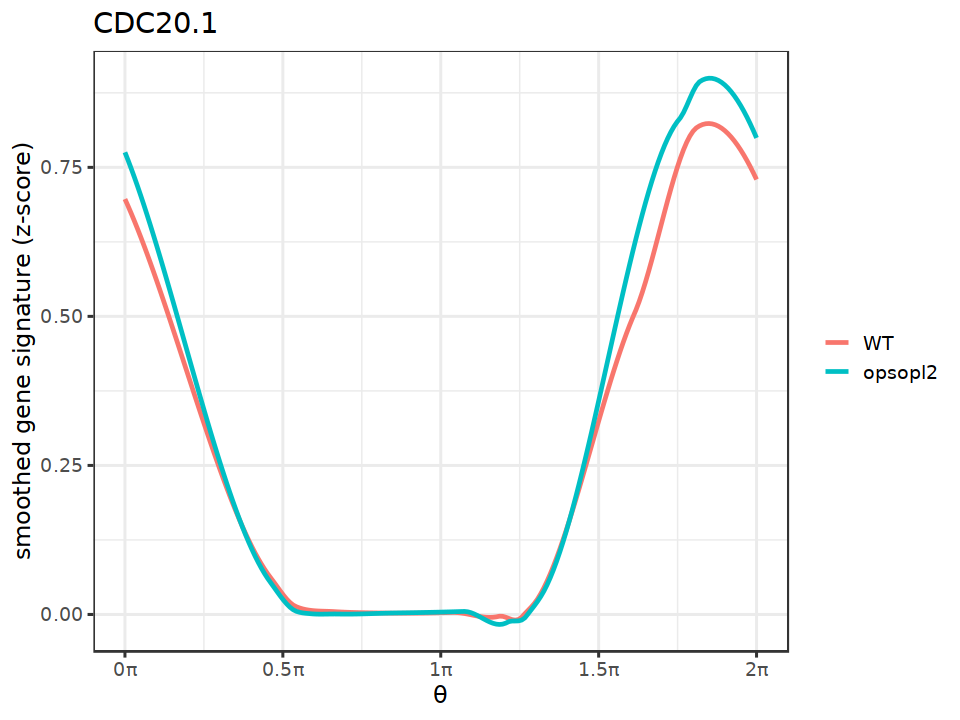

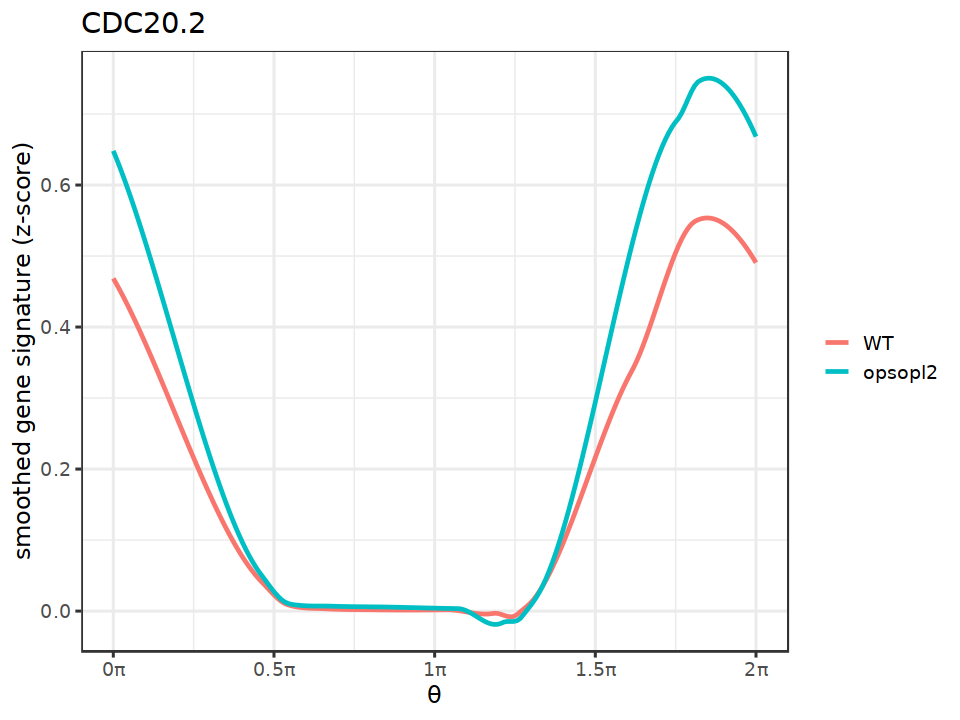

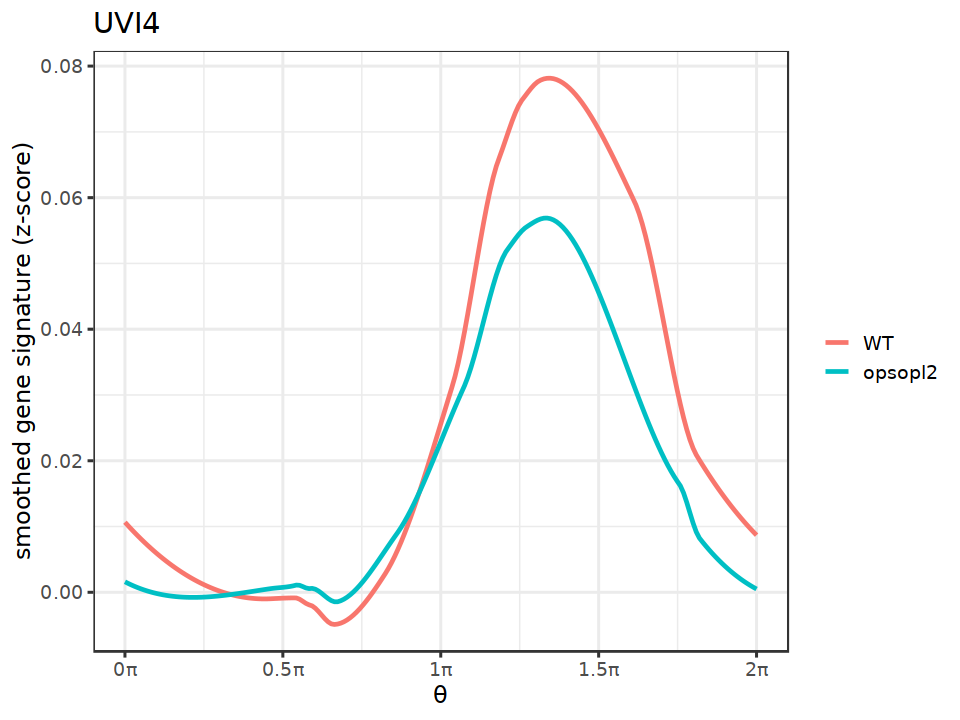

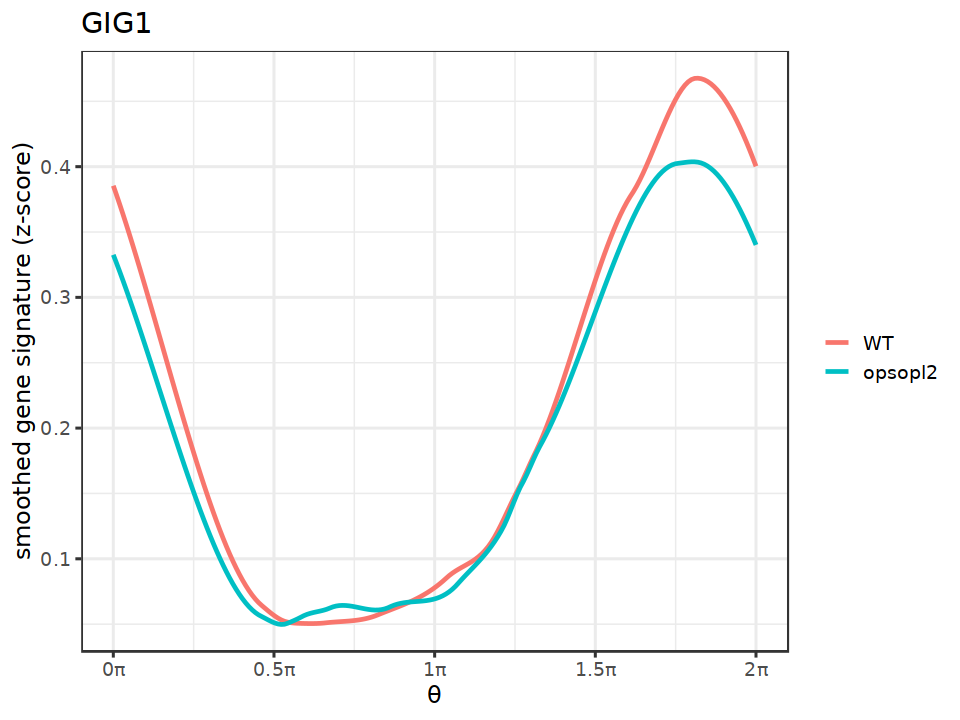

In [28]:
for (i in 1:nrow(core_opsopl2)){
 pltops(core_opsopl2$GeneID[i],core_opsopl2$GeneName[i])
} 

## bri1-T

In [240]:
bri1T <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_15S_BRZ_bri1_Li_seu4_clean_20231016.rds")

In [241]:
WT <- subset(bri1T, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_130", "sc_134"))))
mutant <- subset(bri1T, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_131", "sc_135"))))

In [242]:
bri1T

An object of class Seurat 
71252 features across 78435 samples within 3 assays 
Active assay: integrated (17338 features, 17338 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [246]:
WT

An object of class Seurat 
71252 features across 87 samples within 3 assays 
Active assay: integrated (17338 features, 17338 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [248]:
mutant

An object of class Seurat 
71252 features across 1150 samples within 3 assays 
Active assay: integrated (17338 features, 17338 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [243]:
s1z_WT_mutant <- as.numeric(apply(apply(cbind(as.matrix(WT@assays$SCT@data)[s1,],as.matrix(mutant@assays$SCT@data)[s1,]), 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))

In [244]:
s1z_WT <- s1z_WT_mutant[1:ncol(WT)]
s1z_mutant <- s1z_WT_mutant[(ncol(WT)+1):length(s1z_WT_mutant)]

## WT only has 87 cells! Not reliable

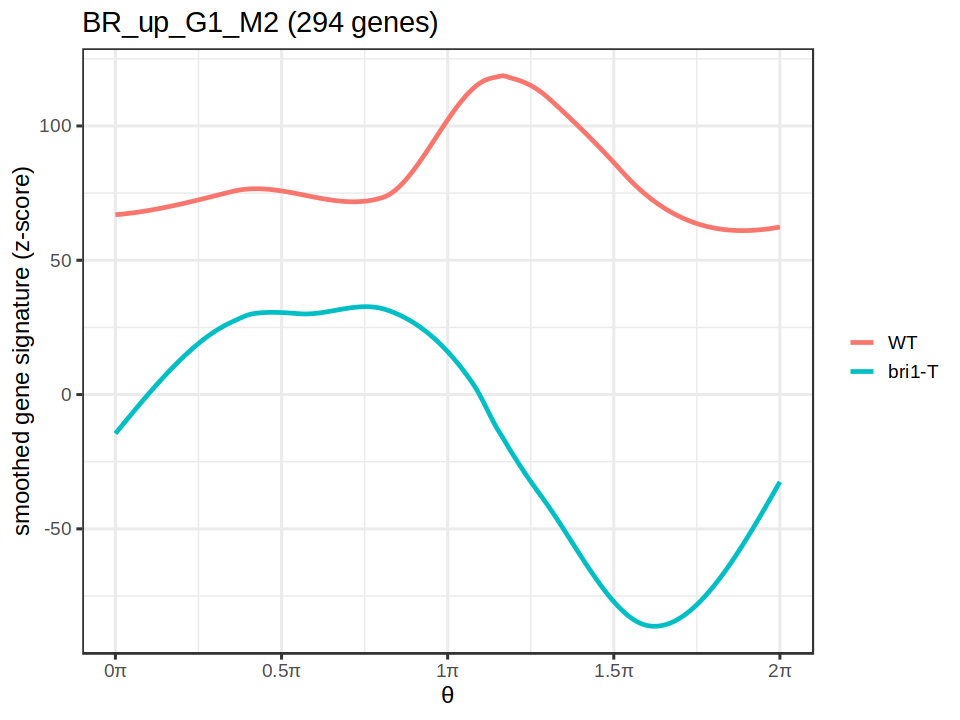

In [245]:
options(repr.plot.width=8, repr.plot.height=8)
plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_mutant, "bri1-T", "BR_up_G1_M2 (294 genes)")

## pWER-TSKO

In [277]:
pWER <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_9S_BRI1-TSKO_Li_seu4_20231016.rds")

In [278]:
wanted_cols <- c("orig.ident","time.celltype.anno.Li.crude", "time.anno.Li.crude", "celltype.anno.Li.crude","time.celltype.anno.Li","tricyclePosition","tricycleCCStage")
pWER@meta.data <- pWER@meta.data[,wanted_cols]
colnames(pWER@meta.data) <- c("sample","time_zone_cell_type", "time_zone", "cell_type", "time_zone_cell_subtype", "tricyclePosition","tricycleCCStage")

In [279]:
WT <- subset(pWER, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_218", "sc_224"))))
mutant <- subset(pWER, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_225", "sc_227", "sc_228"))))

In [280]:
pWER

An object of class Seurat 
74618 features across 105557 samples within 3 assays 
Active assay: integrated (19323 features, 19323 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [281]:
WT

An object of class Seurat 
74618 features across 3120 samples within 3 assays 
Active assay: integrated (19323 features, 19323 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [282]:
mutant

An object of class Seurat 
74618 features across 3054 samples within 3 assays 
Active assay: integrated (19323 features, 19323 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [283]:
s1z_WT_mutant <- as.numeric(apply(apply(cbind(as.matrix(WT@assays$SCT@data)[s1,],as.matrix(mutant@assays$SCT@data)[s1,]), 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
s1z_WT <- s1z_WT_mutant[1:ncol(WT)]
s1z_mutant <- s1z_WT_mutant[(ncol(WT)+1):length(s1z_WT_mutant)]

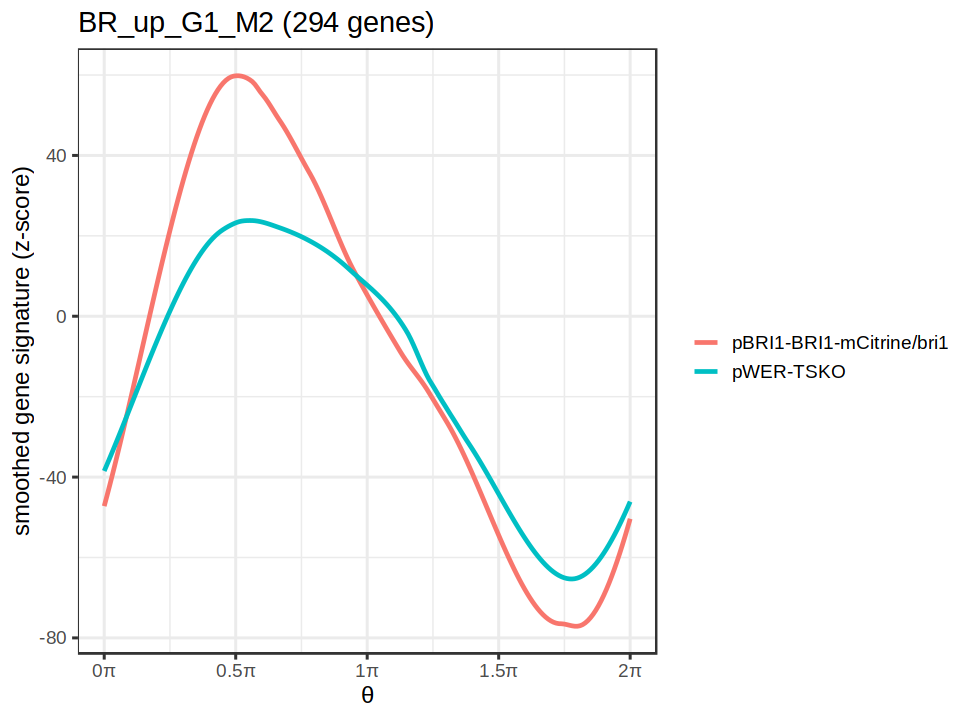

In [284]:
options(repr.plot.width=8, repr.plot.height=8)
plts(WT$tricyclePosition*pi, s1z_WT, "pBRI1-BRI1-mCitrine/bri1", mutant$tricyclePosition*pi, s1z_mutant, "pWER-TSKO", "BR_up_G1_M2 (294 genes)")

## hat7

In [257]:
hat7 <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_7S_hat7_Li_seu4_20231016.rds")

In [258]:
wanted_cols <- c("orig.ident","time.celltype.anno.Li.crude", "time.anno.Li.crude", "celltype.anno.Li.crude","time.celltype.anno.Li","tricyclePosition","tricycleCCStage")
hat7@meta.data <- hat7@meta.data[,wanted_cols]
colnames(hat7@meta.data) <- c("sample","time_zone_cell_type", "time_zone", "cell_type", "time_zone_cell_subtype", "tricyclePosition","tricycleCCStage")

In [259]:
WT <- subset(hat7, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_215", "sc_221"))))
mutant <- subset(hat7, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_216", "sc_222"))))

In [260]:
WT

An object of class Seurat 
74070 features across 3470 samples within 3 assays 
Active assay: integrated (18104 features, 18104 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [261]:
mutant

An object of class Seurat 
74070 features across 3137 samples within 3 assays 
Active assay: integrated (18104 features, 18104 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [262]:
s1z_WT_mutant <- as.numeric(apply(apply(cbind(as.matrix(WT@assays$SCT@data)[s1,],as.matrix(mutant@assays$SCT@data)[s1,]), 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
s1z_WT <- s1z_WT_mutant[1:ncol(WT)]
s1z_mutant <- s1z_WT_mutant[(ncol(WT)+1):length(s1z_WT_mutant)]

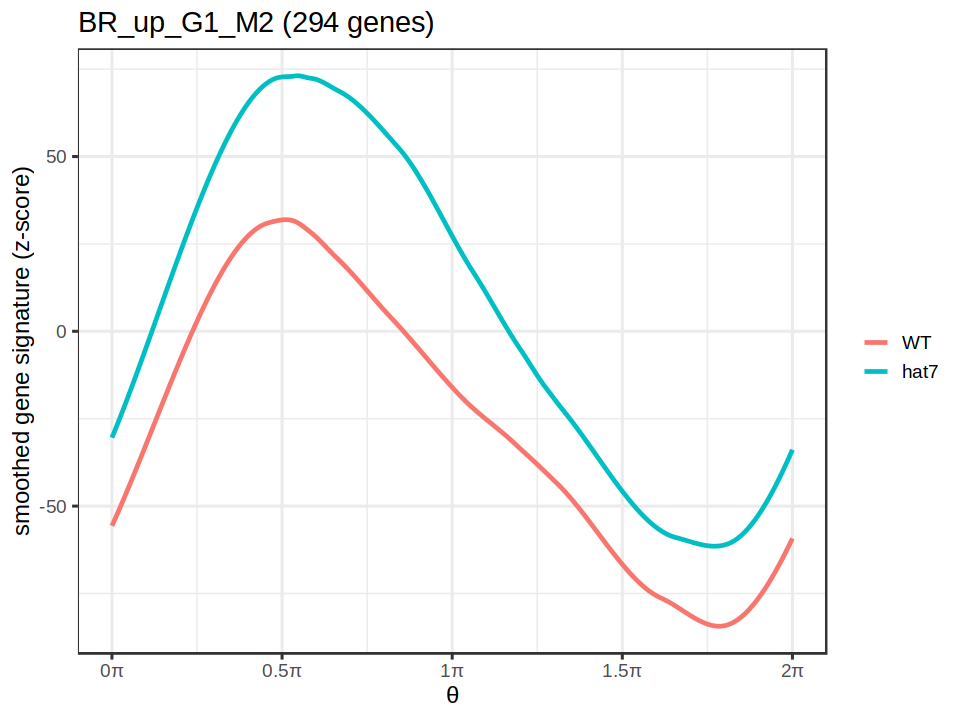

In [264]:
options(repr.plot.width=8, repr.plot.height=8)
plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_mutant, "hat7", "BR_up_G1_M2 (294 genes)")

## BRZ

In [265]:
BRZ <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_15S_BRZ_bri1_Li_seu4_clean_20231016.rds")

In [266]:
WT <- subset(BRZ, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_111", "sc_113"))))
mutant <- subset(BRZ, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain")) & (sample %in% c("sc_112", "sc_114"))))

In [267]:
WT

An object of class Seurat 
71252 features across 144 samples within 3 assays 
Active assay: integrated (17338 features, 17338 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [268]:
mutant

An object of class Seurat 
71252 features across 585 samples within 3 assays 
Active assay: integrated (17338 features, 17338 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [269]:
s1z_WT_mutant <- as.numeric(apply(apply(cbind(as.matrix(WT@assays$SCT@data)[s1,],as.matrix(mutant@assays$SCT@data)[s1,]), 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
s1z_WT <- s1z_WT_mutant[1:ncol(WT)]
s1z_mutant <- s1z_WT_mutant[(ncol(WT)+1):length(s1z_WT_mutant)]

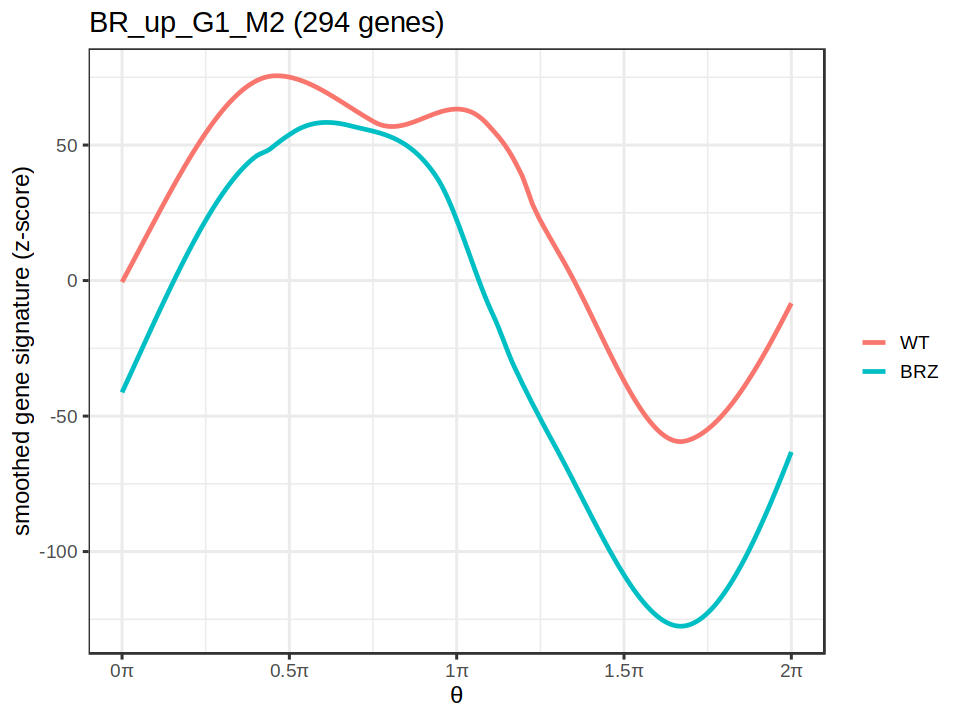

In [270]:
options(repr.plot.width=8, repr.plot.height=8)
plts(WT$tricyclePosition*pi, s1z_WT, "WT", mutant$tricyclePosition*pi, s1z_mutant, "BRZ", "BR_up_G1_M2 (294 genes)")

## BR time course

In [56]:
BR <- readRDS("./scRNA-seq/Integrated_Objects/rc.integrated_14S_BR_Li_seu4_clean_20231016.rds")

In [57]:
BR <- subset(BR, subset= ((cell_type %in% c("Atrichoblast")) & (time_zone %in% c("Proliferation Domain"))))

In [58]:
BR <- subset(BR, subset= (sample %in% c("sc_43", "sc_44", "sc_45", "sc_46", "sc_47", "sc_48","sc_49","sc_50")))

In [59]:
sce <- as.SingleCellExperiment(BR)
sce$br_time <- sce$treatment
sce$br_time[which(BR$sample %in% c("sc_43","sc_50"))] <- "BRZ"
sce$br_time[which(BR$sample %in% c("sc_44"))] <- "BL-0.5"
sce$br_time[which(BR$sample %in% c("sc_45"))] <- "BL-1"
sce$br_time[which(BR$sample %in% c("sc_46","sc_49"))] <- "BL-2"
sce$br_time[which(BR$sample %in% c("sc_47"))] <- "BL-4"
sce$br_time[which(BR$sample %in% c("sc_48"))] <- "BL-8"

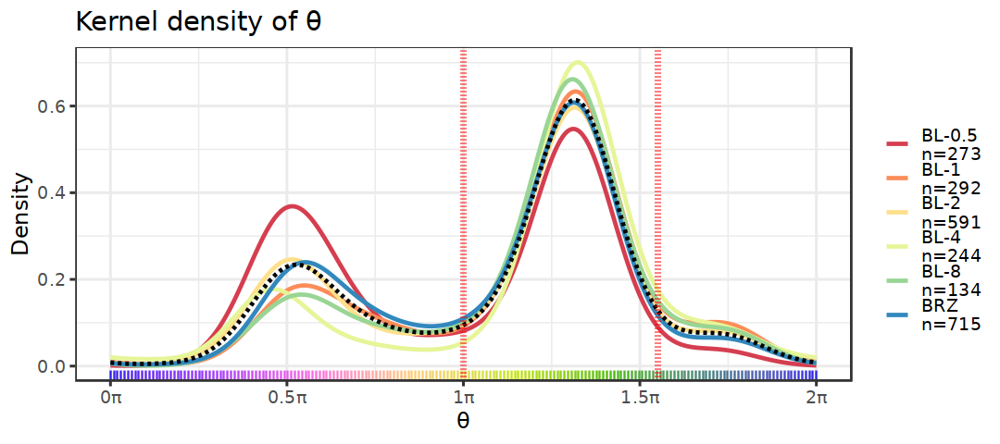

In [94]:
## Plot
options(repr.plot.width=9, repr.plot.height=4)
print(plot_ccposition_den(sce$tricyclePosition * pi,
                sce$br_time, '',
                bw = 10,line.size=1,line.alpha=1, fig.title = "Kernel density of \u03b8", palette.v=colorRampPalette(brewer.pal(6, "Spectral"))(6)) +
  theme_bw(base_size = 14)+ geom_vline(xintercept = 1*pi, linetype="dotted", 
                color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
                color = "red", size=1.5))

In [95]:
meta <- sce@colData

In [96]:
meta <- as.data.frame(meta)

In [97]:
meta$cell_id <- rownames(meta)
module_sel <- select(meta, cell_id, br_time)
module_list <- split(module_sel, f=module_sel$br_time)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list  <- lapply(module_list, function(x) x[names(x)=="cell_id"])
# convert each sublist into character and eliminate duplicates
module_list  <- lapply(module_list, function(x) as.character(unique(x$cell_id)))

In [98]:
module_sel <- select(meta, cell_id, tricycleCCStage)
module_list2 <- split(module_sel, f=module_sel$tricycleCCStage)
#this makes list from long df of gene lists - TARGET is what we want to keep
module_list2  <- lapply(module_list2, function(x) x[names(x)=="cell_id"])
# convert each sublist into character and eliminate duplicates
module_list2  <- lapply(module_list2, function(x) as.character(unique(x$cell_id)))

In [99]:
## GeneOverlap 

# number of cells

data_size <- ncol(BR)

#compare all lists
gom.self <- newGOM(module_list, module_list2, genome.size=data_size)

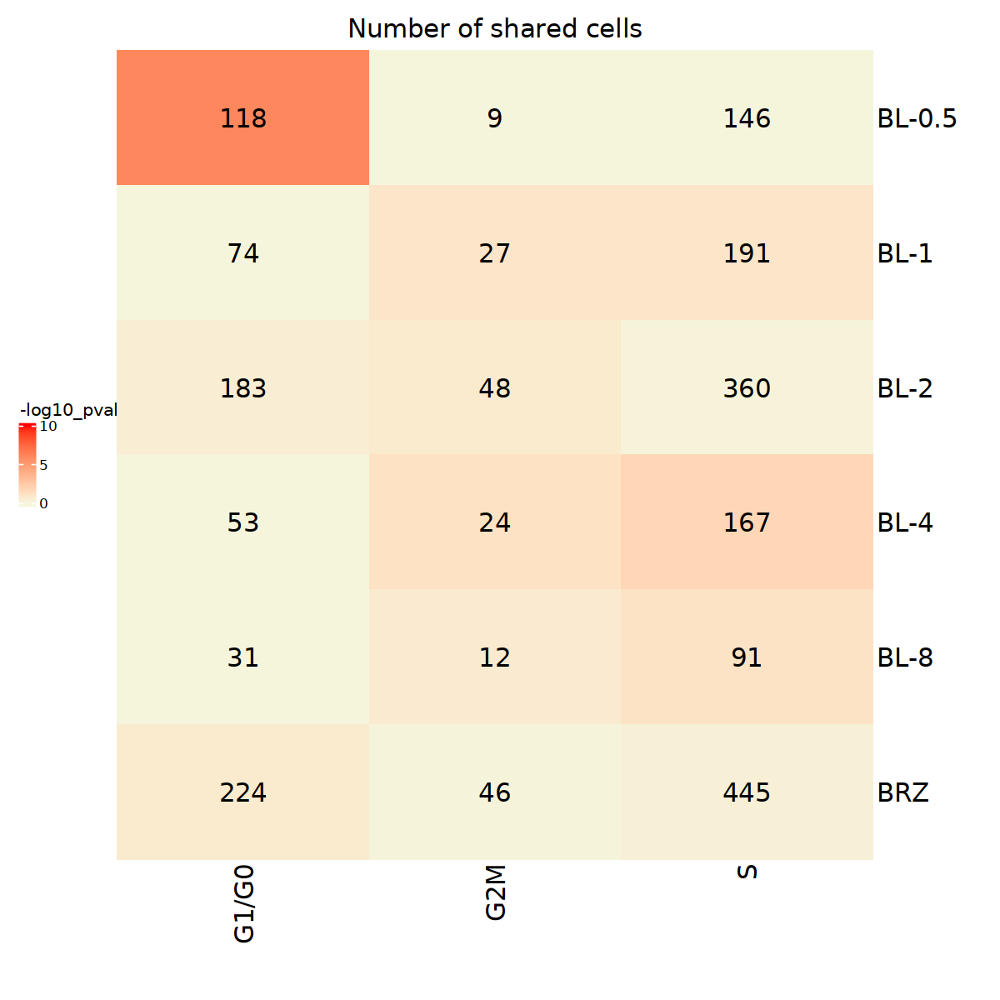

In [103]:
options(repr.plot.width = 10, repr.plot.height = 10)
 
int <- getNestedList(gom.self, "intersection")
int_matrix <- getMatrix(gom.self, "intersection")
p.val <- getMatrix(gom.self, "pval")
JC <- getMatrix(gom.self, "Jaccard")

# log of p.val for intersection
p.val_log <- -log10(p.val + 1e-200)


olap <- Heatmap(p.val_log, 
                name = "-log10_pval", 
                col = colorRamp2(c(0, 10), 
                                 c("beige", "red")), 
                column_title = "Number of shared cells", 
                cluster_rows = F,
                cluster_columns = F, 
                use_raster= FALSE, 
                show_column_names = TRUE, 
                show_row_names = TRUE, 
                show_row_dend = TRUE,
                heatmap_legend_param = list(title_gp = grid::gpar(fontsize = 12)),
                column_title_gp = grid::gpar(fontsize = 18),
                column_names_gp = grid::gpar(fontsize = 18),
                row_names_gp = grid::gpar(fontsize = 18),
                clustering_distance_rows = "pearson",
                clustering_distance_columns = "pearson", 
                show_column_dend = TRUE, cell_fun = function(j, i, x, y, width, height, fill) {grid.text(sprintf("%.0f", int_matrix[i, j]), x, y, gp = gpar(fontsize = 18))
}) 
                        
                        # padding - bottom, left, top, right
draw(olap, padding = unit(c(15, 5, 5, 10), "mm"), heatmap_legend_side = "left")

In [101]:
BR

An object of class Seurat 
71231 features across 2249 samples within 3 assays 
Active assay: integrated (17732 features, 17732 variable features)
 2 other assays present: RNA, SCT
 4 dimensional reductions calculated: pca, umap, umap_3D, umap_2D

In [102]:
table(BR$sample)


sc_43 sc_44 sc_45 sc_46 sc_47 sc_48 sc_49 sc_50 
  507   273   292   391   244   134   200   208 

In [60]:
zscore <- function(x){(x-mean(x))/sd(x)}

In [61]:
s1z_mutant <- as.numeric(apply(apply(as.matrix(BR@assays$SCT@data)[s1,], 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
#s1z_WT <- as.numeric(apply(apply(as.matrix(rc.integrated@assays$SCT@data)[s1,], 1, zscore), 1, function(x){sum(x,na.rm = TRUE)}))
s1z_BRZ <- s1z_mutant[which(BR$sample %in% c("sc_43","sc_50"))]
s1z_BL_0.5 <- s1z_mutant[which(BR$sample %in% c("sc_44"))]
s1z_BL_1 <- s1z_mutant[which(BR$sample %in% c("sc_45"))]
s1z_BL_2 <- s1z_mutant[which(BR$sample %in% c("sc_46","sc_49"))]
s1z_BL_4 <- s1z_mutant[which(BR$sample %in% c("sc_47"))]
s1z_BL_8 <- s1z_mutant[which(BR$sample %in% c("sc_48"))]

In [62]:
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[BR$sample %in% c("sc_43","sc_50")],
                            s1z_BRZ,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_44"))],
                            s1z_BL_0.5,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_45"))],
                            s1z_BL_1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_46","sc_49"))],
                            s1z_BL_2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_47"))],
                            s1z_BL_4,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_48"))],
                            s1z_BL_8,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
#    fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi),
#                            s1z_WT,
#                            plot = FALSE, span=0.3,
#                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

#    fit <- rbind(fit, fit.l$pred.df)
#    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200),rep("WT", 200)), levels=c("WT","BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200)), levels=c("BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))

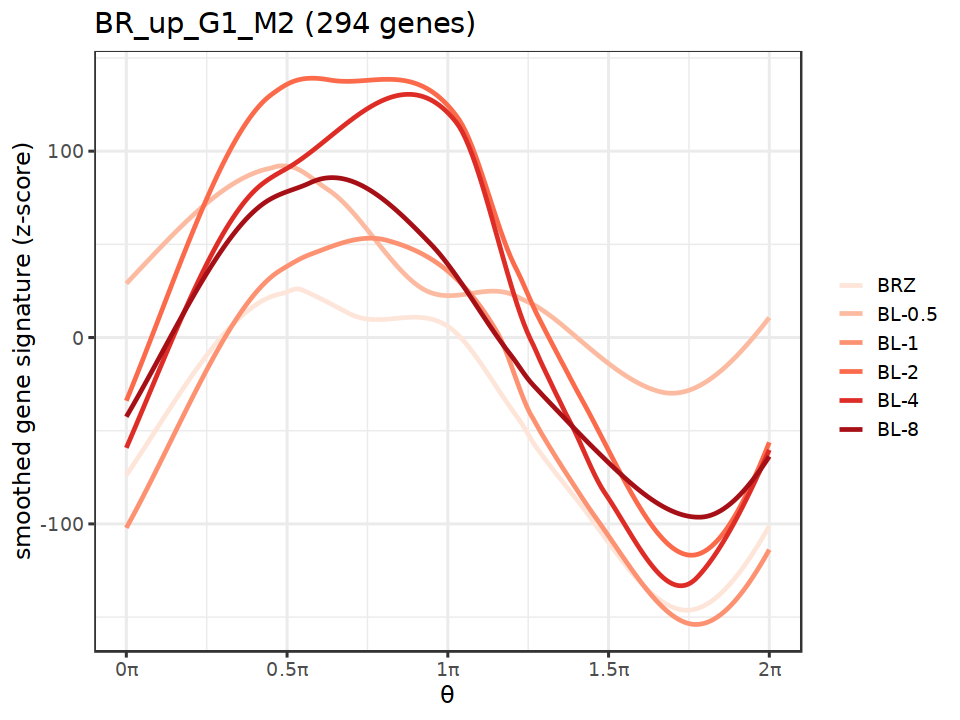

In [61]:
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene signature (z-score)", title = "BR_up_G1_M2 (294 genes)") + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))

In [62]:
grDevices::cairo_pdf("./pdfs/BR_up_G1_M2_294_genes.pdf",width=8, height=6) 
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene signature (z-score)", title = "BR_up_G1_M2 (294 genes)") + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
dev.off()

png 
  2

In [49]:
sce <- as.SingleCellExperiment(BR)

In [51]:
sce$br_time <- sce$treatment
sce$br_time[which(BR$sample %in% c("sc_43","sc_50"))] <- "BRZ"
sce$br_time[which(BR$sample %in% c("sc_44"))] <- "BL-0.5"
sce$br_time[which(BR$sample %in% c("sc_45"))] <- "BL-1"
sce$br_time[which(BR$sample %in% c("sc_46","sc_49"))] <- "BL-2"
sce$br_time[which(BR$sample %in% c("sc_47"))] <- "BL-4"
sce$br_time[which(BR$sample %in% c("sc_48"))] <- "BL-8"

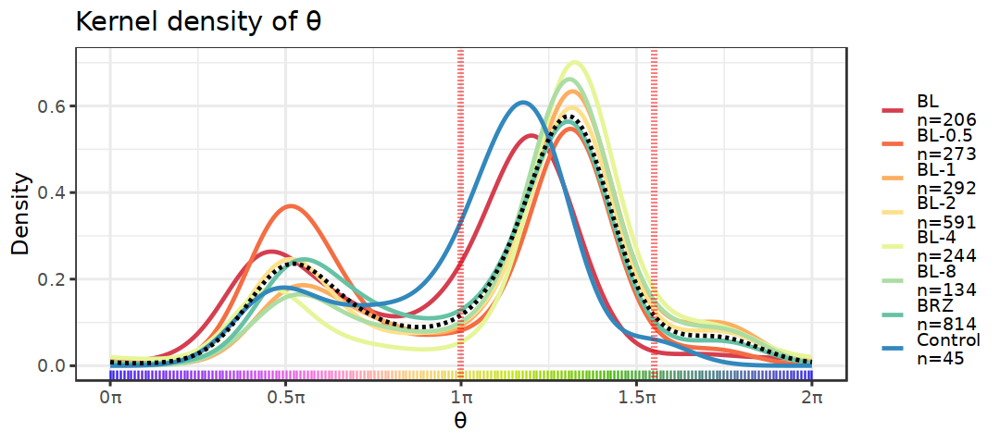

In [57]:
## Plot
options(repr.plot.width=9, repr.plot.height=4)
print(plot_ccposition_den(sce$tricyclePosition * pi,
                sce$br_time, '',
                bw = 10,line.size=1,line.alpha=1, fig.title = "Kernel density of \u03b8", palette.v=colorRampPalette(brewer.pal(8, "Spectral"))(8)) +
  theme_bw(base_size = 14)+ geom_vline(xintercept = 1*pi, linetype="dotted", 
                color = "red", size=1.5)+ geom_vline(xintercept = 1.55*pi, linetype="dotted", 
                color = "red", size=1.5))

## BR time course three time points

In [15]:
fit <- fit %>% filter(treatment %in% c("BRZ","BL-2"))

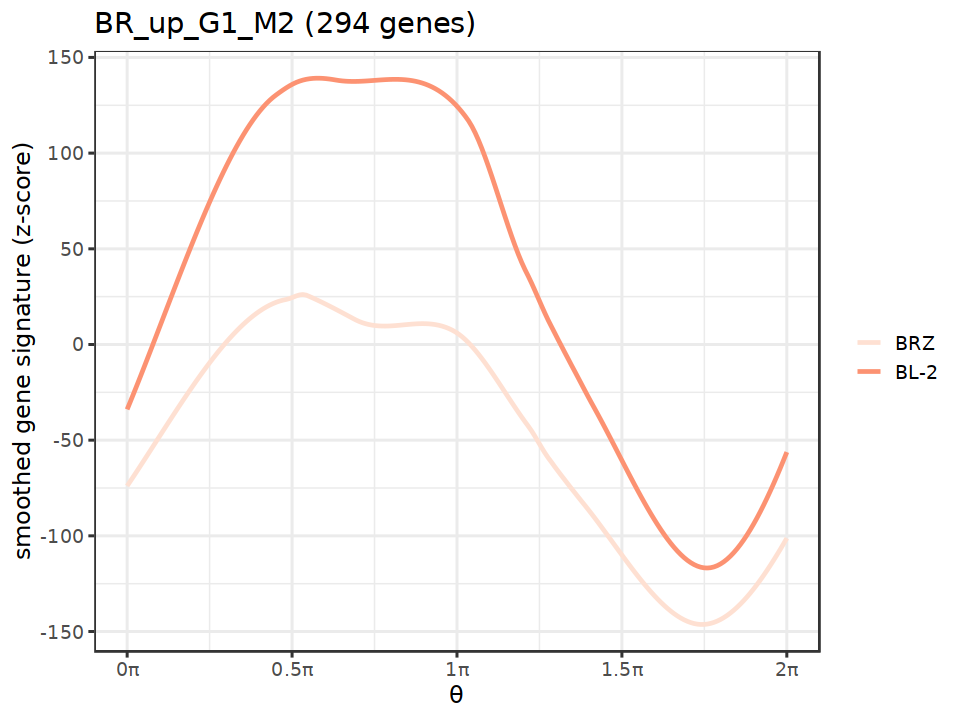

In [16]:
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene signature (z-score)", title = "BR_up_G1_M2 (294 genes)") + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))

#### gene expression

In [83]:
gene.list <- c("AT3G09840","AT3G10525","AT5G04470","AT5G10400","AT5G59690","AT1G54690","AT4G26630","AT3G27060","AT3G20840","AT2G44740","AT2G45080")

In [ ]:
#CYCD3;1 AT4G34160
#CYCP3;1 AT2G45080
#CYCP3;2 AT3G60550
#CYCD3;3 AT3G50070
#CDC48A (AT3G09840)
#SMR1 (AT3G10525)
#SIM (AT5G04470)
#HTR2 (AT5G10400)
#AT5G59690 (S phase marker)
#AT1G54690 (S phase marker)
#DEK3 (AT4G26630)
#TSO2 (AT3G27060)
#PLT1 (AT3G20840)
#CYCU4-1 (AT2G44740)
#CYCP3-1 (AT2G45080) 

In [63]:
pltBR <- function(gene, title){
    s1z_mutant <- BR@assays$SCT@data[which(rownames(BR@assays$SCT@data) == gene),] 
    #s1z_WT <- rc.integrated@assays$SCT@data[which(rownames(rc.integrated@assays$SCT@data) == gene),]
    s1z_BRZ <- s1z_mutant[which(BR$sample %in% c("sc_43","sc_50"))]
    s1z_BL_0.5 <- s1z_mutant[which(BR$sample %in% c("sc_44"))]
    s1z_BL_1 <- s1z_mutant[which(BR$sample %in% c("sc_45"))]
    s1z_BL_2 <- s1z_mutant[which(BR$sample %in% c("sc_46","sc_49"))]
    s1z_BL_4 <- s1z_mutant[which(BR$sample %in% c("sc_47"))]
    s1z_BL_8 <- s1z_mutant[which(BR$sample %in% c("sc_48"))]
    
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[BR$sample %in% c("sc_43","sc_50")],
                            s1z_BRZ,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_44"))],
                            s1z_BL_0.5,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_45"))],
                            s1z_BL_1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_46","sc_49"))],
                            s1z_BL_2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_47"))],
                            s1z_BL_4,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_48"))],
                            s1z_BL_8,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
#    fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi),
#                            s1z_WT,
#                            plot = FALSE, span=0.3,
#                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

#    fit <- rbind(fit, fit.l$pred.df)
#    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200),rep("WT", 200)), levels=c("WT","BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200)), levels=c("BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = title) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
    
    fit <- fit %>% filter(treatment %in% c("WT","BRZ","BL-2"))
    
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = title) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
    
    

}

In [64]:
pltBR <- function(gene, title){
    s1z_mutant <- BR@assays$SCT@data[which(rownames(BR@assays$SCT@data) == gene),] 
    #s1z_WT <- rc.integrated@assays$SCT@data[which(rownames(rc.integrated@assays$SCT@data) == gene),]
    s1z_BRZ <- s1z_mutant[which(BR$sample %in% c("sc_43","sc_50"))]
    s1z_BL_0.5 <- s1z_mutant[which(BR$sample %in% c("sc_44"))]
    s1z_BL_1 <- s1z_mutant[which(BR$sample %in% c("sc_45"))]
    s1z_BL_2 <- s1z_mutant[which(BR$sample %in% c("sc_46","sc_49"))]
    s1z_BL_4 <- s1z_mutant[which(BR$sample %in% c("sc_47"))]
    s1z_BL_8 <- s1z_mutant[which(BR$sample %in% c("sc_48"))]
    
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[BR$sample %in% c("sc_43","sc_50")],
                            s1z_BRZ,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_44"))],
                            s1z_BL_0.5,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_45"))],
                            s1z_BL_1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_46","sc_49"))],
                            s1z_BL_2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_47"))],
                            s1z_BL_4,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_48"))],
                            s1z_BL_8,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
#    fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi),
#                            s1z_WT,
#                            plot = FALSE, span=0.3,
#                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

#    fit <- rbind(fit, fit.l$pred.df)
#    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200),rep("WT", 200)), levels=c("WT","BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200)), levels=c("BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = title) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
 }   

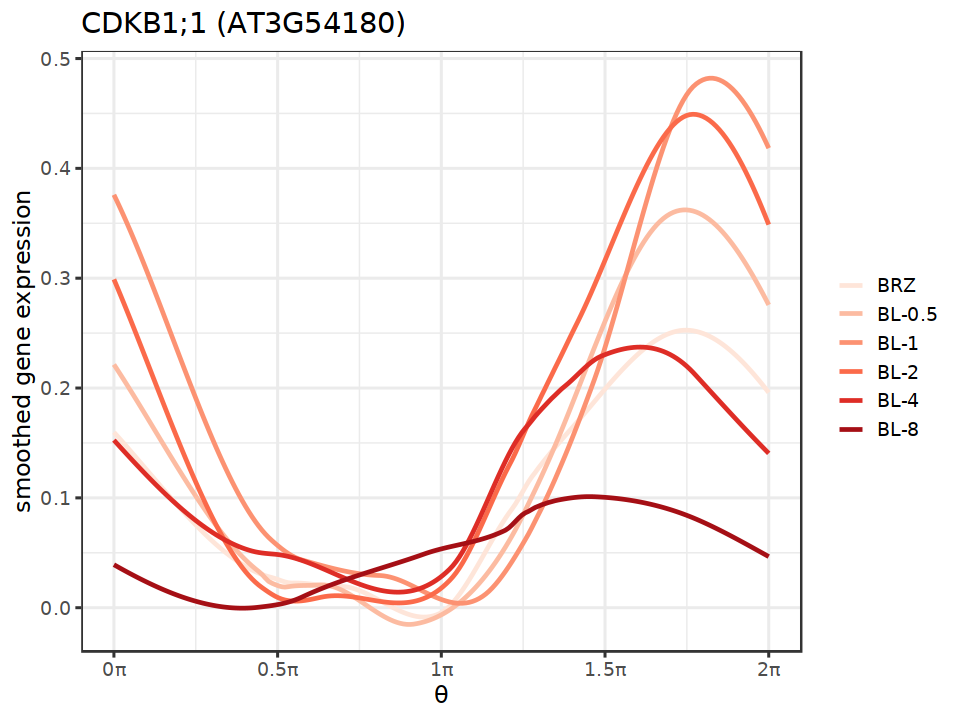

In [65]:
pltBR("AT3G54180", "CDKB1;1 (AT3G54180)")

In [66]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CDKB1;1.pdf",width=8, height=8) 
pltBR("AT3G54180", "CDKB1;1 (AT3G54180)")
dev.off()

png 
  2

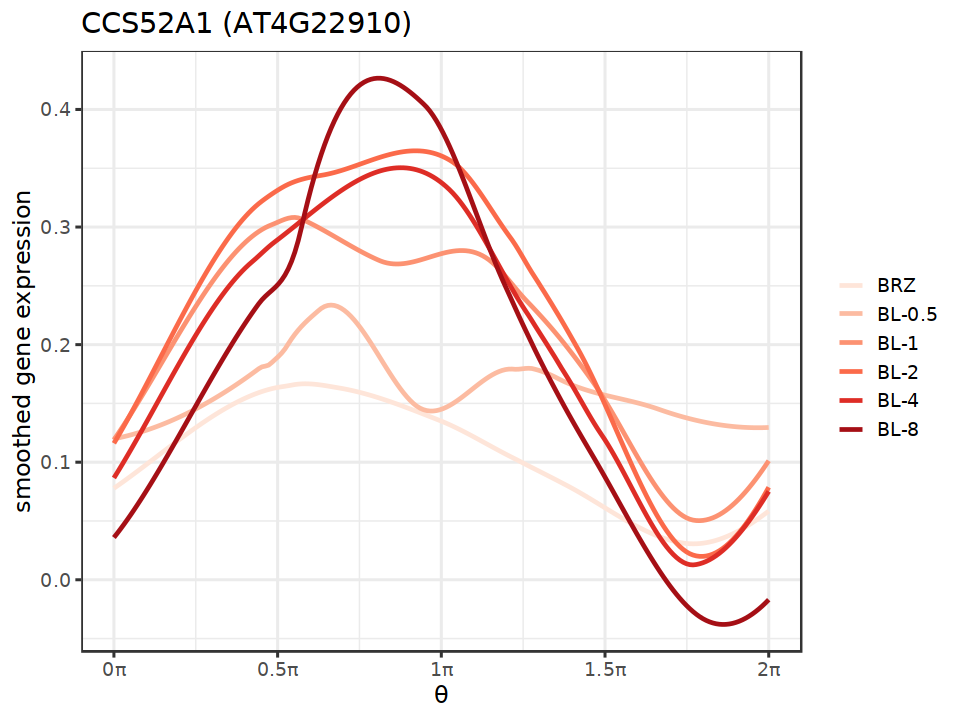

In [67]:
pltBR("AT4G22910", "CCS52A1 (AT4G22910)")

In [68]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CCS52A1.pdf",width=8, height=8) 
pltBR("AT4G22910", "CCS52A1 (AT4G22910)")
dev.off()

png 
  2

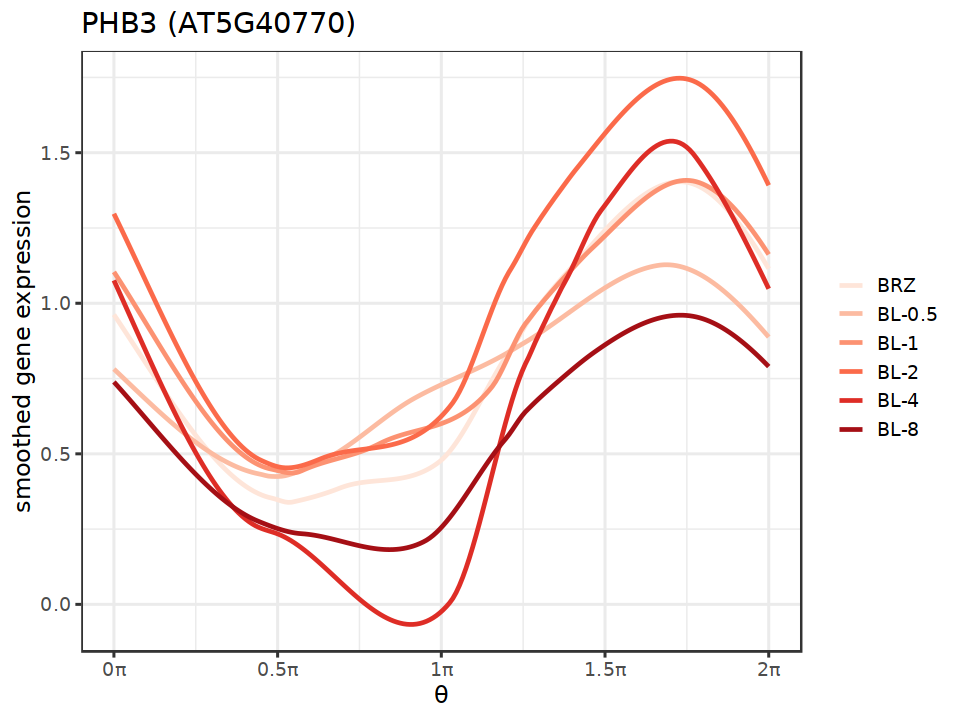

In [106]:
pltBR("AT5G40770", "PHB3 (AT5G40770)")

In [107]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_PHB3.pdf",width=8, height=8) 
pltBR("AT5G40770", "PHB3 (AT5G40770)")
dev.off()

png 
  2

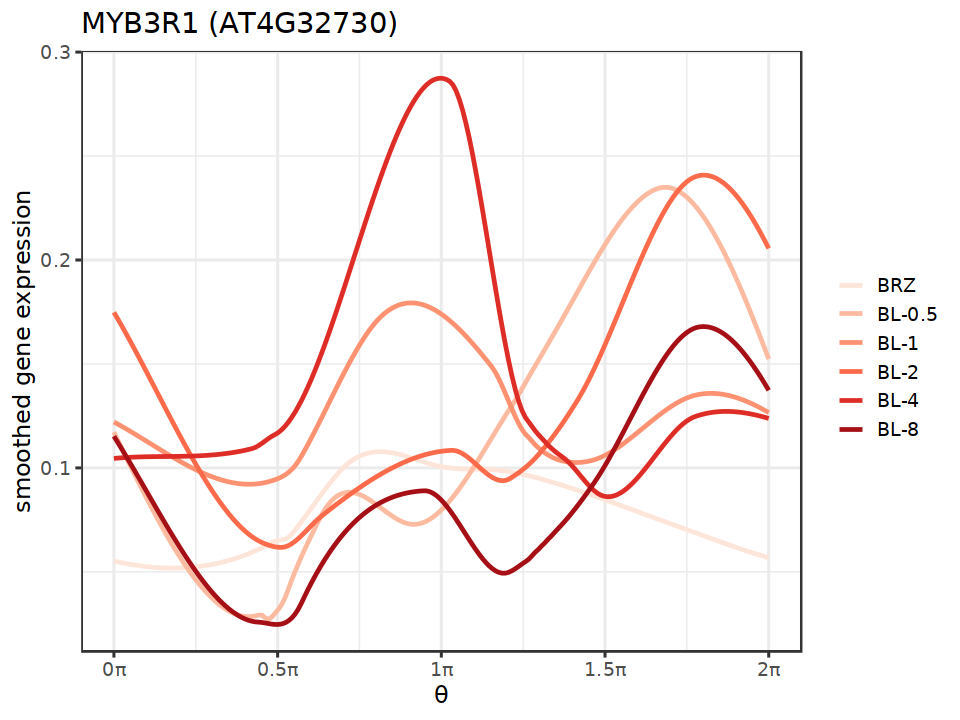

In [87]:
pltBR("AT4G32730", "MYB3R1 (AT4G32730)")

In [88]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_MYB3R1.pdf",width=8, height=8) 
pltBR("AT4G32730", "MYB3R1 (AT4G32730)")
dev.off()

png 
  2

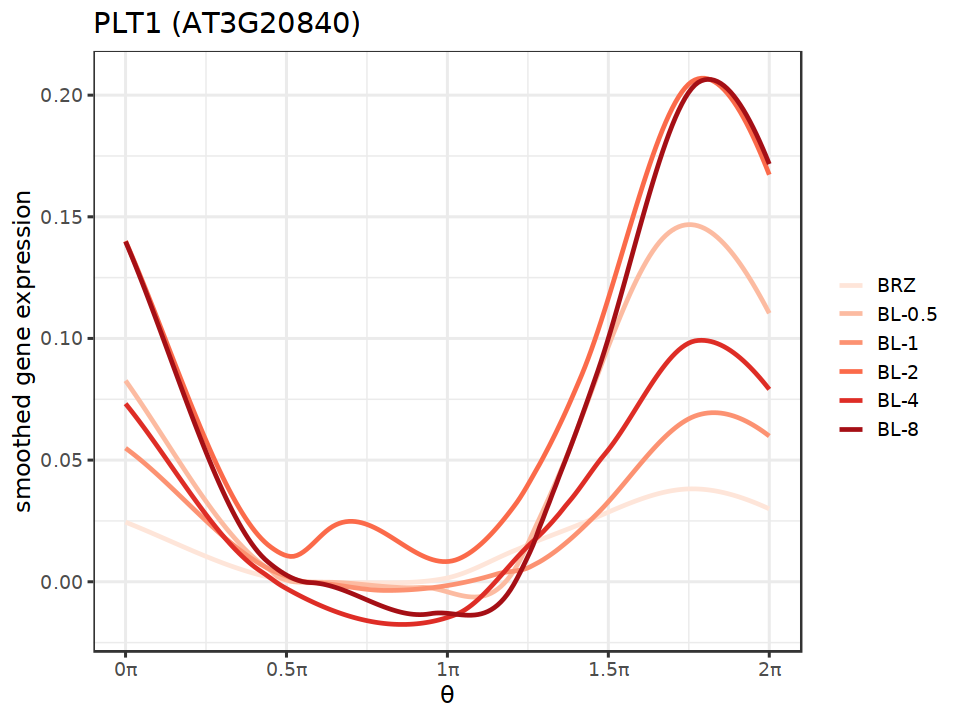

In [89]:
pltBR("AT3G20840", "PLT1 (AT3G20840)")

In [90]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_PLT1.pdf",width=8, height=8) 
pltBR("AT3G20840", "PLT1 (AT3G20840)")
dev.off()

png 
  2

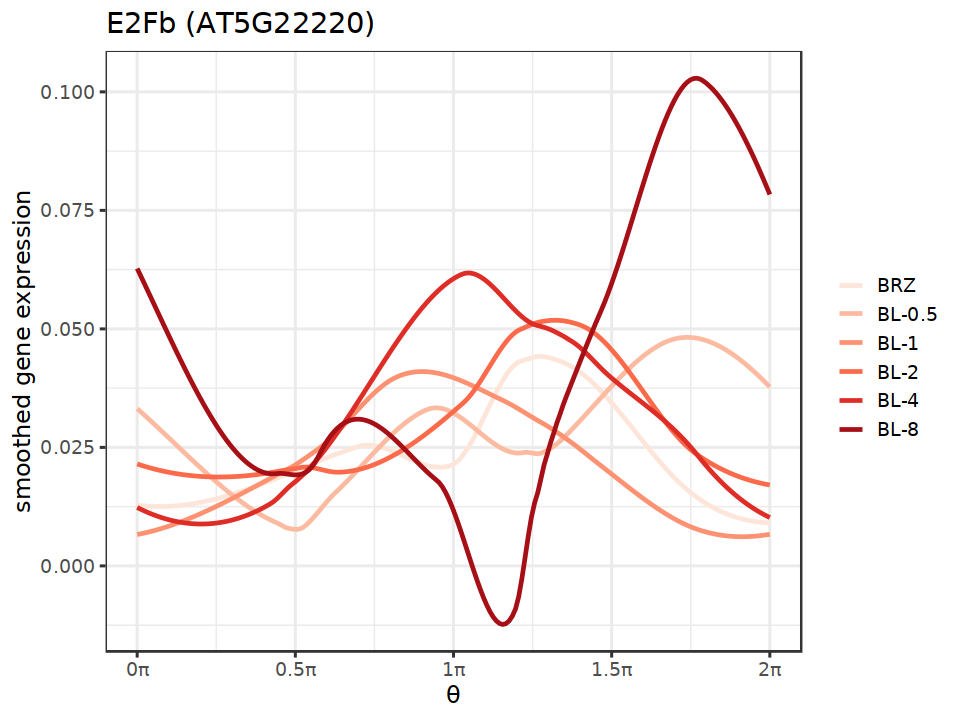

In [91]:
pltBR("AT5G22220", "E2Fb (AT5G22220)")

In [92]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_E2Fb.pdf",width=8, height=8) 
pltBR("AT5G22220", "E2Fb (AT5G22220)")
dev.off()

png 
  2

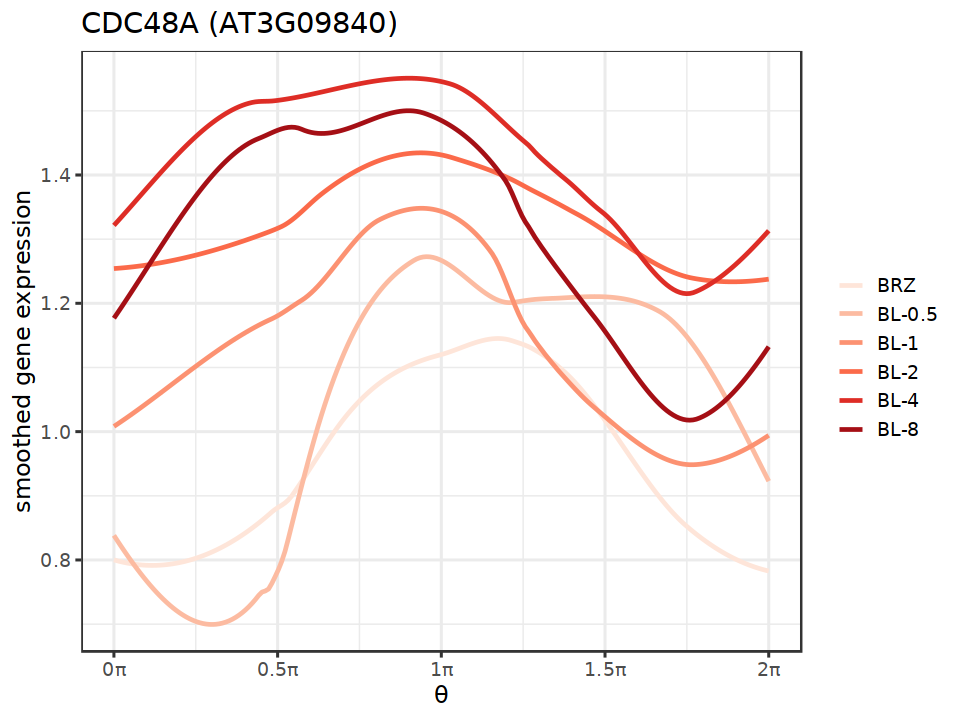

In [93]:
pltBR("AT3G09840", "CDC48A (AT3G09840)")

In [94]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CDC48A.pdf",width=8, height=8) 
pltBR("AT3G09840", "CDC48A (AT3G09840)")
dev.off()

png 
  2

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”


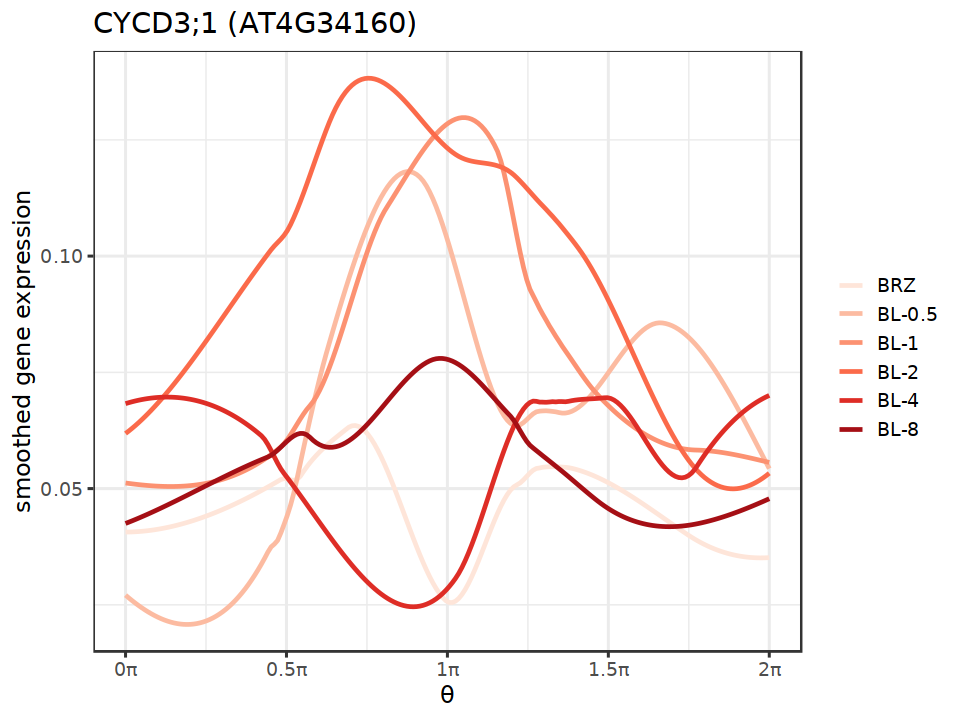

In [86]:
pltBR("AT4G34160", "CYCD3;1 (AT4G34160)")

In [42]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CYCD3_1.pdf",width=8, height=8) 
pltBR("AT4G34160", "CYCD3;1 (AT4G34160)")
dev.off()

png 
  2

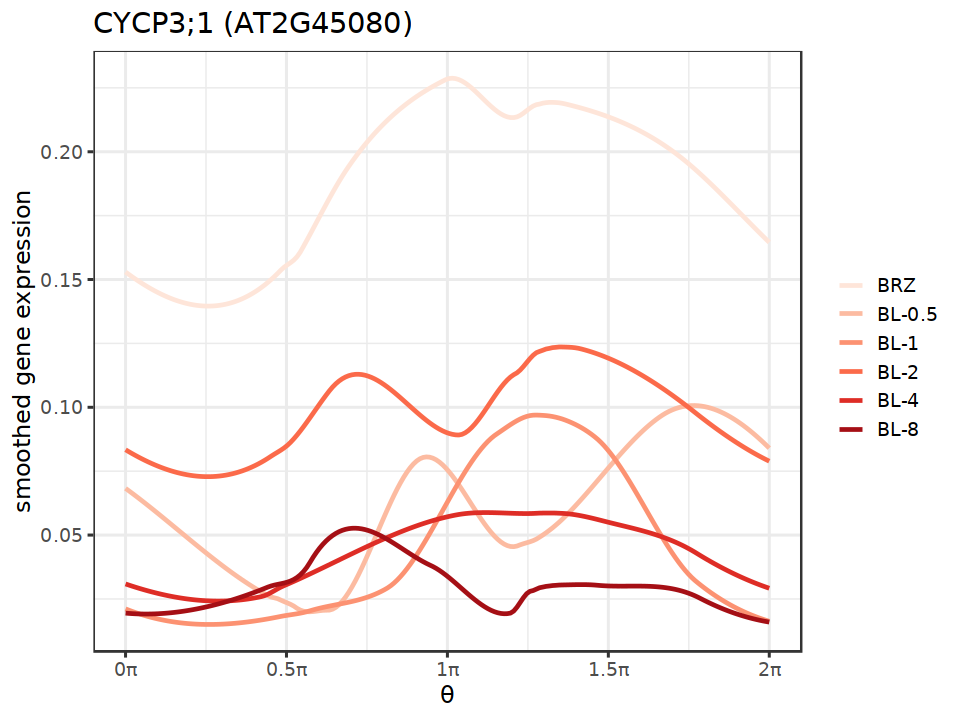

In [43]:
pltBR("AT2G45080", "CYCP3;1 (AT2G45080)")

In [44]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CYCP3_1.pdf",width=8, height=8) 
pltBR("AT2G45080", "CYCP3;1 (AT2G45080)")
dev.off()

png 
  2

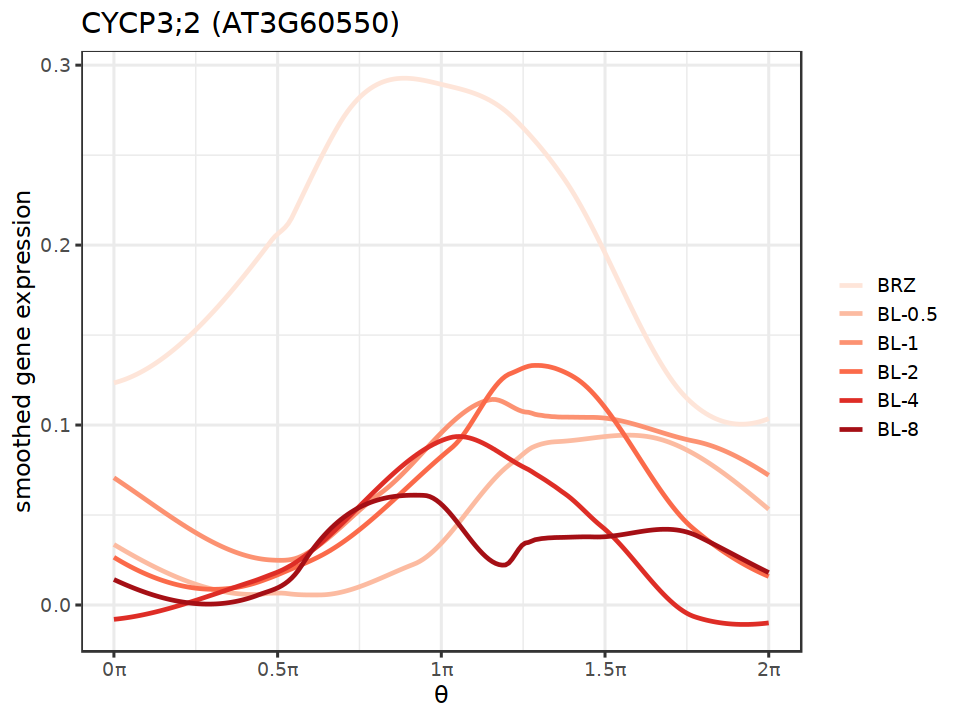

In [45]:
pltBR("AT3G60550", "CYCP3;2 (AT3G60550)")

In [46]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CYCP3_2.pdf",width=8, height=8) 
pltBR("AT3G60550", "CYCP3;2 (AT3G60550)")
dev.off()

png 
  2

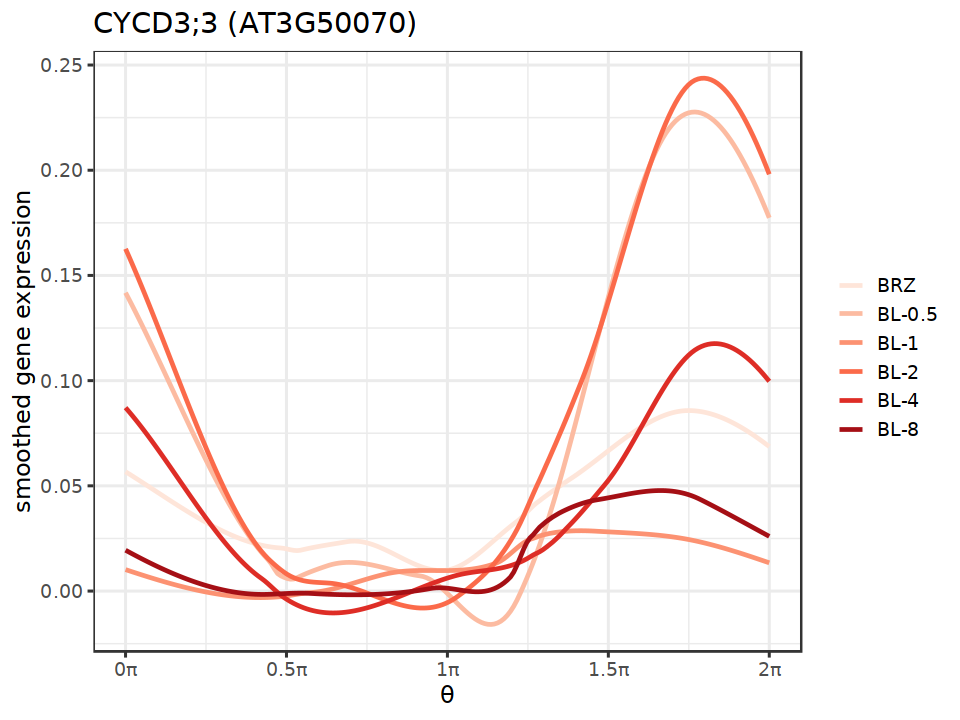

In [47]:
pltBR("AT3G50070", "CYCD3;3 (AT3G50070)")

In [48]:
grDevices::cairo_pdf("./pdfs/BR_timecourse_CYCD3_3.pdf",width=8, height=8) 
pltBR("AT3G50070", "CYCD3;3 (AT3G50070)")
dev.off()

png 
  2

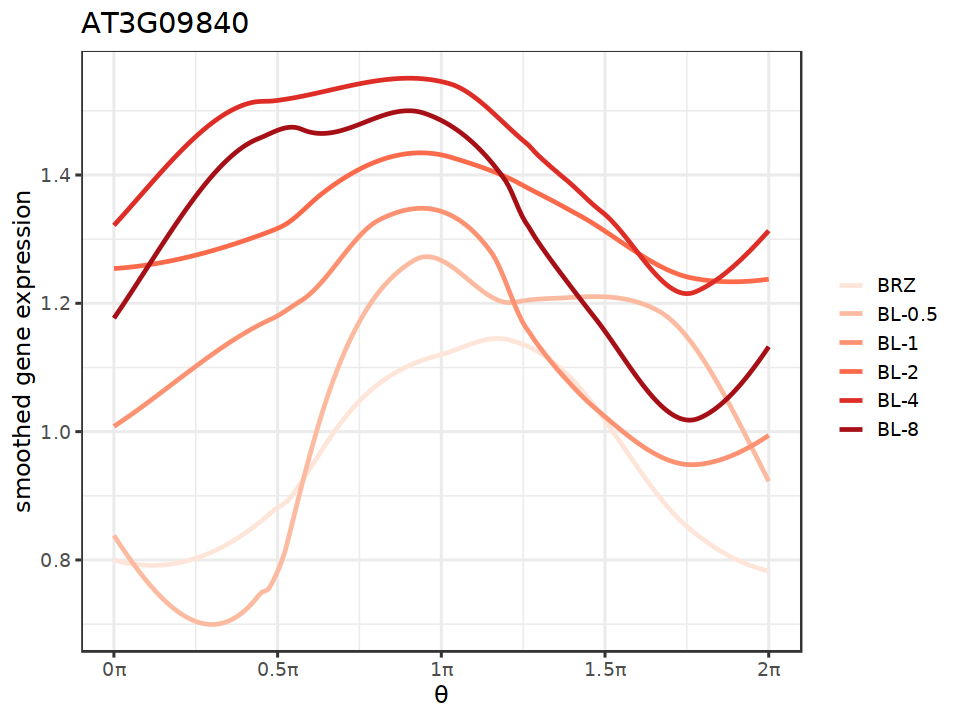

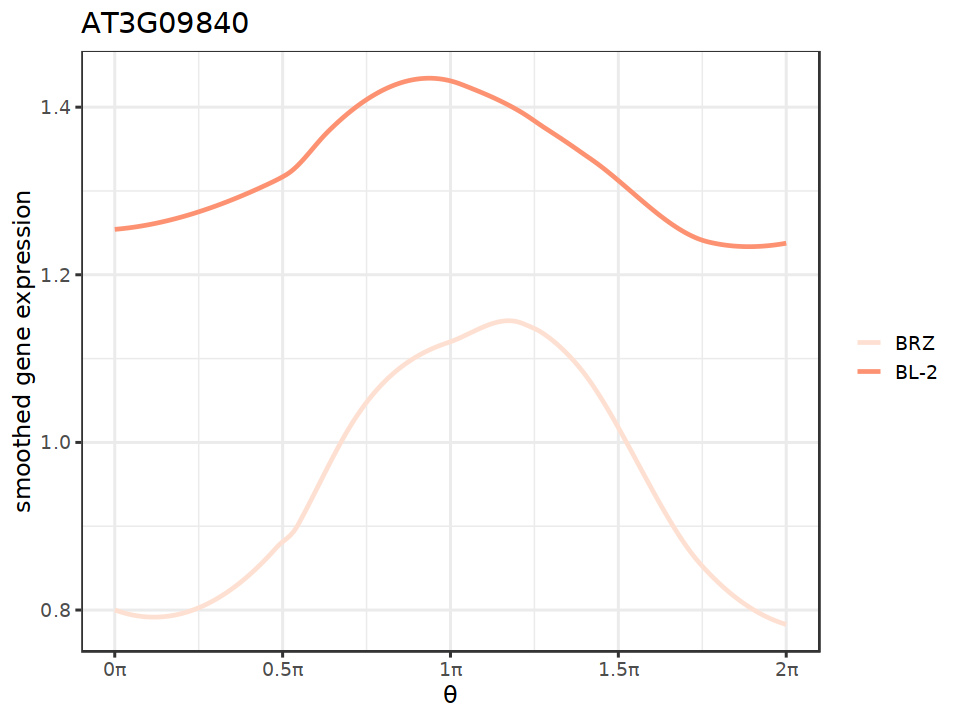

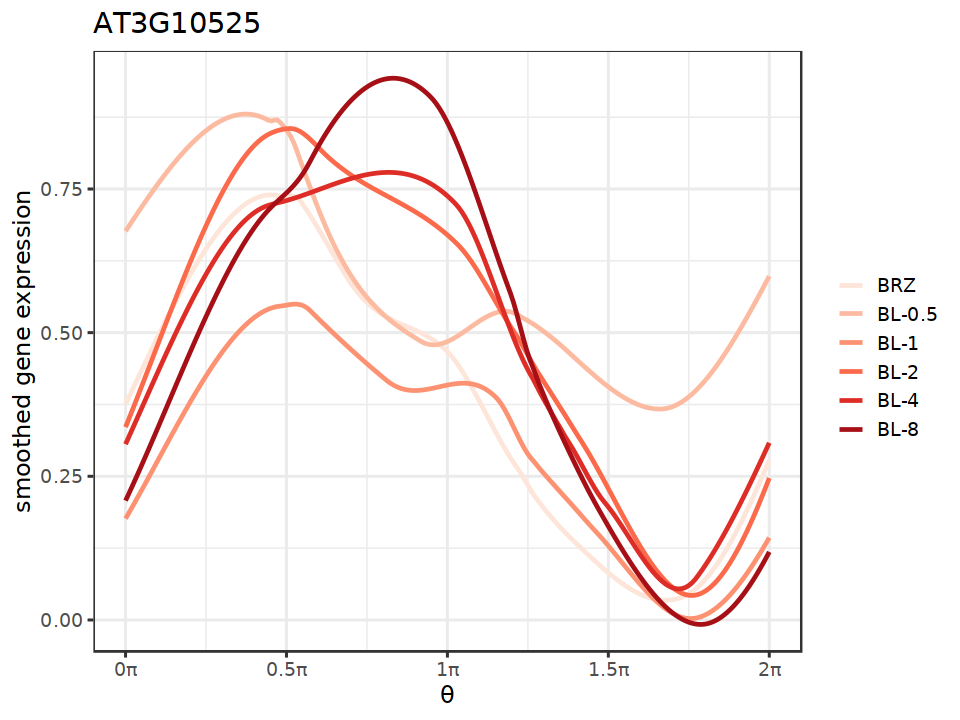

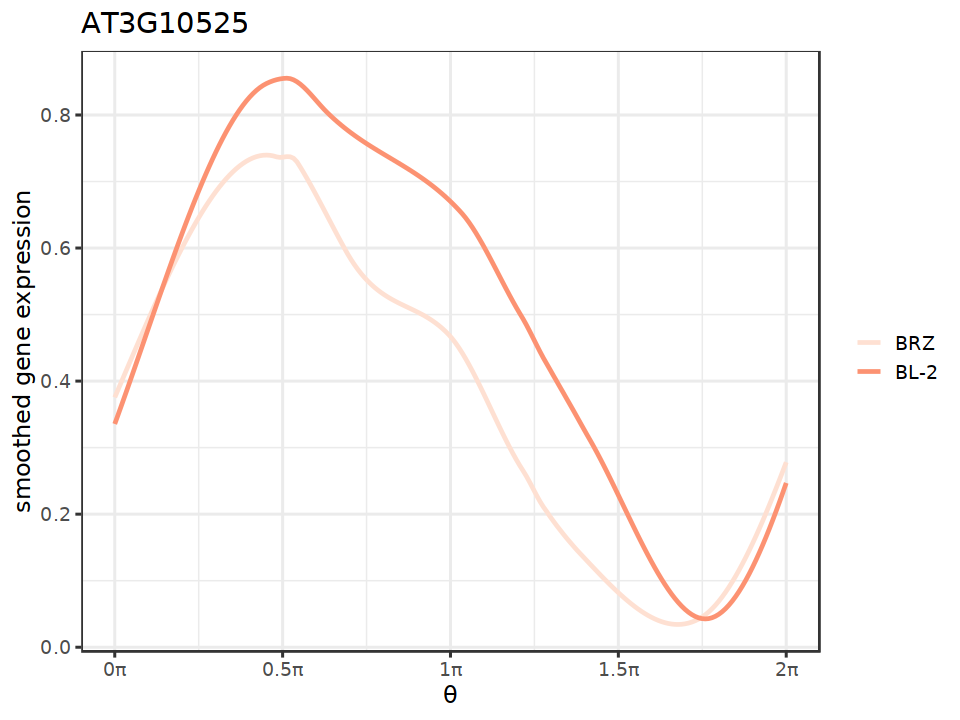

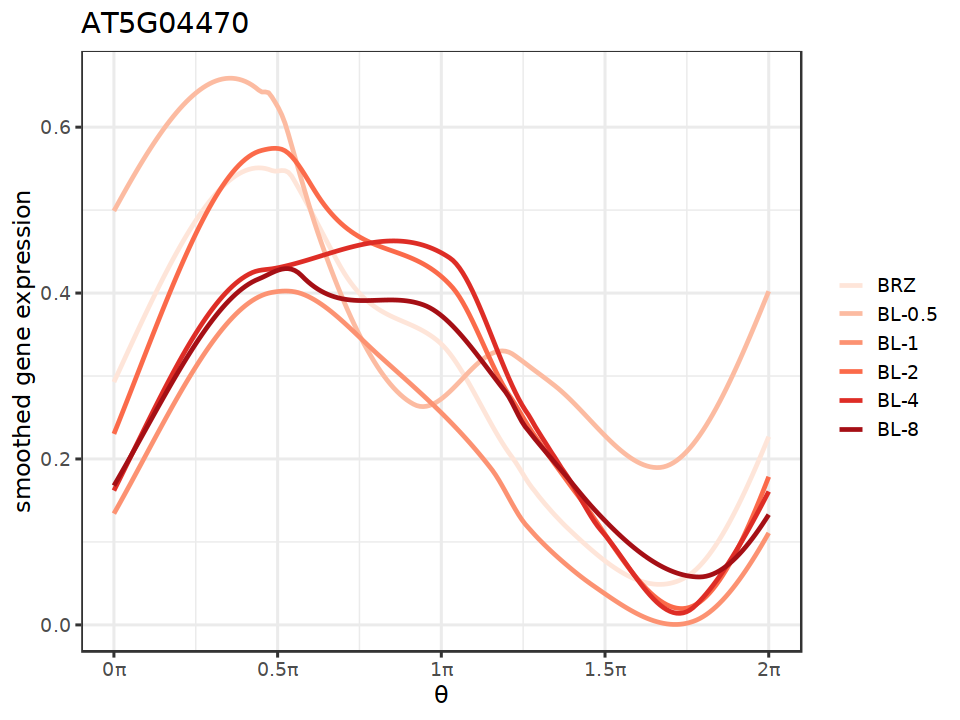

...

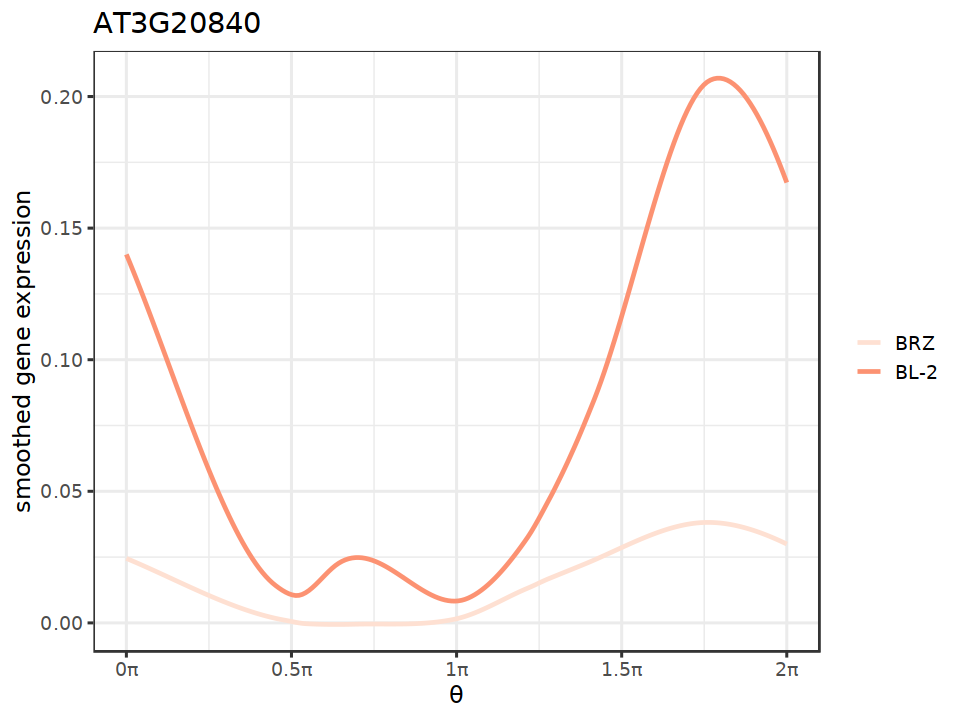

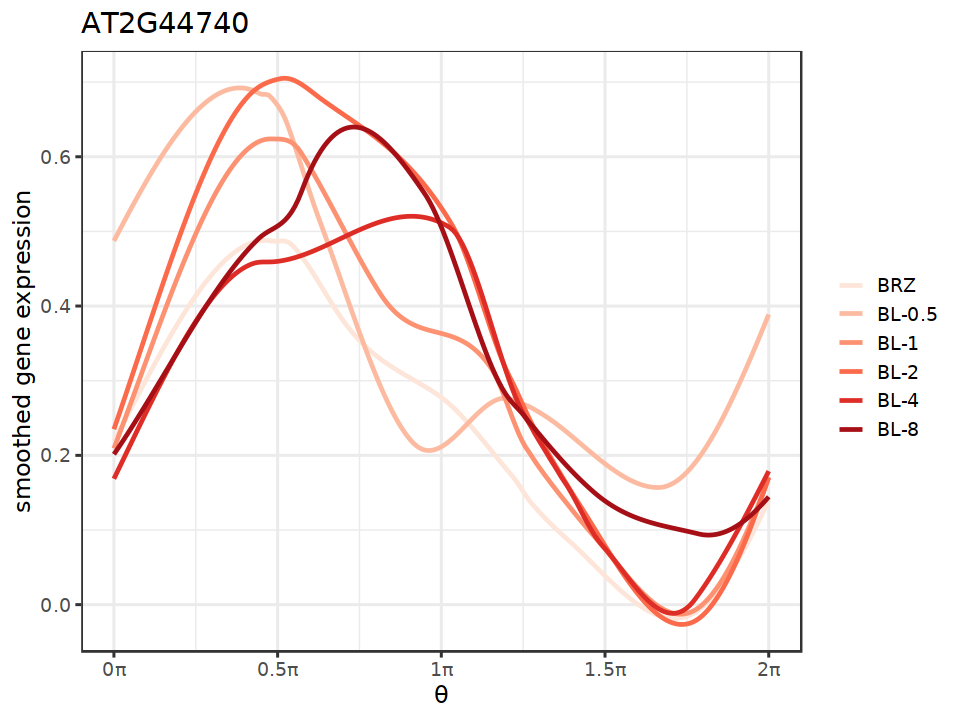

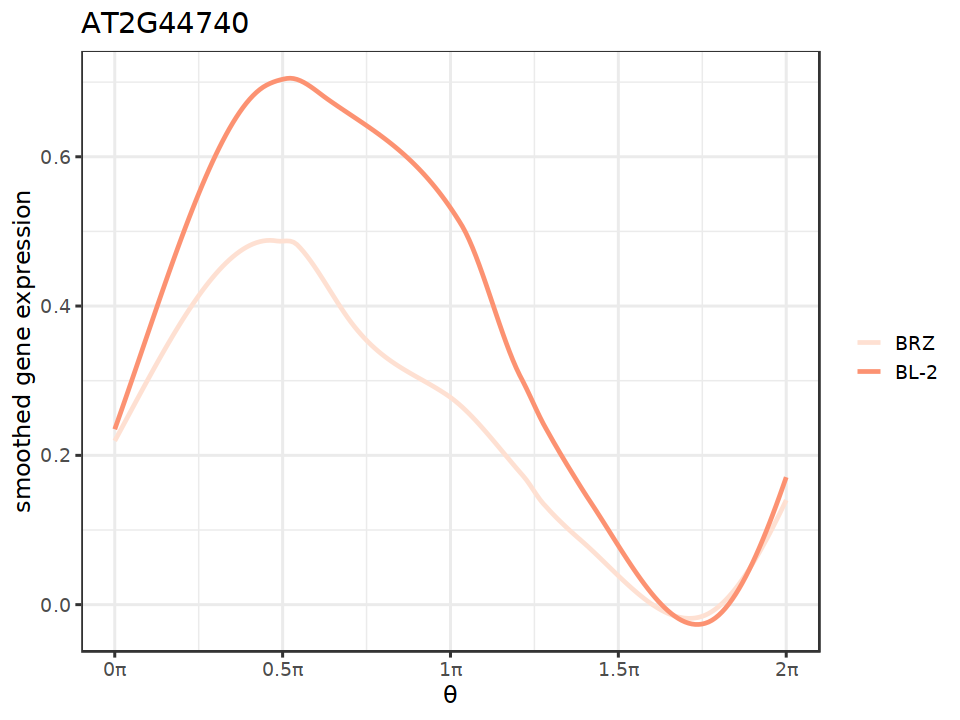

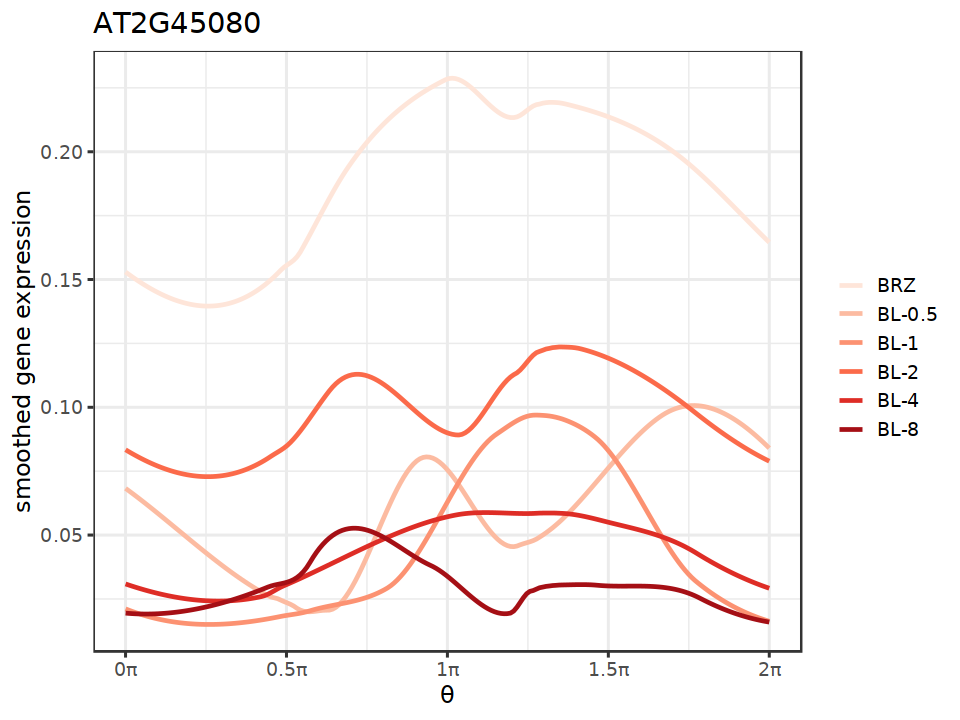

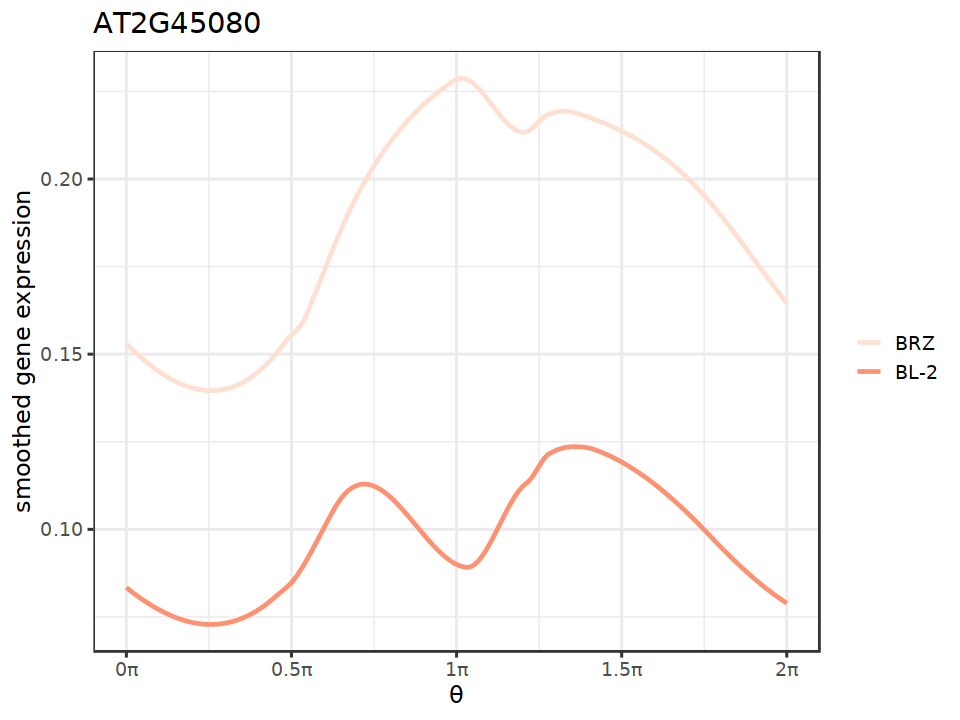

In [19]:
for (gene in gene.list){
 pltBR(gene)
} 

## Core CC genes in BR time course

In [20]:
pltBR <- function(gene, name){
    s1z_mutant <- BR@assays$SCT@data[which(rownames(BR@assays$SCT@data) == gene),] 
    #s1z_WT <- rc.integrated@assays$SCT@data[which(rownames(rc.integrated@assays$SCT@data) == gene),]
    s1z_BRZ <- s1z_mutant[which(BR$sample %in% c("sc_43","sc_50"))]
    s1z_BL_0.5 <- s1z_mutant[which(BR$sample %in% c("sc_44"))]
    s1z_BL_1 <- s1z_mutant[which(BR$sample %in% c("sc_45"))]
    s1z_BL_2 <- s1z_mutant[which(BR$sample %in% c("sc_46","sc_49"))]
    s1z_BL_4 <- s1z_mutant[which(BR$sample %in% c("sc_47"))]
    s1z_BL_8 <- s1z_mutant[which(BR$sample %in% c("sc_48"))]
    
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[BR$sample %in% c("sc_43","sc_50")],
                            s1z_BRZ,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")
    fit <- fit.l$pred.df
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_44"))],
                            s1z_BL_0.5,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_45"))],
                            s1z_BL_1,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_46","sc_49"))],
                            s1z_BL_2,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_47"))],
                            s1z_BL_4,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
    fit.l <- fit_periodic_loess((BR$tricyclePosition*pi)[which(BR$sample %in% c("sc_48"))],
                            s1z_BL_8,
                            plot = FALSE, span=0.3,
                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

    fit <- rbind(fit, fit.l$pred.df)
#    fit.l <- fit_periodic_loess((rc.integrated$tricyclePosition*pi),
#                            s1z_WT,
#                            plot = FALSE, span=0.3,
#                       x_lab = "Cell cycle position \u03b8", y_lab = "log2(keygene)")

#    fit <- rbind(fit, fit.l$pred.df)
#    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200),rep("WT", 200)), levels=c("WT","BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))
    fit$treatment <- factor(c(rep("BRZ", 200),rep("BL-0.5", 200),rep("BL-1", 200),rep("BL-2", 200),rep("BL-4", 200),rep("BL-8", 200)), levels=c("BRZ", "BL-0.5", "BL-1", "BL-2","BL-4","BL-8"))    
    options(repr.plot.width=8, repr.plot.height=6)
    print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = name) + 
                scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
                    pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
                    0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
      scale_color_brewer(palette="Reds")+
      theme_bw(base_size = 14)+
      theme(legend.title=element_blank()))
    
    #fit <- fit %>% filter(treatment %in% c("WT","BRZ","BL-2"))
    
    #options(repr.plot.width=8, repr.plot.height=6)
    #print(ggplot(fit, aes(x=x,y=y, color=treatment)) + geom_path(size = 1, alpha = 1)+ labs(x = "θ", y = "smoothed gene expression", title = name) + 
    #            scale_x_continuous(limits = c(0, 2 * pi), breaks = c(0, 
    #                pi/2, pi, 3 * pi/2, 2 * pi), labels = paste0(c(0, 
    #                0.5, 1, 1.5, 2), "π"), name = "θ")+
      #              scale_x_continuous(limits = c(0, 200), breaks = c(0, 
      #              50, 100, 150, 200), labels = paste0(c(0, 
      #              0.5, 1, 1.5, 2), "π"), name = "θ")+
          
    #  scale_color_brewer(palette="Reds")+
    #  theme_bw(base_size = 14)+
    #  theme(legend.title=element_blank()))
}

In [21]:
core <- read.csv('./tradeseq/Core_CC_Genes.csv')

In [22]:
## Remove genes that were not captured by scRNA-seq
core_br <- core[core$GeneID %in% rownames(BR@assays$SCT@data),]

In [23]:
core_br$GeneName

[1] "CDKA;1"         "CDKB1;1"        "CDKB1;2"        "CDKB2;1"       
  [5] "CDKB2;2"        "CDKC;1"         "CDKC;2"         "CDKD;1"        
  [9] "CDKD;2"         "CDKD;3"         "CDKE;1"         "CDKF;1"        
 [13] "CDKG;1"         "CDKG;2"         "CDKL;1"         "CDKL;2"        
 [17] "CDKL;3"         "CDKL;4"         "CDKL;5"         "CDKL;6"        
 [21] "CDKL;7"         "CDKL;8"         "CDKL;9"         "CDKL;10"       
 [25] "CDKL;11"        "CDKL;12"        "CDKL;13"        "CDKL;14"       
 [29] "CDKL;15"        "CYCA1;1"        "CYCA1;2"        "CYCA2;1"       
 [33] "CYCA2;2"        "CYCA2;3"        "CYCA2;4"        "CYCA3;1"       
 [37] "CYCA3;2"        "CYCA3;4"        "CYCB1;1"        "CYCB1;2"       
 [41] "CYCB1;3"        "CYCB1;4"        "CYCB1;5"        "CYCB2;1"       
 [45] "CYCB2;2"        "CYCB2;3"        "CYCB2;4"        "CYCB2;5"       
 [49] "CYCB3;1"        "CYCC1;1"        "CYCC1;2"        "CYCD1;1"       
 [53] "CYCD2;1"        "CYCD3;1"        "CYCD3;2"        "CYCD3;3"       
 [57] "CYCD4;1"        "CYCD4;2"        "CYCD5;1"        "CYCD6;1"       
 [61] "CYCH;1"         "CYCL1;1"        "CYCP1;1"        "CYCP3;1"       
 [65] "CYCP3;2"        "CYCP4;1"        "CYCP4;2"        "CYCP4;3"       
 [69] "CYCQ1;1"        "CYCT1;2"        "CYCT1;3"        "CYCT1;4"       
 [73] "CYCT1;5"        "SDS"            "WEE1"           "E2Fa"          
 [77] "E2Fb"           "E2Fc"           "E2Fe/DEL1"      "E2Fd/DEL2"     
 [81] "E2Ff/DEL3"      "DPa"            "DPb"            "RBR"           
 [85] "KRP1/ICK1"      "KRP2/ICK2"      "KRP3/ICK6"      "KRP4/ICK7"     
 [89] "KRP5/ICK3"      "KRP6/ICK4"      "KRP7/ICK5"      "SIM"           
 [93] "SMR1"           "SMR2"           "SMR3"           "SMR4"          
 [97] "SMR6"           "SMR7"           "SMR8"           "SMR9"          
[101] "SMR10"          "SMR11"          "SMR12"          "MYB3R1"        
[105] "MYB3R2"         "MYB3R3"         "MYB3R4"         "MYB3R5"        
[109] "FBL17"          "SKP2A/SKP2\n;1" "SKP2B/SKP2\n;2" "CCS52A1"       
[113] "CCS52A2"        "CCS52B"         "CDC20.1"        "CDC20.2"       
[117] "UVI4"           "GIG1"

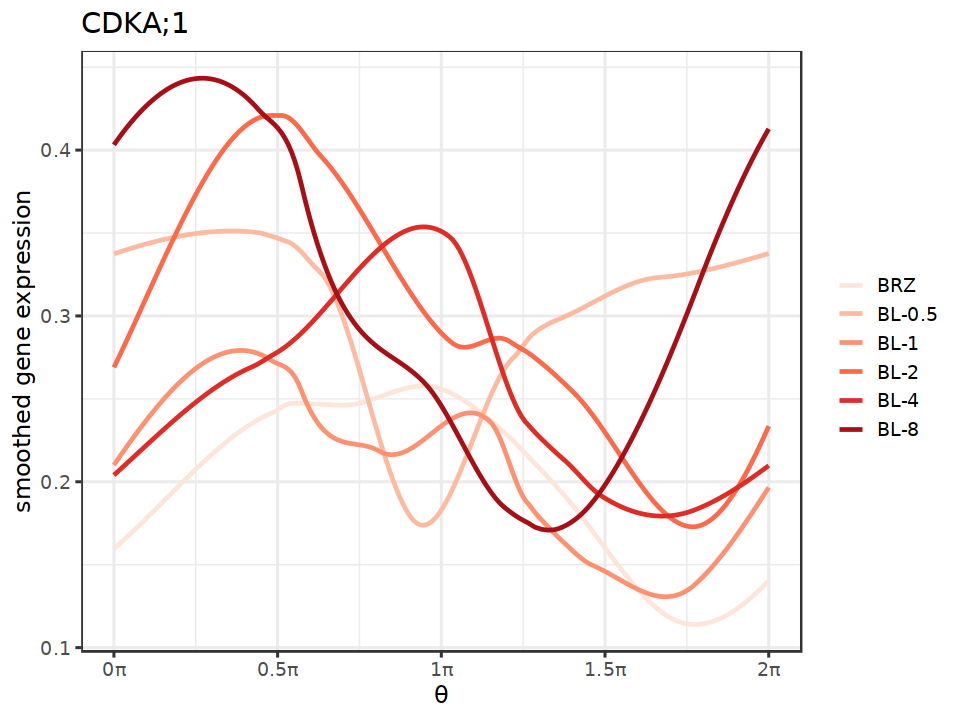

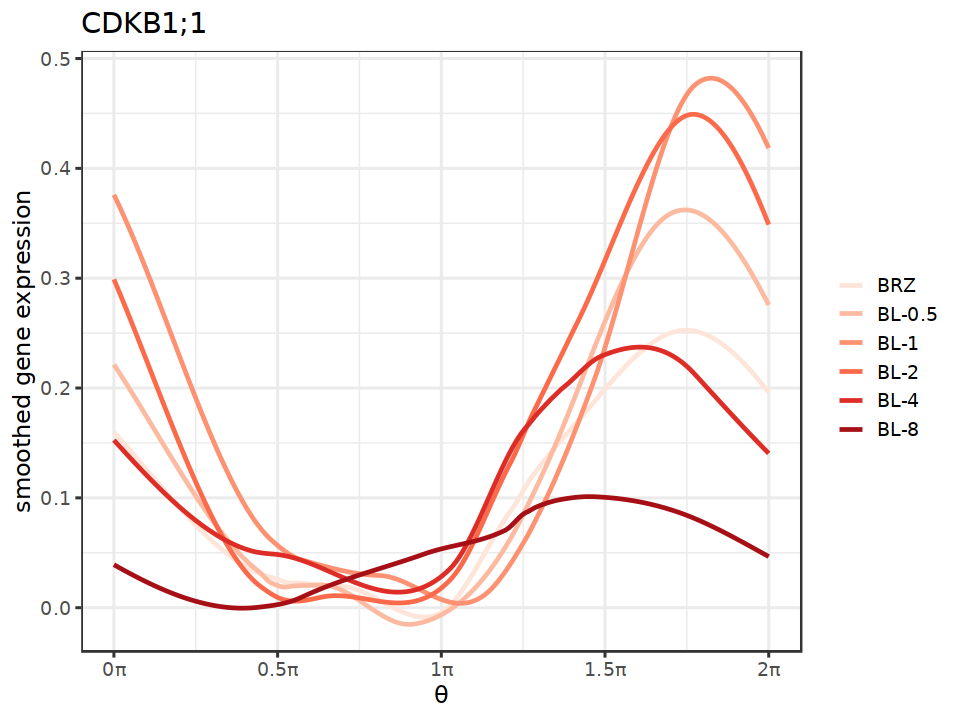

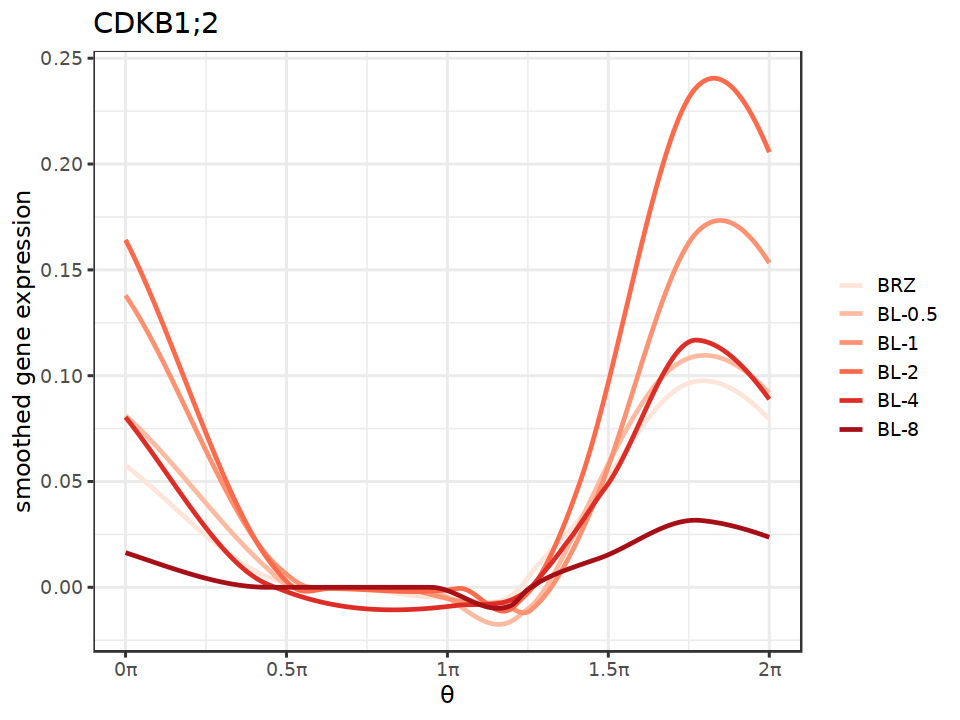

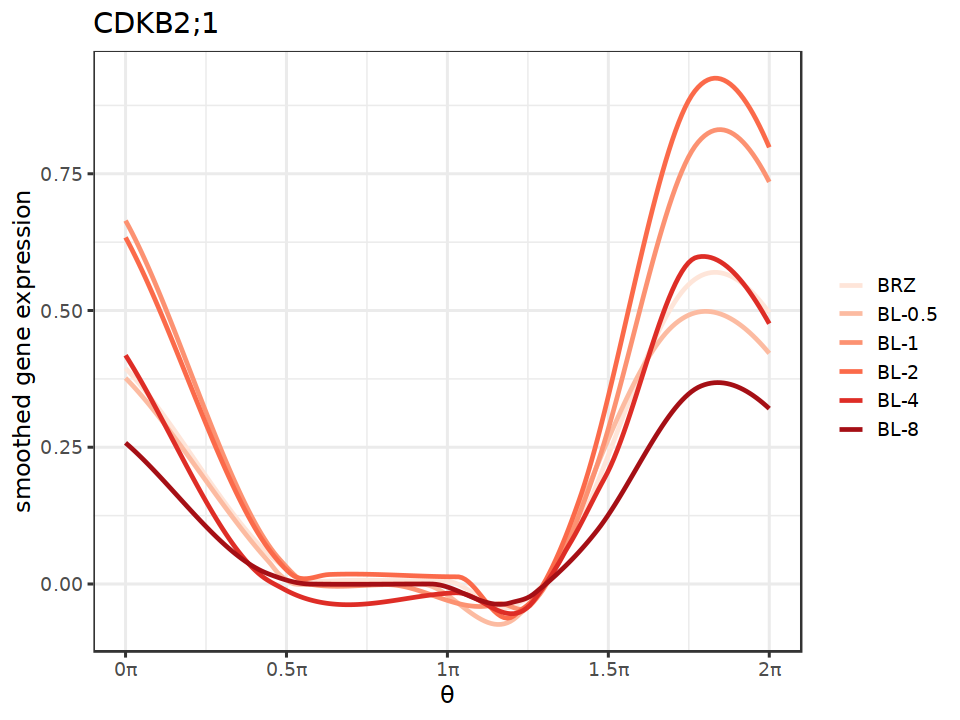

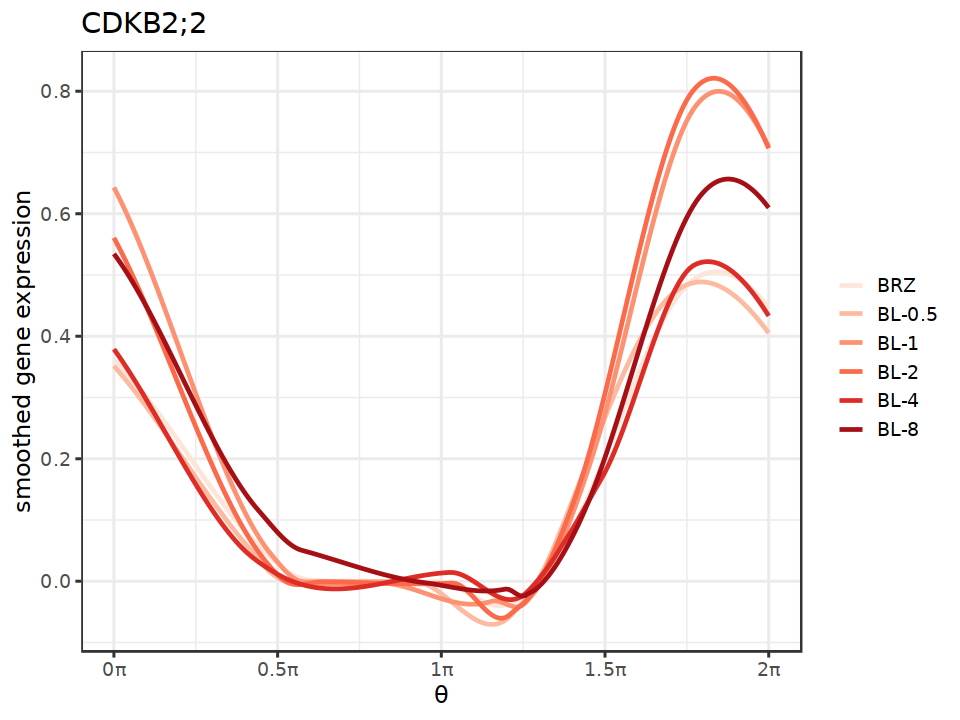

...

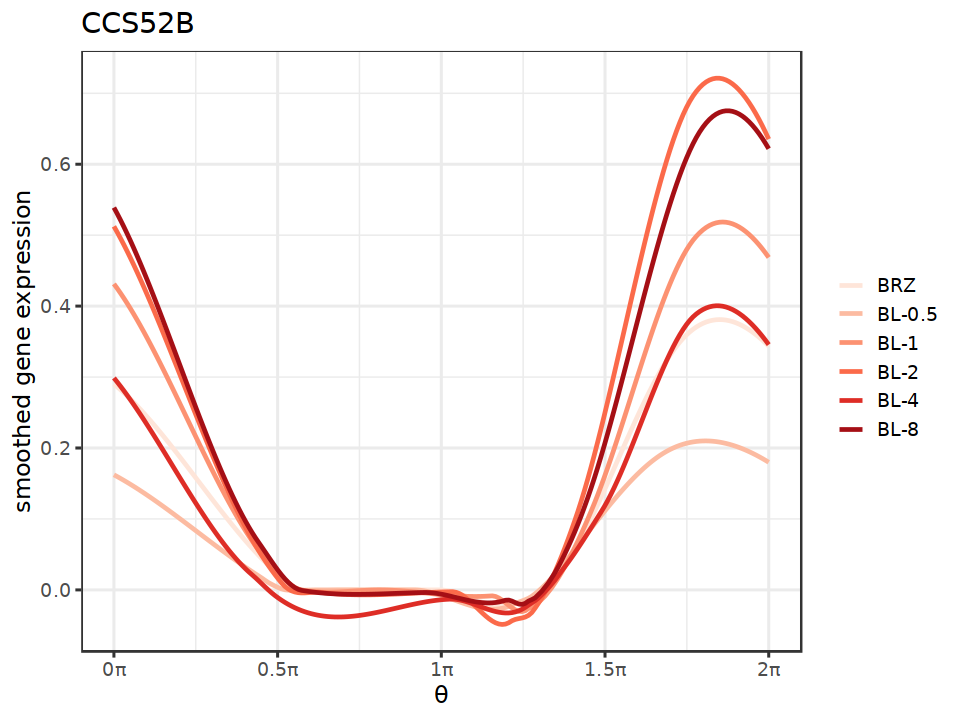

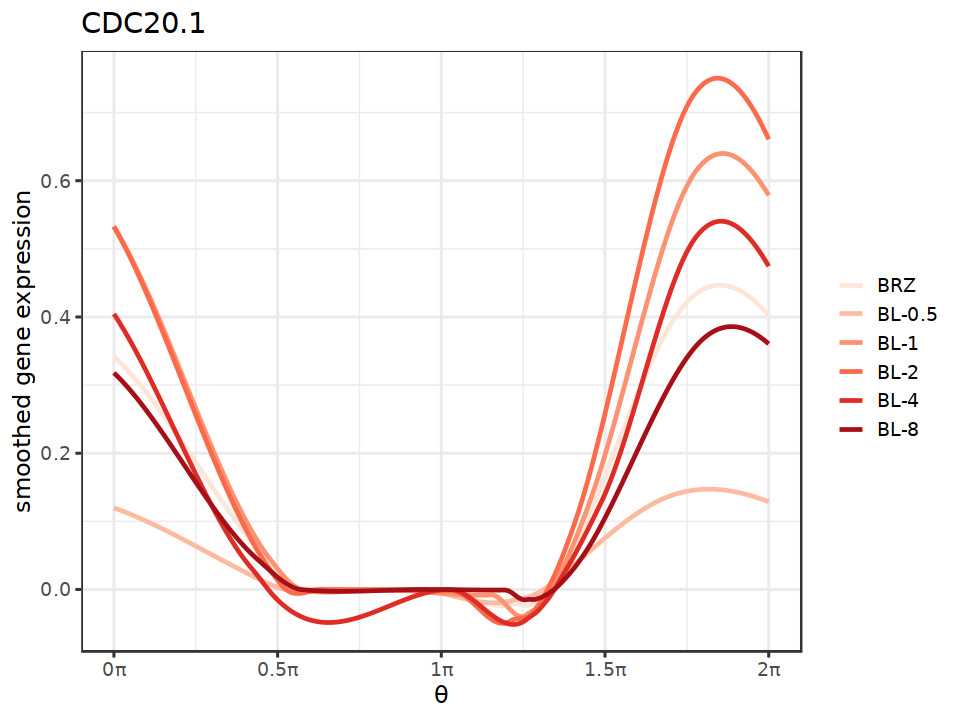

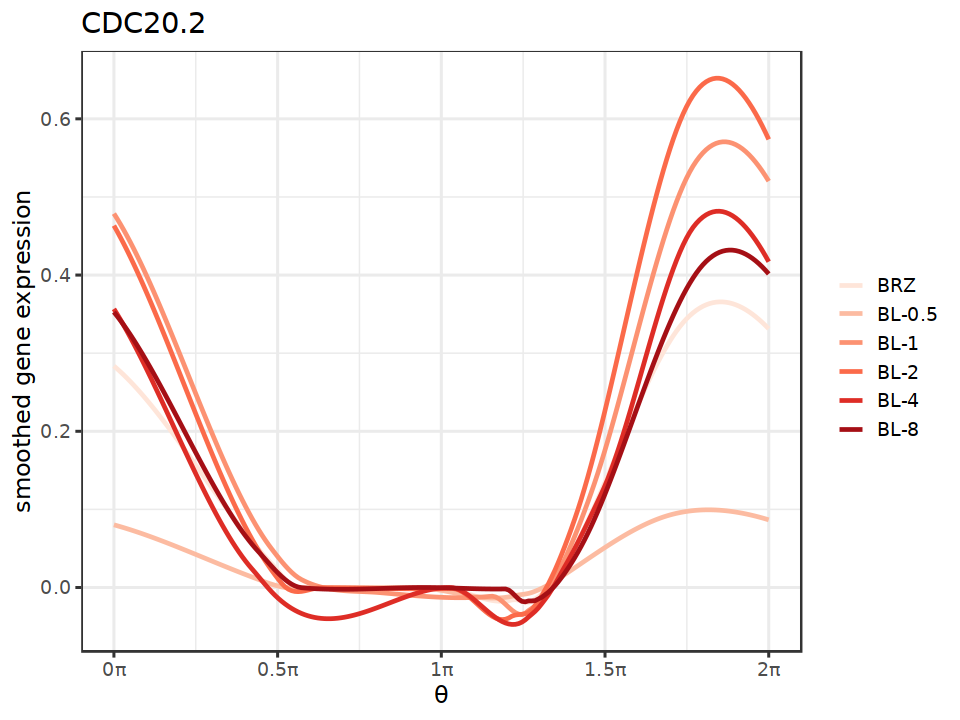

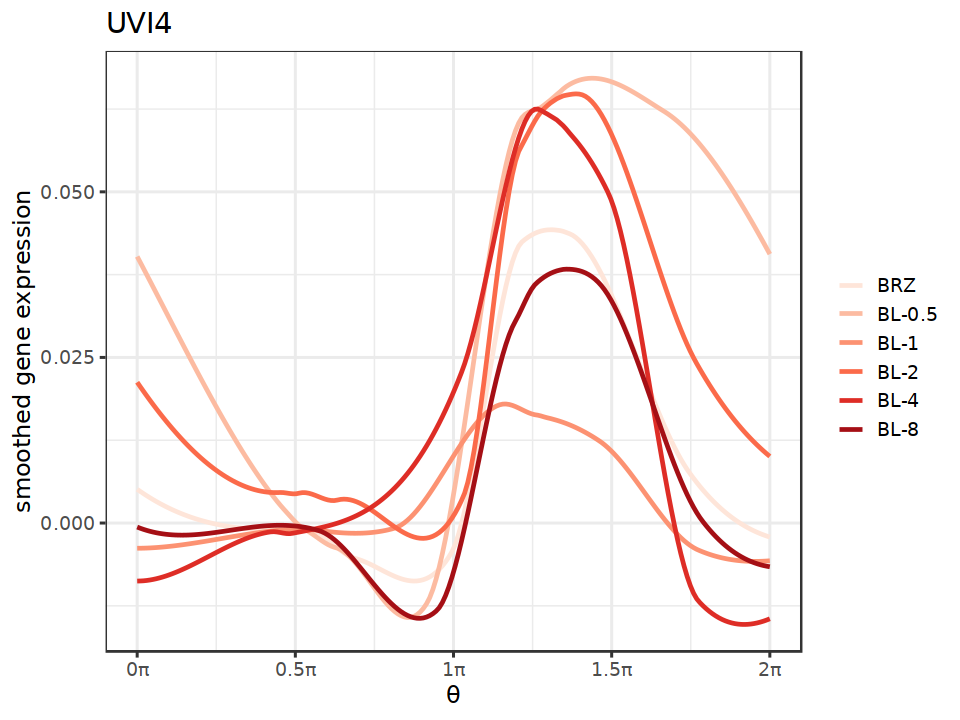

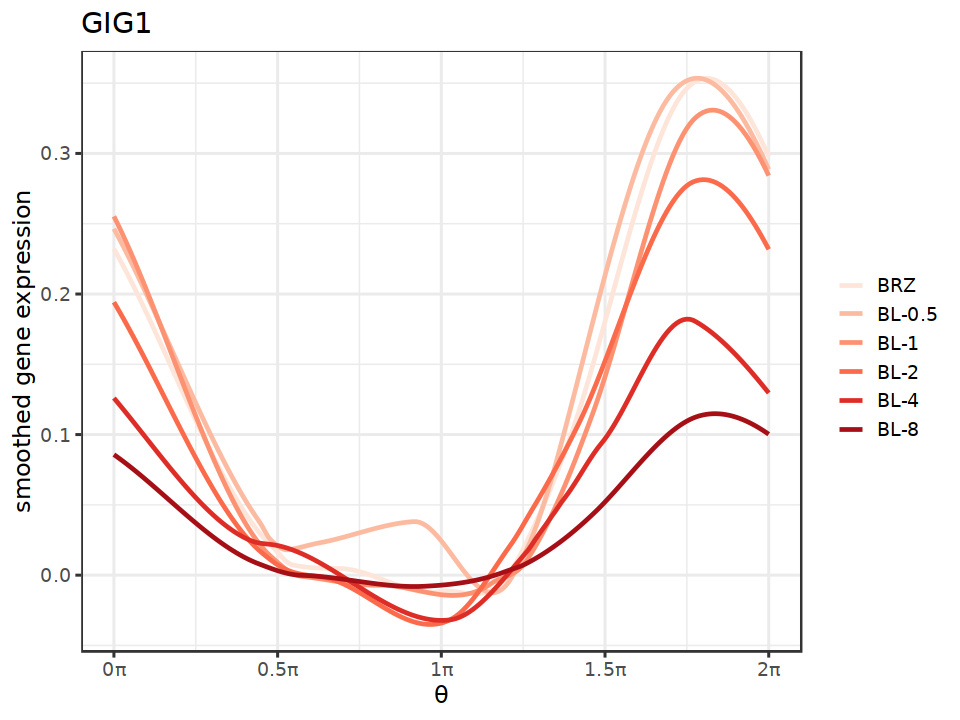

In [24]:
for (i in 1:nrow(core_br)){
 pltBR(core_br$GeneID[i],core_br$GeneName[i])
} 